<a href="https://colab.research.google.com/github/Hashtae9/NH-Big-Data-Competition/blob/main/NH.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [9]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.graphics.mosaicplot import mosaic
import scipy.stats as spst

NASDAQ_DT_FC_STK_QUT.csv
+ 2023년 1월 1일부터 2023년 8월 31일까지 NASDAQ_FC_STK_IEM_IFO.csv에 있는 종목의 시세 정보
  + TRD_DT : 거래일자
  + TCK_IEM_CD : 티커종목코드
  + IEM_ONG_PR : 종목시가
  + IEM_HI_PR : 종목고가
  + IEM_LOW_PI : 종목저가
  + IEM_END_PR : 종목종가
  + ACL_TRD_ATY : 누적거래수량
  + SLL_CNS_SUM_QTY : 매도체결합계수량
  + BYN_CNS_SUM_QTY : 매수체결합계수량

# S&P500 크롤링으로 뽑아오기
+ 주식 수 503개
+ Sector
  + XLC : Communication Services
    + 통신서비스에 관련한 회사 모음
  + XLY : Consumer Discretionary
    + 사치재, 소득의 여유가 있다면 소비하고 싶어하고 소비하는 것들에 대한 회사들의 모음
  + XLP : Consumer Staples
    + 필수 소비재, 필수적으로 소비해야 하는 것들의 판매하는 회사
  + XLE : Energy
    + 에너지 관련 회사들이 속해 있는 섹터
  + XLF : Financials
    + 금융, 금융회사들이 속해 있는 섹터
  + XLV : Health Care
    + 헬스케어 관련한 회사
  + XLI : Industrials
    + 제조업, 제조업군에 속하는 회사
  + XLB : Materials
    + 자재, 원료업, 자재나 원료를 만드는 회사
  + XLRE : Real Estate
    + 부동산, 부동산업 관련 회사
  + XLk : Technology
    + 기술, 기술회사들이 있는 섹터
  + XLU : Utility
    + 기반사업(공익사업), 전기, 수도 등의 회사

## 1. S&P 500 크롤링

In [87]:
import requests
import pandas as pd
import warnings
warnings.filterwarnings(action='ignore')

In [88]:
def sector_find():
    url = 'https://www.sectorspdrs.com/api/sectors'
    response = requests.get(url)
    # 섹터 이름
    sector_list = []
    # 섹터에 대한 설명
    sector_list_info = []

    for r in response.json():
        sector_list.append(r['symbol'])
        sector_list_info.append(r['name'])

    for index, target in enumerate(sector_list):
        url = f'https://www.sectorspdrs.com/api/cms/sector-overview?period=1D&symbol={target}'
        response = requests.get(url)
        temp = response.json()['components']
        comp_name = []
        comp_ticker = []
        for t in temp:
            comp_name.append(t['companyName'])
            comp_ticker.append(t['symbol'])

        s_n = [sector_list[index]]*len(comp_name)
        s_t = [sector_list_info[index]]*len(comp_name)
        d = dict()
        d['sector_name'] = s_n
        d['sector_ticker'] = s_t
        d['comanpy_name'] = comp_name
        d['tck_iem_cd'] = comp_ticker
        df = pd.DataFrame(d)
        if index == 0:
            result = df.copy()
        else:
            result = pd.concat([result, df], axis=0, join='inner')

    return result

In [89]:
sector_info = sector_find()
sector_info = sector_info.reset_index(drop=True)
display(sector_info.shape)
display(sector_info.tail())

(503, 4)

,sector_name,sector_ticker,comanpy_name,tck_iem_cd
498,XLU,Utilities,Consolidated Edison Inc,ED
499,XLU,Utilities,CMS Energy Corp,CMS
500,XLU,Utilities,Ameren Corp,AEE
501,XLU,Utilities,WEC Energy Group Inc,WEC
502,XLU,Utilities,Eversource Energy,ES


In [90]:
sector_info['sector_name'].value_counts()

XLI     75
XLF     72
XLV     65
XLK     65
XLY     52
XLP     38
XLRE    31
XLU     30
XLB     29
XLC     23
XLE     23
Name: sector_name, dtype: int64

## 2. ticker_info와 합치기

NASDAQ_FC_STK_IEM_IFO.csv
+ 2023년 1월 1일 부터 2023년 8월 31일까지 미국 나스닥 거래소에서 시세를 제공하는 주문 가능한 종목 정보
  + ISIN_IEM_CD : ISIN 코드
  + TCK_IEM_CD : 종목 티커 코드
  + FC_SEC_KRL_NM : 해외주식 종목 한글명
  + FC_SEC_ENG_NM : 해외주식 종목 영문명

In [91]:
ticker_info = pd.read_csv('/content/drive/MyDrive/nh/NASDAQ_FC_STK_IEM_IFO.csv', encoding='cp949')
ticker_info.head()

,isin_cd,tck_iem_cd,fc_sec_krl_nm,fc_sec_eng_nm
0,US00211V1061,AACG,ATA ...,ATA CreatGlo ...
1,US00032Q1040,AADI,Aadi Bioscience ...,Aadi Bioscience ...
2,US02376R1023,AAL,아메리칸 에어라인스 그룹 ...,American Airline ...
3,US03823U1025,AAOI,어플라이드 옵토일렉트로닉스 ...,AOI ...
4,US0003602069,AAON,에이에이온 ...,AAON ...


In [92]:
ticker_info.iloc[1, :]['tck_iem_cd']

'AADI        '

In [93]:
def delete_blank(data):
  return data.strip()

In [94]:
temp = ticker_info['tck_iem_cd'].apply(delete_blank)
temp.head()

0    AACG
1    AADI
2     AAL
3    AAOI
4    AAON
Name: tck_iem_cd, dtype: object

In [95]:
ticker_info['tck_iem_cd'] = temp
ticker_info.head()

,isin_cd,tck_iem_cd,fc_sec_krl_nm,fc_sec_eng_nm
0,US00211V1061,AACG,ATA ...,ATA CreatGlo ...
1,US00032Q1040,AADI,Aadi Bioscience ...,Aadi Bioscience ...
2,US02376R1023,AAL,아메리칸 에어라인스 그룹 ...,American Airline ...
3,US03823U1025,AAOI,어플라이드 옵토일렉트로닉스 ...,AOI ...
4,US0003602069,AAON,에이에이온 ...,AAON ...


In [96]:
test = pd.merge(sector_info, ticker_info, how = 'inner', on = 'tck_iem_cd')
test.shape

(152, 7)

In [97]:
test.head()

,sector_name,sector_ticker,comanpy_name,tck_iem_cd,isin_cd,fc_sec_krl_nm,fc_sec_eng_nm
0,XLC,Communication Services,NetFlix Inc,NFLX,US64110L1061,넷플릭스 ...,Netflix ...
1,XLC,Communication Services,Alphabet Inc C,GOOG,US02079K1079,알파벳 CLASS C (non-voting) ...,Alphabet ...
2,XLC,Communication Services,Alphabet Inc A,GOOGL,US02079K3059,알파벳 CLASS A (voting) ...,Alphabet ...
3,XLC,Communication Services,Electronic Arts,EA,US2855121099,일렉트로닉 아츠 ...,Electronic Arts ...
4,XLC,Communication Services,"Meta Platforms, Inc. Class A",META,US30303M1027,Meta Platforms ...,Meta Platforms ...


In [98]:
display(test['sector_name'].value_counts())
display(test['sector_name'].value_counts().sum())

XLK     45
XLY     18
XLV     18
XLC     17
XLI     17
XLF     14
XLP      8
XLU      6
XLRE     5
XLE      3
XLB      1
Name: sector_name, dtype: int64

152

# 모든 테이블 합친 후 11개의 Sector를 나눠서 시가, 종가 등 파악하기

## 테이블 합치기


In [99]:
nasdaq_info = pd.read_csv('/content/drive/MyDrive/nh/NASDAQ_DT_FC_STK_QUT.csv')
nasdaq_info.head()

,trd_dt,tck_iem_cd,gts_iem_ong_pr,gts_iem_hi_pr,gts_iem_low_pr,gts_iem_end_pr,gts_acl_trd_qty,gts_sll_cns_sum_qty,gts_byn_cns_sum_qty
0,20230103,NVDA,148.5100,149.9600,140.9600,143.1500,40127658.0,0.0,0.0
1,20230103,APLT,0.7535,0.7900,0.7308,0.7522,63714.0,19658.0,44056.0
2,20230103,ANY,1.8900,2.0293,1.8354,1.9600,24896.4,0.0,0.0
3,20230103,CLRB,1.6600,1.7200,1.6300,1.6300,21212.0,16444.0,4768.0
4,20230103,NYMTM,18.4300,18.7400,18.4300,18.7000,8061.0,0.0,0.0


In [100]:
# nasdaq_info는 빈칸은 없음
nasdaq_info.iloc[0, :]['tck_iem_cd']

'NVDA'

In [101]:
nasdaq_info['trd_dt'] = pd.to_datetime(nasdaq_info['trd_dt'], format='%Y%m%d')

In [102]:
nasdaq_data = pd.merge(nasdaq_info, test, how = 'inner', on = 'tck_iem_cd')
display(nasdaq_data.shape)
display(nasdaq_data.head())
display(nasdaq_data['sector_name'].value_counts())

(25232, 15)

,trd_dt,tck_iem_cd,gts_iem_ong_pr,gts_iem_hi_pr,gts_iem_low_pr,gts_iem_end_pr,gts_acl_trd_qty,gts_sll_cns_sum_qty,gts_byn_cns_sum_qty,sector_name,sector_ticker,comanpy_name,isin_cd,fc_sec_krl_nm,fc_sec_eng_nm
0,2023-01-03,NVDA,148.51,149.96,140.9600,143.15,40127658.0,0.0,0.0,XLK,Technology,Nvidia Corp,US67066G1040,엔비디아 ...,Nvidia ...
1,2023-01-04,NVDA,145.67,148.53,142.4100,147.49,43132360.0,0.0,0.0,XLK,Technology,Nvidia Corp,US67066G1040,엔비디아 ...,Nvidia ...
2,2023-01-05,NVDA,144.91,145.64,141.4795,142.65,38916811.0,0.0,0.0,XLK,Technology,Nvidia Corp,US67066G1040,엔비디아 ...,Nvidia ...
3,2023-01-06,NVDA,144.74,150.10,140.3400,148.59,40504362.0,0.0,0.0,XLK,Technology,Nvidia Corp,US67066G1040,엔비디아 ...,Nvidia ...
4,2023-01-09,NVDA,152.84,160.56,151.4100,156.28,50423056.0,0.0,0.0,XLK,Technology,Nvidia Corp,US67066G1040,엔비디아 ...,Nvidia ...


XLK     7470
XLY     2988
XLV     2988
XLI     2822
XLC     2822
XLF     2324
XLP     1328
XLU      996
XLRE     830
XLE      498
XLB      166
Name: sector_name, dtype: int64

In [103]:
list(nasdaq_data)

['trd_dt',
 'tck_iem_cd',
 'gts_iem_ong_pr',
 'gts_iem_hi_pr',
 'gts_iem_low_pr',
 'gts_iem_end_pr',
 'gts_acl_trd_qty',
 'gts_sll_cns_sum_qty',
 'gts_byn_cns_sum_qty',
 'sector_name',
 'sector_ticker',
 'comanpy_name',
 'isin_cd',
 'fc_sec_krl_nm',
 'fc_sec_eng_nm']

## 메서드 및 패키지 모음

In [104]:
!pip install pykrx
!pip install pandas_datareader
!pip install yfinance

In [105]:
!pip install finance-datareader

In [144]:
import FinanceDataReader as fdr
import pandas_datareader.data as pdr
import yfinance as yf

import pandas as pd
from pykrx import stock
from itertools import combinations, permutations
import scipy.stats as spst
import warnings
warnings.filterwarnings('ignore')

In [107]:
# 경제 성장률
# 직접 검색
kor_growth_rate = [2.8, 2.9, 3.2, 2.9, 2.2, -0.7, 4.1, 2.6, 1.5]
america_growth_rate = [2.7, 1.7, 2.3, 2.9, 2.3, -3.4, 5.7, 2.1, 1.0]
china_growth_rate = [6.9, 6.7, 6.8, 6.7, 6.0, 2.2, 8.4, 3.0, 4.5]

In [108]:
# 경제 성장률 컬럼 만들기
def make_growth_kor(df, growth):
    df['kor_growth_rate'] = np.where(df.index.year == 2015, growth[0],
                        np.where(df.index.year == 2016, growth[1],
                                 np.where(df.index.year == 2017, growth[2],
                                          np.where(df.index.year == 2018, growth[3],
                                                   np.where(df.index.year == 2019, growth[4],
                                                            np.where(df.index.year == 2020, growth[5],
                                                                     np.where(df.index.year == 2021, growth[6],
                                                                              np.where(df.index.year == 2022, growth[7], growth[8]))))))))
    return df

def make_growth_ame(df, growth):
    df['growth_rate'] = np.where(df.index.year == 2015, growth[0],
                        np.where(df.index.year == 2016, growth[1],
                                 np.where(df.index.year == 2017, growth[2],
                                          np.where(df.index.year == 2018, growth[3],
                                                   np.where(df.index.year == 2019, growth[4],
                                                            np.where(df.index.year == 2020, growth[5],
                                                                     np.where(df.index.year == 2021, growth[6],
                                                                              np.where(df.index.year == 2022, growth[7], growth[8]))))))))
    return df

def make_growth_china(df, growth):
    df['kor_growth_china'] = np.where(df.index.year == 2015, growth[0],
                        np.where(df.index.year == 2016, growth[1],
                                 np.where(df.index.year == 2017, growth[2],
                                          np.where(df.index.year == 2018, growth[3],
                                                   np.where(df.index.year == 2019, growth[4],
                                                            np.where(df.index.year == 2020, growth[5],
                                                                     np.where(df.index.year == 2021, growth[6],
                                                                              np.where(df.index.year == 2022, growth[7], growth[8]))))))))
    return df

In [262]:
data = fdr.DataReader('261220', '2023-01-01', '2023-08-31')
data.head()

,Open,High,Low,Close,Volume,Change
Date,,,,,,
2023-01-02,14500,14645,14465,14630,57578,0.022005
2023-01-03,14680,14700,14490,14695,81290,0.004443
2023-01-04,14095,14135,13940,14010,61509,-0.046614
2023-01-05,13420,13530,13400,13525,252771,-0.034618
2023-01-06,13540,13655,13495,13575,120110,0.003697


In [294]:
# 나스닥 데이터를 활용한 가벼운 경향성 파악
# 이후 상관계수가 높은 값들은 더 자세하게(2015년부터) 여러 지표와 함께 조사예정

# def stock_auto(stock_name, stock_code, year, date, etf, max_R, df_list):
def stock_auto(etf_list, korea_list, year, date, max_R, mode):


    etf = pd.DataFrame(columns=['거래일자', '종목', '거래량', '시가', '종가', '고가', '저가'])
    for i in etf_list:
        etf = pd.concat([etf, i], ignore_index=True)
    etf['거래량'] = etf['거래량'].astype(int)


    korea = pd.DataFrame(columns=['거래일자', '종목', '거래량', '시가', '종가', '고가', '저가'])
    for i in korea_list:
        korea = pd.concat([korea, i], ignore_index=True)
    korea['거래량'] = korea['거래량'].astype(int)

    uni = []
    uni.append(korea['종목'].unique())
    uni.append(etf['종목'].unique())


    korea.columns = ['거래일자','종목', '거래량_ko', '시가_ko', '종가_ko', '고가_ko', '저가_ko']
    etf.columns = ['거래일자','종목', '거래량_a', '시가_a', '종가_a', '고가_a', '저가_a']

    korea = korea.groupby('거래일자', as_index=False).mean()
    #etf = etf.groupby('거래일자', as_index=False).mean()

    merged_df = pd.merge(korea, etf, on='거래일자', suffixes=('_a', '_ko'))

    indicators = ['종가']
    tail = [('_a', '_ko'), ('_ko', '_a')]
    for indicator in indicators:
        var = indicator + tail[mode][0]
        target = indicator + tail[mode][1]
        result = spst.pearsonr(merged_df[var], merged_df[target])
        if max_R[0] < result[0]:
            max_R = (result[0], result[1], stock_name, stock_code)
            print(f'상관계수 : {result[0]}, p-value : {result[1]}', uni[mode])

    return max_R


# mode 1: 한국 리스트 -> 미국
# mode 2: 미국 리스트 -> 한국
def find_best_R(etf, stock_name, stock_code, year, date, mode):
    # etf 구해 놓기
    data_for = year+'-'+date[:2] + '-' + date[2:]
    etf_list =[]
    for i in range(len(etf)):
        sn= etf[i]
        # 데이터 받아서
        #data =  fdr.DataReader(sn, data_for, "2023-08-31")
        data = nasdaq_data.loc[nasdaq_data['sector_name'] == sn, :][['trd_dt', 'gts_iem_ong_pr', 'gts_iem_hi_pr', 'gts_iem_low_pr', 'gts_iem_end_pr', 'gts_acl_trd_qty']]
        data.columns = ['Date', 'Open', 'High', 'Low', 'Close', 'Volume']

        data.columns = ['거래일자','시가','고가','저가','종가','거래량']
        print(list(data))
        # 종목 컬럼 추가
        data['종목'] = sn
        # 컬럼 순서
        data = data[['거래일자','종목', '거래량', '시가', '종가', '고가', '저가']]
        # 합치기 위함
        etf_list.append(data)



    # 우리나라 값 구해 놓기
    df_list =[]
    for i in range(len(stock_code)):
        sc = stock_code[i]
        sn= stock_name[i]
        # 데이터 받아서
        data = fdr.DataReader(sc, '2023-01-01', '2023-08-31')
        #data = stock.get_market_ohlcv(year+date,"20230831", sc)

        # # 인덱스 -> 날짜로
        data.reset_index(inplace=True)

        # 이름 추가
        data['종목'] = sn
        # 컬럼삭제
        del_col = ['Change']
        data.drop(columns=del_col, axis=1, inplace=True)
        data.columns = ['거래일자', '시가','고가','저가','종가','거래량', '종목']
        # 컬럼순서
        data = data[['거래일자', '종목', '거래량', '시가', '종가', '고가', '저가']]

        # 일자 -> 거래일자
        #data.rename(columns={'날짜': '거래일자'}, inplace=True)

        # 달러로 변환 _  원화 금액/1327  =  달러
        exchange_rate = 1327
        dollars_columns = ['시가', '종가', '고가', '저가']
        data[dollars_columns] = round(data[dollars_columns] / exchange_rate, 2)
        df_list.append(data)

    # print(etf_list)
    print('주식 받아오기 끝')

    t = (0, 0, [], [])
    if mode == 0:
        n = len(stock_name)
        nums = [i for i in range(n)]
        combi = []
        for i in range(1, n+1):
            combi += list(combinations(nums, i))
        combi_len = len(combi)
        print('가능한 조합:', combi_len)

        for i in combi:
            a = []
            for j in i:
                a.append(df_list[j])
            t = stock_auto(etf_list, a, year, date, t, mode)


    else:
        n = len(etf)
        nums = [i for i in range(n)]
        combi = []
        for i in range(1, n+1):
            combi += list(combinations(nums, i))
        combi_len = len(combi)
        print('가능한 조합:', combi_len)

        for i in combi:
            a = []
            for j in i:
                a.append(etf_list[j])
            t = stock_auto(a, df_list, year, date, t, mode)



    print('end')

In [286]:
# 주식 2015년부터의 정보 받아오기

def stock_info(stock_list):
  stock = fdr.DataReader(stock_list[0], '2015-01-01', '2023-08-31')
  # 주식이 1개인 경우
  if len(stock_list)==1:
    # 단일 변동량
    stock['EPS'] = np.round(((stock['Close'] - stock['Open'])/stock['Open'])*100, 4)
    # 4주 변동량
    stock['EPS_28'] = stock['EPS'].rolling(28, min_periods=1).mean()
    # 하루 평균 가격
    stock['VWAP'] = np.round((stock['Open']+stock['High']+stock['Low']+stock['Close'])/4, 4)

    # ATR 계산
    stock['High-Low'] = stock['High'] - stock['Low']
    stock['High-PrevClose'] = np.abs(stock['High'] - stock['Close'].shift())
    stock['Low-PrevClose'] = np.abs(stock['Low'] - stock['Close'].shift())
    stock['TR'] = np.max(stock[['High-Low', 'High-PrevClose', 'Low-PrevClose']], axis=1)
    stock['ATR'] = stock['TR'].rolling(14, min_periods=1).mean()

    return stock[['Open', 'High', 'Low', 'Close', 'Volume', 'EPS_28', 'VWAP', 'ATR']]

  # 주식이 여러개인 경우
  for i in stock_list[1:]:
    temp = fdr.DataReader(i, '2015-01-01', '2023-08-31')
    stock = pd.concat([stock, temp], axis=0)

    # 찾은 여러 주식의 평균가 구하기
    a_result = stock.groupby(stock.index)[['Open', 'High', 'Low', 'Close', 'Volume']].mean()

    # 단일 변동량
    a_result['EPS'] = np.round(((a_result['Close'] - a_result['Open'])/a_result['Open'])*100, 4)
    # 4주 변동량
    a_result['EPS_28'] = a_result['EPS'].rolling(28, min_periods=1).mean()
    # 하루 평균 가격
    a_result['VWAP'] = np.round((a_result['Open']+a_result['High']+a_result['Low']+a_result['Close'])/4, 4)

  # ATR 계산
    a_result['High-Low'] = a_result['High'] - a_result['Low']
    a_result['High-PrevClose'] = np.abs(a_result['High'] - a_result['Close'].shift())
    a_result['Low-PrevClose'] = np.abs(a_result['Low'] - a_result['Close'].shift())
    a_result['TR'] = np.max(a_result[['High-Low', 'High-PrevClose', 'Low-PrevClose']], axis=1)
    a_result['ATR'] = a_result['TR'].rolling(14, min_periods=1).mean()
    return a_result[['Open', 'High', 'Low', 'Close', 'Volume', 'EPS_28', 'VWAP', 'ATR']]

In [112]:
def return_ak(america_list, korea_list):
    # 미국 XLB 값의 평균
    america = stock_info(america_list)
    # 한국 조사할 데이터
    korea = stock_info(korea_list)
    korea.columns= ['kor_open', 'kor_high', 'kor_low', 'kor_close', 'kor_volume', 'kor_EPS', 'kor_VWAP', 'kor_ATR']

    # korea, america merge
    ak = pd.merge(america, korea, how='inner', on='Date')
    # 환율
    temp = fdr.DataReader('USD/KRW', '2015-01-01', '2023-08-31')[['Close']]

    # 경제성장률
    temp = make_growth_ame(temp, america_growth_rate)
    temp = make_growth_kor(temp, kor_growth_rate)
    temp = make_growth_china(temp, china_growth_rate)

    # 금리
    df22 = fdr.DataReader('FRED:FEDFUNDS', '2014-12-31', '2023-08-31', data_source='fred')[['FEDFUNDS']]
    df22 = df22.resample('D').ffill()

    # 원유 가격
    # https://www.opinet.co.kr/glopcoilSelect.do 에서 무료로 제공
    url = 'https://raw.githubusercontent.com/Hashtae9/MyData/main/crudeOil/Crude_Oil_20150101_20230831.csv'
    oil = pd.read_csv(url, encoding='cp949')
    oil['기간'] = pd.to_datetime(oil['기간'], format='%y년%m월%d일')
    oil = oil.rename(columns={'기간': 'Date', 'Dubai': 'Dubai', 'Brent': 'Brent', 'WTI': 'WTI'})
    oil = oil.set_index('Date')

    # 만든 지표들 합치기
    temp = pd.concat([temp, df22], axis=1, join='outer')
    temp = pd.concat([temp, oil], axis=1, join='outer')
    temp = temp.fillna(method='ffill')

    # 날짜를 인덱스로
    temp.reset_index(drop=False, inplace=True)

    # 컬럼명 정리
    temp.columns = ['Date', 'USD/KRW', 'growth_rate', 'kor_growth_rate', 'china_growth_rate', 'FEDFUNDS', 'Dubai', 'Brent', 'WTI']

    # 미국주식과 합치기
    ak = pd.merge(ak, temp, how = 'inner', on='Date')

    # 한국 주식의 Open, High, Low, Close 가격을 USD로 변환하여 새로운 컬럼에 저장
    ak['kor_Open_USD'] = ak['kor_open'] / ak['USD/KRW']
    ak['kor_High_USD'] = ak['kor_high'] / ak['USD/KRW']
    ak['kor_Low_USD'] = ak['kor_low'] / ak['USD/KRW']
    ak['kor_Close_USD'] = ak['kor_close'] / ak['USD/KRW']
    ak['kor_EPS_USD'] = ak['kor_EPS'] / ak['USD/KRW']
    ak['kor_VWAP_USD'] = ak['kor_VWAP'] / ak['USD/KRW']
    ak['kor_ATR_USD'] = ak['kor_ATR'] / ak['USD/KRW']

    # 날짜(Date)를 인덱스로 설정
    ak['Date'] = pd.to_datetime(ak['Date'])
    ak.set_index('Date', inplace=True)
    return ak

## 수식 설명
### 주당 순이익(EPS) : 성장률<br>
+ $\frac{종가 - 시가}{시가}$

<br>

### 거래량 가중 평균 가격 : 특정 기간 동안의 가격평균<br>
+ 원래는 특정 가격 별 거래량을 기준으로 값을 구해야함
+ 5000원에 2000개, 5500원에 1000개가 거래되었다 가정
  + $\frac{5000*2000 + 5500*1000}{3000}$       = 5166
  + 근사값 : $\frac{누적거래수량 * (시가 + 고가 + 저가 + 종가)}{누적거래수량*4}$

<br>

### ATR
+ [ATR](https://alphasquare.oopy.io/board/technical-indicator/atr)
+ $\frac{\sum_{i=1}^n(고가_i - 저가_i)}{n}$
+ 첫날은 구할 수 없음
  + 0으로 둠
# <br>

### 매수, 매도 비율
+ $\frac{매수 체결 합계 수량}{매도 체결 합계 수량}$
+ 1보다 크면 매수 주문이 더 많다(상승장)
+ 1보다 작으면 매도 주문이 더 많다(하락장)

### 금리

### per


글로벌 경제 성장률
+ https://kosis.kr/statHtml/statHtml.do?orgId=101&tblId=DT_2KAA905_OECD
+ https://namu.wiki/w/%EC%A4%91%EA%B5%AD/%EA%B2%BD%EC%A0%9C%EC%84%B1%EC%9E%A5%EB%A5%A0
+ 한국
    + 2022 : 2.6%
    + 2023 : 1.5%
+ 미국
    + 2022 : 2.1%
    + 2023 : 1.0%

원유
+ 브랜트유 (Brent Crude) : BR
+ 미국 서부텍사스산원유 (WTI Crude) : CL
+ 두바이유(Dubad) : DU
    + 우리나라의 대중동 원유 수입 비중이 70.2%를 기록
    + https://www.opinet.co.kr/glopcoilSelect.do

## XLB %
  + XLB : Materials
    + 자재, 원료업, 자재나 원료를 만드는 회사

### NH에서 준 정보를 활용한 상관관계 분석


In [295]:
#XLB
stock_name= ['KODEX WTI 원유선물(H)', 'KODEX 골드선물(H)', 'TIGER 구리실물']
stock_code = ['261220', '132030', '160580']

# etf = ['T', 'VZ', 'CHTR', 'CMCSA', 'TMUS']
etf = ['XLB']
#
year = '2023'
date = '0101'

find_best_R(etf, stock_name, stock_code, year, date, 0)

['거래일자', '시가', '고가', '저가', '종가', '거래량']
주식 받아오기 끝
가능한 조합: 7
상관계수 : 0.2697887439363544, p-value : 0.0005837369398303166 ['KODEX WTI 원유선물(H)']
상관계수 : 0.5264323660022853, p-value : 1.0263036103952204e-12 ['TIGER 구리실물']
end


In [114]:
nasdaq_data.loc[nasdaq_data['sector_name'] == 'XLB', 'fc_sec_krl_nm'].unique()

array(['스틸 다이내믹스                                                    '],
      dtype=object)

### 주식 중 XLB에 해당하는 주식 찾기
#### 미국
+ PDBC
+ DBC
+ BCI
+ GSG

<br>

#### 대한민국
+ KODEX WTI 원유선물(H)
+ KODEX 골드선물(H)
+ TIGER 구리실물

In [115]:
stock_name= ['KODEX WTI 원유선물(H)', 'KODEX 골드선물(H)', 'TIGER 구리실물']
stock_code = ['261220', '132030', '160580']

In [116]:
#조사할 데이터
#america_list = ['PDBC', 'DBC', 'BCI', 'GSG']
america_list = list(sector_info.loc[sector_info['sector_name']=='XLB', 'tck_iem_cd'].unique())
korea_list = ['261220', '132030', '160580']

In [117]:
ak = return_ak(america_list, korea_list)

In [118]:
ak.head()

,Open,High,Low,Close,Volume,EPS_28,VWAP,ATR,kor_open,kor_high,...,Dubai,Brent,WTI,kor_Open_USD,kor_High_USD,kor_Low_USD,kor_Close_USD,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD
Date,,,,,,,,,,,,,,,,,,,,,
2015-01-02,31.279999,31.559999,30.954999,31.300000,1897000.0,0.063900,31.2737,0.605000,9180.0,9190.0,...,53.27,56.42,52.69,8.394294,8.403438,8.362290,8.394294,0.000000,8.388579,0.041149
2015-01-05,30.915001,31.104999,30.135000,30.395001,2651150.0,-0.809050,30.6375,0.885000,9205.0,9255.0,...,50.98,53.11,50.04,8.285329,8.330333,8.240324,8.316832,0.000171,8.293204,0.065257
2015-01-06,30.539999,30.675001,29.840000,30.235000,3805550.0,-0.872267,30.3225,0.868334,9305.0,9365.0,...,48.08,51.10,47.93,8.394226,8.448354,8.380695,8.425801,0.000227,8.412269,0.081191
2015-01-07,30.825000,31.015000,30.270000,30.395000,3541050.0,-1.002950,30.6262,0.846250,9465.0,9465.0,...,46.60,51.15,48.65,8.625717,8.625717,8.566481,8.584708,0.000064,8.600656,0.089994
2015-01-08,30.695000,31.430000,30.599999,31.105001,3758750.0,-0.535220,30.9575,0.884000,9420.0,9420.0,...,47.50,50.96,48.79,8.580798,8.580798,8.526143,8.539807,-0.000036,8.556886,0.082893


In [119]:
list(ak)

['Open',
 'High',
 'Low',
 'Close',
 'Volume',
 'EPS_28',
 'VWAP',
 'ATR',
 'kor_open',
 'kor_high',
 'kor_low',
 'kor_close',
 'kor_volume',
 'kor_EPS',
 'kor_VWAP',
 'kor_ATR',
 'USD/KRW',
 'growth_rate',
 'kor_growth_rate',
 'china_growth_rate',
 'FEDFUNDS',
 'Dubai',
 'Brent',
 'WTI',
 'kor_Open_USD',
 'kor_High_USD',
 'kor_Low_USD',
 'kor_Close_USD',
 'kor_EPS_USD',
 'kor_VWAP_USD',
 'kor_ATR_USD']

In [120]:
check_one = ['EPS_28', 'VWAP', 'ATR', 'growth_rate', 'USD/KRW', 'kor_EPS_USD', 'kor_VWAP_USD', 'kor_ATR_USD', 'kor_growth_rate', 'china_growth_rate', 'Dubai', 'Brent', 'WTI', 'FEDFUNDS']
# kor_Close_USD와 나머지의 관계 파악
check_two = ['EPS_28', 'VWAP', 'ATR', 'growth_rate', 'USD/KRW', 'kor_EPS_USD', 'kor_ATR_USD', 'kor_growth_rate', 'china_growth_rate', 'Dubai', 'Brent', 'WTI', 'FEDFUNDS']

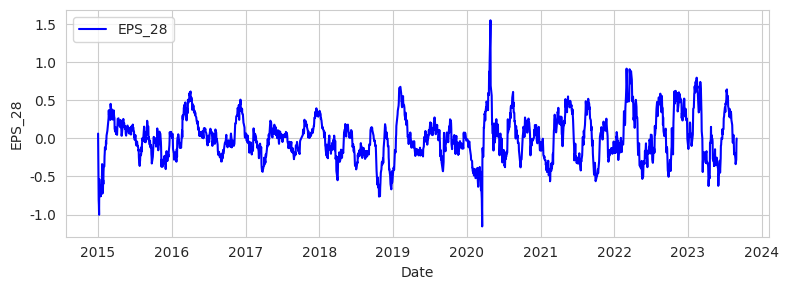

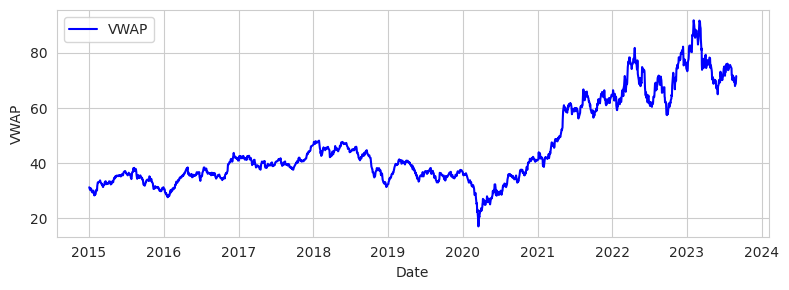

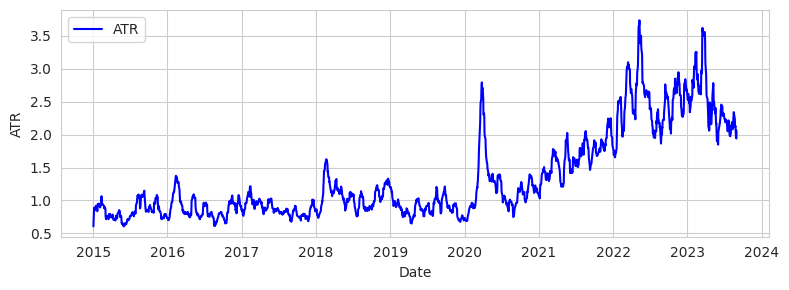

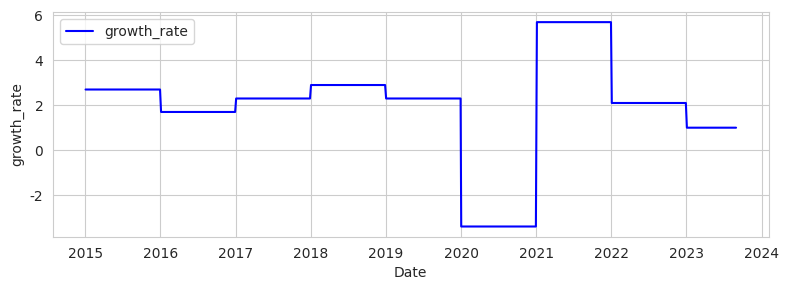

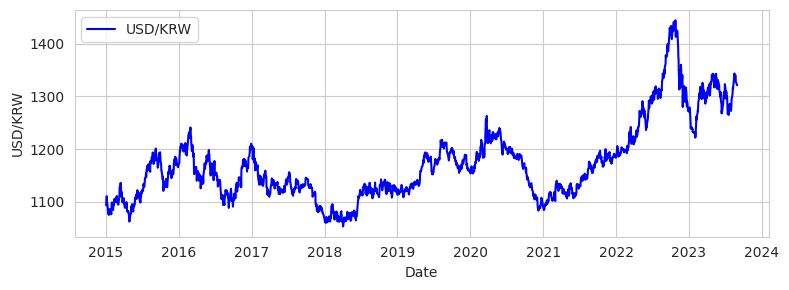

...

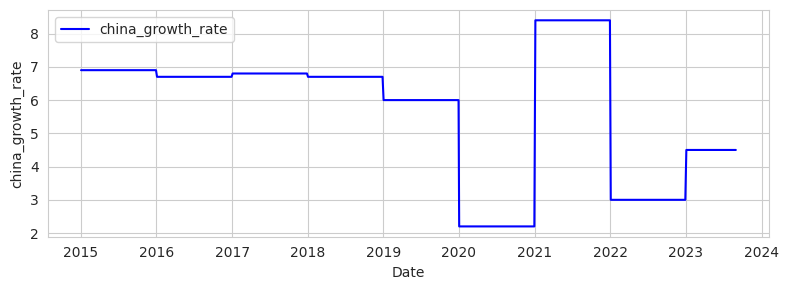

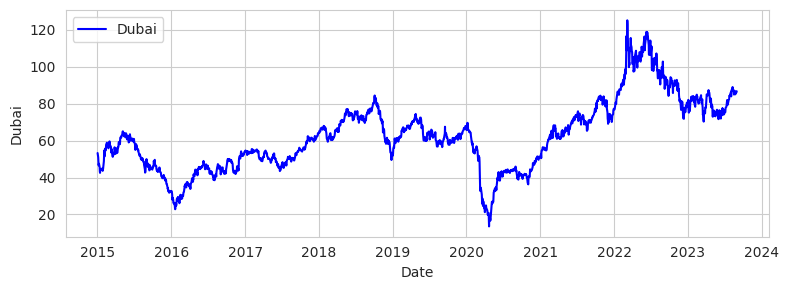

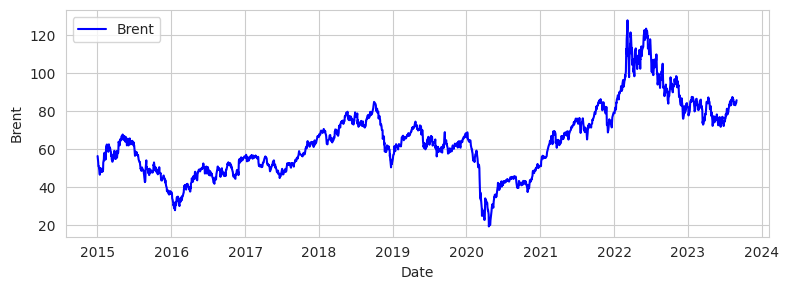

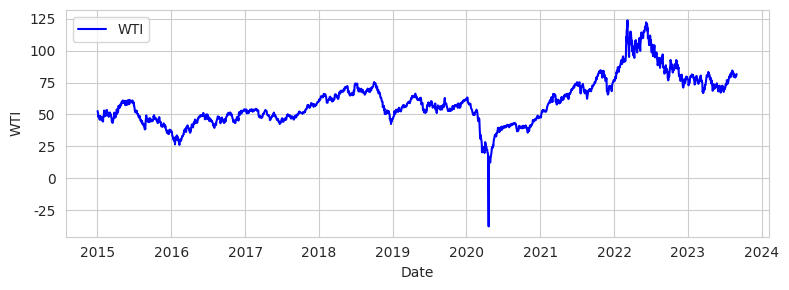

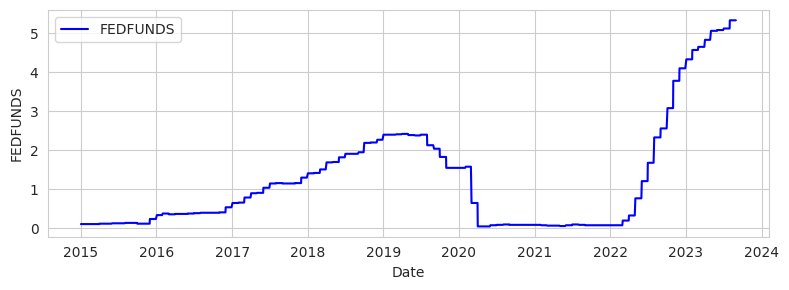

In [121]:
def draw_one(df, col_list):
    for col in col_list:
        plt.figure(figsize=(8, 3))
        plt.plot(df.index, df[col], label = col, color='blue')
        plt.ylabel(col)
        plt.xlabel('Date')
        plt.legend(loc='upper left')
        plt.tight_layout()
        plt.show()

draw_one(ak, check_one)

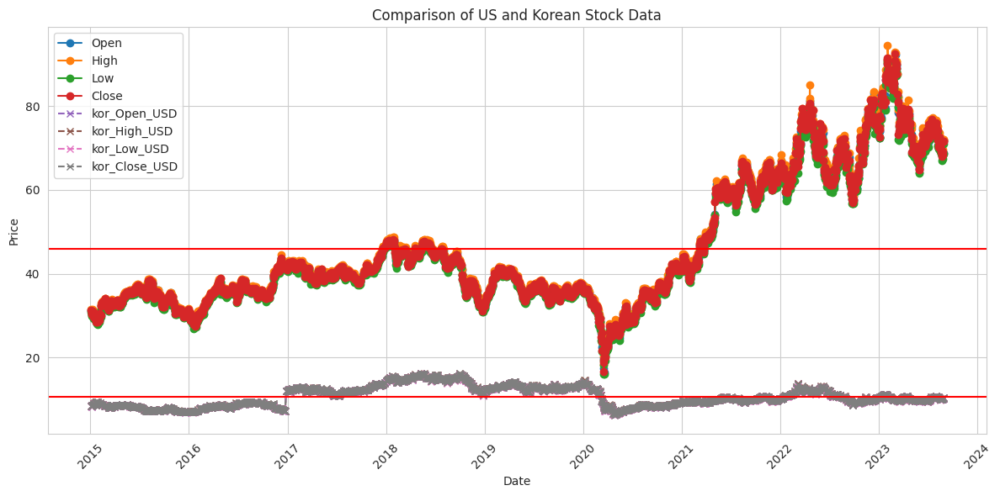

In [122]:
# 미국의 데이터를 라인 플롯으로 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Open'], label='Open', marker='o')
plt.plot(ak.index, ak['High'], label='High', marker='o')
plt.plot(ak.index, ak['Low'], label='Low', marker='o')
plt.plot(ak.index, ak['Close'], label='Close', marker='o')

# 한국의 데이터를 라인 플롯으로 그리기
plt.plot(ak.index, ak['kor_Open_USD'], label='kor_Open_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_High_USD'], label='kor_High_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Low_USD'], label='kor_Low_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Close_USD'], label='kor_Close_USD', linestyle='--', marker='x')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.axhline(y=((ak['Open']+ak['High']+ak['Low']+ak['Close'])/4).mean(), color='red')
plt.axhline(y=((ak['kor_Open_USD']+ak['kor_High_USD']+ak['kor_Low_USD']+ak['kor_Close_USD'])/4).mean(), color='red')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

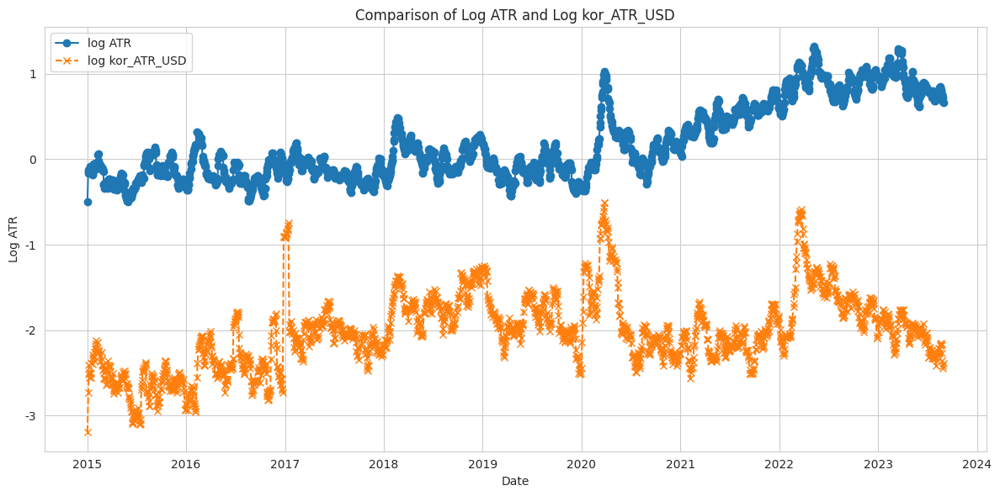

In [123]:
import matplotlib.pyplot as plt
import numpy as np

# 미국의 ATR 데이터
us_atr = ak['ATR']

# 한국의 kor_ATR_USD 데이터
kor_atr_usd = ak['kor_ATR_USD']

# 로그 스케일 적용
log_us_atr = np.log(us_atr)
log_kor_atr_usd = np.log(kor_atr_usd)

# 그래프 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, log_us_atr, label='log ATR', marker='o')
plt.plot(ak.index, log_kor_atr_usd, label='log kor_ATR_USD', linestyle='--', marker='x')

plt.title('Comparison of Log ATR and Log kor_ATR_USD')
plt.xlabel('Date')
plt.ylabel('Log ATR')
plt.legend()
plt.tight_layout()
plt.show()

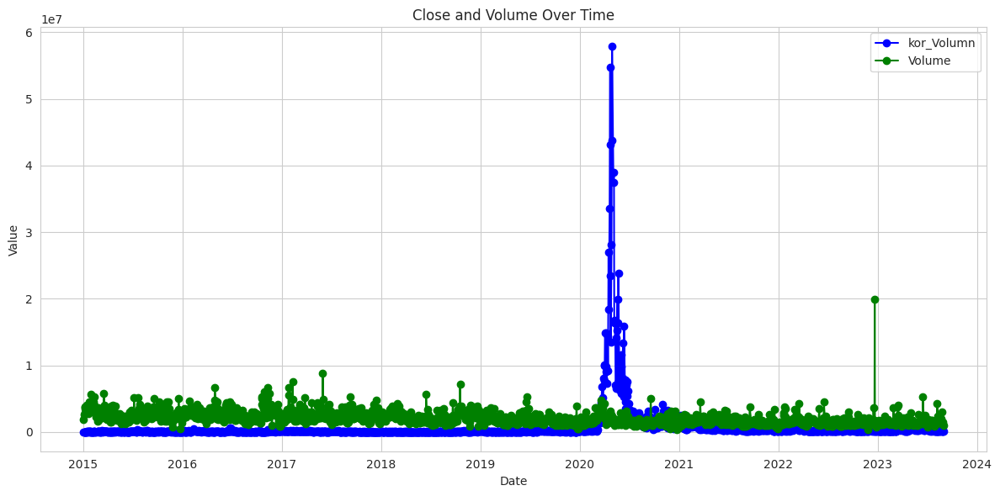

In [124]:
# 'Close'와 'Volume'의 시계열 그래프
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['kor_volume'], marker='o', label='kor_Volumn', linestyle='-', color='b')
plt.plot(ak.index, ak['Volume'], marker='o', label='Volume', linestyle='-', color='g')

# 축과 레이블 설정
plt.xlabel('Date')
plt.ylabel('Value')
plt.title('Close and Volume Over Time')
#plt.xticks(ak.index, ak.index, rotation=45)
plt.legend(loc='best')

# 그래프 출력
plt.tight_layout()
plt.show()

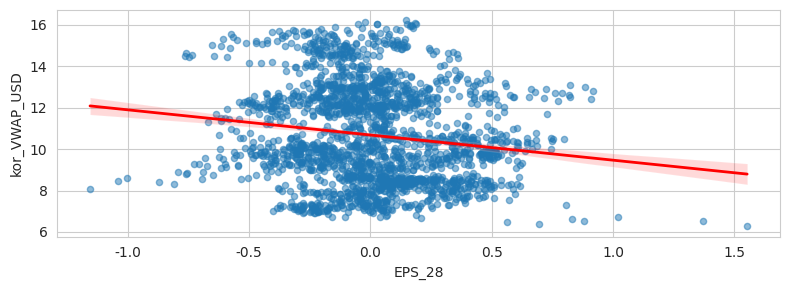

EPS_28와 kor_VWAP_USD 사이의 상관계수 : -0.15
p-value: 9.783781531450634e-12



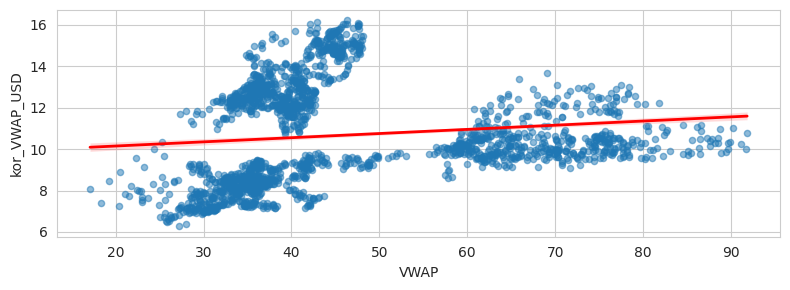

VWAP와 kor_VWAP_USD 사이의 상관계수 : 0.13
p-value: 2.280878795743915e-09



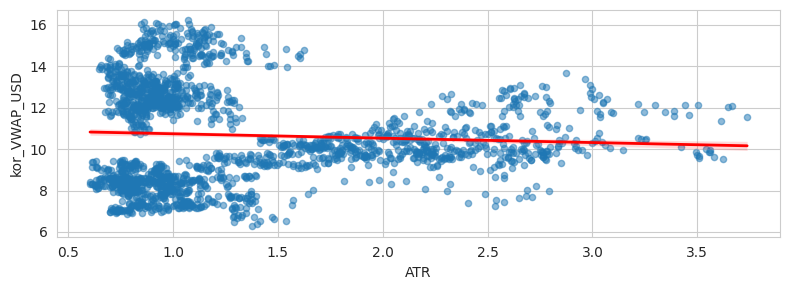

ATR와 kor_VWAP_USD 사이의 상관계수 : -0.06
p-value: 0.005351662108753343



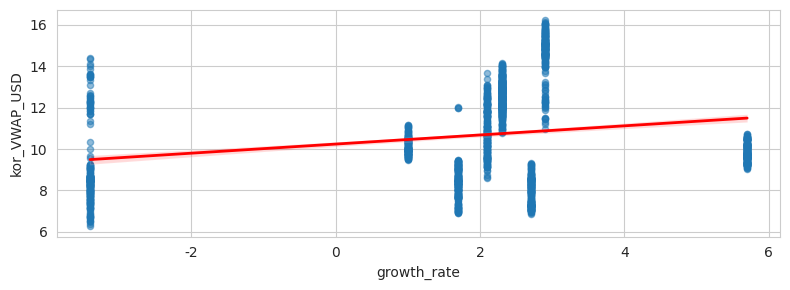

growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.22
p-value: 2.993186839750289e-23



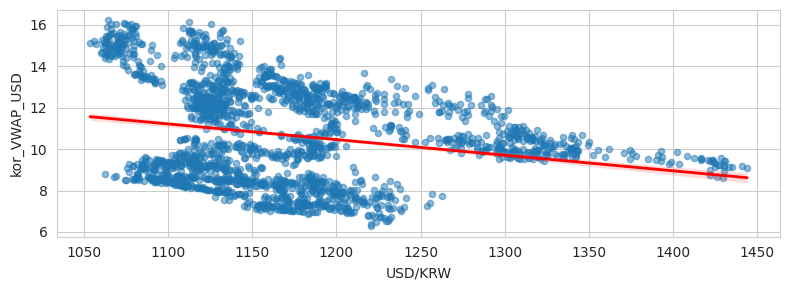

USD/KRW와 kor_VWAP_USD 사이의 상관계수 : -0.24
p-value: 1.8699918700465188e-28



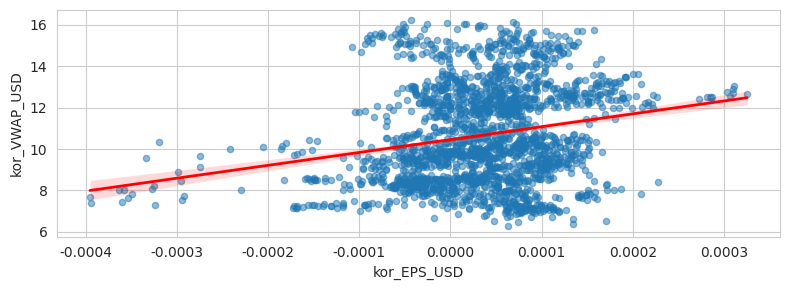

kor_EPS_USD와 kor_VWAP_USD 사이의 상관계수 : 0.21
p-value: 1.0345724741036845e-22



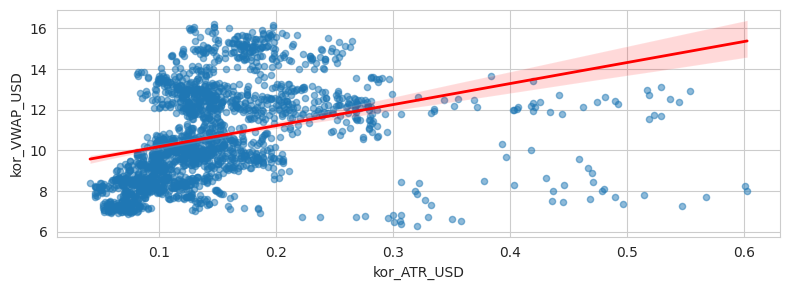

kor_ATR_USD와 kor_VWAP_USD 사이의 상관계수 : 0.33
p-value: 3.0443391233881534e-55



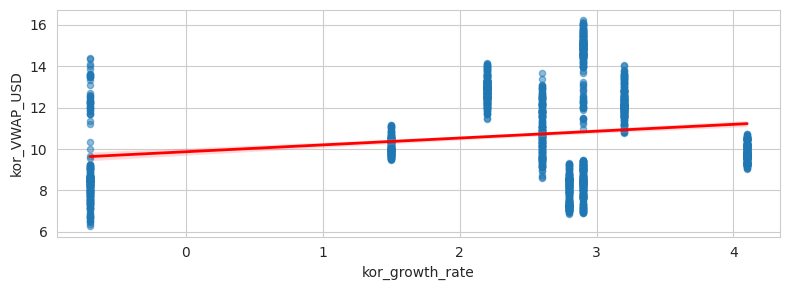

kor_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.18
p-value: 4.2434825456774975e-17



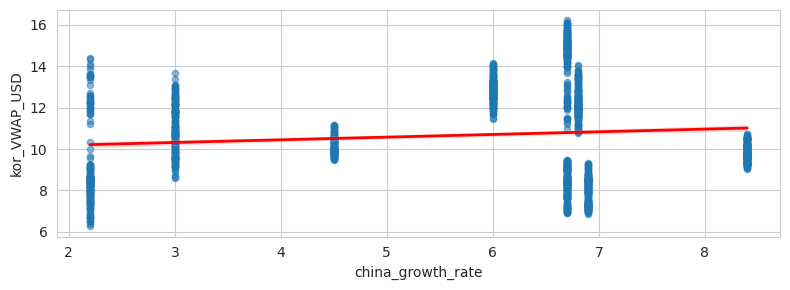

china_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.11
p-value: 9.626036239903437e-07



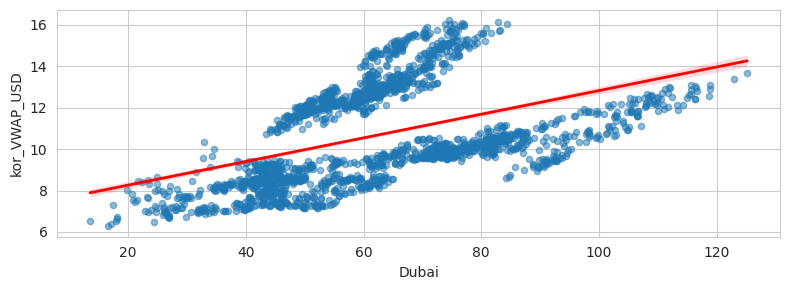

Dubai와 kor_VWAP_USD 사이의 상관계수 : 0.46
p-value: 7.443640648164306e-108



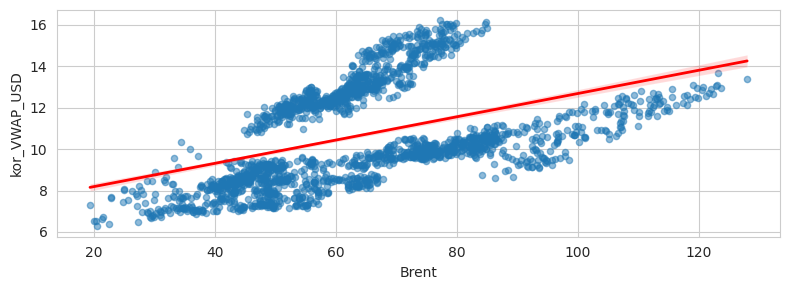

Brent와 kor_VWAP_USD 사이의 상관계수 : 0.45
p-value: 8.391703849813405e-102



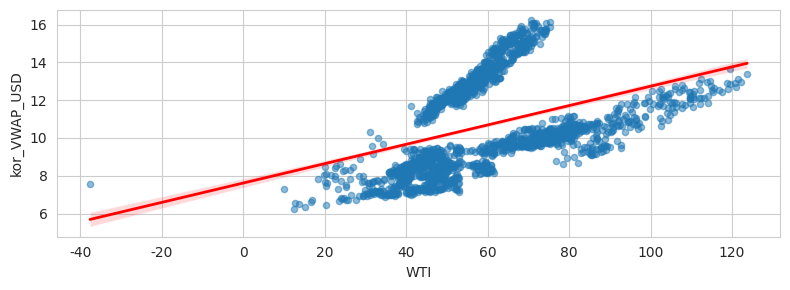

WTI와 kor_VWAP_USD 사이의 상관계수 : 0.40
p-value: 5.66170776422752e-79



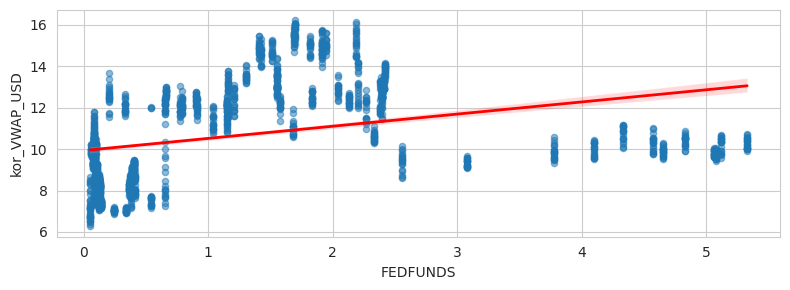

FEDFUNDS와 kor_VWAP_USD 사이의 상관계수 : 0.35
p-value: 1.6742396029947055e-60



In [125]:
import scipy.stats as stats

def draw_two(df, col_list):
    for col in col_list:
        plt.figure(figsize=(8, 3))
        sns.set_style("whitegrid")  # 배경 스타일 설정
        sns.regplot(y='kor_VWAP_USD', x=col, data=df, scatter_kws={'s':20, 'alpha':0.5}, line_kws={'color':'red', 'lw':2})

        plt.xlabel(col)
        plt.ylabel('kor_VWAP_USD')

        plt.tight_layout()
        plt.show()

        # 상관계수 및 p-value 계산
        corr_coef, p_value = stats.pearsonr(df[col], df['kor_Close_USD'])

        # 상관계수 및 p-value 출력
        print(f'{col}와 kor_VWAP_USD 사이의 상관계수 : {corr_coef:.2f}')
        print(f'p-value: {p_value}\n')

draw_two(ak, check_two)

In [126]:
# Pearson 상관계수 계산
correlation_matrix = ak[check_one].corr()

correlation_matrix

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
EPS_28,1.000000,0.242415,0.138622,-0.036286,0.119926,0.028225,-0.148998,0.023902,-0.017817,-0.111261,0.056744,0.069899,0.056394,0.022882
VWAP,0.242415,1.000000,0.837529,0.262480,0.589567,-0.020303,0.131168,0.142063,0.183388,-0.190046,0.804999,0.806668,0.826328,0.532297
ATR,0.138622,0.837529,1.000000,0.032494,0.719473,-0.171744,-0.060963,0.396716,-0.052903,-0.417799,0.657151,0.660933,0.679701,0.423037
growth_rate,-0.036286,0.262480,0.032494,1.000000,-0.215490,0.175587,0.215556,-0.180287,0.958356,0.819112,0.346904,0.362968,0.367736,-0.062343
USD/KRW,0.119926,0.589567,0.719473,-0.215490,1.000000,-0.128720,-0.239673,0.232034,-0.254964,-0.566648,0.435203,0.429088,0.437618,0.545560
kor_EPS_USD,0.028225,-0.020303,-0.171744,0.175587,-0.128720,1.000000,0.211260,-0.060169,0.143001,0.163331,0.084221,0.079095,0.070105,-0.029737
kor_VWAP_USD,-0.148998,0.131168,-0.060963,0.215556,-0.239673,0.211260,1.000000,0.334778,0.183019,0.107003,0.458128,0.446305,0.396805,0.349986
kor_ATR_USD,0.023902,0.142063,0.396716,-0.180287,0.232034,-0.060169,0.334778,1.000000,-0.204621,-0.376297,0.278130,0.277350,0.250447,0.129964
kor_growth_rate,-0.017817,0.183388,-0.052903,0.958356,-0.254964,0.143001,0.183019,-0.204621,1.000000,0.828889,0.246692,0.272245,0.287573,-0.146148
china_growth_rate,-0.111261,-0.190046,-0.417799,0.819112,-0.566648,0.163331,0.107003,-0.376297,0.828889,1.000000,-0.166836,-0.155473,-0.150392,-0.248039


In [127]:
correlation_matrix[['kor_VWAP_USD']].T

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
kor_VWAP_USD,-0.148998,0.131168,-0.060963,0.215556,-0.239673,0.21126,1.0,0.334778,0.183019,0.107003,0.458128,0.446305,0.396805,0.349986


## XLRE % +0.6
  + XLRE : Real Estate
    + 부동산, 부동산업 관련 회사


### NH에서 준 정보를 활용한 상관관계 분석


In [296]:
#XLRE
stock_name= ['삼성FN리츠','한화리츠', 'KB스타리츠', '마스턴프리미어리츠', '코람코더원리츠']
stock_code =['448730', '451800', '432320', '357430', '417310']

# etf = ['T', 'VZ', 'CHTR', 'CMCSA', 'TMUS']
etf = ['XLRE']
#
year = '2023'
date = '0101'

find_best_R(etf, stock_name, stock_code, year, date, 0)

['거래일자', '시가', '고가', '저가', '종가', '거래량']
주식 받아오기 끝
가능한 조합: 31
상관계수 : 0.01843449919230828, p-value : 0.6734509992545973 ['한화리츠']
end


In [129]:
nasdaq_data.loc[nasdaq_data['sector_name'] == 'XLRE', 'fc_sec_krl_nm'].unique()

array(['SBA 커뮤니케이션스                                                 ',
       '리젠시 센터스                                                     ',
       '이퀴닉스                                                        ',
       'CoStar Grp                                                  ',
       'Host Hotels                                                 '],
      dtype=object)

### 주식 중 XLRE에 해당하는 주식 찾기
+ 미국
  + AMT : 아메리칸 타워
  + PLD : 프롤로지스
  + CCI : 크라운캐슬
  + EQIX : 에퀴닉스
  + PSA : 퍼블릭 스토리지
+ 한국
  + 448730 : 삼성FN리츠
  + 451800 : 한화리츠
  + 432320 : KB스타리츠
  + 357430 : 마스턴프리미어리츠
  + 417310 : 코람코더원리츠
    + 리츠(Real Estate Investment Trust)란 부동산투자회사법 제2조제1호에 따라 다수의 투자자로부터 자금을 모아 부동산 및 부동산 관련 증권 등에 투자·운영하고 그 수익을 투자자에게 돌려주는 부동산 간접투자기구인 주식회사.

In [459]:
list(sector_info.loc[sector_info['sector_name']=='XLRE', 'comanpy_name'].unique())

['Host Hotels & Resorts Inc',
 'Welltower Inc',
 'Simon Property Group A',
 'Crown Castle Inc.',
 'Essex Property Trust',
 'Digital Realty Trust',
 'Weyerhaeuser Co',
 'Mid-America Apt Communties',
 'Equinix Inc',
 'SBA Communications Corp',
 'Costar Group Inc',
 'VICI Properties Inc.',
 'Kimco Realty Corp',
 'AvalonBay Communities Inc',
 'Public Storage',
 'Regency Centers Corp',
 'CBRE Group Inc.',
 'Camden Property Trust',
 'Ventas Inc',
 'American Tower Corp A',
 'Alexandria Real Estate Eqty',
 'Invitation Homes',
 'Healthpeak Properties Inc.',
 'Federal Realty Invt Trust',
 'UDR Inc',
 'Realty Income Corp',
 'ProLogis Inc',
 'Iron Mountain Inc',
 'Boston Properties Inc',
 'Extra Space Storage Inc',
 'Equity Residential']

In [460]:
#조사할 데이터
#america_list = ['AMT', 'PLD', 'CCI', 'EQIX', 'PSA']
america_list = list(sector_info.loc[sector_info['sector_name']=='XLRE', 'tck_iem_cd'].unique())
#korea_list = ['448730', '451800', '432320', '357430', '417310']# TIGER 리츠부동산인프라 '329200'
korea_list = ['329200']

In [461]:
stock = fdr.DataReader('329200', '2020-01-01', '2023-08-31')
stock.head()

,Open,High,Low,Close,Volume,Change
Date,,,,,,
2020-01-02,4291,4312,4278,4306,286866,-0.002086
2020-01-03,4303,4303,4258,4282,133916,-0.005574
2020-01-06,4254,4268,4226,4238,686208,-0.010276
2020-01-07,4226,4252,4216,4225,967755,-0.003067
2020-01-08,4217,4225,4156,4163,770935,-0.014675


In [462]:
ak = return_ak(america_list, korea_list)

In [463]:
ak.head()

,Open,High,Low,Close,Volume,EPS_28,VWAP,ATR,kor_open,kor_high,...,Dubai,Brent,WTI,kor_Open_USD,kor_High_USD,kor_Low_USD,kor_Close_USD,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD
Date,,,,,,,,,,,,,,,,,,,,,
2019-07-19,51.355001,51.399998,50.310001,50.360002,2632750.0,-0.059686,50.8563,0.937857,4056,4108,...,61.55,62.47,55.63,3.464387,3.508802,3.464387,3.518197,0.001327,3.488943,0.044415
2019-07-22,50.365000,50.660002,50.055000,50.260001,3769600.0,-0.055464,50.3350,0.888214,4099,4132,...,62.74,63.26,56.22,3.488184,3.516267,3.474568,3.517969,0.001024,3.499247,0.042975
2019-07-23,50.390000,50.795002,49.995000,50.785000,2494300.0,-0.016861,50.4913,0.848571,4140,4166,...,62.11,63.83,56.77,3.524124,3.546256,3.509653,3.552215,0.000909,3.533062,0.040859
2019-07-24,50.915000,50.960001,50.149997,50.469998,2423550.0,-0.056950,50.6237,0.851786,4160,4163,...,63.21,63.18,55.88,3.535010,3.537559,3.528212,3.537559,0.000696,3.534585,0.035053
2019-07-25,50.360001,50.494999,49.930000,50.174998,2034500.0,-0.066171,50.2400,0.776429,4152,4152,...,63.03,63.39,56.02,3.528962,3.528962,3.499214,3.525562,0.000541,3.520675,0.035868


In [464]:
ak[['kor_close']].describe().T

,count,mean,std,min,25%,50%,75%,max
kor_close,986.0,4559.395538,608.896112,2912.0,4116.0,4444.0,5129.0,5897.0


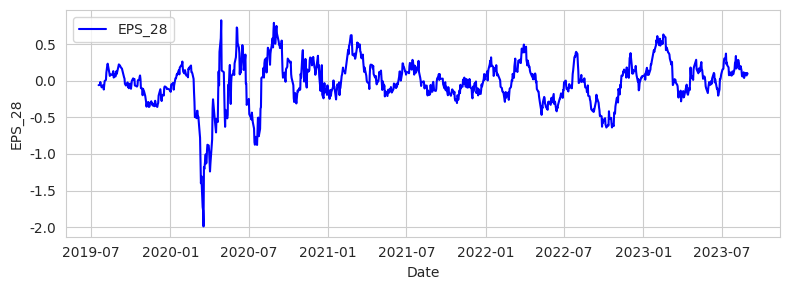

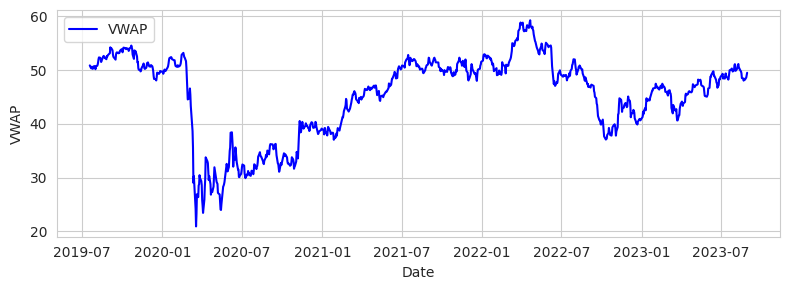

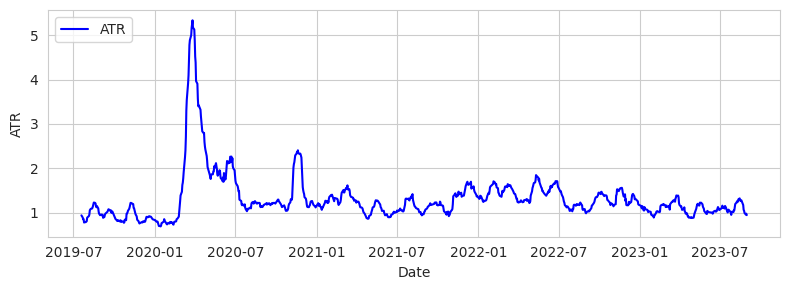

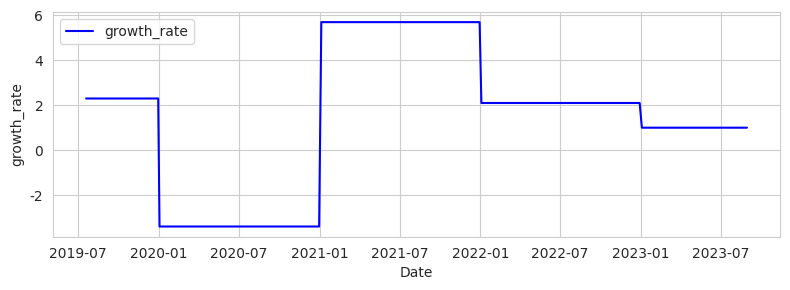

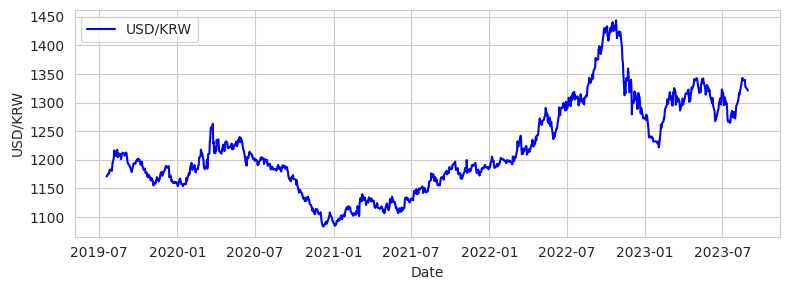

...

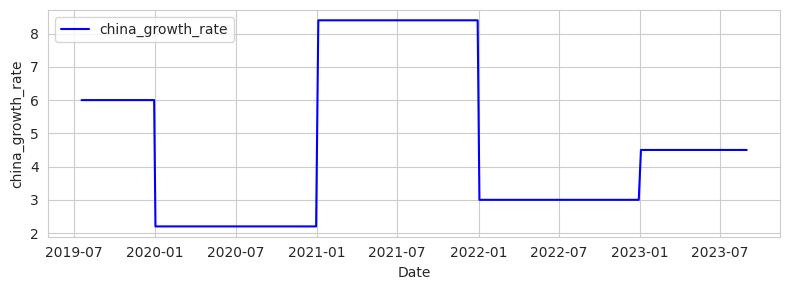

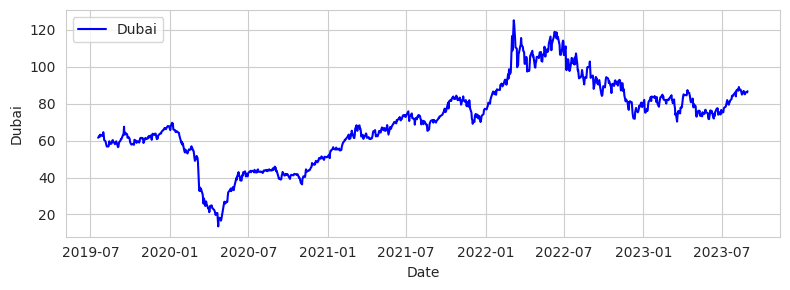

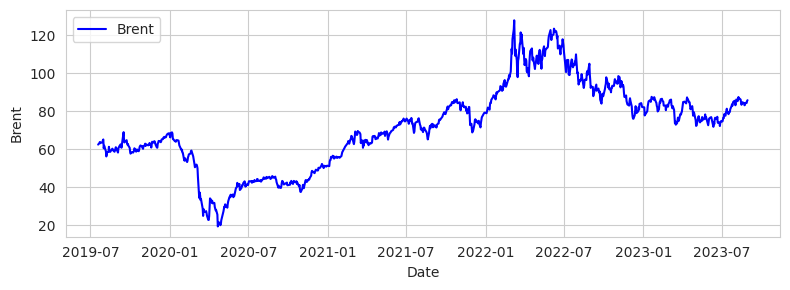

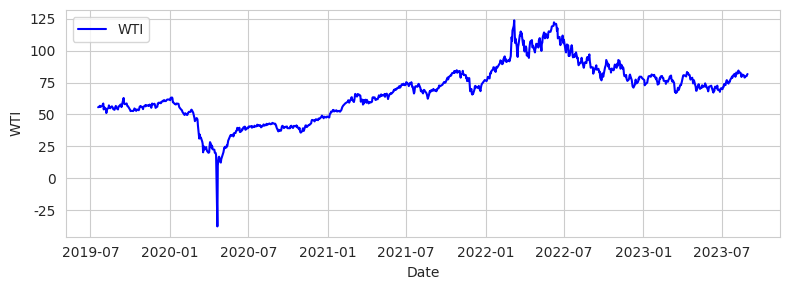

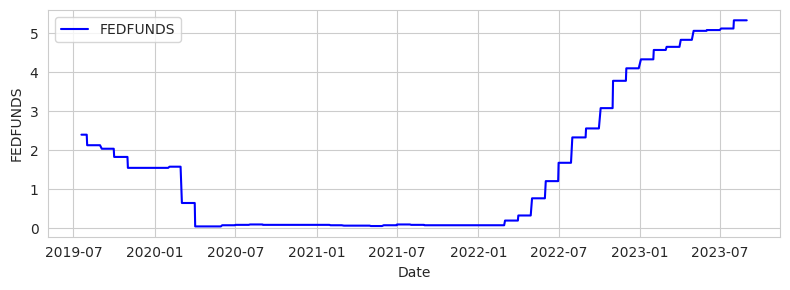

In [465]:
draw_one(ak, check_one)

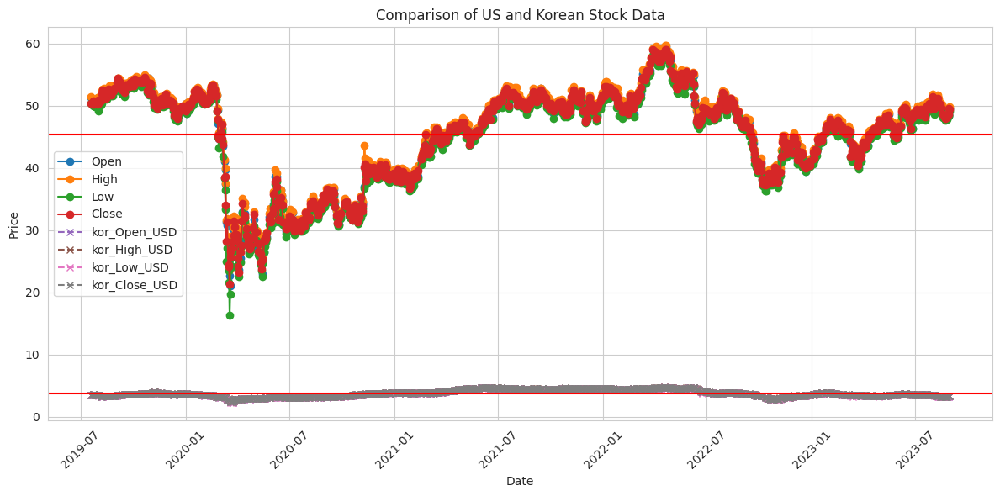

In [466]:
# 미국의 데이터를 라인 플롯으로 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Open'], label='Open', marker='o')
plt.plot(ak.index, ak['High'], label='High', marker='o')
plt.plot(ak.index, ak['Low'], label='Low', marker='o')
plt.plot(ak.index, ak['Close'], label='Close', marker='o')

# 한국의 데이터를 라인 플롯으로 그리기
plt.plot(ak.index, ak['kor_Open_USD'], label='kor_Open_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_High_USD'], label='kor_High_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Low_USD'], label='kor_Low_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Close_USD'], label='kor_Close_USD', linestyle='--', marker='x')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.axhline(y=((ak['Open']+ak['High']+ak['Low']+ak['Close'])/4).mean(), color='red')
plt.axhline(y=((ak['kor_Open_USD']+ak['kor_High_USD']+ak['kor_Low_USD']+ak['kor_Close_USD'])/4).mean(), color='red')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

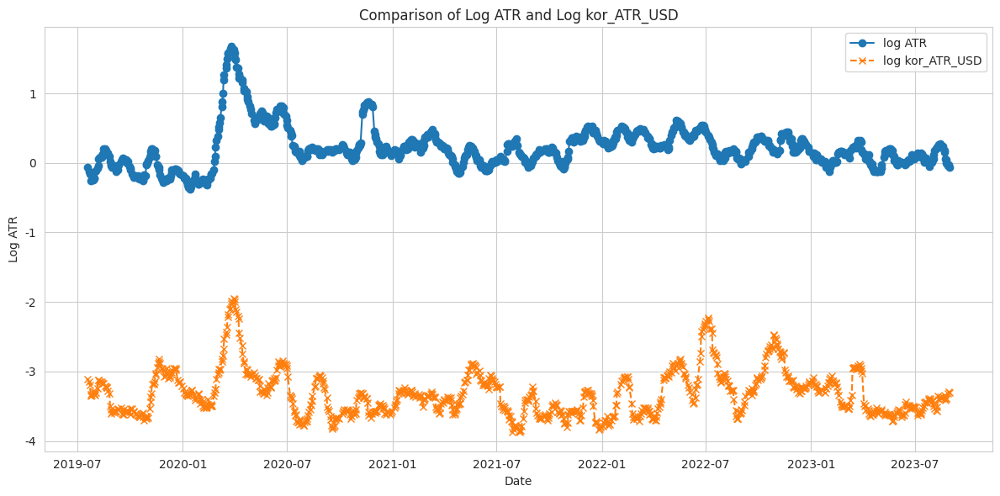

In [467]:
import matplotlib.pyplot as plt
import numpy as np

# 미국의 ATR 데이터
us_atr = ak['ATR']

# 한국의 kor_ATR_USD 데이터
kor_atr_usd = ak['kor_ATR_USD']

# 로그 스케일 적용
log_us_atr = np.log(us_atr)
log_kor_atr_usd = np.log(kor_atr_usd)

# 그래프 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, log_us_atr, label='log ATR', marker='o')
plt.plot(ak.index, log_kor_atr_usd, label='log kor_ATR_USD', linestyle='--', marker='x')

plt.title('Comparison of Log ATR and Log kor_ATR_USD')
plt.xlabel('Date')
plt.ylabel('Log ATR')
plt.legend()
plt.tight_layout()
plt.show()

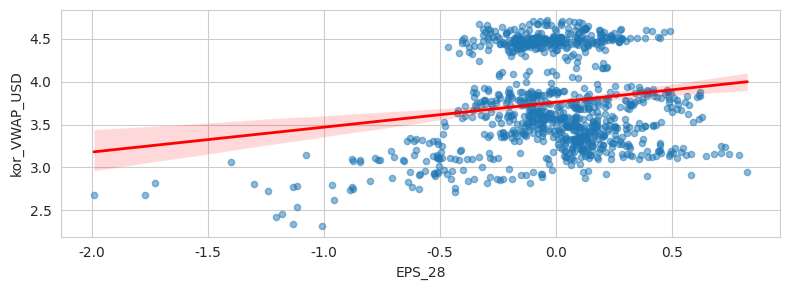

EPS_28와 kor_VWAP_USD 사이의 상관계수 : 0.17
p-value: 7.779770755744172e-08



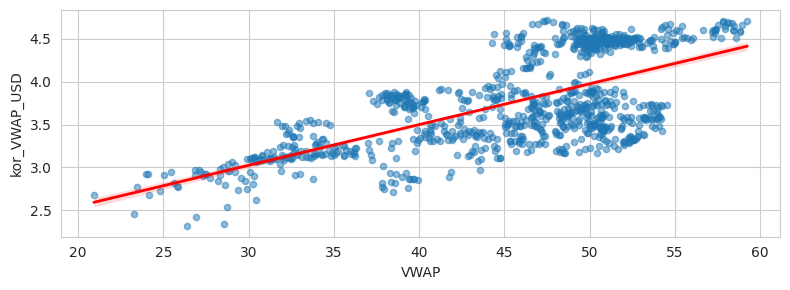

VWAP와 kor_VWAP_USD 사이의 상관계수 : 0.67
p-value: 3.5991872489250175e-127



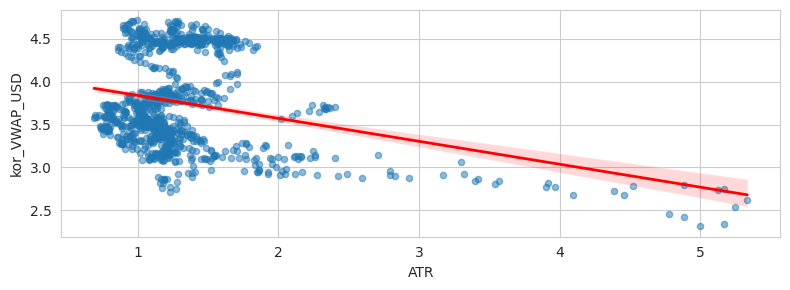

ATR와 kor_VWAP_USD 사이의 상관계수 : -0.28
p-value: 1.696370550824738e-19



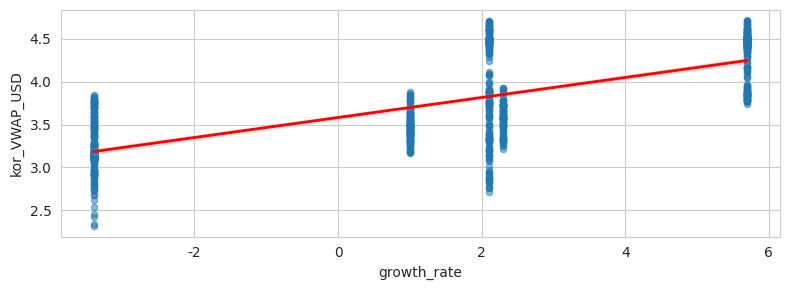

growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.69
p-value: 9.598572807662914e-142



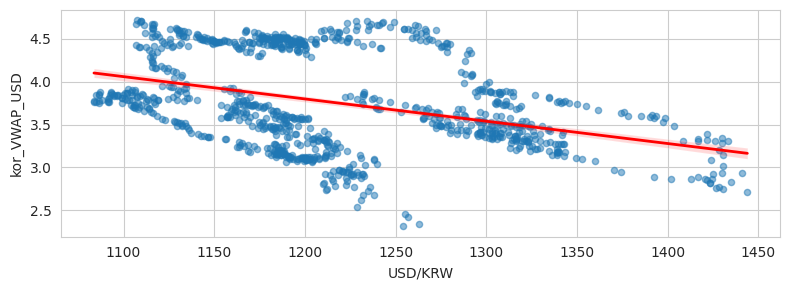

USD/KRW와 kor_VWAP_USD 사이의 상관계수 : -0.38
p-value: 5.5056372513288506e-36



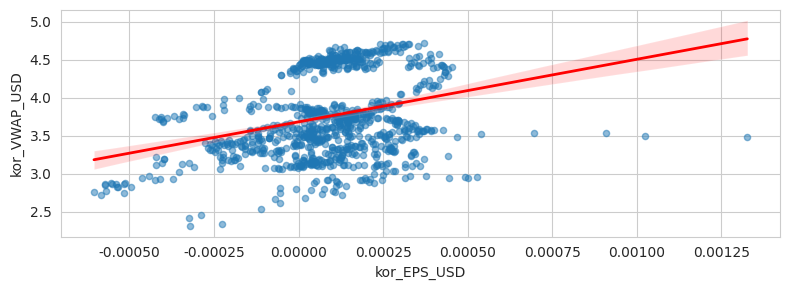

kor_EPS_USD와 kor_VWAP_USD 사이의 상관계수 : 0.30
p-value: 4.037381700427527e-22



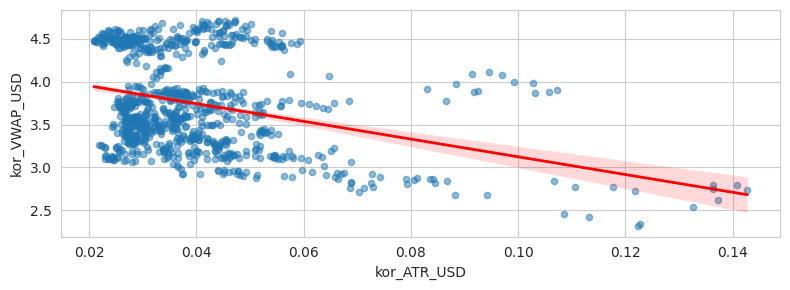

kor_ATR_USD와 kor_VWAP_USD 사이의 상관계수 : -0.32
p-value: 6.771202743526638e-25



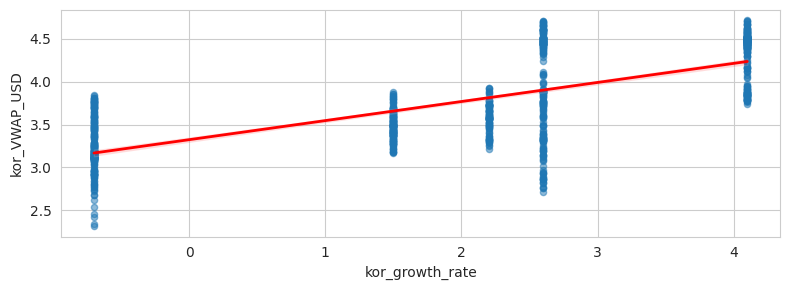

kor_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.71
p-value: 7.831534018184067e-151



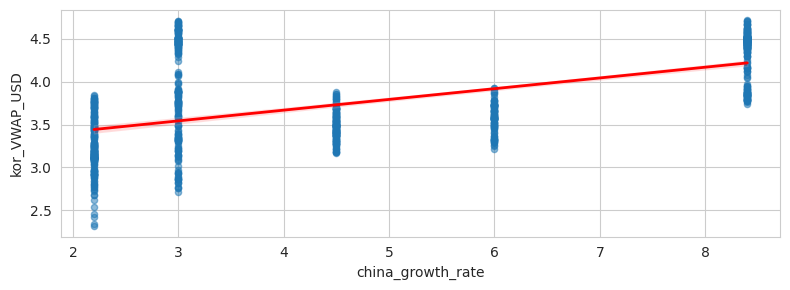

china_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.55
p-value: 1.365789833329618e-80



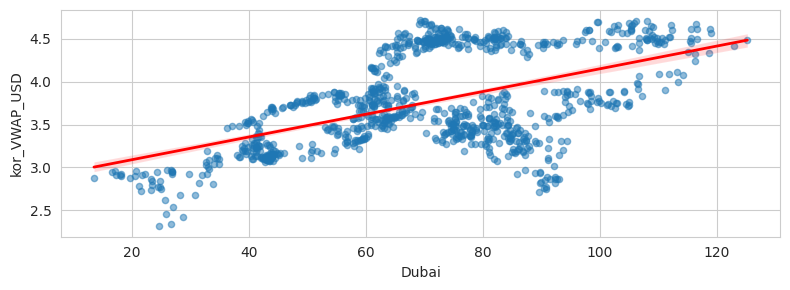

Dubai와 kor_VWAP_USD 사이의 상관계수 : 0.52
p-value: 7.758939872278323e-70



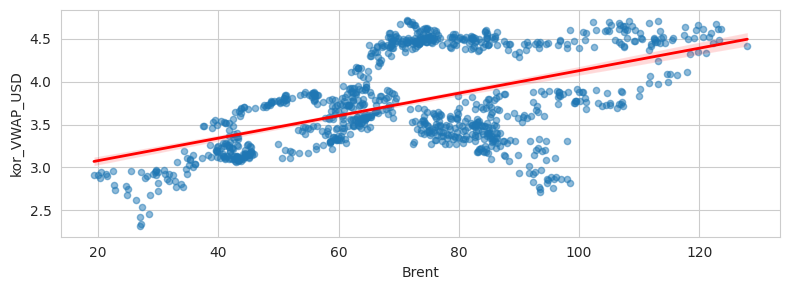

Brent와 kor_VWAP_USD 사이의 상관계수 : 0.53
p-value: 3.62229973174649e-71



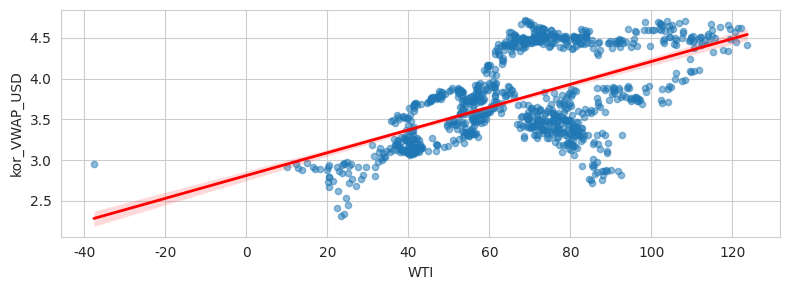

WTI와 kor_VWAP_USD 사이의 상관계수 : 0.56
p-value: 2.2587071665428558e-82



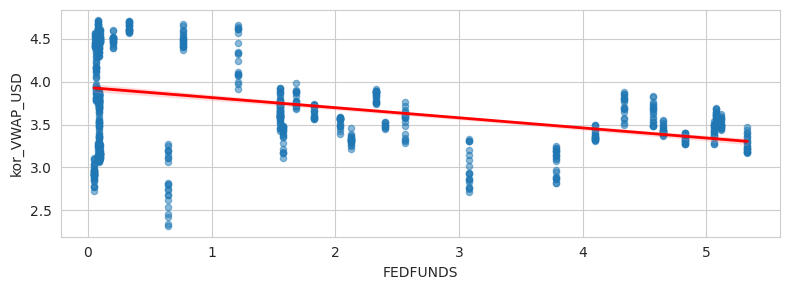

FEDFUNDS와 kor_VWAP_USD 사이의 상관계수 : -0.39
p-value: 5.208353140362018e-38



In [468]:
draw_two(ak, check_two)

In [469]:
# Pearson 상관계수 계산
correlation_matrix = ak[check_one].corr()

correlation_matrix

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
EPS_28,1.000000,0.259675,-0.451060,0.091774,-0.161550,0.180305,0.168836,-0.463412,0.076223,0.114414,0.101860,0.097642,0.103930,0.099508
VWAP,0.259675,1.000000,-0.506163,0.579682,0.032602,0.089106,0.666169,-0.308986,0.586995,0.386119,0.696796,0.686061,0.683401,0.164235
ATR,-0.451060,-0.506163,1.000000,-0.318719,0.033390,-0.047443,-0.284014,0.649847,-0.300058,-0.293029,-0.335860,-0.313900,-0.312942,-0.248777
growth_rate,0.091774,0.579682,-0.318719,1.000000,-0.108034,0.065283,0.693094,-0.169909,0.993720,0.863416,0.505119,0.507453,0.517895,-0.052555
USD/KRW,-0.161550,0.032602,0.033390,-0.108034,1.000000,-0.558642,-0.380506,0.257227,-0.062286,-0.423777,0.496026,0.494355,0.456110,0.719471
kor_EPS_USD,0.180305,0.089106,-0.047443,0.065283,-0.558642,1.000000,0.295117,-0.293627,0.037220,0.232841,-0.299109,-0.291527,-0.274912,-0.392667
kor_VWAP_USD,0.168836,0.666169,-0.284014,0.693094,-0.380506,0.295117,1.000000,-0.320044,0.708684,0.553905,0.524633,0.528781,0.562729,-0.391362
kor_ATR_USD,-0.463412,-0.308986,0.649847,-0.169909,0.257227,-0.293627,-0.320044,1.000000,-0.142037,-0.252160,-0.066262,-0.045340,-0.061767,0.000535
kor_growth_rate,0.076223,0.586995,-0.300058,0.993720,-0.062286,0.037220,0.708684,-0.142037,1.000000,0.806766,0.561978,0.566938,0.576613,-0.068033
china_growth_rate,0.114414,0.386119,-0.293029,0.863416,-0.423777,0.232841,0.553905,-0.252160,0.806766,1.000000,0.079979,0.074446,0.093215,-0.168911


In [470]:
correlation_matrix[['kor_VWAP_USD']].T

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
kor_VWAP_USD,0.168836,0.666169,-0.284014,0.693094,-0.380506,0.295117,1.0,-0.320044,0.708684,0.553905,0.524633,0.528781,0.562729,-0.391362


+ 변동성이 상당히 적음
+ 하지만 변동 모양은 미국 XLRE 모양과 유사
+ 원유, 경제성장률 등에 영향을 많이 받음
+ 수익성이 떨어질것 같음

## XLK % +0.5
  + XLk : Technology
    + 기술, 기술회사들이 있는 섹터


### NH에서 준 정보를 활용한 상관관계 분석


In [297]:
#XLK
stock_name= ['SK하이닉스' ,'삼성전자', '삼성SDI', '삼성전기', '삼성SDS', '네이버', '삼성전자우', 'LG화학', 'LG애너지솔루션', '카카오']
stock_code =['000660', '005930', '006400', '009150', '018260', '035420', '005935', '051910', '373220', '035720']

etf = ['XLK']

year = '2023'
date = '0101'

find_best_R(etf, stock_name, stock_code, year, date, 0)

['거래일자', '시가', '고가', '저가', '종가', '거래량']
주식 받아오기 끝
가능한 조합: 1023
상관계수 : 0.09393239961830444, p-value : 1.6968972445640156e-15 ['SK하이닉스']
상관계수 : 0.09466492056655185, p-value : 1.0229887253377056e-15 ['SK하이닉스' '삼성전자']
end


In [298]:
nasdaq_data.loc[nasdaq_data['sector_name'] == 'XLK', 'fc_sec_krl_nm'].unique()

array(['엔비디아                                                        ',
       '인튜이트                                                        ',
       '인텔                                                          ',
       '애널로그 디바이시스                                                  ',
       'PTC                                                         ',
       'Roper Tech                                                  ',
       '넷앱                                                          ',
       '스카이웍스 솔루션스                                                  ',
       '마이크로소프트                                                     ',
       '코보                                                          ',
       '오토데스크                                                       ',
       '코그니전트 테크놀로지 솔루션                                             ',
       'Palo Alto                                                   ',
       '어도비                                                         ',
      

### 주식 중 XLK에 해당하는 주식 찾기
+ 미국
  + AAPL : 애플
  + MSFT : 마이크로소프트
  + NVDA : 엔비디아
  + AVGO : 브로드컴(반도체 및 인프라)
  + ADBE : 어도비
+ 한국
    + 000660 : SK하이닉스
    + 005930 : 삼성전자
    + 006400 : 삼성SDI
    + 009150 : 삼성전기
    + 018260 : 삼성SDS
    + 035420 : 네이버
    + 005935 : 삼성전자우
    + 051910 : LG화학
    + 373220 : LG애너지솔루션
    + 035720 : 카카오
        + https://www.samsungfund.com/etf/product/view.do?id=2ETF82
        + 대한민국 대표 수출 산업인 IT 산업, 국내 전기전자/IT하드웨어/반도체 산업

In [458]:
list(sector_info.loc[sector_info['sector_name']=='XLK', 'comanpy_name'].unique())

['QUALCOMM Inc',
 'Qorvo, Inc',
 'EPAM Systems Inc',
 'Nvidia Corp',
 'Skyworks Solutions Inc',
 'Advanced Micro Devices',
 'First Solar Inc',
 'Teradyne Inc',
 'DXC Technology Company',
 'Enphase Energy Inc',
 'ServiceNow Inc.',
 'Monolithic Power Systems',
 'Autodesk Inc',
 'KLA Corporation',
 'Apple Inc.',
 'On Semiconductor Corp',
 'NXP Semiconductor NV',
 'VeriSign Inc',
 'Broadcom Inc',
 'Arista Networks Inc',
 'Gartner Inc',
 'Microchip Technology Inc',
 'Zebra Technologies Corp',
 'Texas Instruments Inc',
 'Intel Corp',
 'Applied Materials Inc',
 'Accenture plc A',
 'Cadence Design Systems Inc',
 'Lam Research Corp',
 'Synopsys Inc',
 'Cognizant Tech Solutions Corp',
 'Microsoft Corp',
 'PTC Inc',
 'Tyler Technologies Inc',
 'Akamai Technologies Inc',
 'Fair Isaac & Co Inc',
 'TE Connectivity Ltd.',
 'Analog Devices Inc',
 'Salesforce, Inc.',
 'Intuit Inc',
 'Amphenol Corp A',
 'F5, Inc.',
 'Juniper Networks Inc',
 'Trimble Inc',
 'Keysight Technologies Inc',
 'Cisco Systems In

In [152]:
#조사할 데이터
#america_list = ['AAPL', 'MSFT', 'NVDA', 'AVGO', 'ADBE']
america_list = list(sector_info.loc[sector_info['sector_name']=='XLB', 'tck_iem_cd'].unique())
korea_list = ['000660', '005930', '006400', '009150', '018260', '035420', '005935', '051910', '373220', '035720']

In [153]:
ak = return_ak(america_list, korea_list)

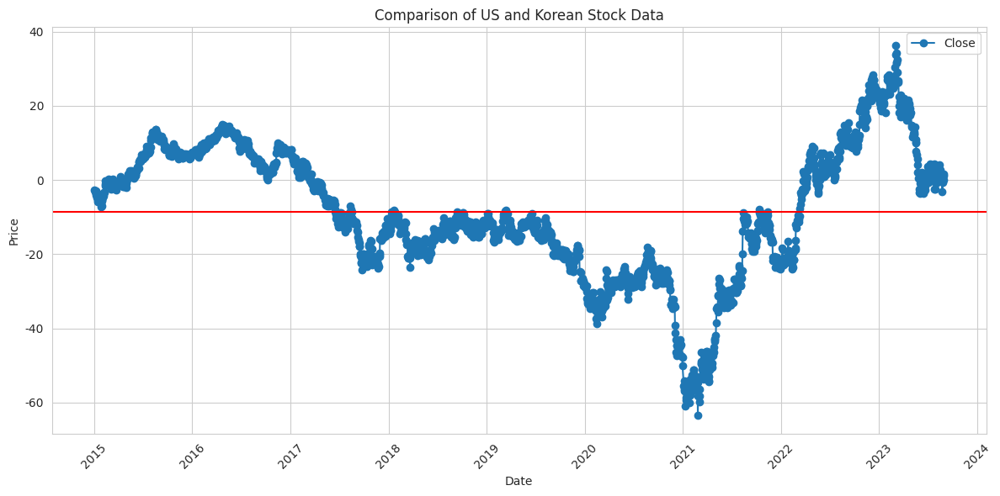

In [154]:
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Close'] - ak['kor_Close_USD'], label='Close', marker='o')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.axhline(y=(ak['Close'] - ak['kor_Close_USD']).mean(), color='red')
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

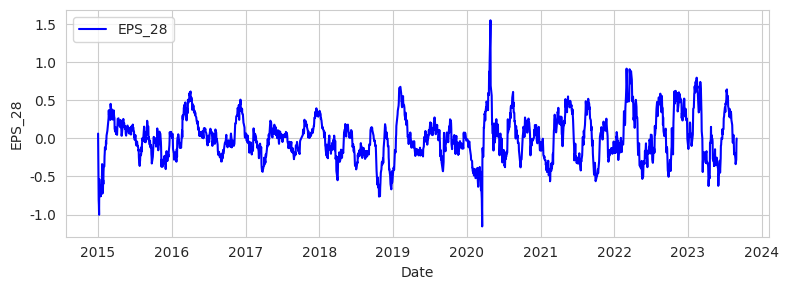

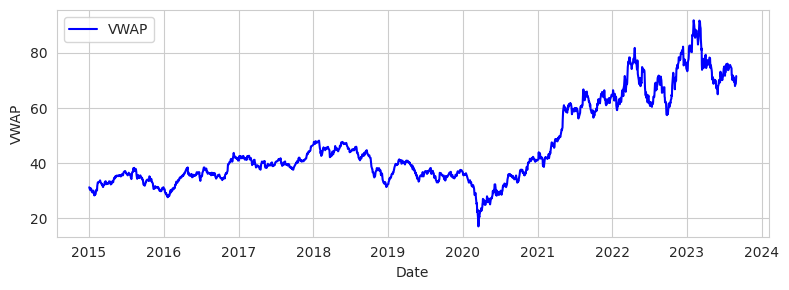

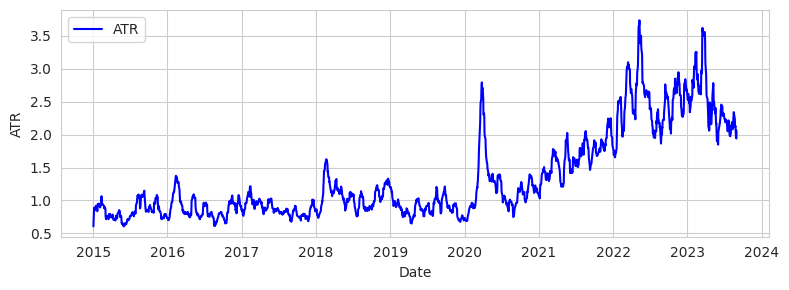

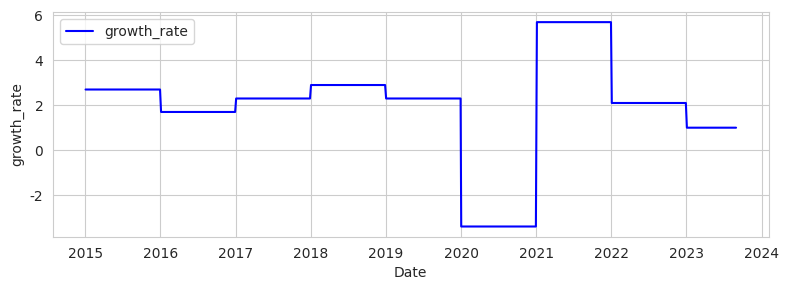

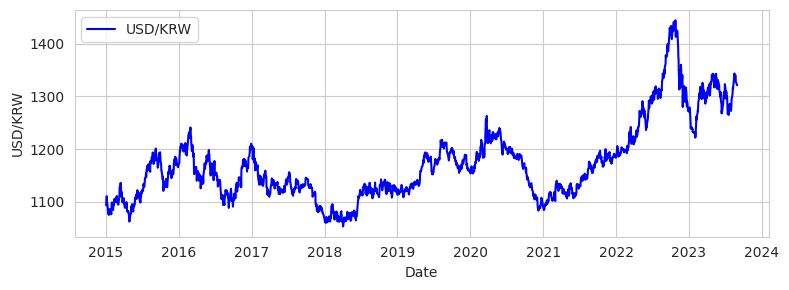

...

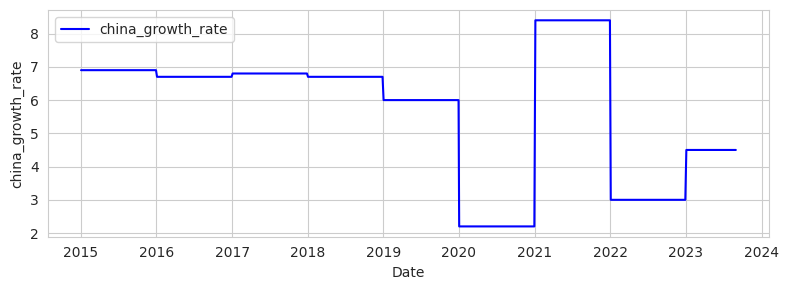

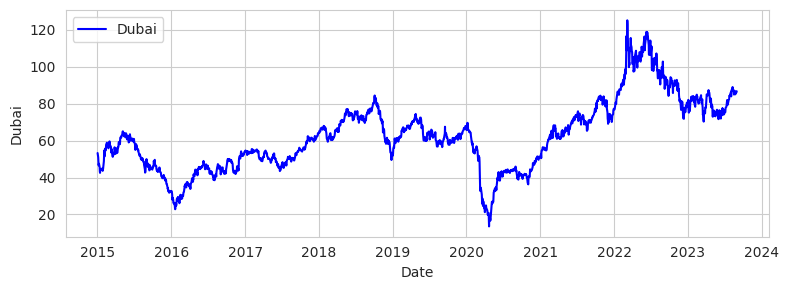

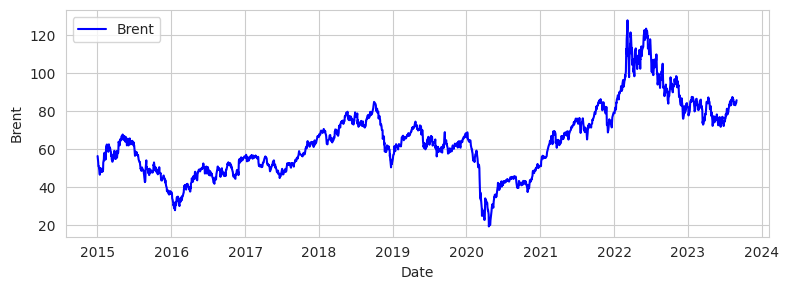

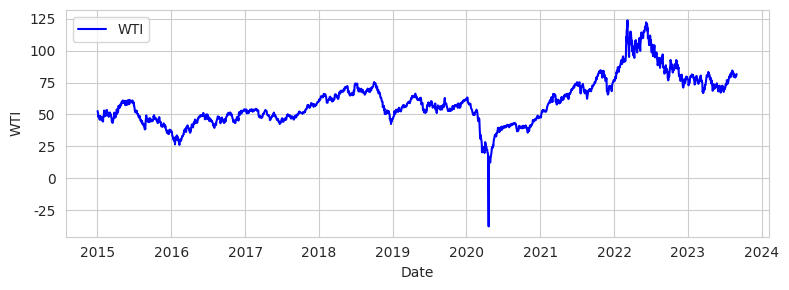

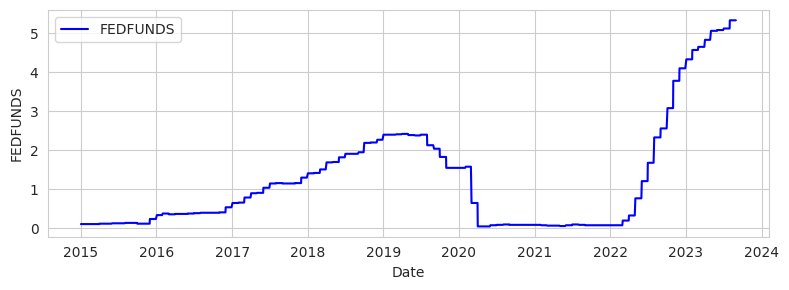

In [155]:
draw_one(ak, check_one)

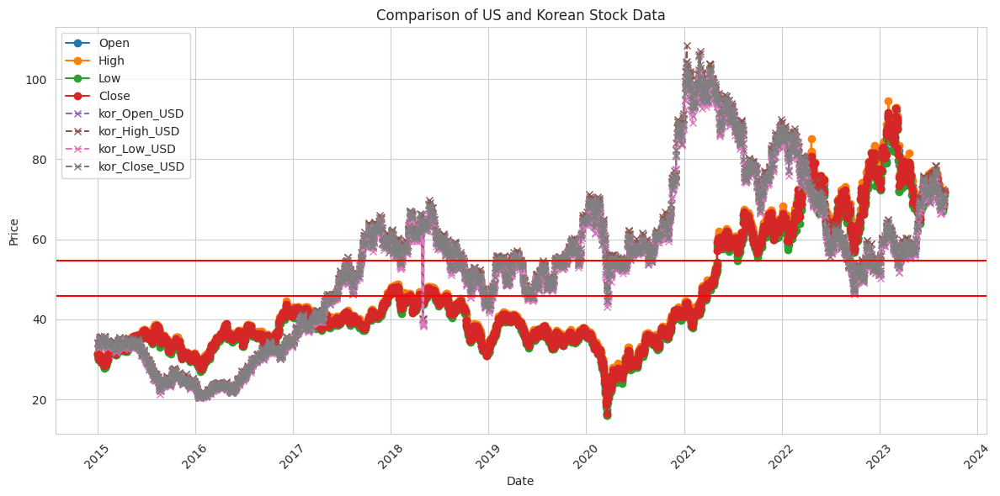

In [156]:
# 미국의 데이터를 라인 플롯으로 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Open'], label='Open', marker='o')
plt.plot(ak.index, ak['High'], label='High', marker='o')
plt.plot(ak.index, ak['Low'], label='Low', marker='o')
plt.plot(ak.index, ak['Close'], label='Close', marker='o')

# 한국의 데이터를 라인 플롯으로 그리기
plt.plot(ak.index, ak['kor_Open_USD'], label='kor_Open_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_High_USD'], label='kor_High_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Low_USD'], label='kor_Low_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Close_USD'], label='kor_Close_USD', linestyle='--', marker='x')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.axhline(y=((ak['Open']+ak['High']+ak['Low']+ak['Close'])/4).mean(), color='red')
plt.axhline(y=((ak['kor_Open_USD']+ak['kor_High_USD']+ak['kor_Low_USD']+ak['kor_Close_USD'])/4).mean(), color='red')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

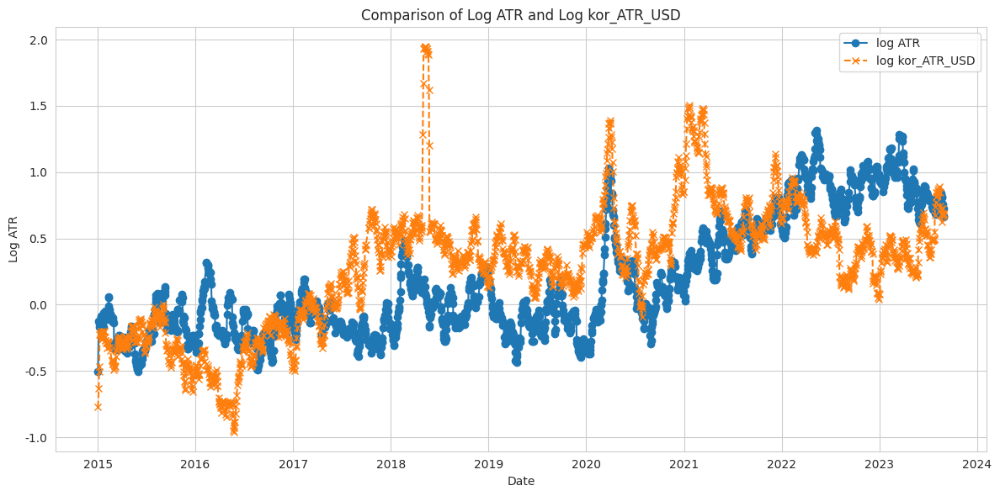

In [157]:
import matplotlib.pyplot as plt
import numpy as np

# 미국의 ATR 데이터
us_atr = ak['ATR']

# 한국의 kor_ATR_USD 데이터
kor_atr_usd = ak['kor_ATR_USD']

# 로그 스케일 적용
log_us_atr = np.log(us_atr)
log_kor_atr_usd = np.log(kor_atr_usd)

# 그래프 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, log_us_atr, label='log ATR', marker='o')
plt.plot(ak.index, log_kor_atr_usd, label='log kor_ATR_USD', linestyle='--', marker='x')

plt.title('Comparison of Log ATR and Log kor_ATR_USD')
plt.xlabel('Date')
plt.ylabel('Log ATR')
plt.legend()
plt.tight_layout()
plt.show()

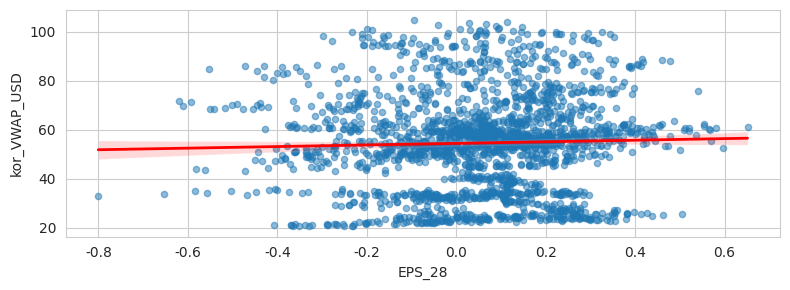

EPS_28와 kor_VWAP_USD 사이의 상관계수 : 0.03
p-value: 0.1768711509085003



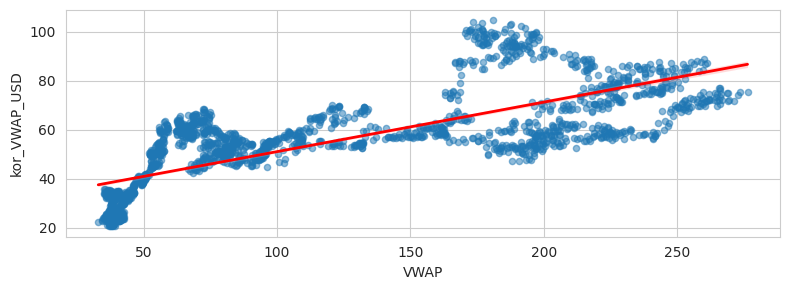

VWAP와 kor_VWAP_USD 사이의 상관계수 : 0.77
p-value: 0.0



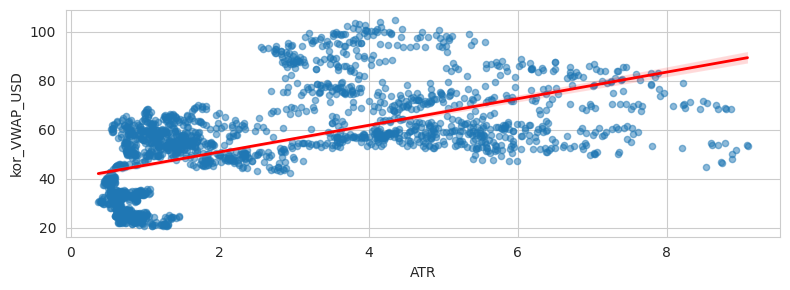

ATR와 kor_VWAP_USD 사이의 상관계수 : 0.59
p-value: 1.8007022758016386e-195



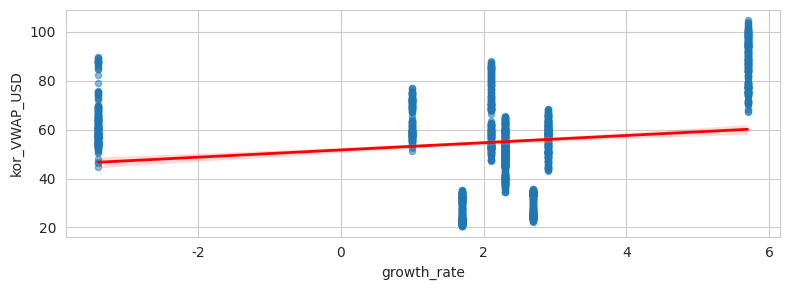

growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.17
p-value: 1.6536433818824664e-15



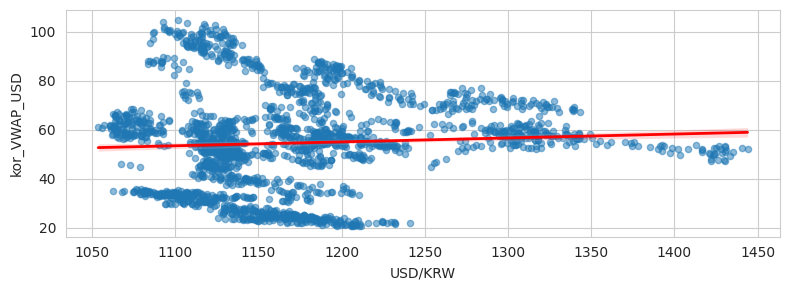

USD/KRW와 kor_VWAP_USD 사이의 상관계수 : 0.06
p-value: 0.006715931224053616



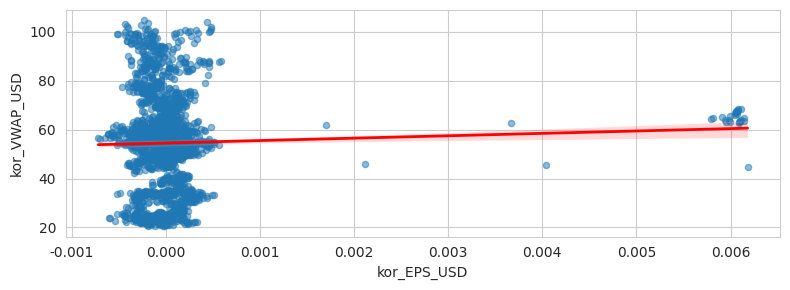

kor_EPS_USD와 kor_VWAP_USD 사이의 상관계수 : 0.04
p-value: 0.04462826231788908



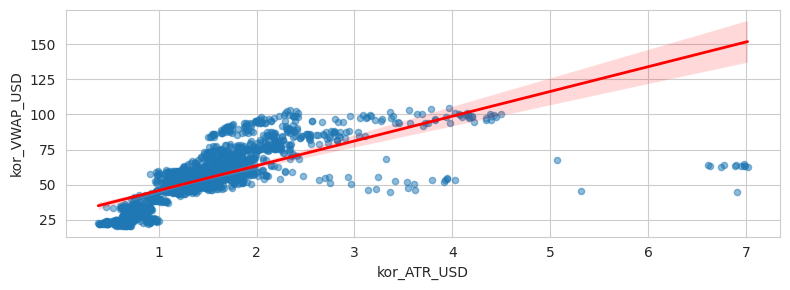

kor_ATR_USD와 kor_VWAP_USD 사이의 상관계수 : 0.72
p-value: 0.0



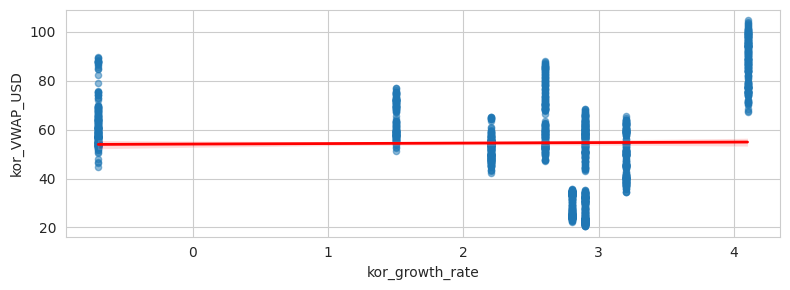

kor_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.01
p-value: 0.5432027211065505



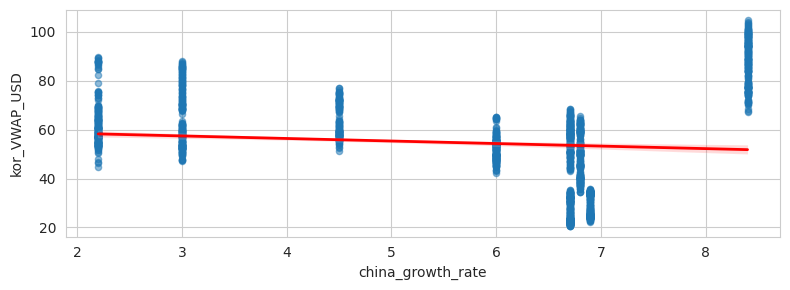

china_growth_rate와 kor_VWAP_USD 사이의 상관계수 : -0.10
p-value: 2.697484612834717e-06



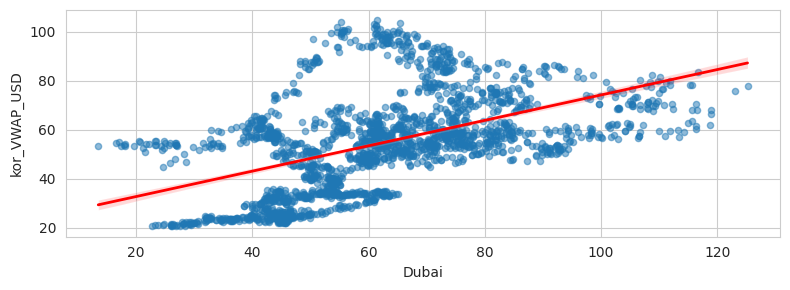

Dubai와 kor_VWAP_USD 사이의 상관계수 : 0.50
p-value: 4.30318514974291e-132



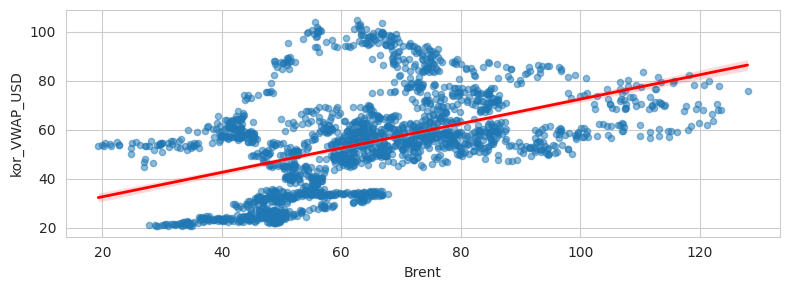

Brent와 kor_VWAP_USD 사이의 상관계수 : 0.48
p-value: 1.1177248995750783e-117



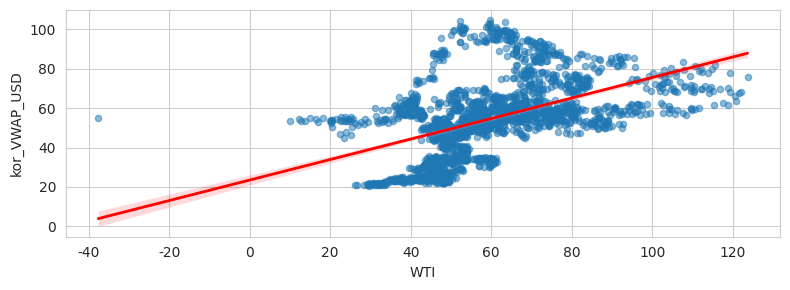

WTI와 kor_VWAP_USD 사이의 상관계수 : 0.49
p-value: 4.776546485770615e-123



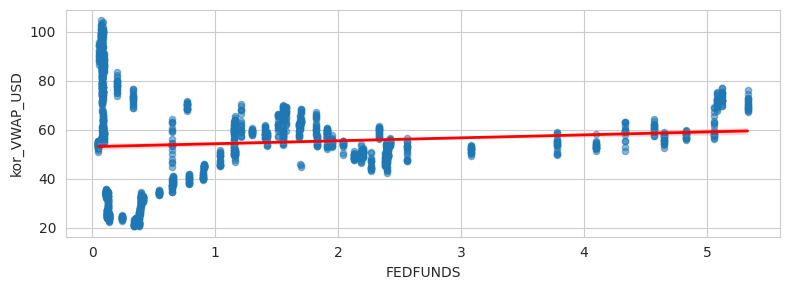

FEDFUNDS와 kor_VWAP_USD 사이의 상관계수 : 0.09
p-value: 6.561025920992444e-05



In [ ]:
draw_two(ak, check_two)

In [158]:
# Pearson 상관계수 계산
correlation_matrix = ak[check_one].corr()

correlation_matrix

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
EPS_28,1.000000,0.242415,0.138622,-0.036286,0.119926,0.000727,0.024515,-0.009551,-0.017817,-0.111261,0.056744,0.069899,0.056394,0.022882
VWAP,0.242415,1.000000,0.837529,0.262480,0.589567,-0.013507,0.503712,0.242742,0.183388,-0.190046,0.804999,0.806668,0.826328,0.532297
ATR,0.138622,0.837529,1.000000,0.032494,0.719473,-0.071285,0.452171,0.322069,-0.052903,-0.417799,0.657151,0.660933,0.679701,0.423037
growth_rate,-0.036286,0.262480,0.032494,1.000000,-0.215490,0.008990,0.173887,0.088950,0.958356,0.819112,0.346904,0.362968,0.367736,-0.062343
USD/KRW,0.119926,0.589567,0.719473,-0.215490,1.000000,-0.140841,0.060996,-0.034406,-0.254964,-0.566648,0.435203,0.429088,0.437618,0.545560
kor_EPS_USD,0.000727,-0.013507,-0.071285,0.008990,-0.140841,1.000000,0.035610,0.398143,0.020297,0.036235,0.046794,0.049720,0.031512,0.070089
kor_VWAP_USD,0.024515,0.503712,0.452171,0.173887,0.060996,0.035610,1.000000,0.713558,0.013318,-0.103348,0.501067,0.475998,0.485550,0.086535
kor_ATR_USD,-0.009551,0.242742,0.322069,0.088950,-0.034406,0.398143,0.713558,1.000000,-0.028877,-0.073426,0.285755,0.270742,0.265583,0.040764
kor_growth_rate,-0.017817,0.183388,-0.052903,0.958356,-0.254964,0.020297,0.013318,-0.028877,1.000000,0.828889,0.246692,0.272245,0.287573,-0.146148
china_growth_rate,-0.111261,-0.190046,-0.417799,0.819112,-0.566648,0.036235,-0.103348,-0.073426,0.828889,1.000000,-0.166836,-0.155473,-0.150392,-0.248039


In [159]:
correlation_matrix[['kor_VWAP_USD']].T

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
kor_VWAP_USD,0.024515,0.503712,0.452171,0.173887,0.060996,0.03561,1.0,0.713558,0.013318,-0.103348,0.501067,0.475998,0.48555,0.086535


+ 그냥 기술 자체로는 관련이 없어 보임
+ 기업들의 업계 동향 및 파트너십 조사가 필요할듯

### 협력업체 조사


#### 애플
+ 삼성전자와 SK하이닉스, LG화학, LG디스플레이, LG이노텍, LX세미콘, 삼성SDI

In [165]:
stock = fdr.DataReader('AAPL', '2023-01-01', '2023-08-31')
stock.head()

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2023-01-03,130.279999,130.899994,124.169998,125.070000,124.538658,112117500
2023-01-04,126.889999,128.660004,125.080002,126.360001,125.823189,89113600
2023-01-05,127.129997,127.769997,124.760002,125.019997,124.488876,80962700
2023-01-06,126.010002,130.289993,124.889999,129.619995,129.069321,87754700
2023-01-09,130.470001,133.410004,129.889999,130.149994,129.597061,70790800


In [200]:
apple = 'AAPL'
kor = ['000660', '005930', '006400', '009150', '018260', '035420', '005935', '051910', '373220', '035720']
#['005930', '000660', '051910', '034220', '011070', '108320', '006400']

In [201]:
ak = return_ak(apple, kor)
ak.head()

,Open,High,Low,Close,Volume,EPS_28,VWAP,ATR,kor_open,kor_high,...,Dubai,Brent,WTI,kor_Open_USD,kor_High_USD,kor_Low_USD,kor_Close_USD,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD
Date,,,,,,,,,,,,,,,,,,,,,
2015-01-02,41.180000,41.310001,40.369999,40.560001,1529200.0,-1.505600,40.8550,0.940002,37374.5,37599.5,...,53.27,56.42,52.69,34.175659,34.381402,33.920081,33.993234,-0.000488,34.117594,0.461320
2015-01-05,40.320000,40.459999,39.700001,39.799999,2041800.0,-1.397650,40.0700,0.900001,37385.0,37560.0,...,50.98,53.11,50.04,33.649865,33.807381,33.195320,33.442844,-0.000517,33.523852,0.533078
2015-01-06,39.810001,40.020000,39.020000,39.180000,2080600.0,-1.459267,39.5075,0.933334,36650.0,36970.0,...,48.08,51.10,47.93,33.062697,33.351376,32.774019,33.107803,-0.000304,33.073974,0.604270
2015-01-07,39.520000,39.810001,39.290001,39.700001,3359700.0,-0.980575,39.5800,0.857501,36290.0,36910.0,...,46.60,51.15,48.65,33.072085,33.637108,32.962725,33.509522,0.000071,33.295360,0.626424
2015-01-08,40.240002,40.980000,40.180000,40.889999,2116300.0,-0.461400,40.5725,0.942000,37515.0,38390.0,...,47.50,50.96,48.79,34.172890,34.969938,33.748860,34.719437,0.000348,34.402781,0.796047


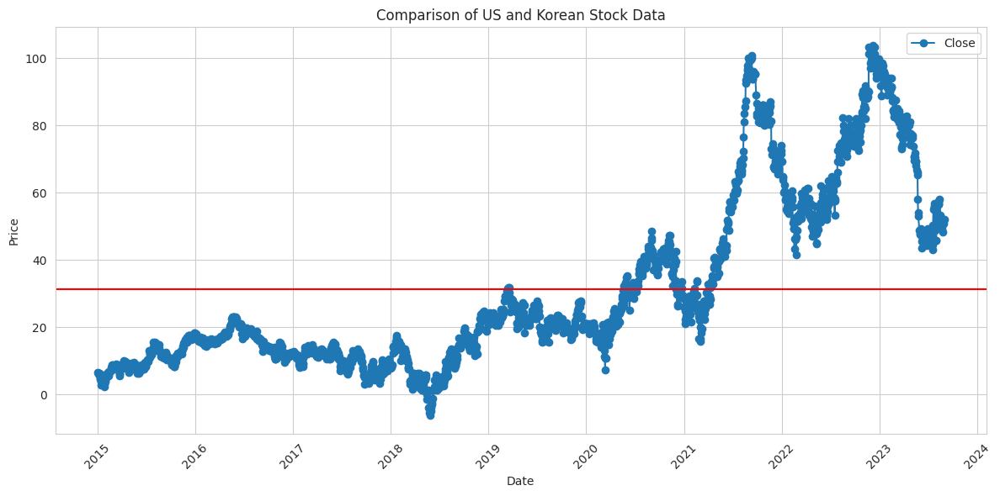

In [202]:
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Close'] - ak['kor_Close_USD'], label='Close', marker='o')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.axhline(y=(ak['Close'] - ak['kor_Close_USD']).mean(), color='red')
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

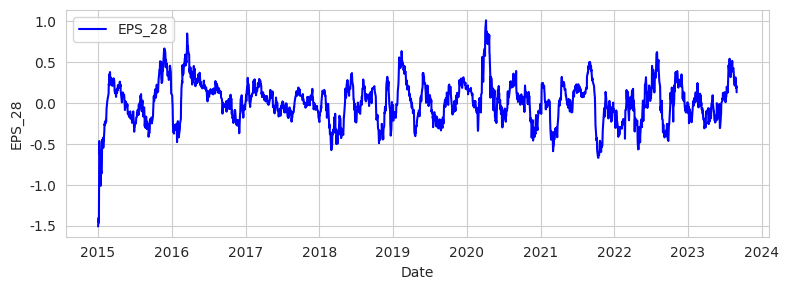

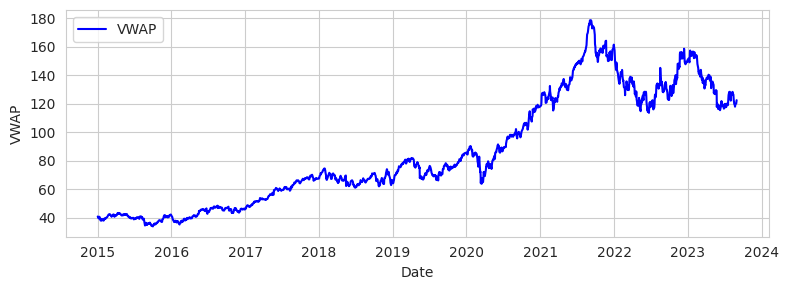

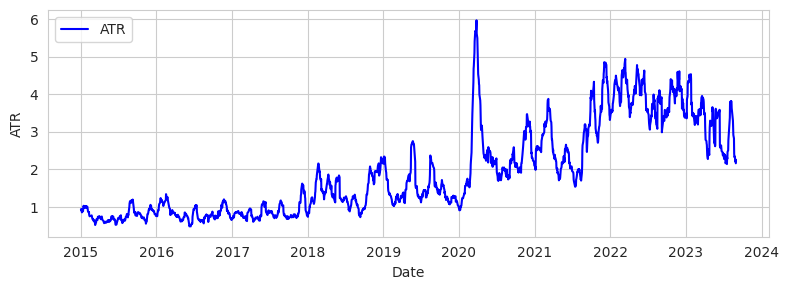

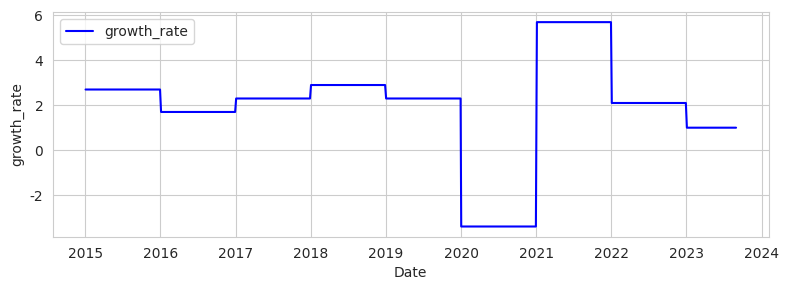

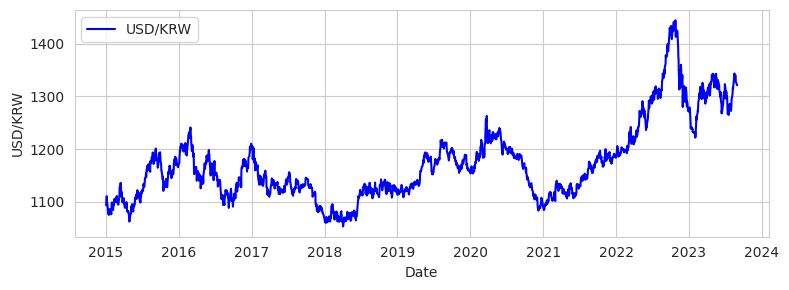

...

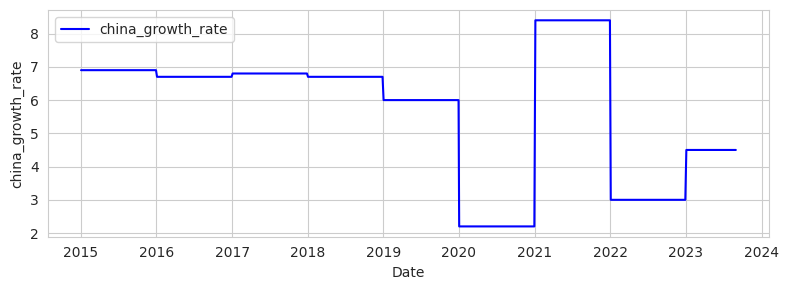

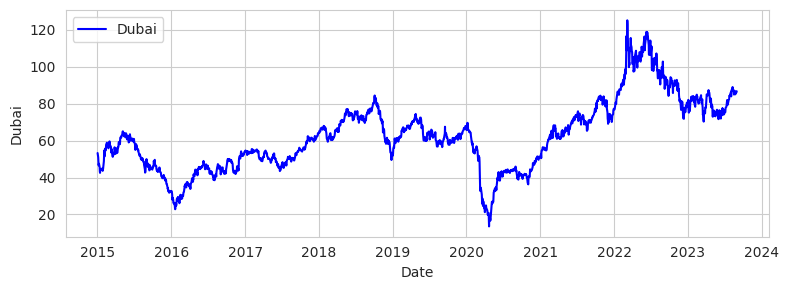

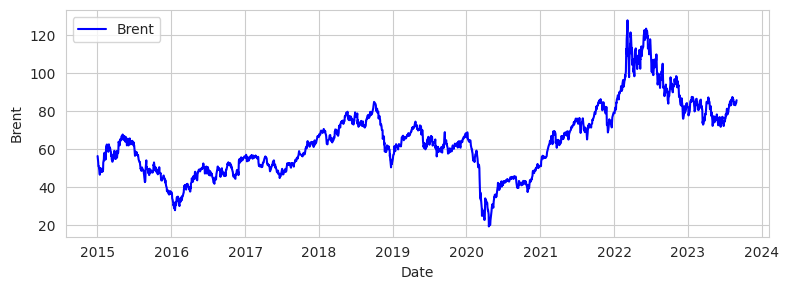

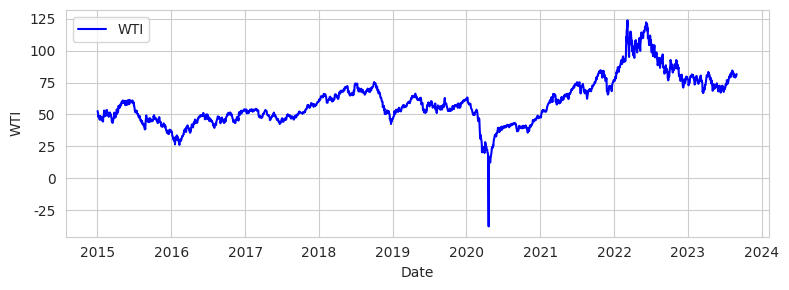

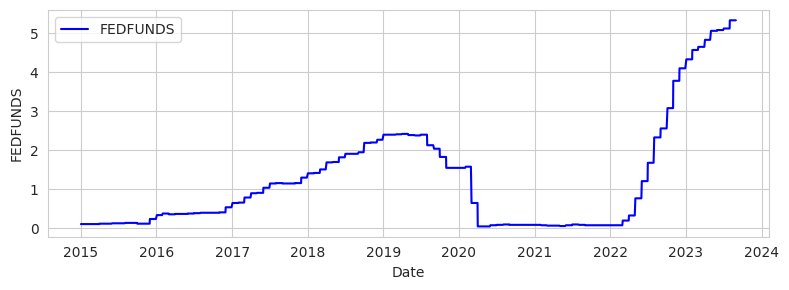

In [203]:
draw_one(ak, check_one)

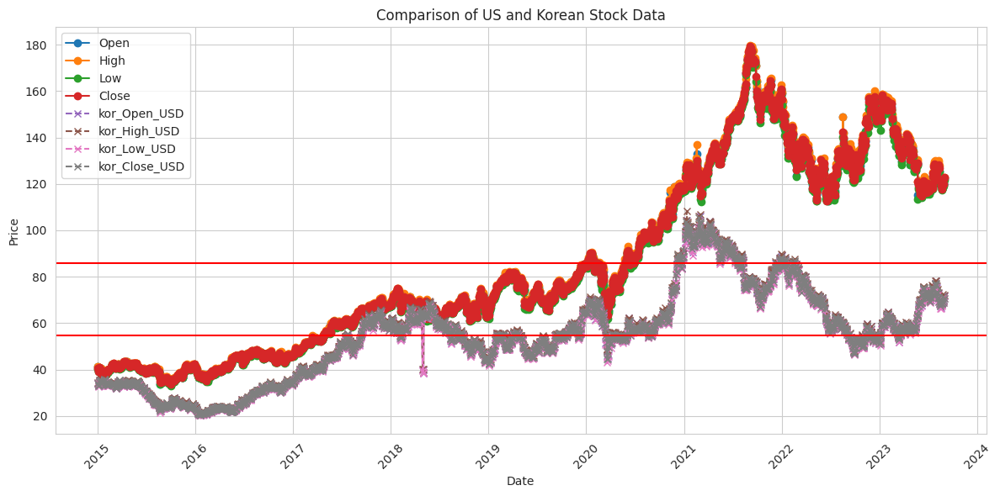

In [204]:
# 미국의 데이터를 라인 플롯으로 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Open'], label='Open', marker='o')
plt.plot(ak.index, ak['High'], label='High', marker='o')
plt.plot(ak.index, ak['Low'], label='Low', marker='o')
plt.plot(ak.index, ak['Close'], label='Close', marker='o')

# 한국의 데이터를 라인 플롯으로 그리기
plt.plot(ak.index, ak['kor_Open_USD'], label='kor_Open_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_High_USD'], label='kor_High_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Low_USD'], label='kor_Low_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Close_USD'], label='kor_Close_USD', linestyle='--', marker='x')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.axhline(y=((ak['Open']+ak['High']+ak['Low']+ak['Close'])/4).mean(), color='red')
plt.axhline(y=((ak['kor_Open_USD']+ak['kor_High_USD']+ak['kor_Low_USD']+ak['kor_Close_USD'])/4).mean(), color='red')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

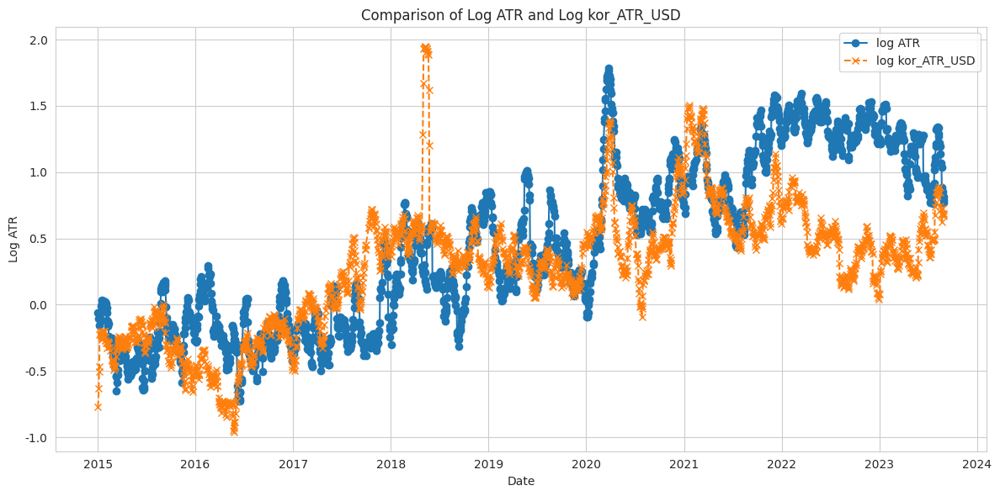

In [205]:
import matplotlib.pyplot as plt
import numpy as np

# 미국의 ATR 데이터
us_atr = ak['ATR']

# 한국의 kor_ATR_USD 데이터
kor_atr_usd = ak['kor_ATR_USD']

# 로그 스케일 적용
log_us_atr = np.log(us_atr)
log_kor_atr_usd = np.log(kor_atr_usd)

# 그래프 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, log_us_atr, label='log ATR', marker='o')
plt.plot(ak.index, log_kor_atr_usd, label='log kor_ATR_USD', linestyle='--', marker='x')

plt.title('Comparison of Log ATR and Log kor_ATR_USD')
plt.xlabel('Date')
plt.ylabel('Log ATR')
plt.legend()
plt.tight_layout()
plt.show()

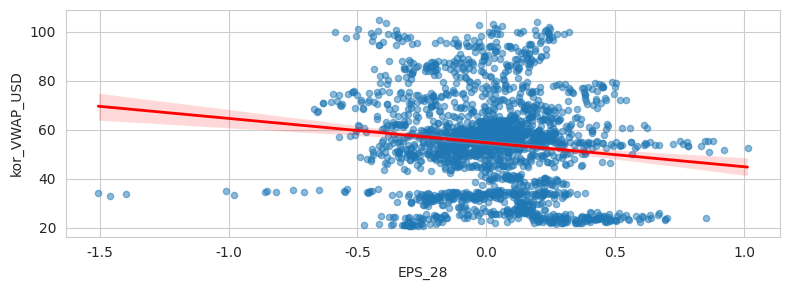

EPS_28와 kor_VWAP_USD 사이의 상관계수 : -0.13
p-value: 2.1473041197647564e-09



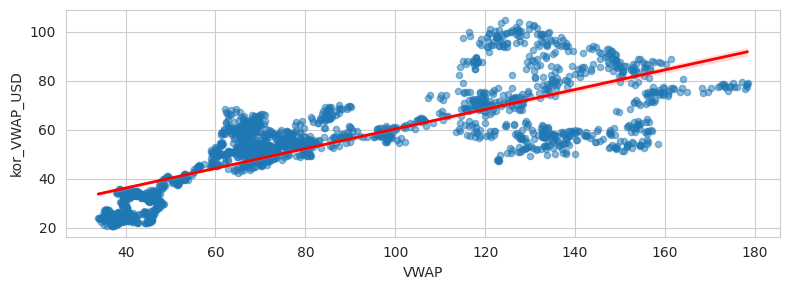

VWAP와 kor_VWAP_USD 사이의 상관계수 : 0.80
p-value: 0.0



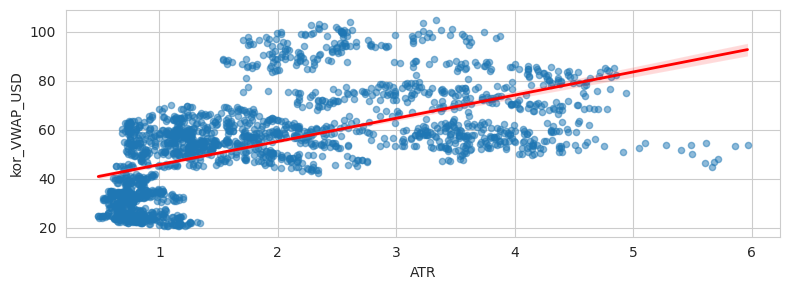

ATR와 kor_VWAP_USD 사이의 상관계수 : 0.59
p-value: 8.149658827085312e-193



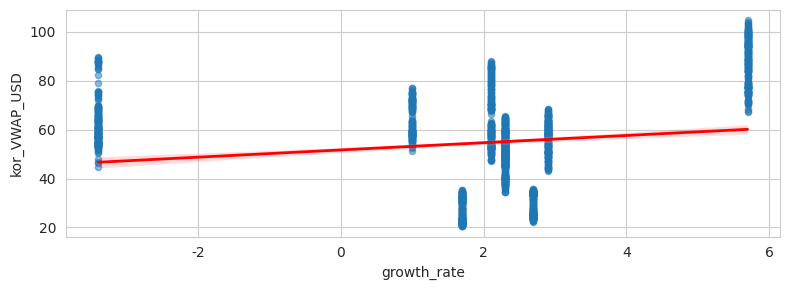

growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.17
p-value: 1.6536433818824664e-15



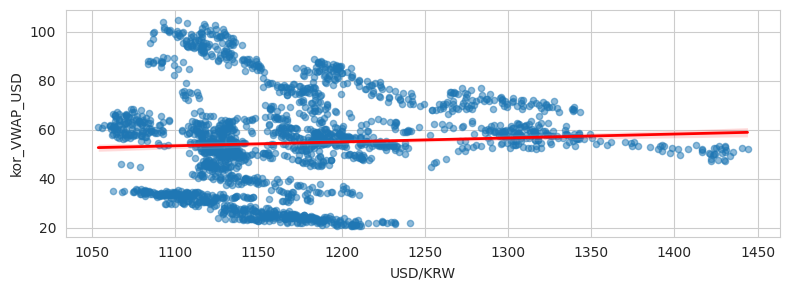

USD/KRW와 kor_VWAP_USD 사이의 상관계수 : 0.06
p-value: 0.006715931224053616



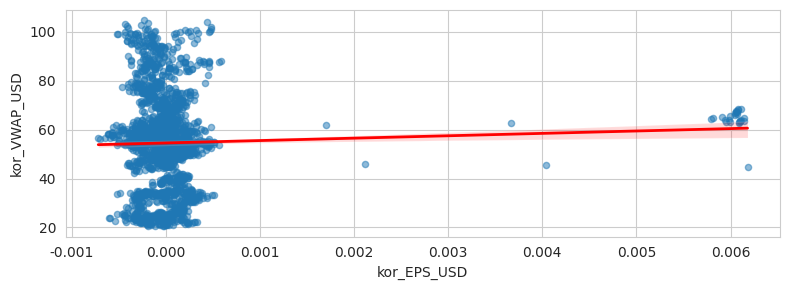

kor_EPS_USD와 kor_VWAP_USD 사이의 상관계수 : 0.04
p-value: 0.04462826231788908



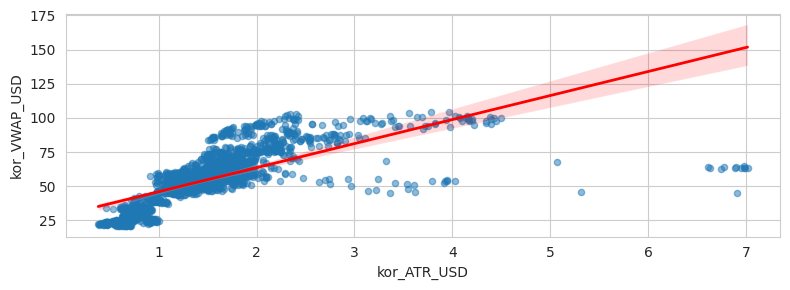

kor_ATR_USD와 kor_VWAP_USD 사이의 상관계수 : 0.72
p-value: 0.0



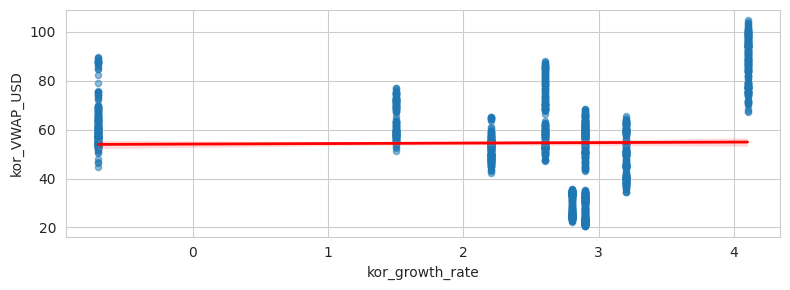

kor_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.01
p-value: 0.5432027211065505



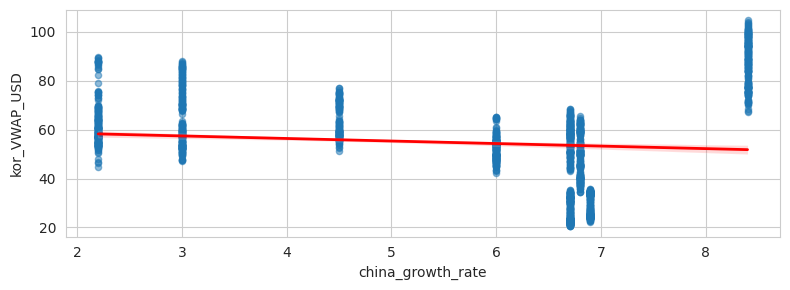

china_growth_rate와 kor_VWAP_USD 사이의 상관계수 : -0.10
p-value: 2.697484612834717e-06



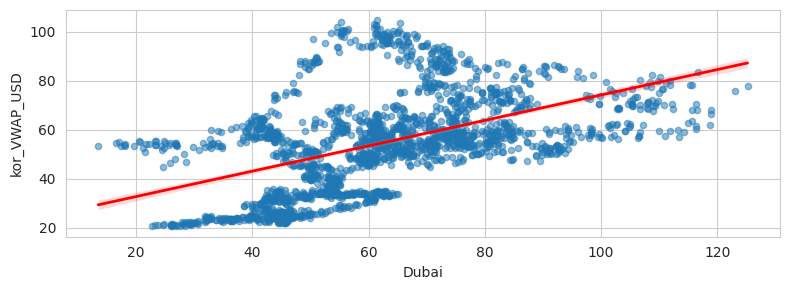

Dubai와 kor_VWAP_USD 사이의 상관계수 : 0.50
p-value: 4.30318514974291e-132



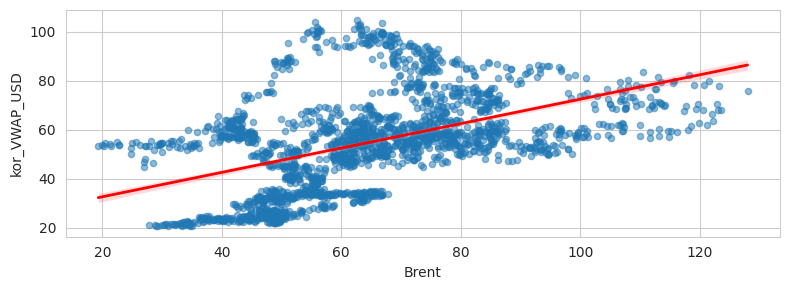

Brent와 kor_VWAP_USD 사이의 상관계수 : 0.48
p-value: 1.1177248995750783e-117



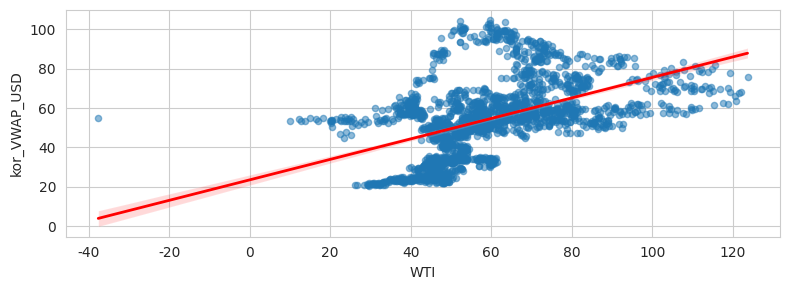

WTI와 kor_VWAP_USD 사이의 상관계수 : 0.49
p-value: 4.776546485770615e-123



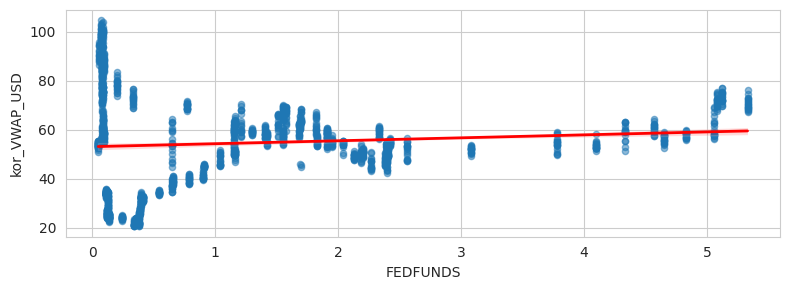

FEDFUNDS와 kor_VWAP_USD 사이의 상관계수 : 0.09
p-value: 6.561025920992444e-05



In [206]:
draw_two(ak, check_two)

In [207]:
# Pearson 상관계수 계산
correlation_matrix = ak[check_one].corr()

correlation_matrix

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
EPS_28,1.000000,-0.060131,-0.098944,-0.116796,0.077719,0.037801,-0.128671,-0.062177,-0.095586,-0.057340,-0.151780,-0.144971,-0.164758,0.017653
VWAP,-0.060131,1.000000,0.808992,0.139017,0.494934,-0.086156,0.802590,0.482122,-0.017131,-0.271375,0.642942,0.626924,0.647346,0.289594
ATR,-0.098944,0.808992,1.000000,-0.067724,0.625246,-0.062160,0.589088,0.492802,-0.185816,-0.494955,0.569972,0.565903,0.577295,0.271774
growth_rate,-0.116796,0.139017,-0.067724,1.000000,-0.215490,0.008990,0.173887,0.088950,0.958356,0.819112,0.346904,0.362968,0.367736,-0.062343
USD/KRW,0.077719,0.494934,0.625246,-0.215490,1.000000,-0.140841,0.060996,-0.034406,-0.254964,-0.566648,0.435203,0.429088,0.437618,0.545560
kor_EPS_USD,0.037801,-0.086156,-0.062160,0.008990,-0.140841,1.000000,0.035610,0.398143,0.020297,0.036235,0.046794,0.049720,0.031512,0.070089
kor_VWAP_USD,-0.128671,0.802590,0.589088,0.173887,0.060996,0.035610,1.000000,0.713558,0.013318,-0.103348,0.501067,0.475998,0.485550,0.086535
kor_ATR_USD,-0.062177,0.482122,0.492802,0.088950,-0.034406,0.398143,0.713558,1.000000,-0.028877,-0.073426,0.285755,0.270742,0.265583,0.040764
kor_growth_rate,-0.095586,-0.017131,-0.185816,0.958356,-0.254964,0.020297,0.013318,-0.028877,1.000000,0.828889,0.246692,0.272245,0.287573,-0.146148
china_growth_rate,-0.057340,-0.271375,-0.494955,0.819112,-0.566648,0.036235,-0.103348,-0.073426,0.828889,1.000000,-0.166836,-0.155473,-0.150392,-0.248039


#### 마이크로소프트

+ 이스트소프트
    + 이스트소프트(대표 정상원)가 마이크로소프트와 손잡고 AI 휴먼 기반의 글로벌 사업을 본격화
+ 440320 : 오픈놀
    + 글로벌 빅테크인 마이크로소프트(MS),엔비디아와 협력해 국내 우수 데이터(DATA), 네트워크(NETWORK), AI분야 60여 스타트업에게 마이크로소프트와 엔비디아 기술 교육을 지원
+ 303530 : 이노뎁
    + '홀로렌즈'로 대표되는 혼합현실(MR) 제품군 업데이트 내용을 발표하면서 홀로렌즈 다음 세대와 메타버스에 대한 투자가 본격화
+ 242040 : 나무기술
+ 049470 : SGA
+ 184230 : SGA 솔루션즈
+ 060850 : 영림원소프트랩
+ 258790 : 소프트캠프
    + https://finupstockstory.tistory.com/entry/%EC%B1%97GPT-MS-%EA%B4%80%EB%A0%A8%EC%A3%BC-6%EC%A2%85%EB%AA%A9-MS%ED%8C%8C%ED%8A%B8%EB%84%88%EC%82%AC#id1

In [212]:
ms = ['MSFT']
kor = ['000660', '005930', '006400', '009150', '018260', '035420', '005935', '051910', '373220', '035720']
#['440320', '047560', '303530', '242040', '049470', '184230', '060850', '258790']

In [213]:
ak = return_ak(ms, kor)
ak.head()

,Open,High,Low,Close,Volume,EPS_28,VWAP,ATR,kor_open,kor_high,...,Dubai,Brent,WTI,kor_Open_USD,kor_High_USD,kor_Low_USD,kor_Close_USD,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD
Date,,,,,,,,,,,,,,,,,,,,,
2015-01-02,46.660000,47.419998,46.540001,46.759998,27913900,0.214300,46.8450,0.879997,37374.5,37599.5,...,53.27,56.42,52.69,34.175659,34.381402,33.920081,33.993234,-0.000488,34.117594,0.461320
2015-01-05,46.369999,46.730000,46.250000,46.330002,39673900,0.064000,46.4200,0.694998,37385.0,37560.0,...,50.98,53.11,50.04,33.649865,33.807381,33.195320,33.442844,-0.000517,33.523852,0.533078
2015-01-06,46.380001,46.750000,45.540001,45.650002,36447900,-0.482000,46.0800,0.866665,36650.0,36970.0,...,48.08,51.10,47.93,33.062697,33.351376,32.774019,33.107803,-0.000304,33.073974,0.604270
2015-01-07,45.980000,46.459999,45.490002,46.230000,29114100,-0.225575,46.0400,0.892498,36290.0,36910.0,...,46.60,51.15,48.65,33.072085,33.637108,32.962725,33.509522,0.000071,33.295360,0.626424
2015-01-08,46.750000,47.750000,46.720001,47.590000,29645200,0.178900,47.2025,1.017998,37515.0,38390.0,...,47.50,50.96,48.79,34.172890,34.969938,33.748860,34.719437,0.000348,34.402781,0.796047


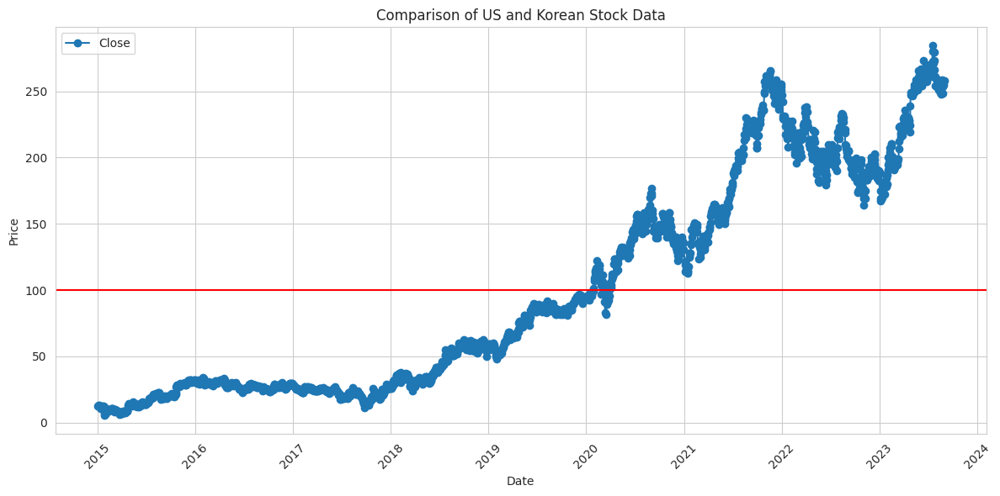

In [214]:
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Close'] - ak['kor_Close_USD'], label='Close', marker='o')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.axhline(y=(ak['Close'] - ak['kor_Close_USD']).mean(), color='red')
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

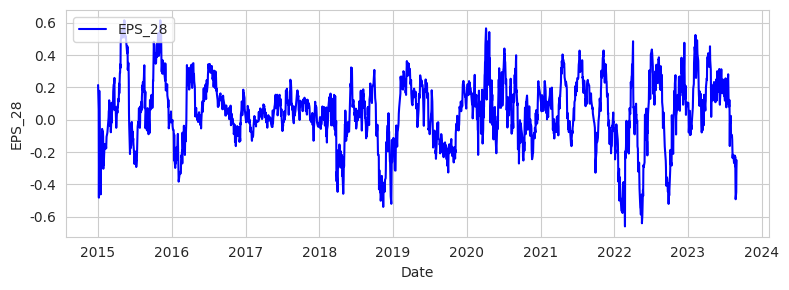

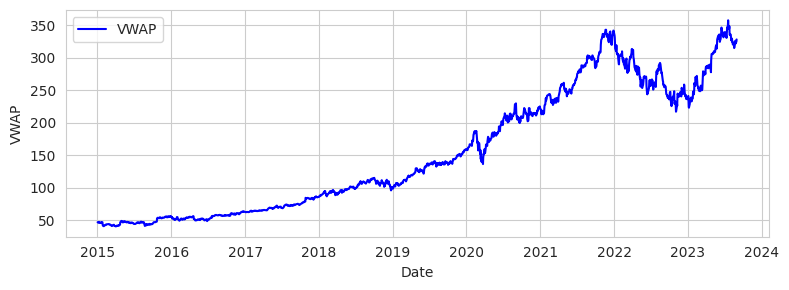

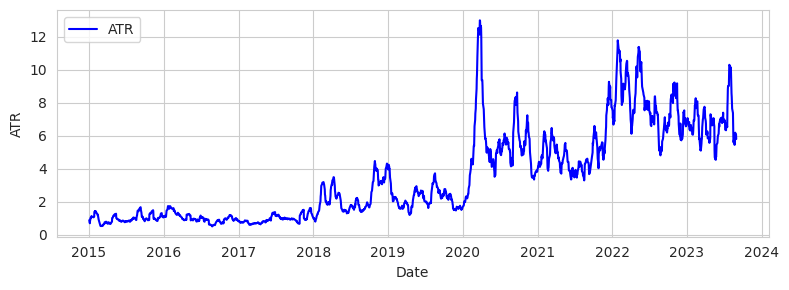

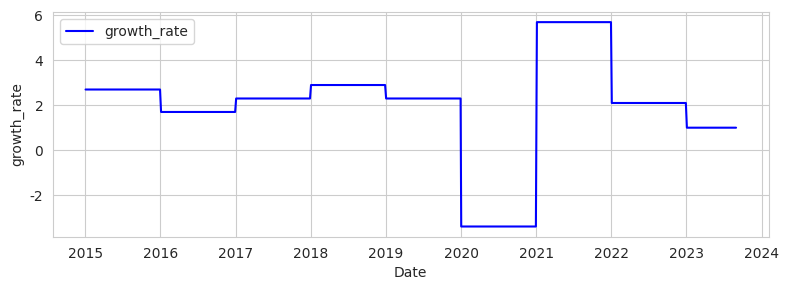

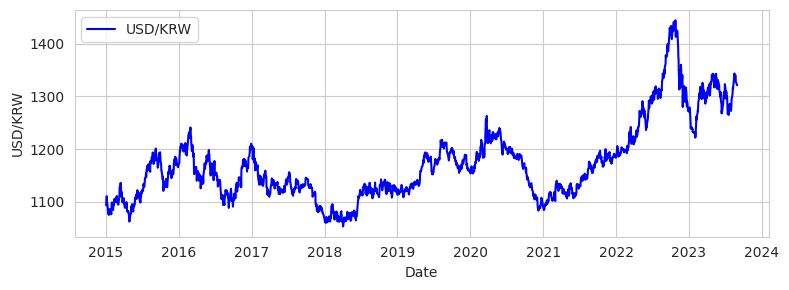

...

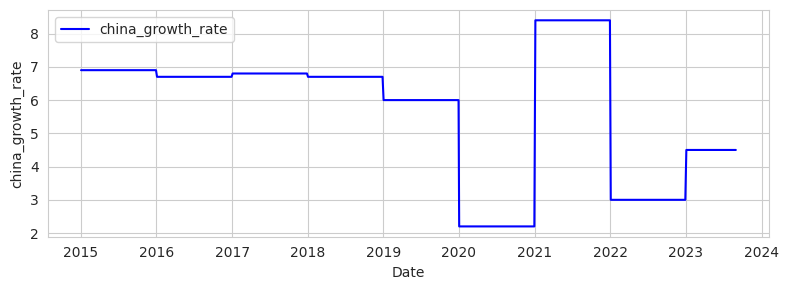

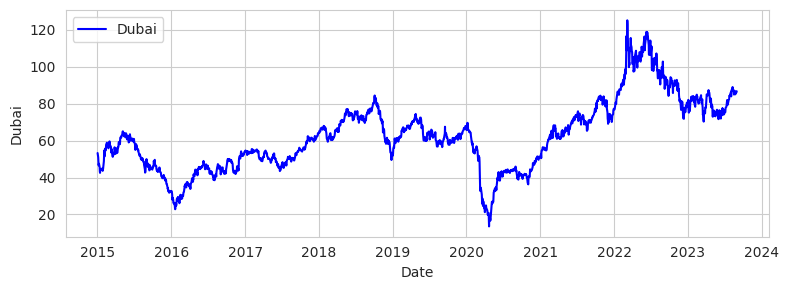

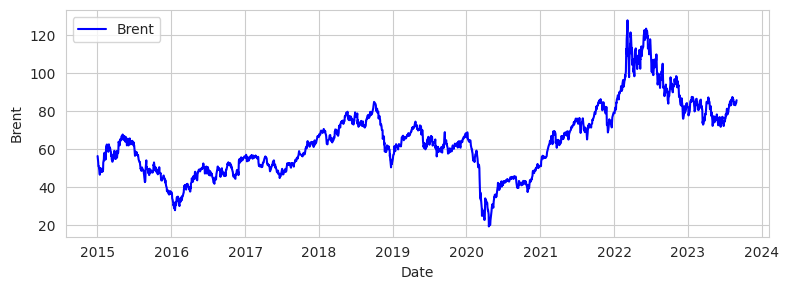

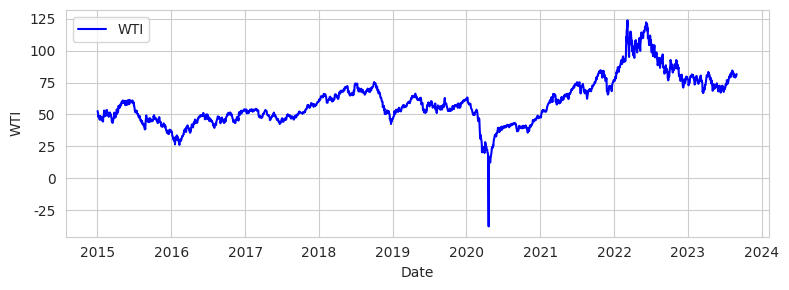

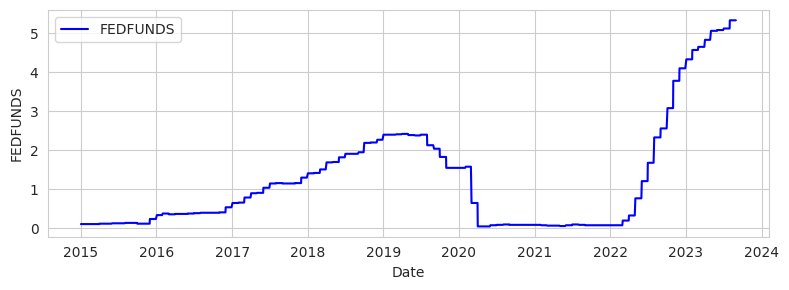

In [215]:
draw_one(ak, check_one)

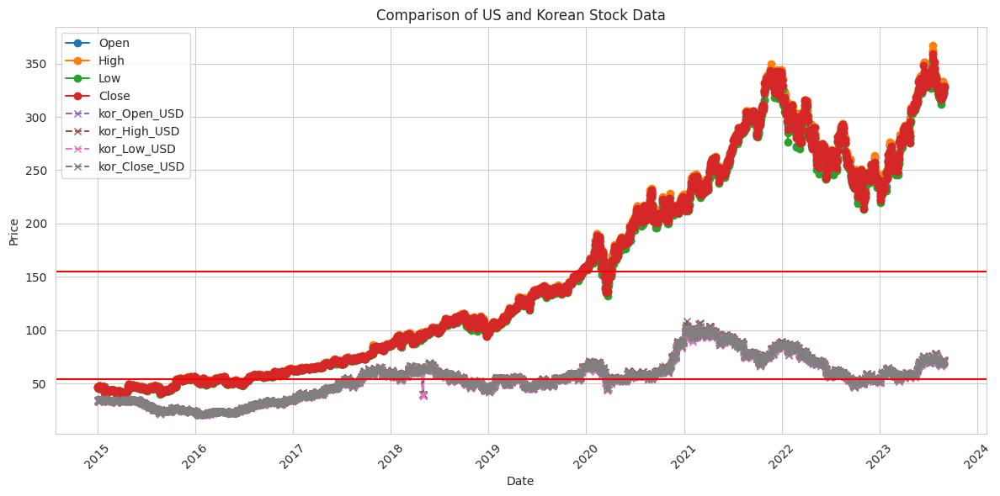

In [216]:
# 미국의 데이터를 라인 플롯으로 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Open'], label='Open', marker='o')
plt.plot(ak.index, ak['High'], label='High', marker='o')
plt.plot(ak.index, ak['Low'], label='Low', marker='o')
plt.plot(ak.index, ak['Close'], label='Close', marker='o')

# 한국의 데이터를 라인 플롯으로 그리기
plt.plot(ak.index, ak['kor_Open_USD'], label='kor_Open_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_High_USD'], label='kor_High_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Low_USD'], label='kor_Low_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Close_USD'], label='kor_Close_USD', linestyle='--', marker='x')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.axhline(y=((ak['Open']+ak['High']+ak['Low']+ak['Close'])/4).mean(), color='red')
plt.axhline(y=((ak['kor_Open_USD']+ak['kor_High_USD']+ak['kor_Low_USD']+ak['kor_Close_USD'])/4).mean(), color='red')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

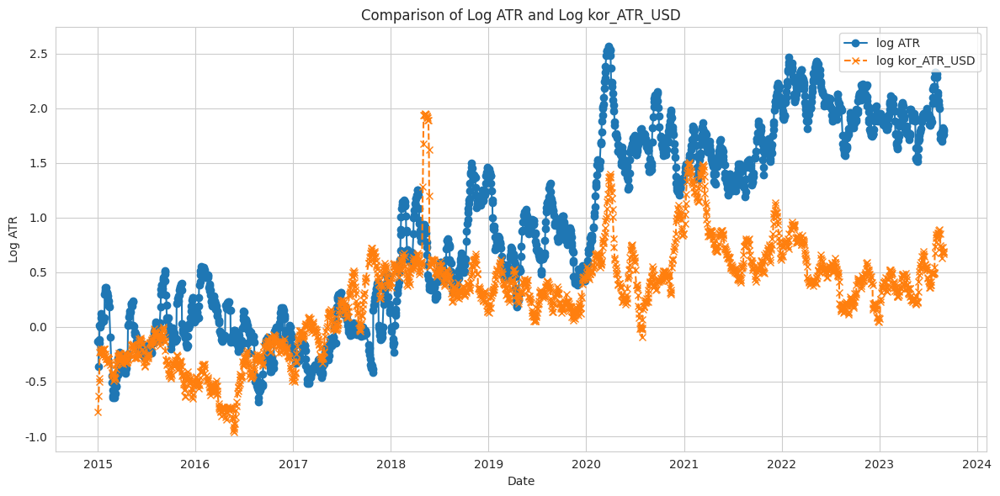

In [217]:
import matplotlib.pyplot as plt
import numpy as np

# 미국의 ATR 데이터
us_atr = ak['ATR']

# 한국의 kor_ATR_USD 데이터
kor_atr_usd = ak['kor_ATR_USD']

# 로그 스케일 적용
log_us_atr = np.log(us_atr)
log_kor_atr_usd = np.log(kor_atr_usd)

# 그래프 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, log_us_atr, label='log ATR', marker='o')
plt.plot(ak.index, log_kor_atr_usd, label='log kor_ATR_USD', linestyle='--', marker='x')

plt.title('Comparison of Log ATR and Log kor_ATR_USD')
plt.xlabel('Date')
plt.ylabel('Log ATR')
plt.legend()
plt.tight_layout()
plt.show()

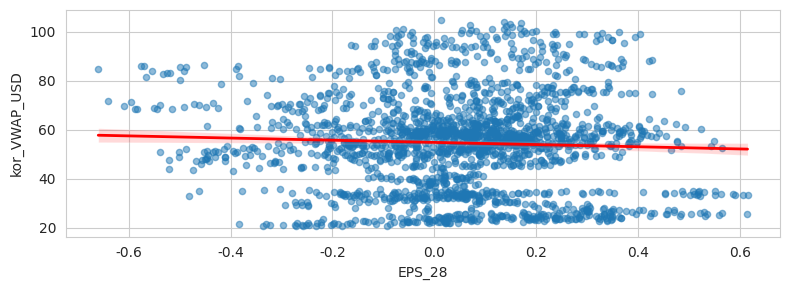

EPS_28와 kor_VWAP_USD 사이의 상관계수 : -0.05
p-value: 0.024154046910474156



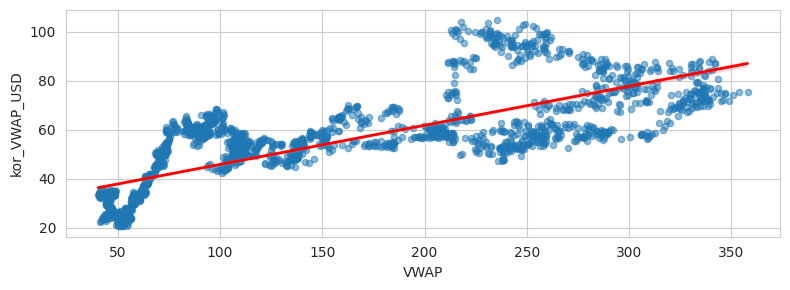

VWAP와 kor_VWAP_USD 사이의 상관계수 : 0.78
p-value: 0.0



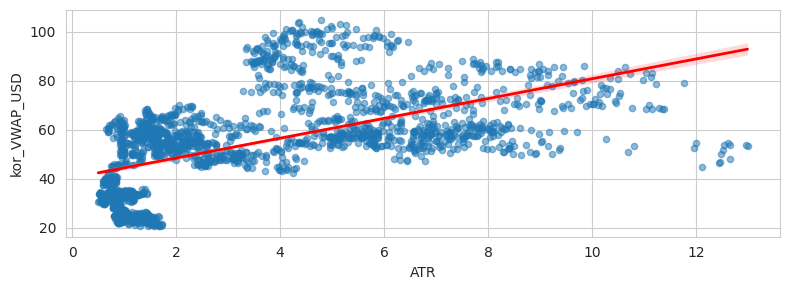

ATR와 kor_VWAP_USD 사이의 상관계수 : 0.58
p-value: 5.400907652139762e-184



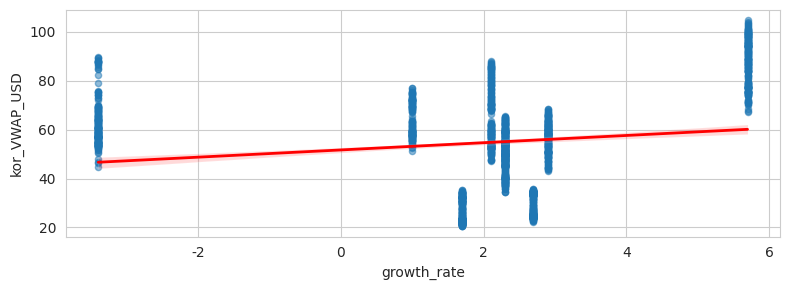

growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.17
p-value: 1.6536433818824664e-15



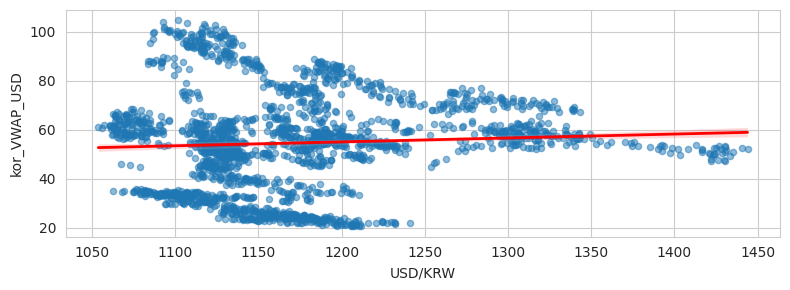

USD/KRW와 kor_VWAP_USD 사이의 상관계수 : 0.06
p-value: 0.006715931224053616



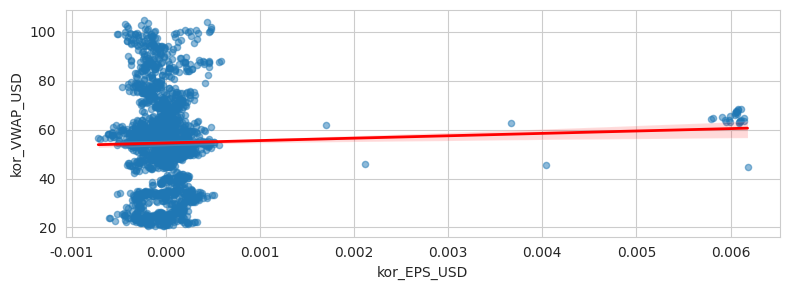

kor_EPS_USD와 kor_VWAP_USD 사이의 상관계수 : 0.04
p-value: 0.04462826231788908



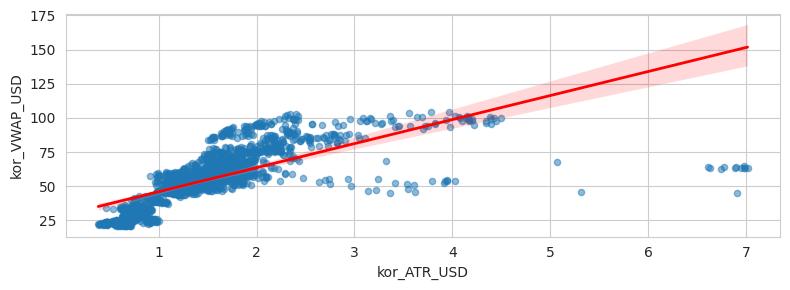

kor_ATR_USD와 kor_VWAP_USD 사이의 상관계수 : 0.72
p-value: 0.0



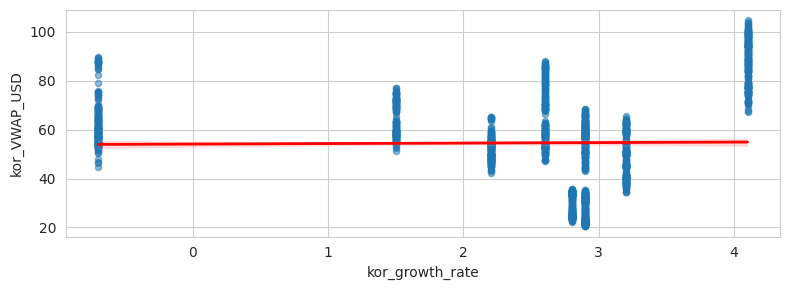

kor_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.01
p-value: 0.5432027211065505



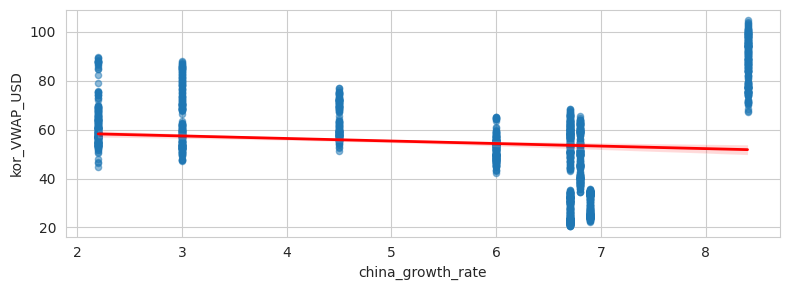

china_growth_rate와 kor_VWAP_USD 사이의 상관계수 : -0.10
p-value: 2.697484612834717e-06



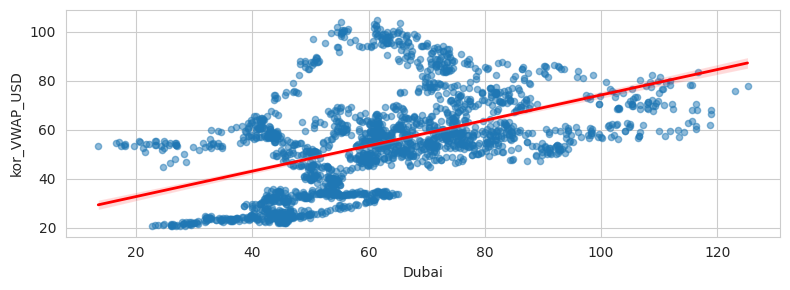

Dubai와 kor_VWAP_USD 사이의 상관계수 : 0.50
p-value: 4.30318514974291e-132



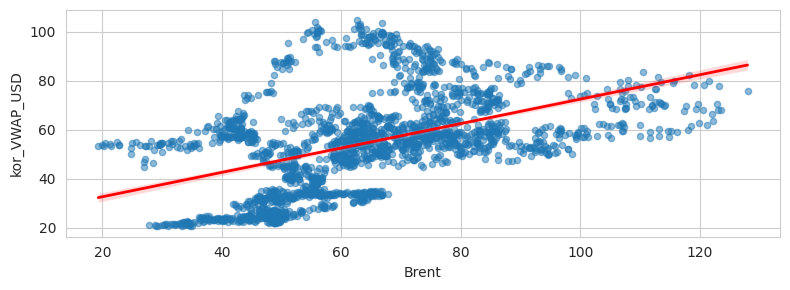

Brent와 kor_VWAP_USD 사이의 상관계수 : 0.48
p-value: 1.1177248995750783e-117



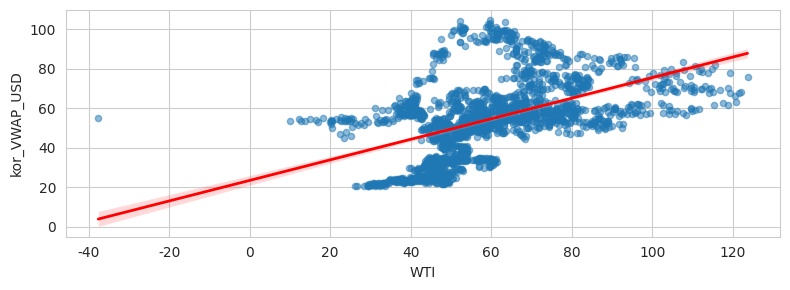

WTI와 kor_VWAP_USD 사이의 상관계수 : 0.49
p-value: 4.776546485770615e-123



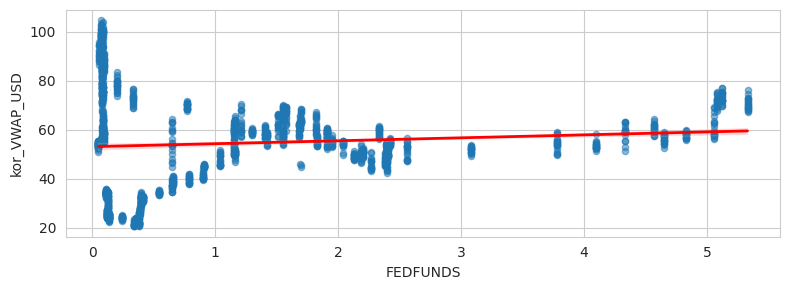

FEDFUNDS와 kor_VWAP_USD 사이의 상관계수 : 0.09
p-value: 6.561025920992444e-05



In [218]:
draw_two(ak, check_two)

In [219]:
# Pearson 상관계수 계산
correlation_matrix = ak[check_one].corr()

correlation_matrix

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
EPS_28,1.000000,0.018922,-0.121145,-0.020588,-0.013671,-0.065822,-0.045971,-0.086600,-0.037295,0.054371,-0.100332,-0.095861,-0.101942,0.001090
VWAP,0.018922,1.000000,0.833836,0.016927,0.577003,-0.092687,0.779802,0.471071,-0.146142,-0.379350,0.623453,0.601738,0.625878,0.316662
ATR,-0.121145,0.833836,1.000000,-0.200394,0.637241,-0.091577,0.577868,0.465496,-0.315068,-0.594399,0.519932,0.510911,0.528453,0.265177
growth_rate,-0.020588,0.016927,-0.200394,1.000000,-0.215490,0.008990,0.173887,0.088950,0.958356,0.819112,0.346904,0.362968,0.367736,-0.062343
USD/KRW,-0.013671,0.577003,0.637241,-0.215490,1.000000,-0.140841,0.060996,-0.034406,-0.254964,-0.566648,0.435203,0.429088,0.437618,0.545560
kor_EPS_USD,-0.065822,-0.092687,-0.091577,0.008990,-0.140841,1.000000,0.035610,0.398143,0.020297,0.036235,0.046794,0.049720,0.031512,0.070089
kor_VWAP_USD,-0.045971,0.779802,0.577868,0.173887,0.060996,0.035610,1.000000,0.713558,0.013318,-0.103348,0.501067,0.475998,0.485550,0.086535
kor_ATR_USD,-0.086600,0.471071,0.465496,0.088950,-0.034406,0.398143,0.713558,1.000000,-0.028877,-0.073426,0.285755,0.270742,0.265583,0.040764
kor_growth_rate,-0.037295,-0.146142,-0.315068,0.958356,-0.254964,0.020297,0.013318,-0.028877,1.000000,0.828889,0.246692,0.272245,0.287573,-0.146148
china_growth_rate,0.054371,-0.379350,-0.594399,0.819112,-0.566648,0.036235,-0.103348,-0.073426,0.828889,1.000000,-0.166836,-0.155473,-0.150392,-0.248039


In [220]:
correlation_matrix[['kor_VWAP_USD']].T

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
kor_VWAP_USD,-0.045971,0.779802,0.577868,0.173887,0.060996,0.03561,1.0,0.713558,0.013318,-0.103348,0.501067,0.475998,0.48555,0.086535


#### 엔비디아

+ 086960 : MDS테크
+ 189330 : 씨이렙
+ 372800 : 아이티아이즈
+ 007660 : 이수페타시스
+ 031820 : 콤텍시스템
+ 033320 : 제이씨현시스템
+ 052460 : 아이크래프트
+ 053450 : 세코닉스
+ 376930 : 노을
+ 097800 : 윈팩
    + https://stockstalker.co.kr/nvidia/

In [221]:
nv=['NVDA']
kor = ['000660', '005930', '006400', '009150', '018260', '035420', '005935', '051910', '373220', '035720']
#['086960', '189330', '372800', '007660', '031820', '033320', '052460', '053450', '376930', '097800']

In [222]:
ak = return_ak(ms, kor)
ak.head()

,Open,High,Low,Close,Volume,EPS_28,VWAP,ATR,kor_open,kor_high,...,Dubai,Brent,WTI,kor_Open_USD,kor_High_USD,kor_Low_USD,kor_Close_USD,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD
Date,,,,,,,,,,,,,,,,,,,,,
2015-01-02,46.660000,47.419998,46.540001,46.759998,27913900,0.214300,46.8450,0.879997,37374.5,37599.5,...,53.27,56.42,52.69,34.175659,34.381402,33.920081,33.993234,-0.000488,34.117594,0.461320
2015-01-05,46.369999,46.730000,46.250000,46.330002,39673900,0.064000,46.4200,0.694998,37385.0,37560.0,...,50.98,53.11,50.04,33.649865,33.807381,33.195320,33.442844,-0.000517,33.523852,0.533078
2015-01-06,46.380001,46.750000,45.540001,45.650002,36447900,-0.482000,46.0800,0.866665,36650.0,36970.0,...,48.08,51.10,47.93,33.062697,33.351376,32.774019,33.107803,-0.000304,33.073974,0.604270
2015-01-07,45.980000,46.459999,45.490002,46.230000,29114100,-0.225575,46.0400,0.892498,36290.0,36910.0,...,46.60,51.15,48.65,33.072085,33.637108,32.962725,33.509522,0.000071,33.295360,0.626424
2015-01-08,46.750000,47.750000,46.720001,47.590000,29645200,0.178900,47.2025,1.017998,37515.0,38390.0,...,47.50,50.96,48.79,34.172890,34.969938,33.748860,34.719437,0.000348,34.402781,0.796047


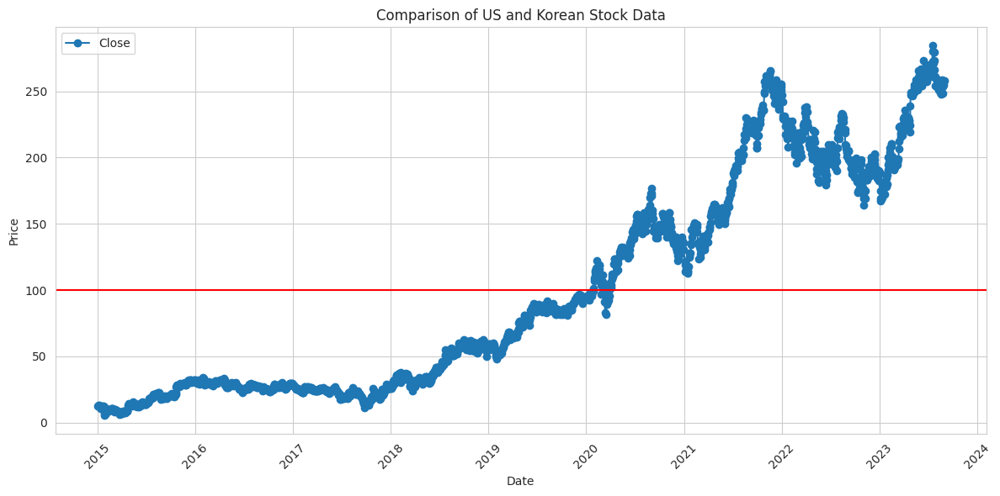

In [223]:
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Close'] - ak['kor_Close_USD'], label='Close', marker='o')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.axhline(y=(ak['Close'] - ak['kor_Close_USD']).mean(), color='red')
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

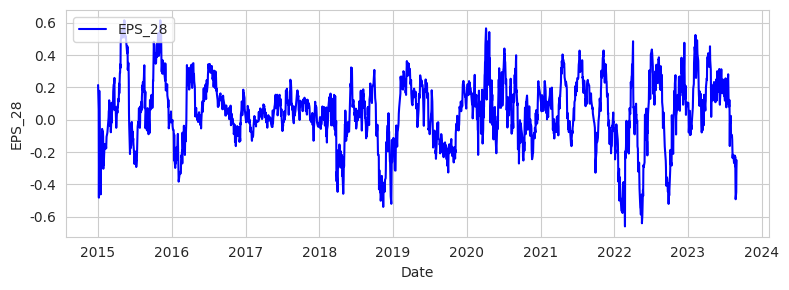

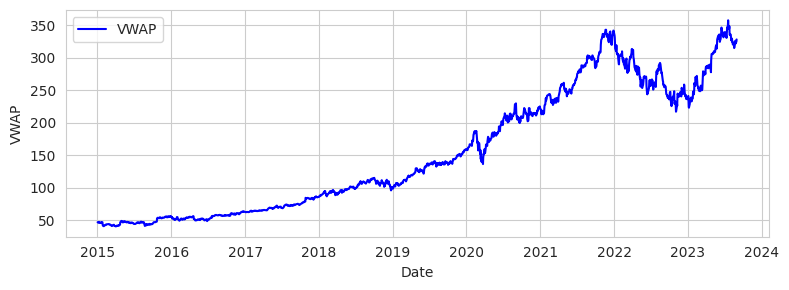

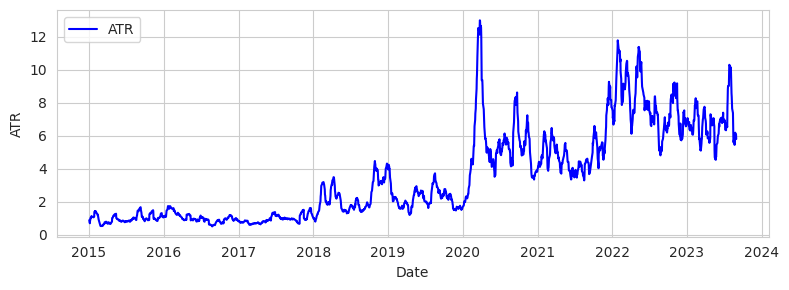

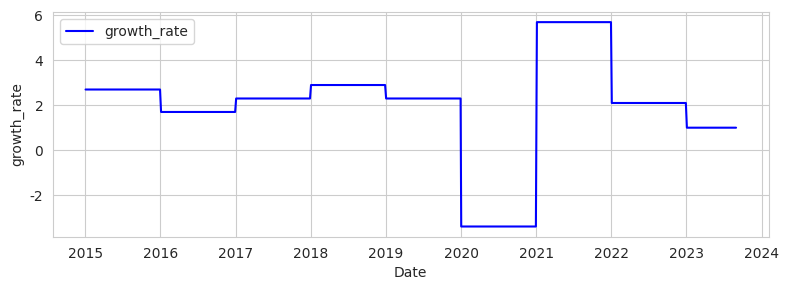

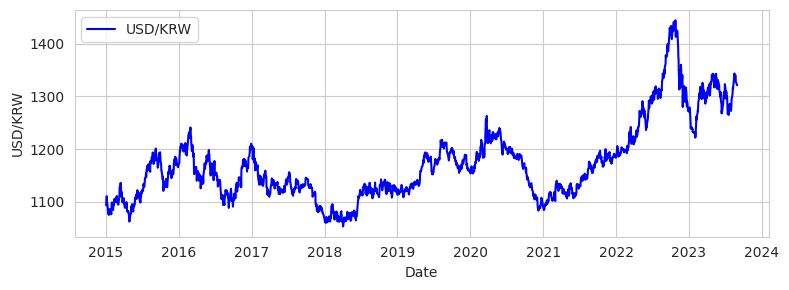

...

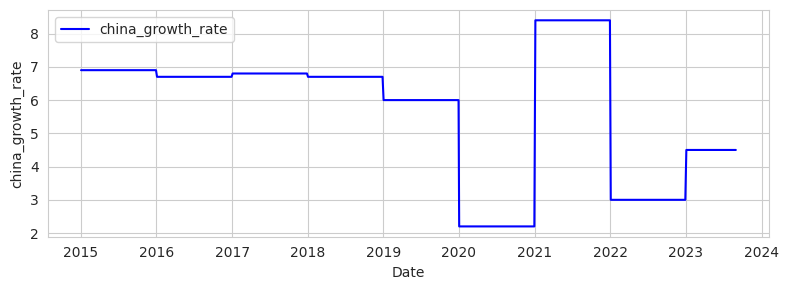

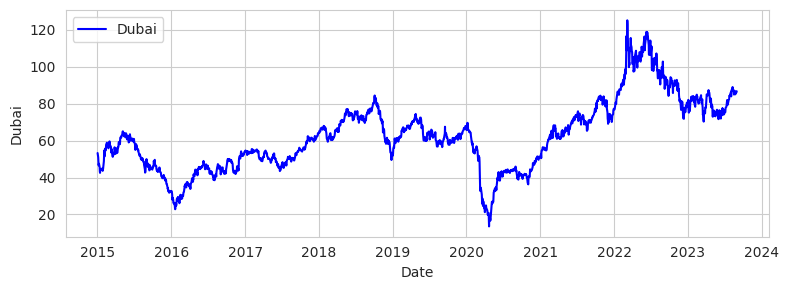

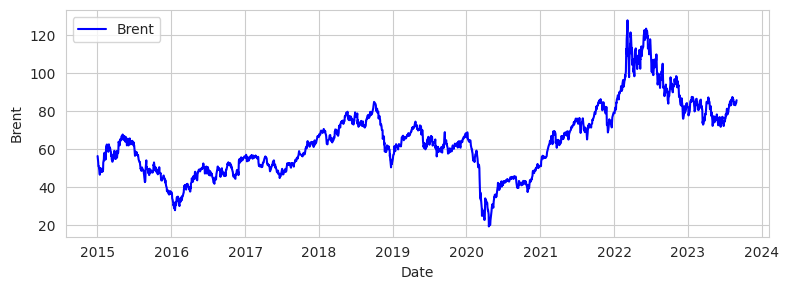

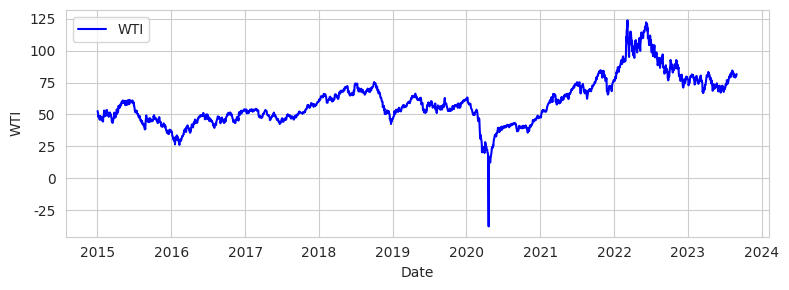

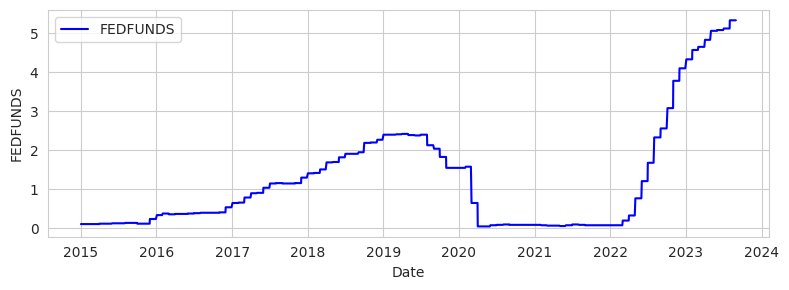

In [224]:
draw_one(ak, check_one)

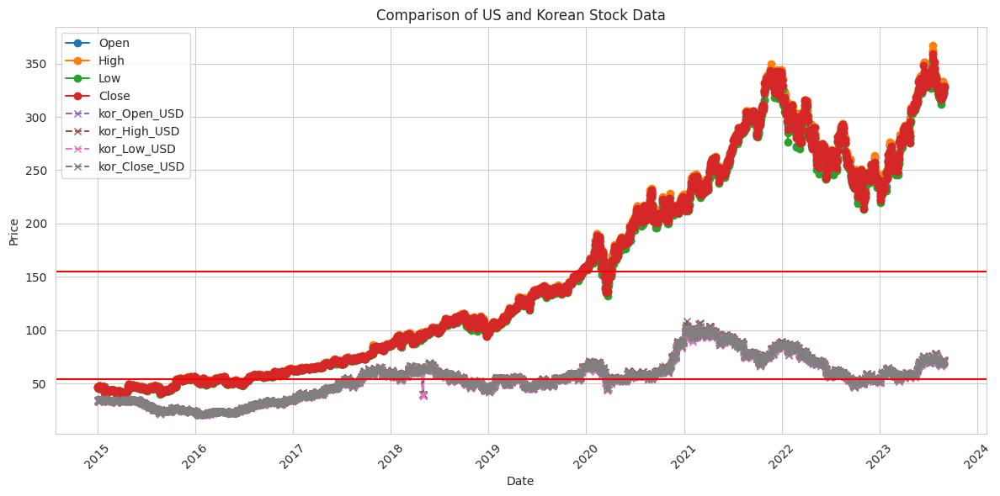

In [225]:
# 미국의 데이터를 라인 플롯으로 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Open'], label='Open', marker='o')
plt.plot(ak.index, ak['High'], label='High', marker='o')
plt.plot(ak.index, ak['Low'], label='Low', marker='o')
plt.plot(ak.index, ak['Close'], label='Close', marker='o')

# 한국의 데이터를 라인 플롯으로 그리기
plt.plot(ak.index, ak['kor_Open_USD'], label='kor_Open_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_High_USD'], label='kor_High_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Low_USD'], label='kor_Low_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Close_USD'], label='kor_Close_USD', linestyle='--', marker='x')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.axhline(y=((ak['Open']+ak['High']+ak['Low']+ak['Close'])/4).mean(), color='red')
plt.axhline(y=((ak['kor_Open_USD']+ak['kor_High_USD']+ak['kor_Low_USD']+ak['kor_Close_USD'])/4).mean(), color='red')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

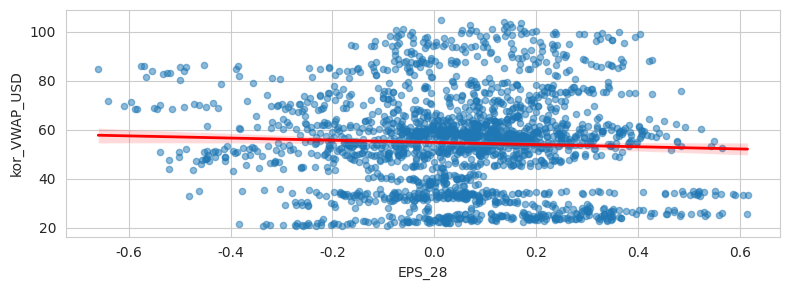

EPS_28와 kor_VWAP_USD 사이의 상관계수 : -0.05
p-value: 0.024154046910474156



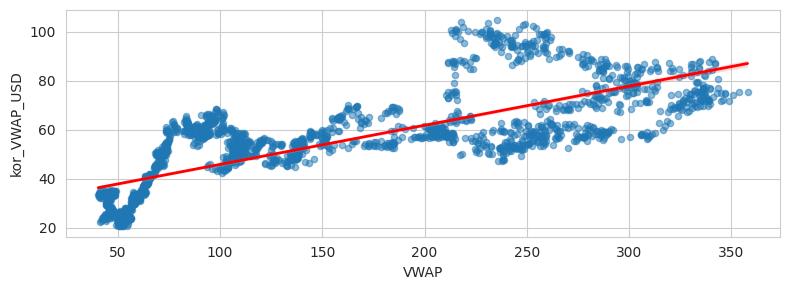

VWAP와 kor_VWAP_USD 사이의 상관계수 : 0.78
p-value: 0.0



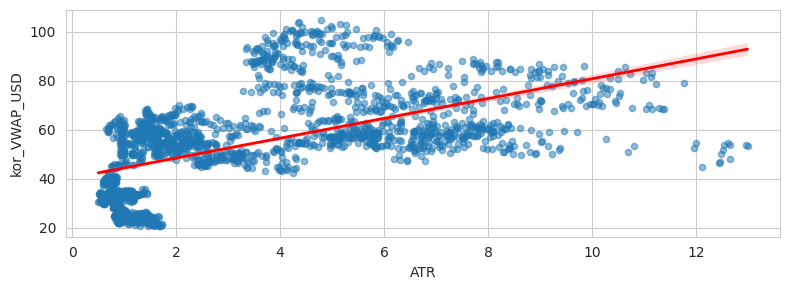

ATR와 kor_VWAP_USD 사이의 상관계수 : 0.58
p-value: 5.400907652139762e-184



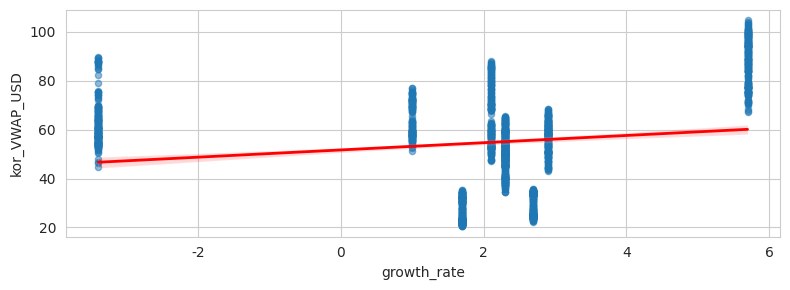

growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.17
p-value: 1.6536433818824664e-15



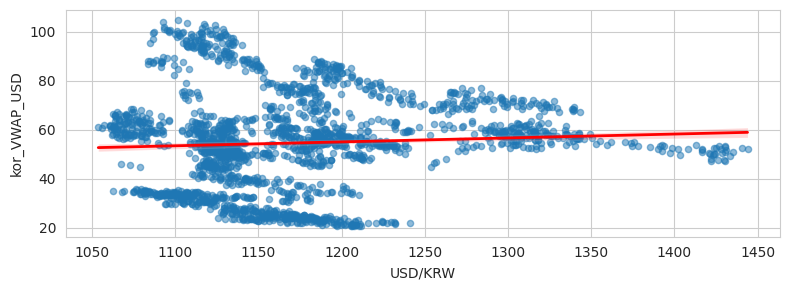

USD/KRW와 kor_VWAP_USD 사이의 상관계수 : 0.06
p-value: 0.006715931224053616



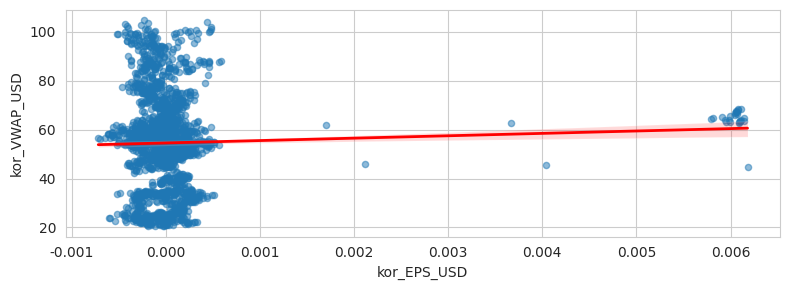

kor_EPS_USD와 kor_VWAP_USD 사이의 상관계수 : 0.04
p-value: 0.04462826231788908



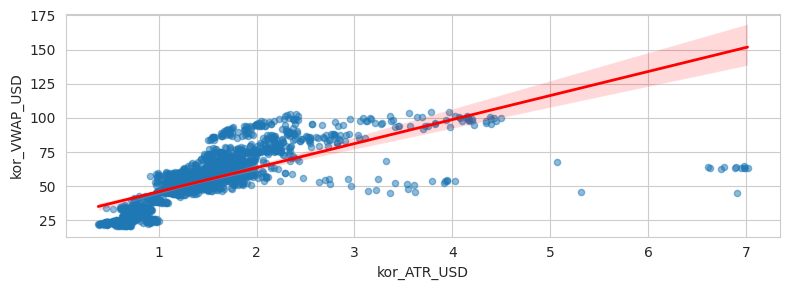

kor_ATR_USD와 kor_VWAP_USD 사이의 상관계수 : 0.72
p-value: 0.0



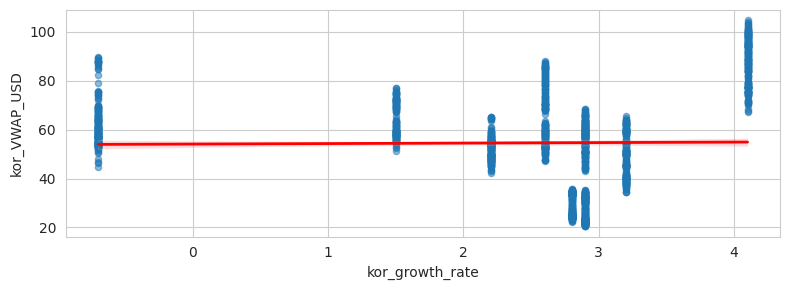

kor_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.01
p-value: 0.5432027211065505



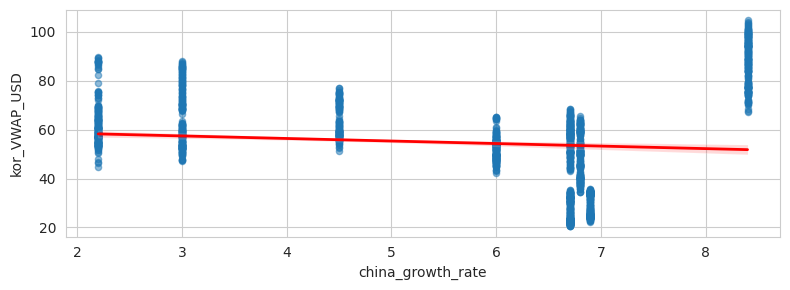

china_growth_rate와 kor_VWAP_USD 사이의 상관계수 : -0.10
p-value: 2.697484612834717e-06



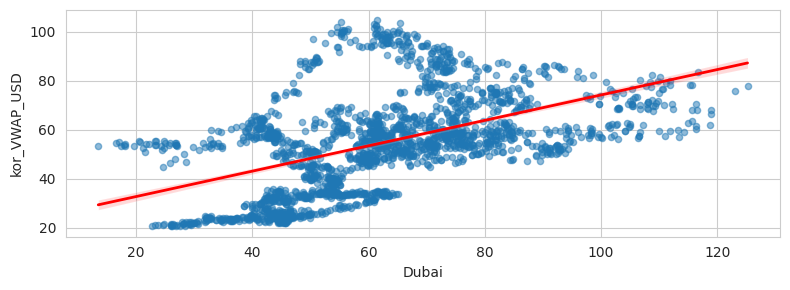

Dubai와 kor_VWAP_USD 사이의 상관계수 : 0.50
p-value: 4.30318514974291e-132



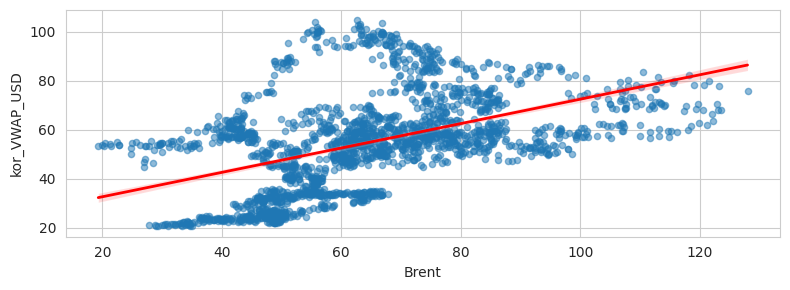

Brent와 kor_VWAP_USD 사이의 상관계수 : 0.48
p-value: 1.1177248995750783e-117



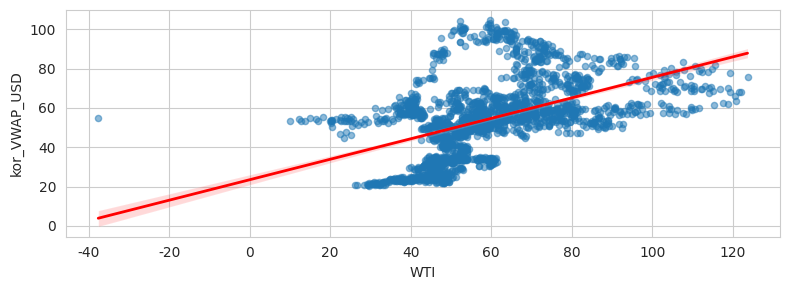

WTI와 kor_VWAP_USD 사이의 상관계수 : 0.49
p-value: 4.776546485770615e-123



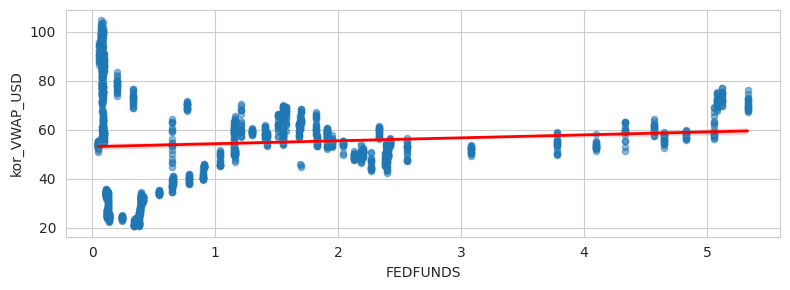

FEDFUNDS와 kor_VWAP_USD 사이의 상관계수 : 0.09
p-value: 6.561025920992444e-05



In [226]:
draw_two(ak, check_two)

In [227]:
# Pearson 상관계수 계산
correlation_matrix = ak[check_one].corr()

correlation_matrix

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
EPS_28,1.000000,0.018922,-0.121145,-0.020588,-0.013671,-0.065822,-0.045971,-0.086600,-0.037295,0.054371,-0.100332,-0.095861,-0.101942,0.001090
VWAP,0.018922,1.000000,0.833836,0.016927,0.577003,-0.092687,0.779802,0.471071,-0.146142,-0.379350,0.623453,0.601738,0.625878,0.316662
ATR,-0.121145,0.833836,1.000000,-0.200394,0.637241,-0.091577,0.577868,0.465496,-0.315068,-0.594399,0.519932,0.510911,0.528453,0.265177
growth_rate,-0.020588,0.016927,-0.200394,1.000000,-0.215490,0.008990,0.173887,0.088950,0.958356,0.819112,0.346904,0.362968,0.367736,-0.062343
USD/KRW,-0.013671,0.577003,0.637241,-0.215490,1.000000,-0.140841,0.060996,-0.034406,-0.254964,-0.566648,0.435203,0.429088,0.437618,0.545560
kor_EPS_USD,-0.065822,-0.092687,-0.091577,0.008990,-0.140841,1.000000,0.035610,0.398143,0.020297,0.036235,0.046794,0.049720,0.031512,0.070089
kor_VWAP_USD,-0.045971,0.779802,0.577868,0.173887,0.060996,0.035610,1.000000,0.713558,0.013318,-0.103348,0.501067,0.475998,0.485550,0.086535
kor_ATR_USD,-0.086600,0.471071,0.465496,0.088950,-0.034406,0.398143,0.713558,1.000000,-0.028877,-0.073426,0.285755,0.270742,0.265583,0.040764
kor_growth_rate,-0.037295,-0.146142,-0.315068,0.958356,-0.254964,0.020297,0.013318,-0.028877,1.000000,0.828889,0.246692,0.272245,0.287573,-0.146148
china_growth_rate,0.054371,-0.379350,-0.594399,0.819112,-0.566648,0.036235,-0.103348,-0.073426,0.828889,1.000000,-0.166836,-0.155473,-0.150392,-0.248039


In [228]:
correlation_matrix[['kor_VWAP_USD']].T

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
kor_VWAP_USD,-0.045971,0.779802,0.577868,0.173887,0.060996,0.03561,1.0,0.713558,0.013318,-0.103348,0.501067,0.475998,0.48555,0.086535


#### 브로드컴(반도체 및 인프라)
+ 한국 협력사를 찾기 힘들어 경쟁사로 대체
+ 삼성전자, SK하이닉스

In [229]:
av = ['AVGO']
kor = ['000660', '005930', '006400', '009150', '018260', '035420', '005935', '051910', '373220', '035720']
#['005930', '000660']

In [230]:
ak = return_ak(av, kor)
ak.head()

,Open,High,Low,Close,Volume,EPS_28,VWAP,ATR,kor_open,kor_high,...,Dubai,Brent,WTI,kor_Open_USD,kor_High_USD,kor_Low_USD,kor_Close_USD,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD
Date,,,,,,,,,,,,,,,,,,,,,
2015-01-02,100.930000,102.209999,99.129997,100.089996,1350000,-0.832300,100.590,3.080002,37374.5,37599.5,...,53.27,56.42,52.69,34.175659,34.381402,33.920081,33.993234,-0.000488,34.117594,0.461320
2015-01-05,100.070000,100.820000,98.400002,98.489998,1559600,-1.205600,99.445,2.750000,37385.0,37560.0,...,50.98,53.11,50.04,33.649865,33.807381,33.195320,33.442844,-0.000517,33.523852,0.533078
2015-01-06,98.949997,99.080002,95.180000,96.250000,2219400,-1.713267,97.365,3.133334,36650.0,36970.0,...,48.08,51.10,47.93,33.062697,33.351376,32.774019,33.107803,-0.000304,33.073974,0.604270
2015-01-07,97.050003,99.389999,96.529999,98.849998,3090700,-0.821275,97.955,3.135000,36290.0,36910.0,...,46.60,51.15,48.65,33.072085,33.637108,32.962725,33.509522,0.000071,33.295360,0.626424
2015-01-08,100.529999,104.300003,100.360001,103.790001,3326500,-0.008460,102.245,3.598001,37515.0,38390.0,...,47.50,50.96,48.79,34.172890,34.969938,33.748860,34.719437,0.000348,34.402781,0.796047


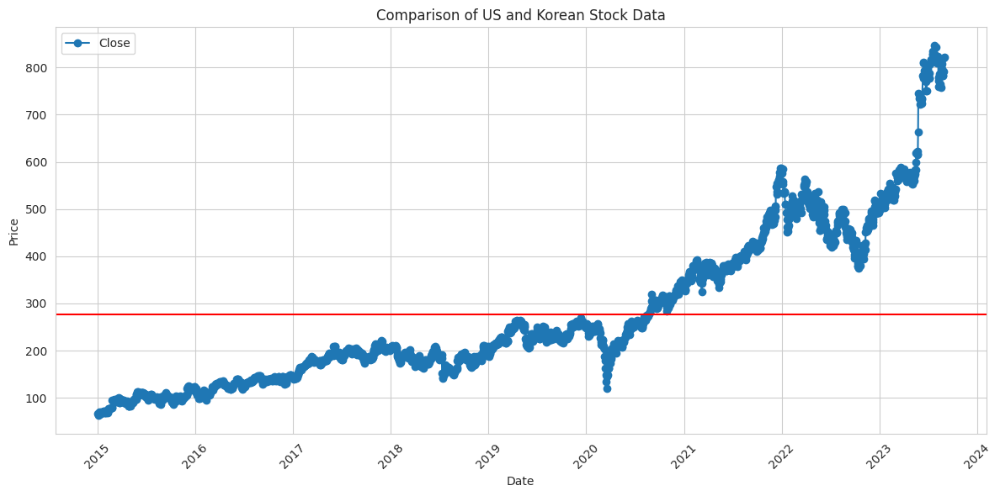

In [231]:
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Close'] - ak['kor_Close_USD'], label='Close', marker='o')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.axhline(y=(ak['Close'] - ak['kor_Close_USD']).mean(), color='red')
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

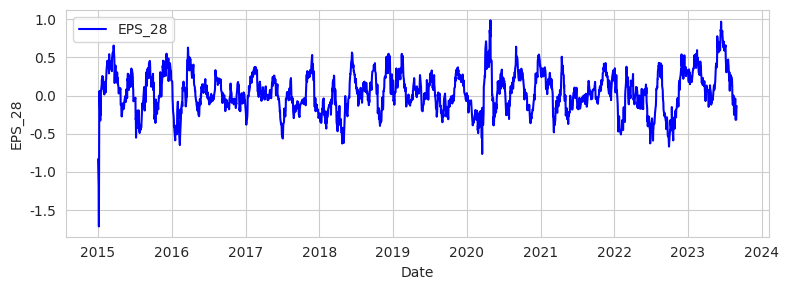

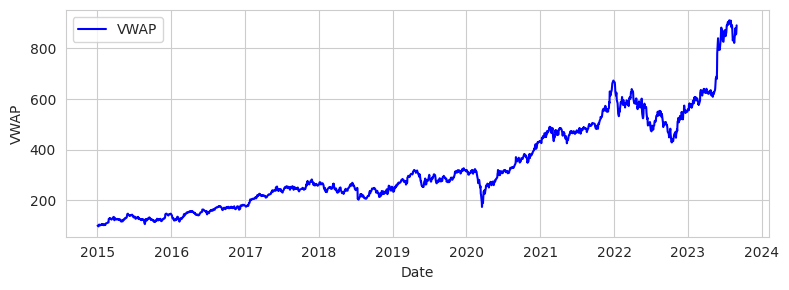

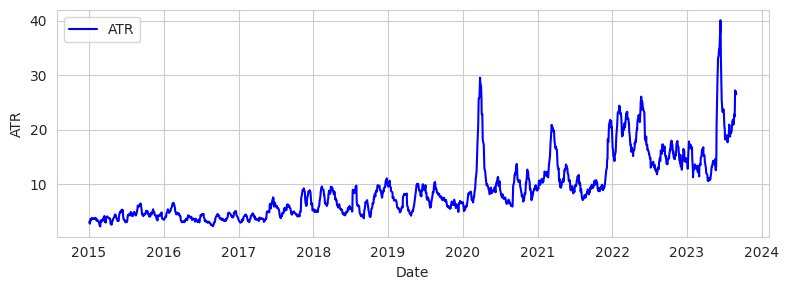

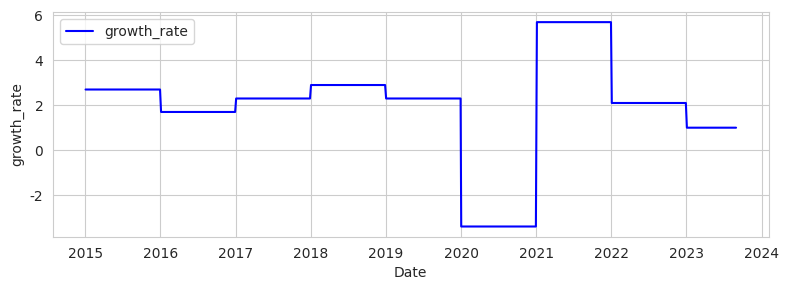

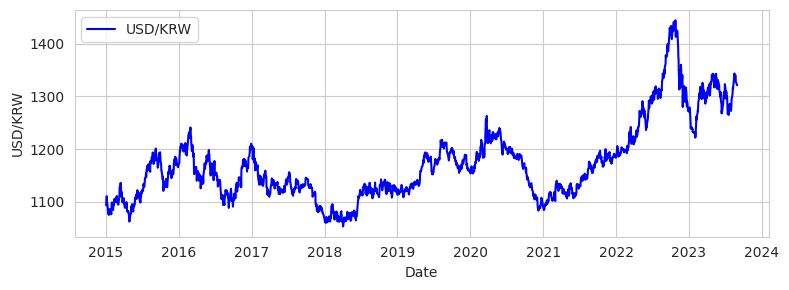

...

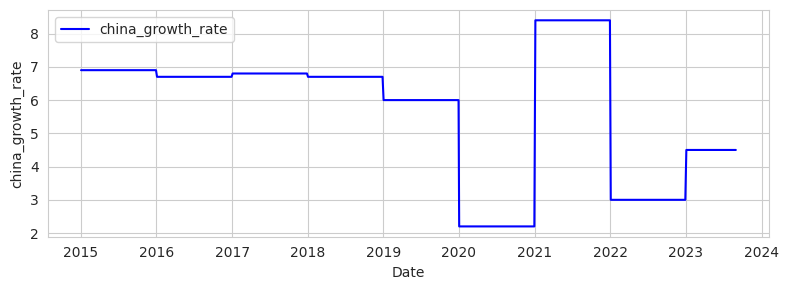

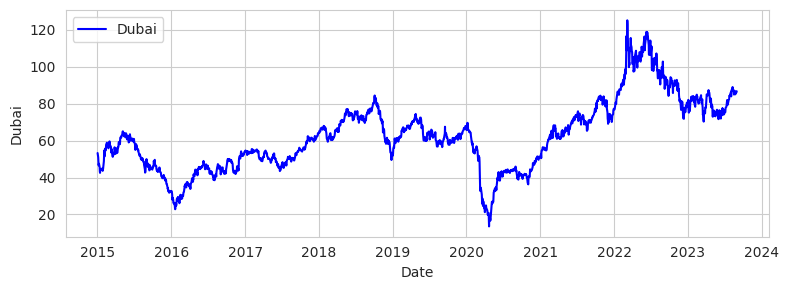

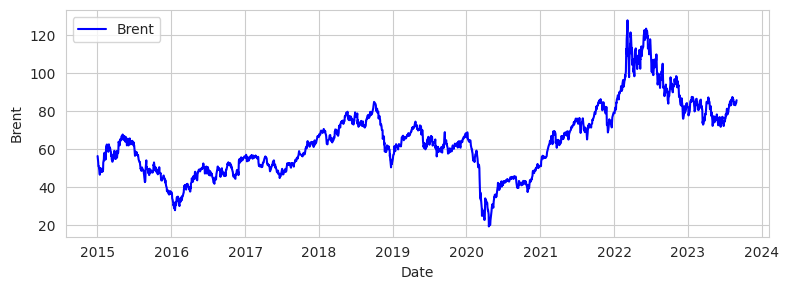

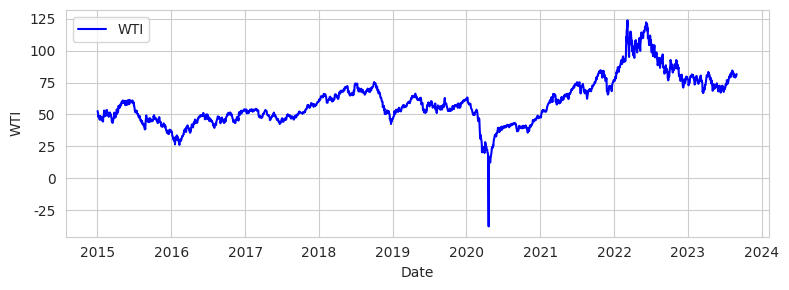

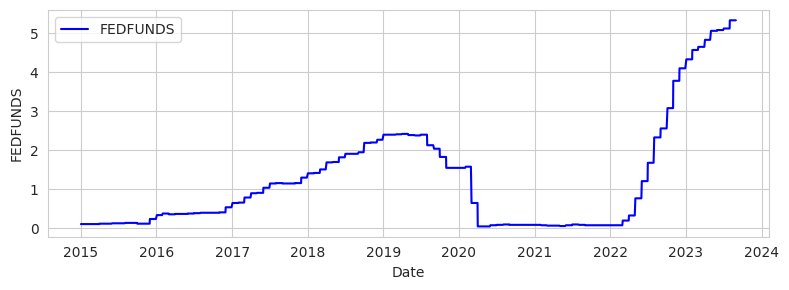

In [232]:
draw_one(ak, check_one)

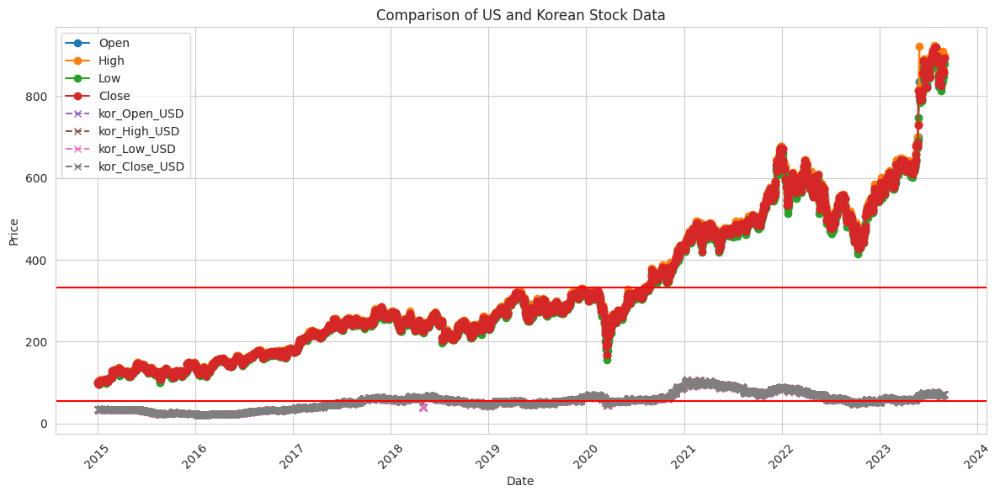

In [233]:
# 미국의 데이터를 라인 플롯으로 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Open'], label='Open', marker='o')
plt.plot(ak.index, ak['High'], label='High', marker='o')
plt.plot(ak.index, ak['Low'], label='Low', marker='o')
plt.plot(ak.index, ak['Close'], label='Close', marker='o')

# 한국의 데이터를 라인 플롯으로 그리기
plt.plot(ak.index, ak['kor_Open_USD'], label='kor_Open_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_High_USD'], label='kor_High_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Low_USD'], label='kor_Low_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Close_USD'], label='kor_Close_USD', linestyle='--', marker='x')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.axhline(y=((ak['Open']+ak['High']+ak['Low']+ak['Close'])/4).mean(), color='red')
plt.axhline(y=((ak['kor_Open_USD']+ak['kor_High_USD']+ak['kor_Low_USD']+ak['kor_Close_USD'])/4).mean(), color='red')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

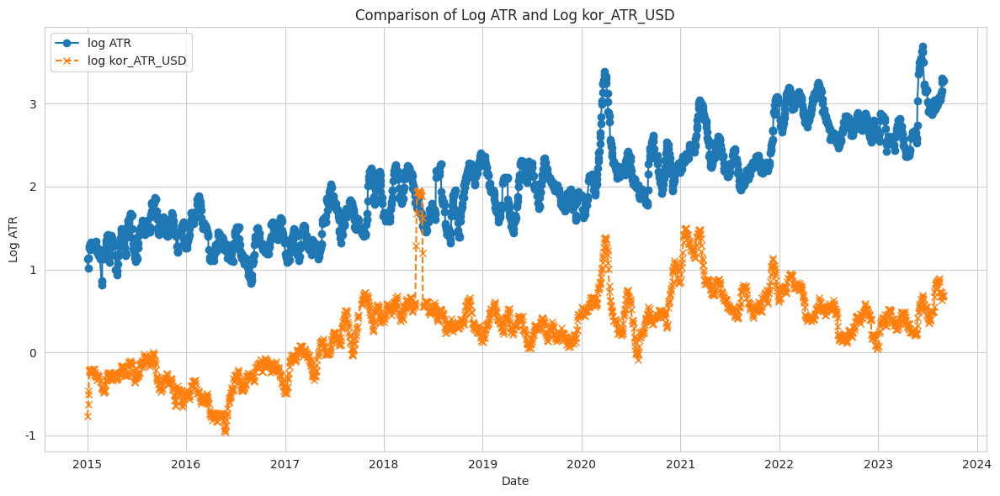

In [234]:
import matplotlib.pyplot as plt
import numpy as np

# 미국의 ATR 데이터
us_atr = ak['ATR']

# 한국의 kor_ATR_USD 데이터
kor_atr_usd = ak['kor_ATR_USD']

# 로그 스케일 적용
log_us_atr = np.log(us_atr)
log_kor_atr_usd = np.log(kor_atr_usd)

# 그래프 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, log_us_atr, label='log ATR', marker='o')
plt.plot(ak.index, log_kor_atr_usd, label='log kor_ATR_USD', linestyle='--', marker='x')

plt.title('Comparison of Log ATR and Log kor_ATR_USD')
plt.xlabel('Date')
plt.ylabel('Log ATR')
plt.legend()
plt.tight_layout()
plt.show()

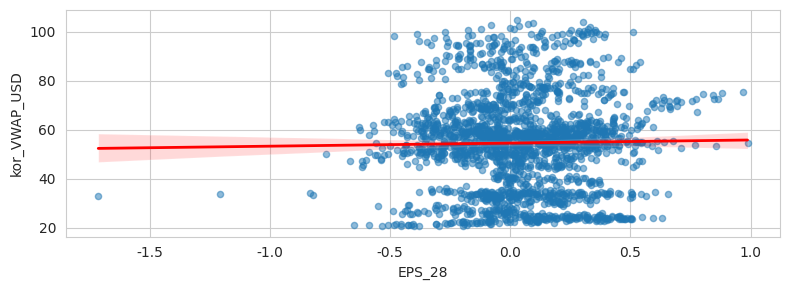

EPS_28와 kor_VWAP_USD 사이의 상관계수 : 0.01
p-value: 0.5294855165681194



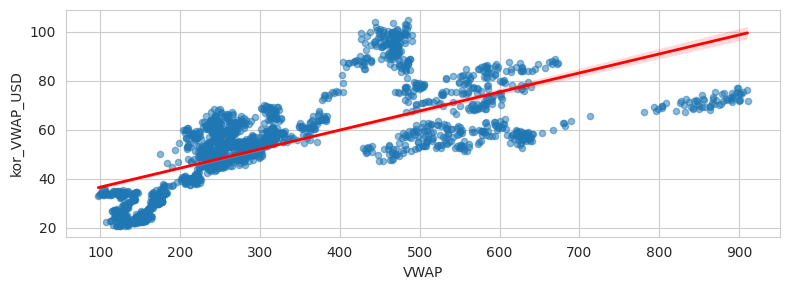

VWAP와 kor_VWAP_USD 사이의 상관계수 : 0.72
p-value: 0.0



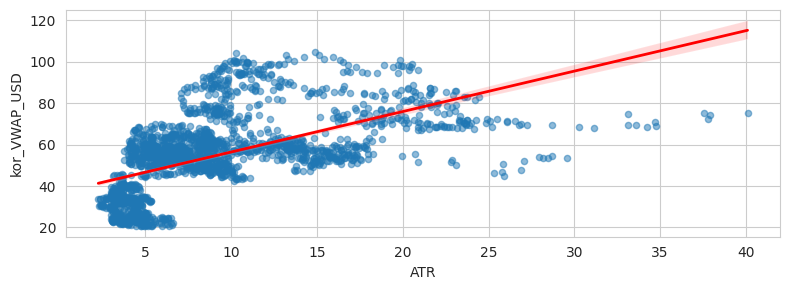

ATR와 kor_VWAP_USD 사이의 상관계수 : 0.58
p-value: 1.2279712608717184e-182



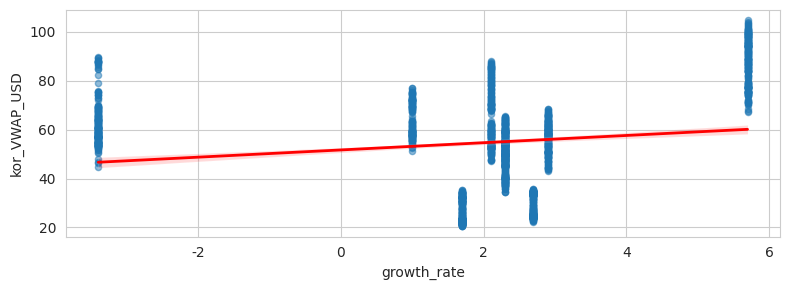

growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.17
p-value: 1.6536433818824664e-15



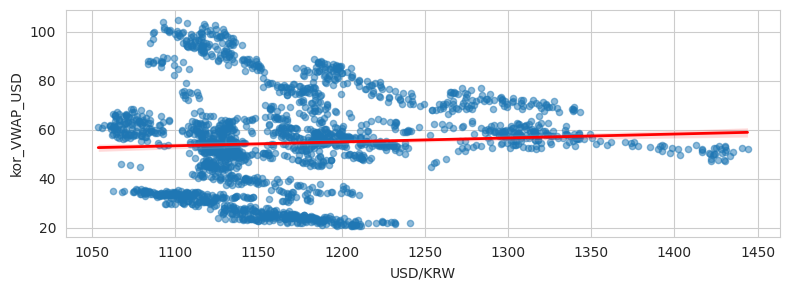

USD/KRW와 kor_VWAP_USD 사이의 상관계수 : 0.06
p-value: 0.006715931224053616



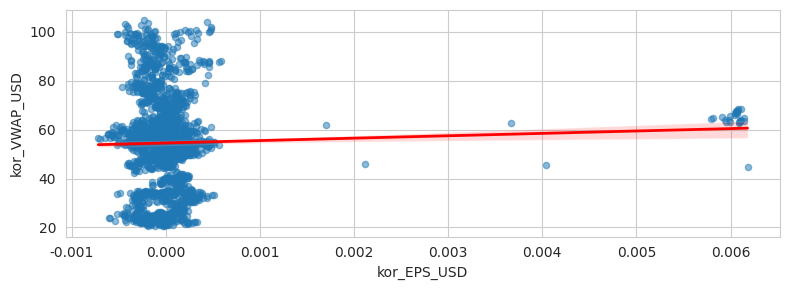

kor_EPS_USD와 kor_VWAP_USD 사이의 상관계수 : 0.04
p-value: 0.04462826231788908



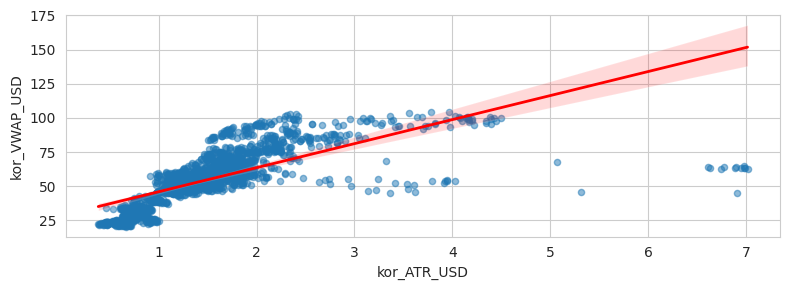

kor_ATR_USD와 kor_VWAP_USD 사이의 상관계수 : 0.72
p-value: 0.0



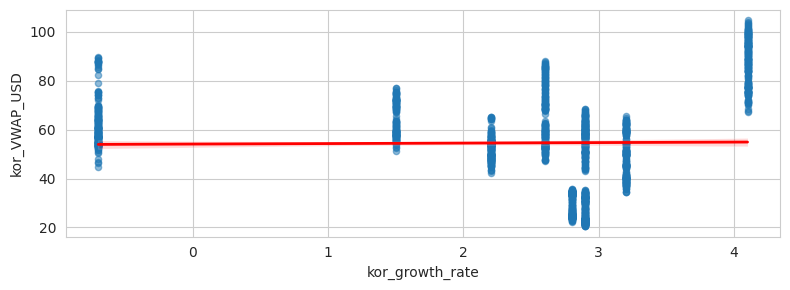

kor_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.01
p-value: 0.5432027211065505



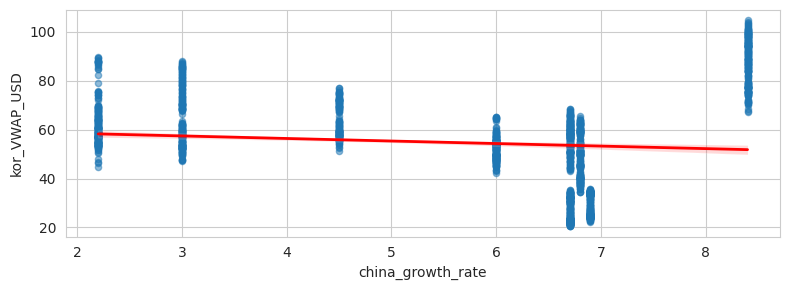

china_growth_rate와 kor_VWAP_USD 사이의 상관계수 : -0.10
p-value: 2.697484612834717e-06



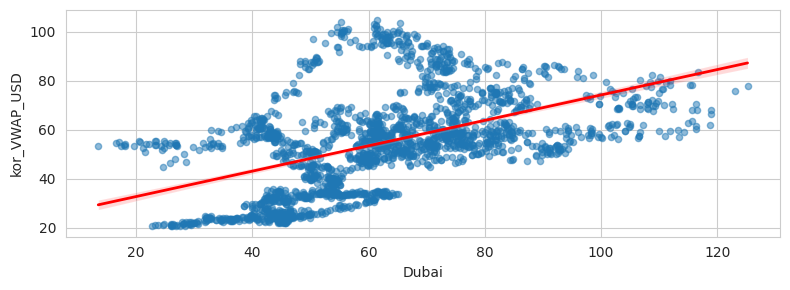

Dubai와 kor_VWAP_USD 사이의 상관계수 : 0.50
p-value: 4.30318514974291e-132



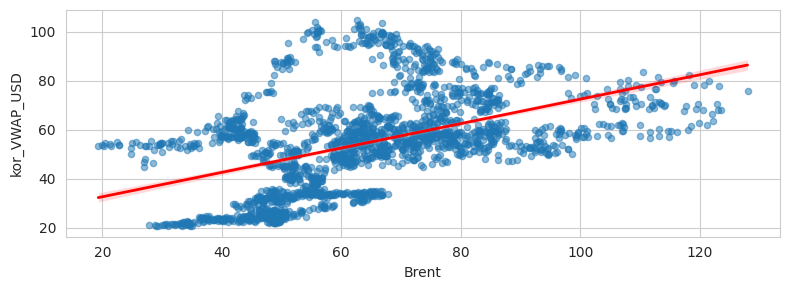

Brent와 kor_VWAP_USD 사이의 상관계수 : 0.48
p-value: 1.1177248995750783e-117



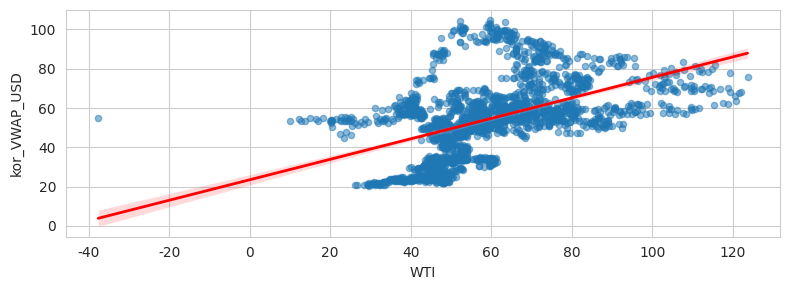

WTI와 kor_VWAP_USD 사이의 상관계수 : 0.49
p-value: 4.776546485770615e-123



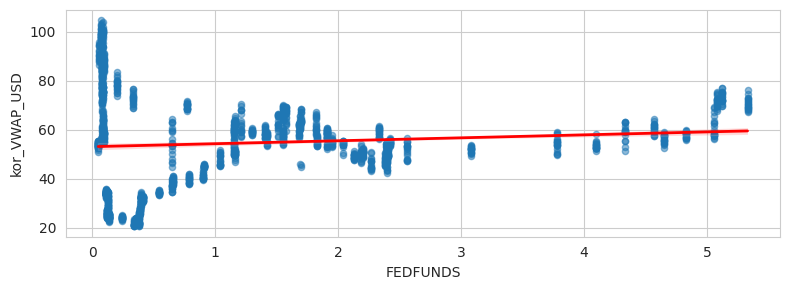

FEDFUNDS와 kor_VWAP_USD 사이의 상관계수 : 0.09
p-value: 6.561025920992444e-05



In [235]:
draw_two(ak, check_two)

In [236]:
# Pearson 상관계수 계산
correlation_matrix = ak[check_one].corr()

correlation_matrix

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
EPS_28,1.000000,0.158722,0.056881,-0.022270,0.002896,-0.019846,0.016969,-0.062221,-0.062095,0.020355,-0.056072,-0.056127,-0.074620,0.149083
VWAP,0.158722,1.000000,0.814418,0.057559,0.602647,-0.059862,0.717645,0.421530,-0.080396,-0.338930,0.680146,0.658773,0.678939,0.513599
ATR,0.056881,0.814418,1.000000,-0.062352,0.607751,-0.094024,0.576070,0.463856,-0.172164,-0.455665,0.558088,0.549755,0.561296,0.389588
growth_rate,-0.022270,0.057559,-0.062352,1.000000,-0.215490,0.008990,0.173887,0.088950,0.958356,0.819112,0.346904,0.362968,0.367736,-0.062343
USD/KRW,0.002896,0.602647,0.607751,-0.215490,1.000000,-0.140841,0.060996,-0.034406,-0.254964,-0.566648,0.435203,0.429088,0.437618,0.545560
kor_EPS_USD,-0.019846,-0.059862,-0.094024,0.008990,-0.140841,1.000000,0.035610,0.398143,0.020297,0.036235,0.046794,0.049720,0.031512,0.070089
kor_VWAP_USD,0.016969,0.717645,0.576070,0.173887,0.060996,0.035610,1.000000,0.713558,0.013318,-0.103348,0.501067,0.475998,0.485550,0.086535
kor_ATR_USD,-0.062221,0.421530,0.463856,0.088950,-0.034406,0.398143,0.713558,1.000000,-0.028877,-0.073426,0.285755,0.270742,0.265583,0.040764
kor_growth_rate,-0.062095,-0.080396,-0.172164,0.958356,-0.254964,0.020297,0.013318,-0.028877,1.000000,0.828889,0.246692,0.272245,0.287573,-0.146148
china_growth_rate,0.020355,-0.338930,-0.455665,0.819112,-0.566648,0.036235,-0.103348,-0.073426,0.828889,1.000000,-0.166836,-0.155473,-0.150392,-0.248039


In [237]:
correlation_matrix[['kor_VWAP_USD']].T

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
kor_VWAP_USD,0.016969,0.717645,0.57607,0.173887,0.060996,0.03561,1.0,0.713558,0.013318,-0.103348,0.501067,0.475998,0.48555,0.086535


## XLU % + (-0.7)
  + XLU : Utility
    + 기반사업(공익사업), 전기, 수도 등의 회사

### NH에서 준 정보를 활용한 상관관계 분석


In [302]:

stock_name= ['한국전력공사보통주', '한국가스공사보통주', 'SK가스보통주', '지오릿에너지', 'SGC에너지보통주']
stock_code = ['015760', '036460', '018670', '270520', '005090']
etf = ['XLU']
#
year = '2023'
date = '0101'

find_best_R(etf, stock_name, stock_code, year, date, 0)

['거래일자', '시가', '고가', '저가', '종가', '거래량']
주식 받아오기 끝
가능한 조합: 31
상관계수 : 0.04657640022556634, p-value : 0.15057760616177046 ['한국전력공사보통주']
상관계수 : 0.04736932540245171, p-value : 0.14374293840903218 ['한국전력공사보통주' '한국가스공사보통주']
end


In [303]:
nasdaq_data.loc[nasdaq_data['sector_name'] == 'XLU', 'fc_sec_krl_nm'].unique()

array(['Constellation PA                                            ',
       '얼라이언트 에너지                                                   ',
       'Evergy                                                      ',
       'Exelon                                                      ',
       'AEP Inc                                                     ',
       '엑셀 에너지                                                      '],
      dtype=object)

### 주식 중 XLU에 해당하는 주식 찾기
+ 미국
  + NEE : 넥스테라 에너지(전력 지수 회사, 에너지 회사)
  + SO : 서던 컴퍼니(가스, 전기 유통)
  + DUK : 듀크 에너지(미국의 전력 및 천연 가스 지주 회사)
  + SRE : 셈프라(공공 유틸리티 지주 회사)
  + EXC : Exelon(미국에서 가장 큰 규제 전기 유틸리티)
+ 한국
    + 015760 : 한국전력공사보통주
    + 036460 : 한국가스공사보통주
    + 018670 : SK가스보통주
    + 270520 : 지오릿에너지
    + 005090 : SGC에너지보통주
        + 한전은 원자재 가격이 상승해도 전기값을 쉽게 못올림
        + 이에따른 적자가 계속 발생
        + 한국가스공사는 유가와 연관

In [457]:
list(sector_info.loc[sector_info['sector_name']=='XLU', 'comanpy_name'].unique())

['AES Corp',
 'Constellation Energy Corp',
 'NRG Energy',
 'American Water Works Co Inc',
 'Dominion Energy Inc',
 'Exelon Corp',
 'Nisource Inc',
 'Duke Energy Corp',
 'Centerpoint Energy Inc',
 'Southern Co',
 'Sempra',
 'Atmos Energy Corp',
 'NextEra Energy Inc',
 'PG&E Corporation',
 'FirstEnergy Corp',
 'Public Service Enterprise Grp',
 'Alliant Energy Corp',
 'Xcel Energy Inc',
 'Entergy Corp',
 'Pinnacle West Capital (AZ)',
 'PPL Corp',
 'DTE Energy Co',
 'Evergy Inc.',
 'American Electric Power',
 'Edison Intl',
 'Consolidated Edison Inc',
 'CMS Energy Corp',
 'Ameren Corp',
 'WEC Energy Group Inc',
 'Eversource Energy']

In [480]:
#조사할 데이터
america_list = list(sector_info.loc[sector_info['sector_name']=='XLU', 'tck_iem_cd'].unique())
#['NEE', 'SO', 'DUK', 'SRE', 'EXC']
korea_list = ['015760', '036460', '018670', '270520', '005090']

In [481]:
ak = return_ak(america_list, korea_list)

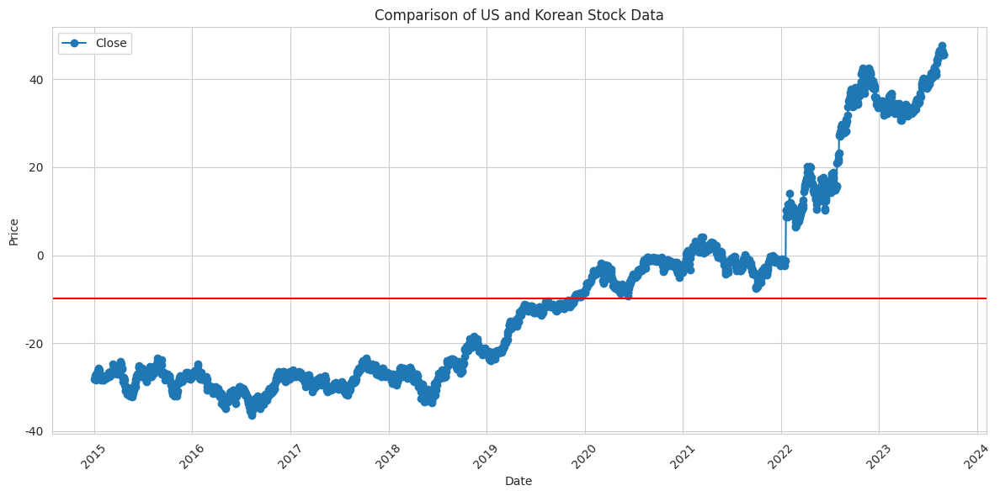

In [482]:
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Close'] - ak['kor_Close_USD'], label='Close', marker='o')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.axhline(y=(ak['Close'] - ak['kor_Close_USD']).mean(), color='red')
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

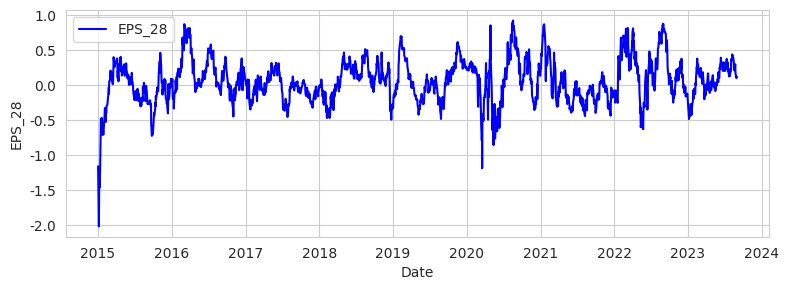

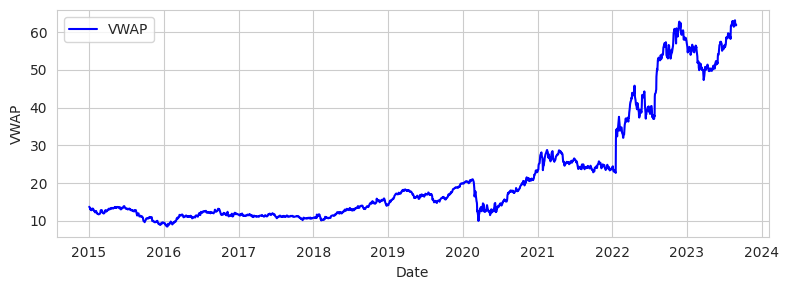

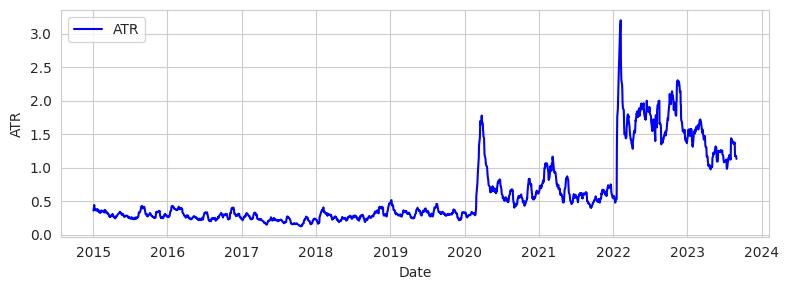

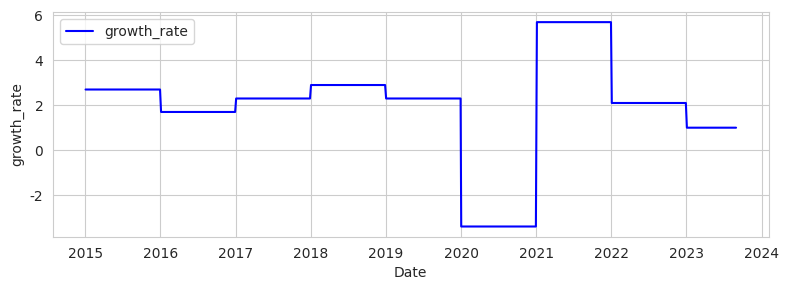

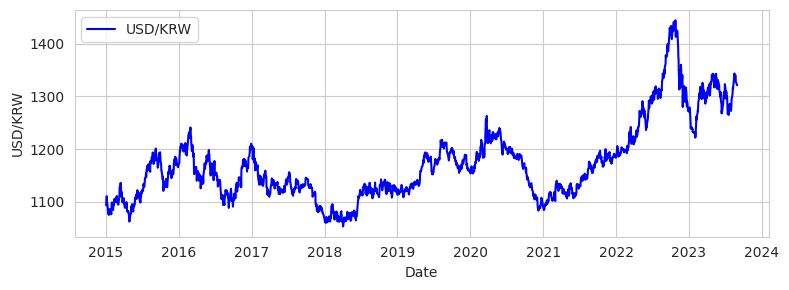

...

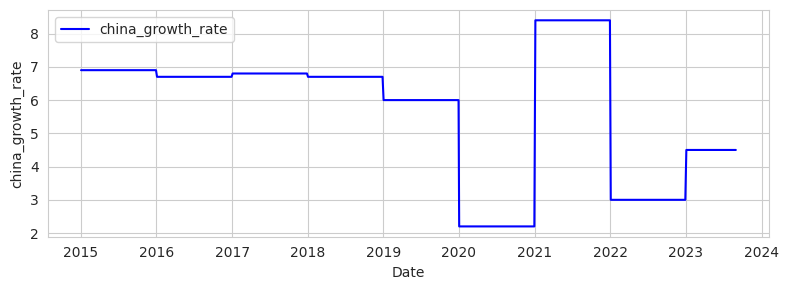

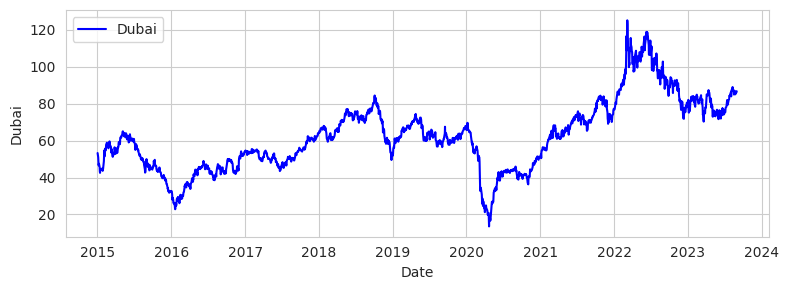

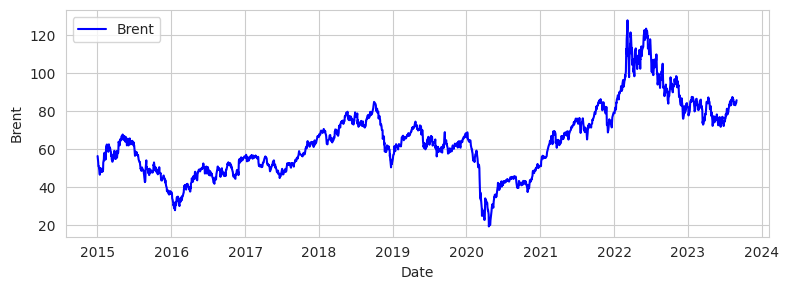

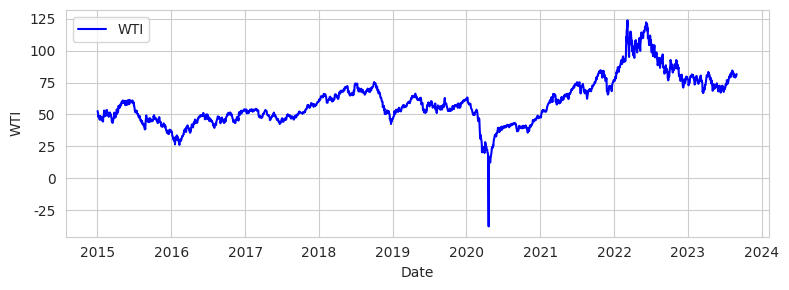

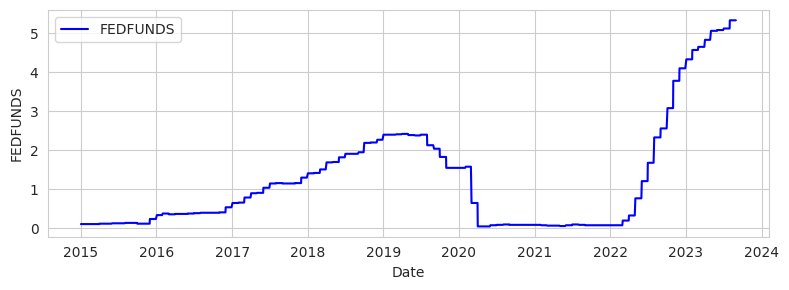

In [483]:
draw_one(ak, check_one)

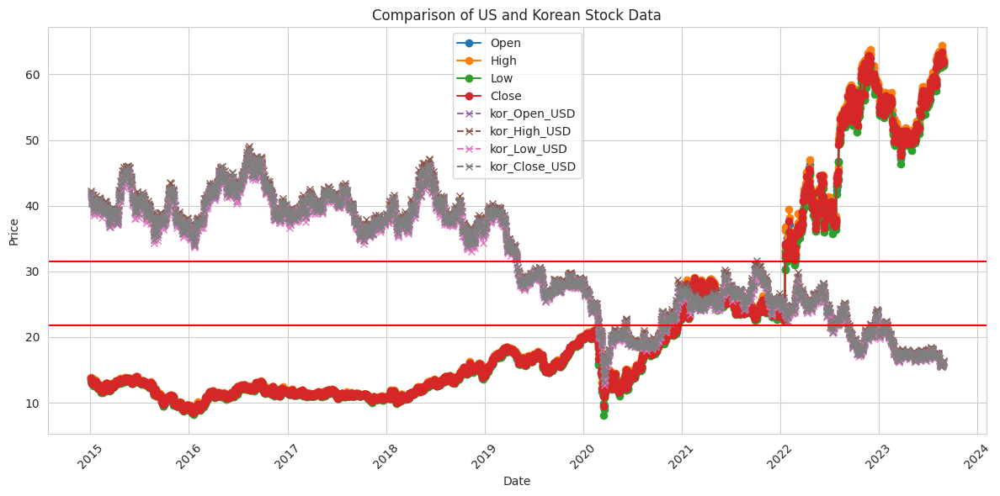

In [484]:
# 미국의 데이터를 라인 플롯으로 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Open'], label='Open', marker='o')
plt.plot(ak.index, ak['High'], label='High', marker='o')
plt.plot(ak.index, ak['Low'], label='Low', marker='o')
plt.plot(ak.index, ak['Close'], label='Close', marker='o')

# 한국의 데이터를 라인 플롯으로 그리기
plt.plot(ak.index, ak['kor_Open_USD'], label='kor_Open_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_High_USD'], label='kor_High_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Low_USD'], label='kor_Low_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Close_USD'], label='kor_Close_USD', linestyle='--', marker='x')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.axhline(y=((ak['Open']+ak['High']+ak['Low']+ak['Close'])/4).mean(), color='red')
plt.axhline(y=((ak['kor_Open_USD']+ak['kor_High_USD']+ak['kor_Low_USD']+ak['kor_Close_USD'])/4).mean(), color='red')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

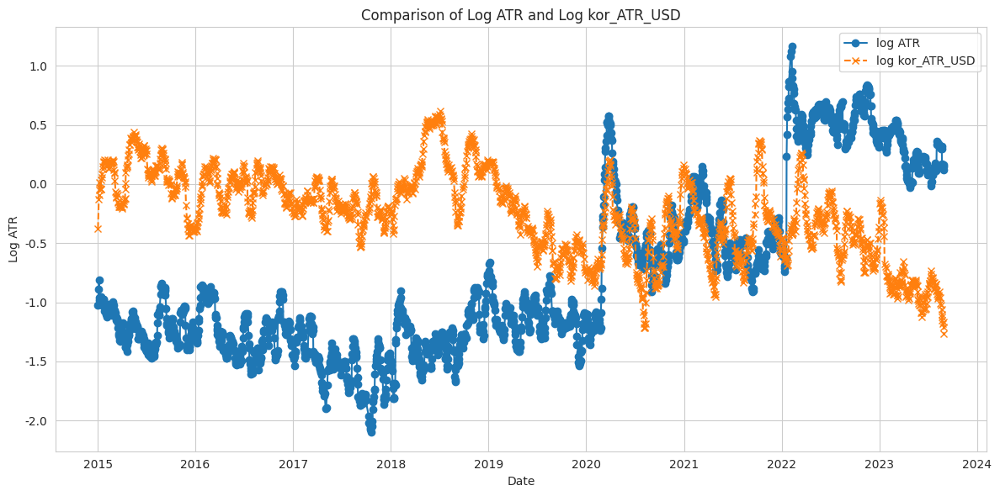

In [485]:
import matplotlib.pyplot as plt
import numpy as np

# 미국의 ATR 데이터
us_atr = ak['ATR']

# 한국의 kor_ATR_USD 데이터
kor_atr_usd = ak['kor_ATR_USD']

# 로그 스케일 적용
log_us_atr = np.log(us_atr)
log_kor_atr_usd = np.log(kor_atr_usd)

# 그래프 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, log_us_atr, label='log ATR', marker='o')
plt.plot(ak.index, log_kor_atr_usd, label='log kor_ATR_USD', linestyle='--', marker='x')

plt.title('Comparison of Log ATR and Log kor_ATR_USD')
plt.xlabel('Date')
plt.ylabel('Log ATR')
plt.legend()
plt.tight_layout()
plt.show()

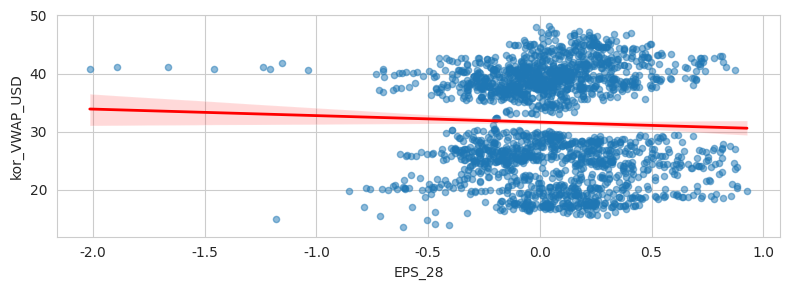

EPS_28와 kor_VWAP_USD 사이의 상관계수 : -0.04
p-value: 0.0786053072012651



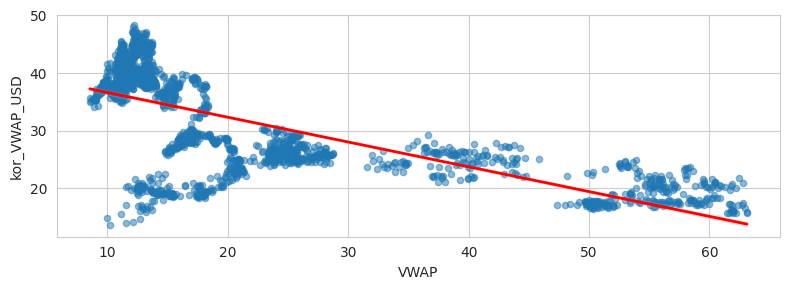

VWAP와 kor_VWAP_USD 사이의 상관계수 : -0.71
p-value: 1.617002e-317



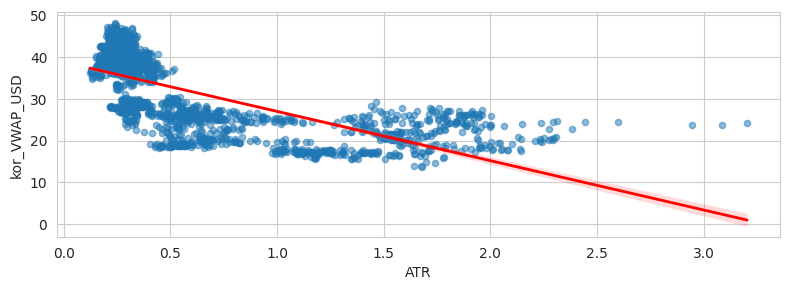

ATR와 kor_VWAP_USD 사이의 상관계수 : -0.70
p-value: 5.822305976160856e-308



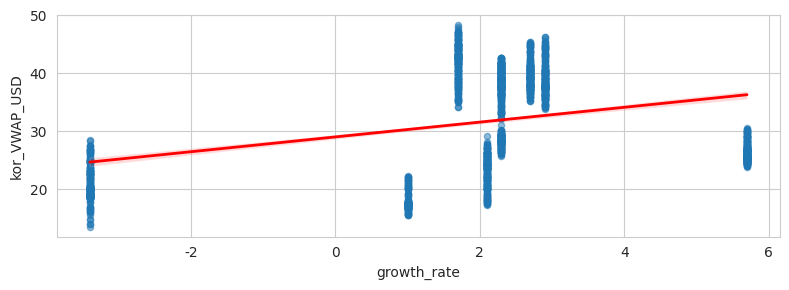

growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.33
p-value: 2.4283892689774957e-53



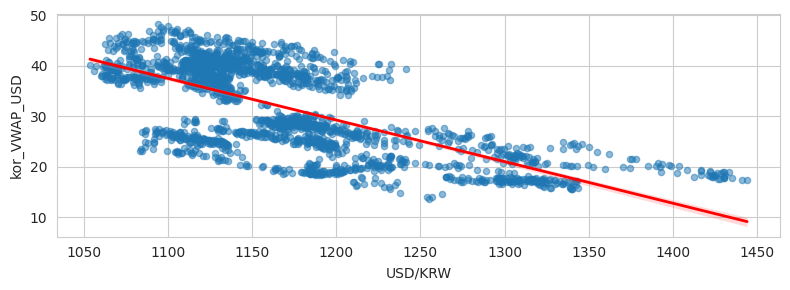

USD/KRW와 kor_VWAP_USD 사이의 상관계수 : -0.69
p-value: 1.465860493262575e-291



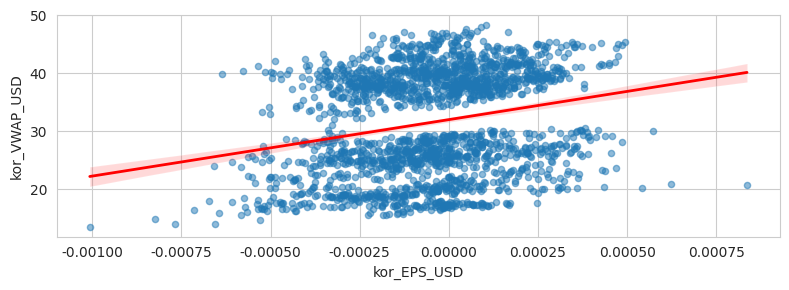

kor_EPS_USD와 kor_VWAP_USD 사이의 상관계수 : 0.24
p-value: 9.688296539324467e-28



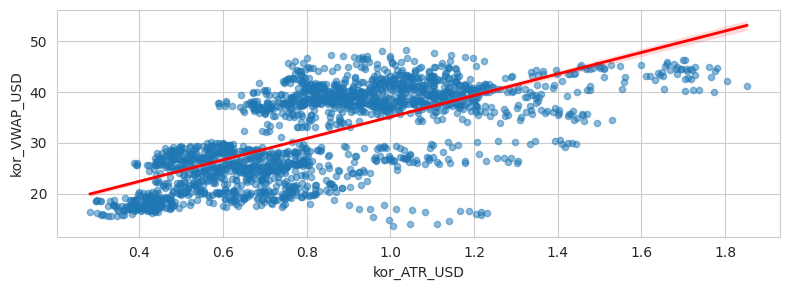

kor_ATR_USD와 kor_VWAP_USD 사이의 상관계수 : 0.69
p-value: 1.851953268351687e-296



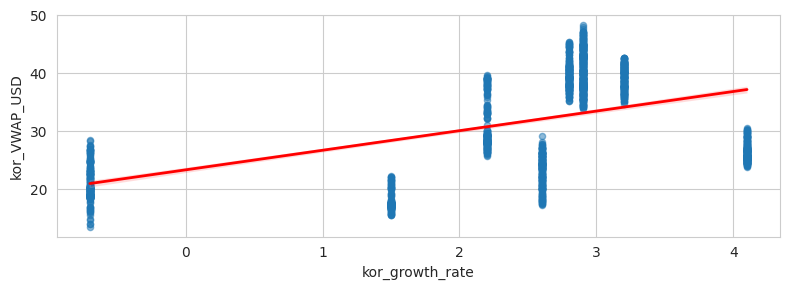

kor_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.49
p-value: 2.1061700124638508e-126



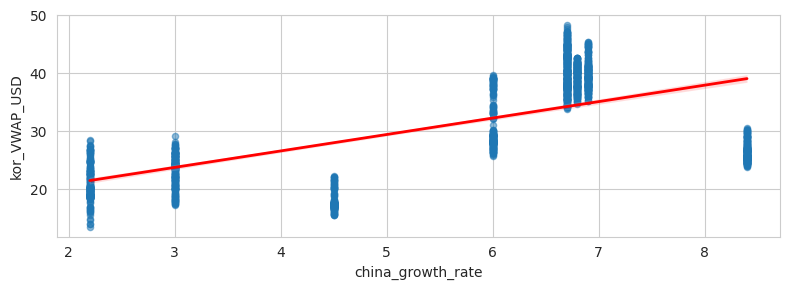

china_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.62
p-value: 2.04386979056267e-218



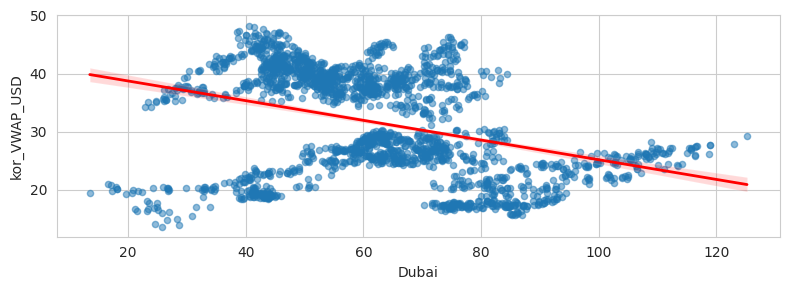

Dubai와 kor_VWAP_USD 사이의 상관계수 : -0.36
p-value: 6.702578104953712e-64



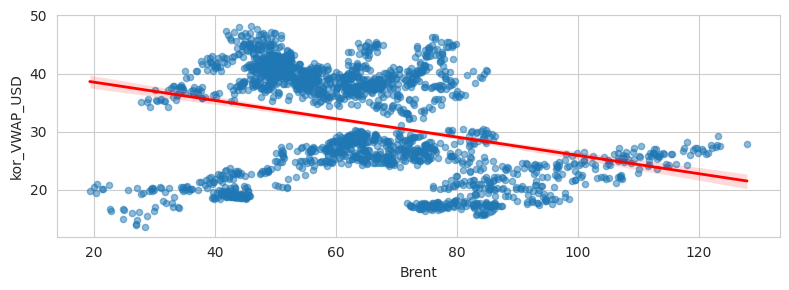

Brent와 kor_VWAP_USD 사이의 상관계수 : -0.33
p-value: 1.1588694152174743e-53



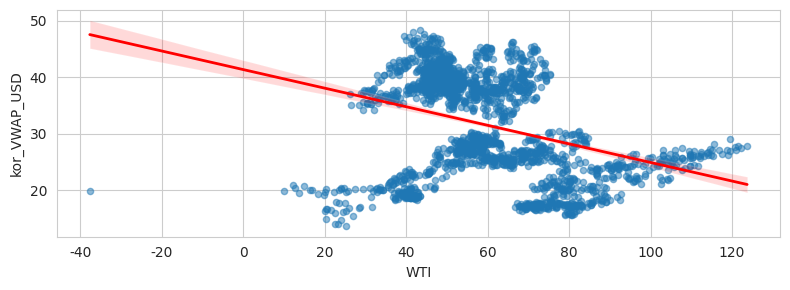

WTI와 kor_VWAP_USD 사이의 상관계수 : -0.34
p-value: 1.5365394967377094e-55



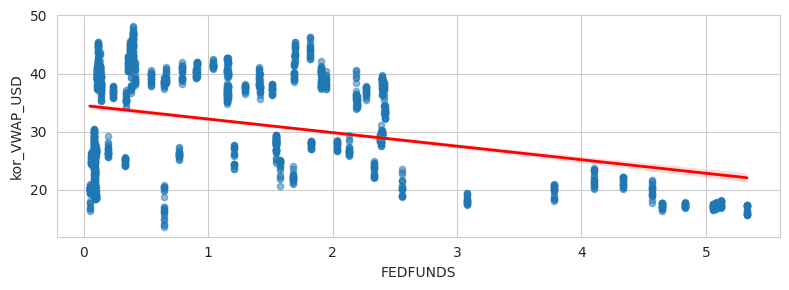

FEDFUNDS와 kor_VWAP_USD 사이의 상관계수 : -0.37
p-value: 4.984702431258508e-67



In [486]:
draw_two(ak, check_two)

In [487]:
# Pearson 상관계수 계산
correlation_matrix = ak[check_one].corr()

correlation_matrix

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
EPS_28,1.000000,0.175478,0.118225,-0.088432,0.110373,0.064316,-0.038864,0.000179,-0.071587,-0.173088,0.155310,0.150094,0.139606,0.096000
VWAP,0.175478,1.000000,0.842089,0.010398,0.791640,-0.090345,-0.711013,-0.504094,-0.091990,-0.434986,0.697361,0.688767,0.694184,0.662190
ATR,0.118225,0.842089,1.000000,-0.101745,0.763896,-0.150773,-0.703709,-0.373071,-0.164988,-0.574976,0.613535,0.619183,0.632911,0.371960
growth_rate,-0.088432,0.010398,-0.101745,1.000000,-0.215490,0.065342,0.328994,0.232072,0.958356,0.819112,0.346904,0.362968,0.367736,-0.062343
USD/KRW,0.110373,0.791640,0.763896,-0.215490,1.000000,-0.177639,-0.689932,-0.505048,-0.254964,-0.566648,0.435203,0.429088,0.437618,0.545560
kor_EPS_USD,0.064316,-0.090345,-0.150773,0.065342,-0.177639,1.000000,0.232560,0.195187,0.100889,0.077683,-0.003817,0.012194,0.020754,-0.089578
kor_VWAP_USD,-0.038864,-0.711013,-0.703709,0.328994,-0.689932,0.232560,1.000000,0.694761,0.491889,0.618870,-0.359031,-0.330053,-0.335616,-0.367412
kor_ATR_USD,0.000179,-0.504094,-0.373071,0.232072,-0.505048,0.195187,0.694761,1.000000,0.312338,0.383798,-0.161719,-0.137047,-0.156650,-0.329062
kor_growth_rate,-0.071587,-0.091990,-0.164988,0.958356,-0.254964,0.100889,0.491889,0.312338,1.000000,0.828889,0.246692,0.272245,0.287573,-0.146148
china_growth_rate,-0.173088,-0.434986,-0.574976,0.819112,-0.566648,0.077683,0.618870,0.383798,0.828889,1.000000,-0.166836,-0.155473,-0.150392,-0.248039


In [488]:
correlation_matrix[['kor_VWAP_USD']].T

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
kor_VWAP_USD,-0.038864,-0.711013,-0.703709,0.328994,-0.689932,0.23256,1.0,0.694761,0.491889,0.61887,-0.359031,-0.330053,-0.335616,-0.367412


+ 기업 간에 직접적인 소유 구조나 경영체계 연결, 합작사업, 또는 지분 투자와 같은 형태의 관계가 없음
+ 그래프의 변동성은 유사
+ 가격이 유사성이 높고 원유가격과 매우 밀접한 관계가 있으며, 환율, 금리에도 영향을 많이 받음

## 1. XLC %
+ XLC : Communication Services
    + 통신서비스에 관련한 회사 모음

### NH에서 준 정보를 활용한 상관관계 분석


In [415]:
stock_name= ['세종텔레콤',  'LG유플러스', 'SK텔레콤', '네이버']
stock_code = ['036630', '032640', '017670' , '035420']

etf = ['XLC']
#
year = '2023'
date = '0101'

find_best_R(etf, stock_name, stock_code, year, date, 0)

['거래일자', '시가', '고가', '저가', '종가', '거래량']
주식 받아오기 끝
가능한 조합: 15
상관계수 : 0.029753473909637472, p-value : 0.1219786996371978 ['네이버']
end


In [416]:
nasdaq_data.loc[nasdaq_data['sector_name'] == 'XLC', 'fc_sec_krl_nm'].unique()

array(['T-모바일 US                                                    ',
       '테이크-투 인터랙티브 소프트웨어                                           ',
       'Warner Bros Dis                                             ',
       '액티비전 블리자드                                                   ',
       '넷플릭스                                                        ',
       '차터 커뮤니케이션스                                                  ',
       '뉴스 코퍼레이션 CLASS B                                            ',
       'Paramount Global                                            ',
       '뉴스 코퍼레이션                                                    ',
       '매치 그룹                                                       ',
       '알파벳 CLASS C (non-voting)                                    ',
       '알파벳 CLASS A (voting)                                        ',
       '일렉트로닉 아츠                                                    ',
       '컴캐스트                                                        ',
      

### 주식 중 XLC에 해당하는 주식 찾기

In [455]:
list(sector_info.loc[sector_info['sector_name']=='XLC', 'comanpy_name'].unique())

['NetFlix Inc',
 'Omnicom Group',
 'Alphabet Inc C',
 'Alphabet Inc A',
 'Electronic Arts',
 'Meta Platforms, Inc. Class A',
 'Match Group, Inc.',
 'News Corp A',
 'News Corp B',
 'T-Mobile US Inc',
 'Take-Two Interactive Software',
 'Paramount Global Class B',
 'Activision Blizzard Inc',
 'Interpublic Group Cos',
 'Live Nation Entertainment Inc.',
 'Walt Disney Co',
 'Fox Corp B',
 'Verizon Communications Inc',
 'AT&T Inc',
 'Fox Corp A',
 'Comcast Corp A',
 'Charter Communications Inc A',
 'Warner Bros Discovery Inc.']

In [317]:
#조사할 데이터
america_list = list(sector_info.loc[sector_info['sector_name']=='XLC', 'tck_iem_cd'].unique())
#['GOOGL', 'T', 'VZ', 'DIS']
korea_list = ['036630', '032640', '017670' , '035420']

In [318]:
ak = return_ak(america_list, korea_list)

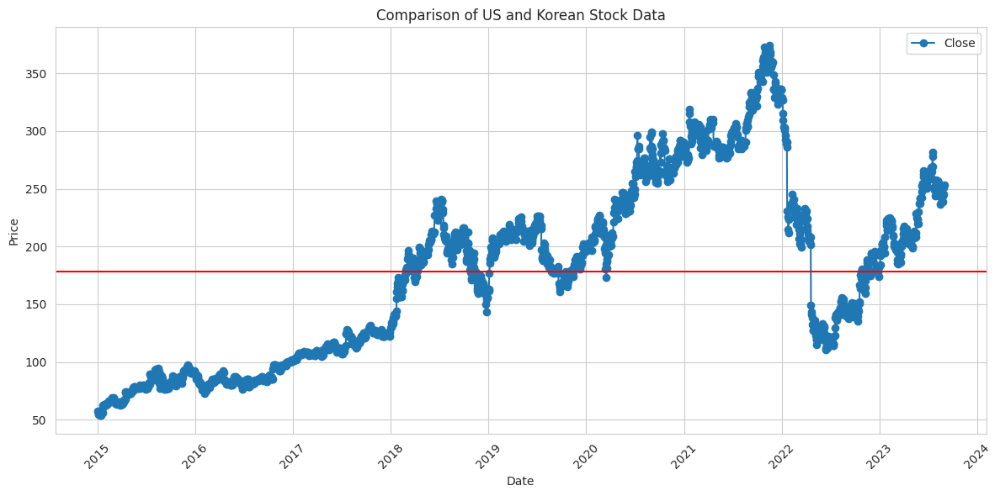

In [319]:
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Close'] - ak['kor_Close_USD'], label='Close', marker='o')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.axhline(y=(ak['Close'] - ak['kor_Close_USD']).mean(), color='red')
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

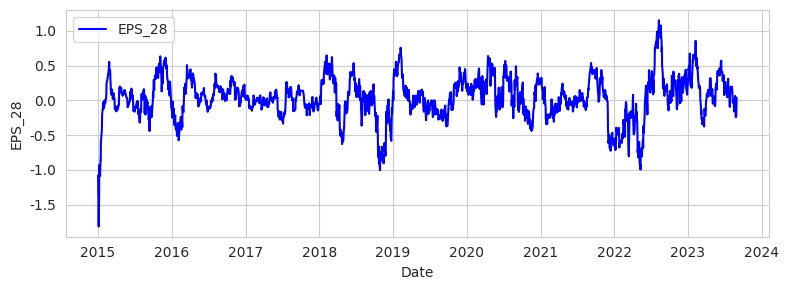

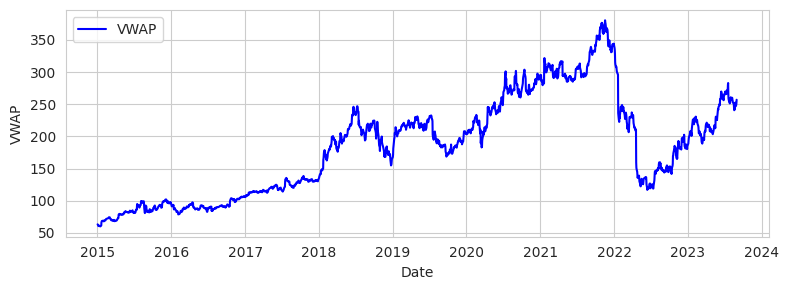

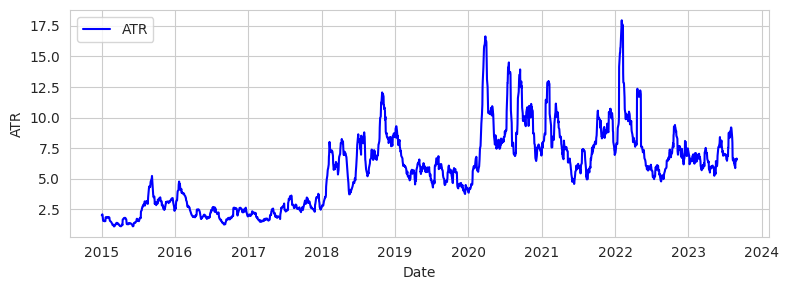

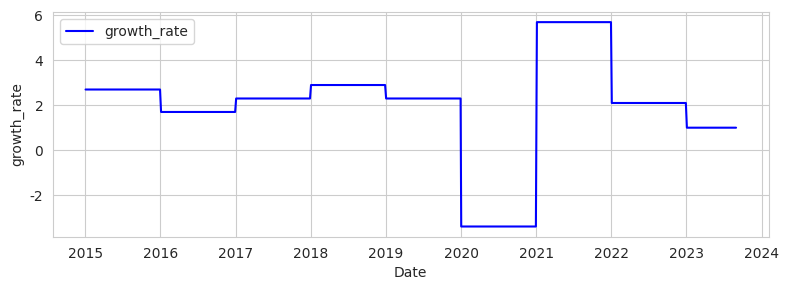

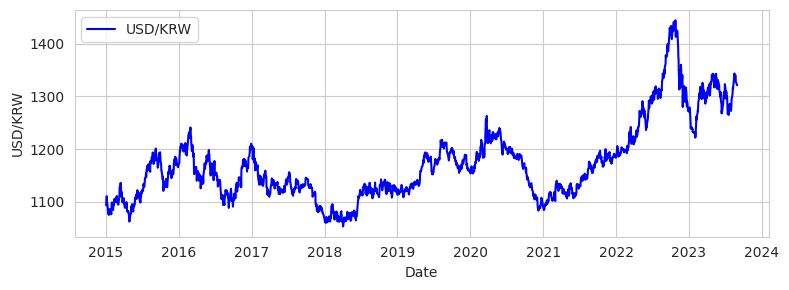

...

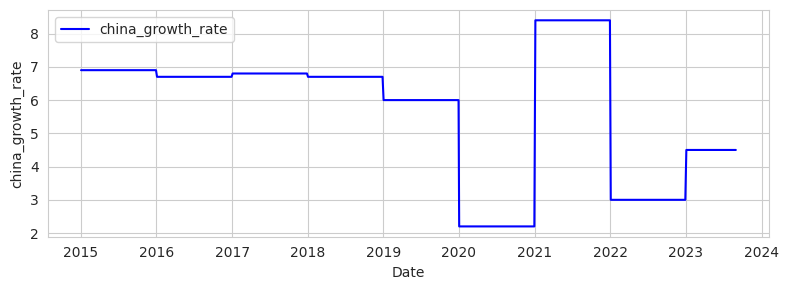

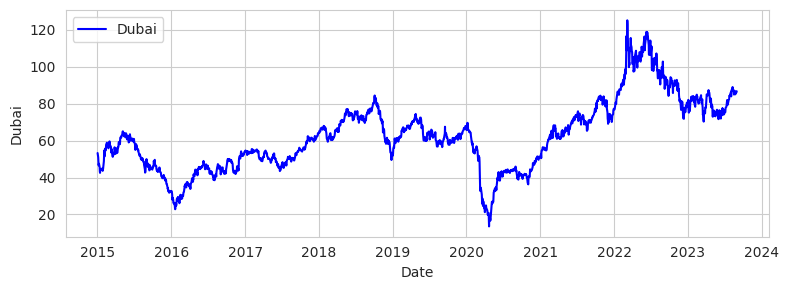

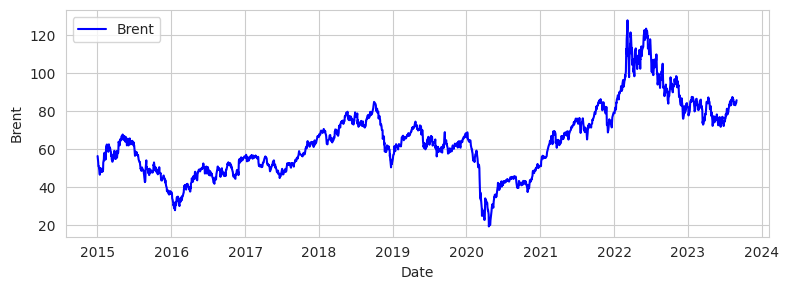

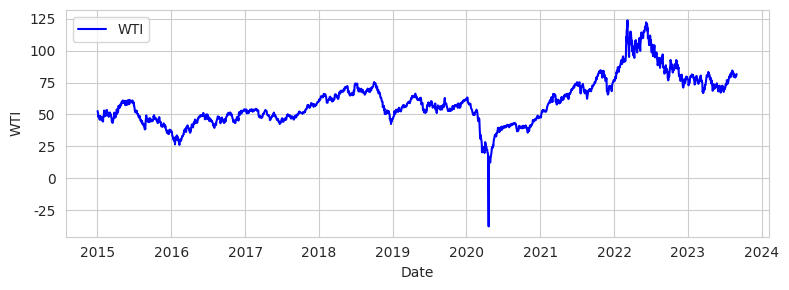

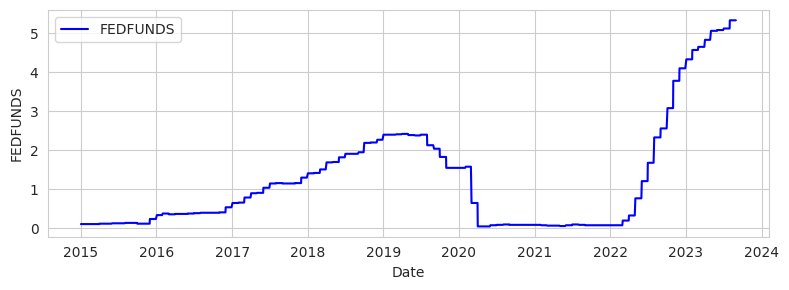

In [320]:
draw_one(ak, check_one)

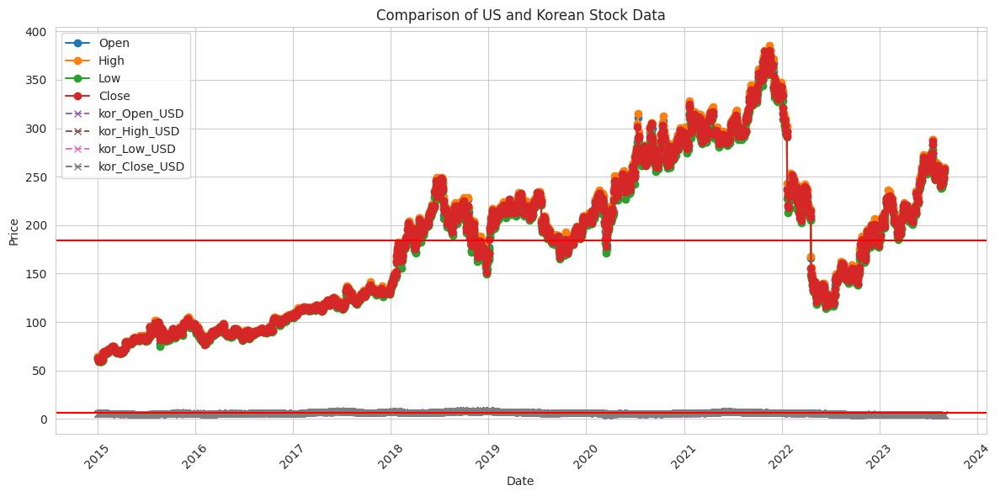

In [321]:
# 미국의 데이터를 라인 플롯으로 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Open'], label='Open', marker='o')
plt.plot(ak.index, ak['High'], label='High', marker='o')
plt.plot(ak.index, ak['Low'], label='Low', marker='o')
plt.plot(ak.index, ak['Close'], label='Close', marker='o')

# 한국의 데이터를 라인 플롯으로 그리기
plt.plot(ak.index, ak['kor_Open_USD'], label='kor_Open_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_High_USD'], label='kor_High_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Low_USD'], label='kor_Low_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Close_USD'], label='kor_Close_USD', linestyle='--', marker='x')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.axhline(y=((ak['Open']+ak['High']+ak['Low']+ak['Close'])/4).mean(), color='red')
plt.axhline(y=((ak['kor_Open_USD']+ak['kor_High_USD']+ak['kor_Low_USD']+ak['kor_Close_USD'])/4).mean(), color='red')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

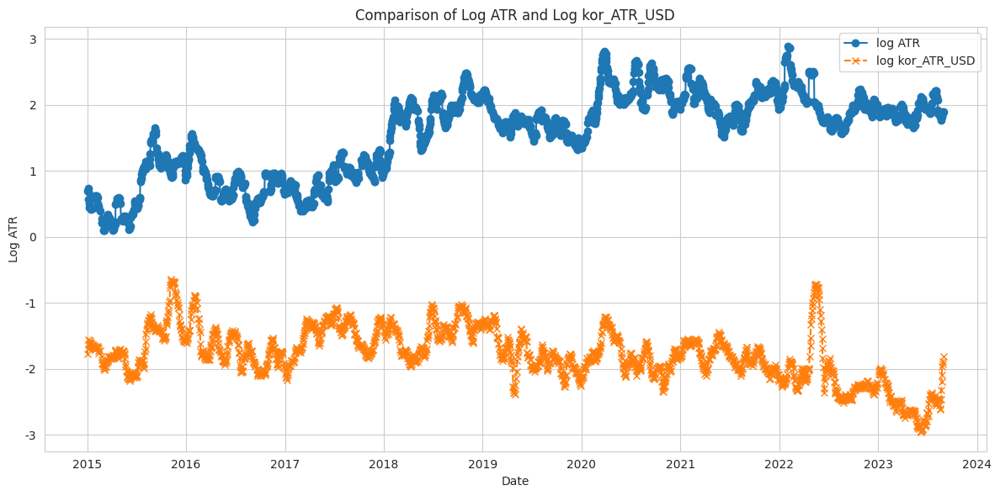

In [322]:
import matplotlib.pyplot as plt
import numpy as np

# 미국의 ATR 데이터
us_atr = ak['ATR']

# 한국의 kor_ATR_USD 데이터
kor_atr_usd = ak['kor_ATR_USD']

# 로그 스케일 적용
log_us_atr = np.log(us_atr)
log_kor_atr_usd = np.log(kor_atr_usd)

# 그래프 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, log_us_atr, label='log ATR', marker='o')
plt.plot(ak.index, log_kor_atr_usd, label='log kor_ATR_USD', linestyle='--', marker='x')

plt.title('Comparison of Log ATR and Log kor_ATR_USD')
plt.xlabel('Date')
plt.ylabel('Log ATR')
plt.legend()
plt.tight_layout()
plt.show()

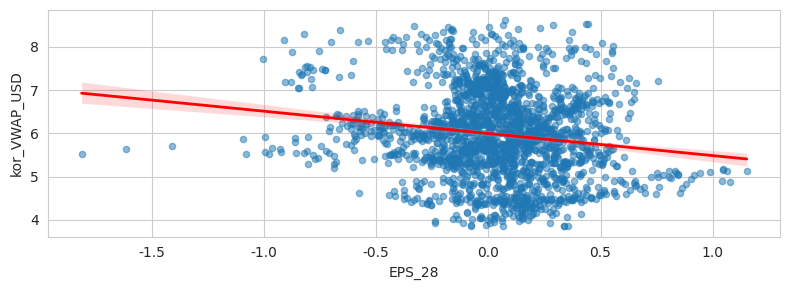

EPS_28와 kor_VWAP_USD 사이의 상관계수 : -0.16
p-value: 5.201373466087481e-14



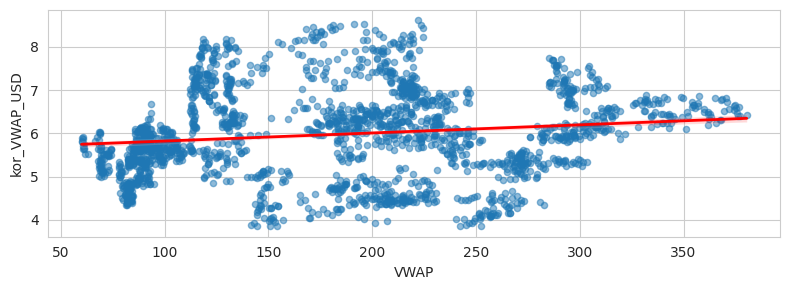

VWAP와 kor_VWAP_USD 사이의 상관계수 : 0.14
p-value: 4.634835071014369e-11



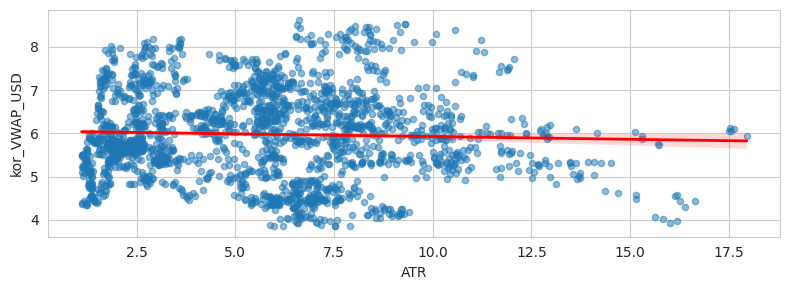

ATR와 kor_VWAP_USD 사이의 상관계수 : -0.04
p-value: 0.10685221875883438



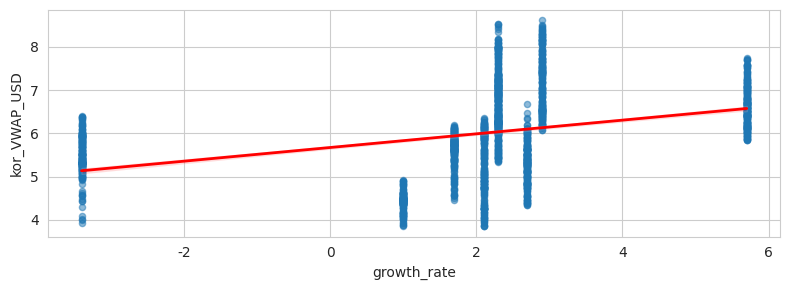

growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.36
p-value: 1.6883214432845094e-65



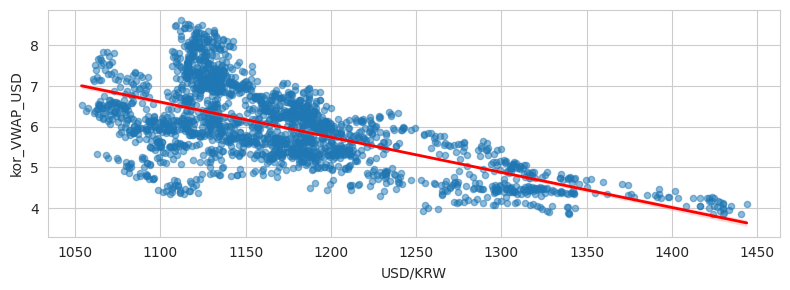

USD/KRW와 kor_VWAP_USD 사이의 상관계수 : -0.64
p-value: 6.73477390832496e-235



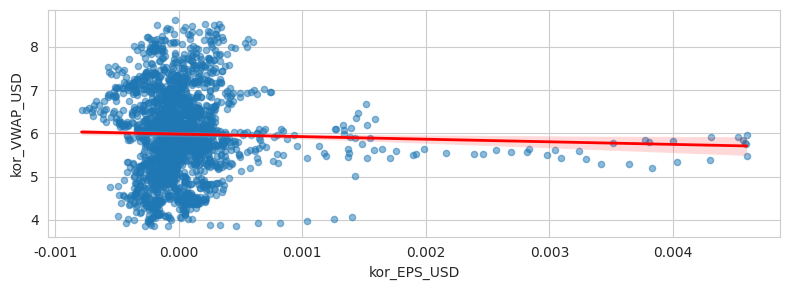

kor_EPS_USD와 kor_VWAP_USD 사이의 상관계수 : -0.01
p-value: 0.6463731656272549



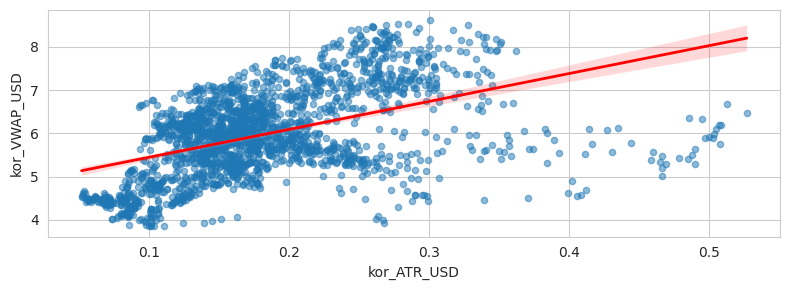

kor_ATR_USD와 kor_VWAP_USD 사이의 상관계수 : 0.49
p-value: 1.6141358121465903e-126



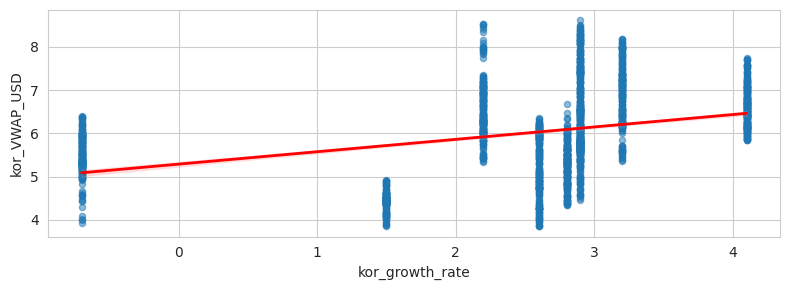

kor_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.37
p-value: 9.158289877929251e-69



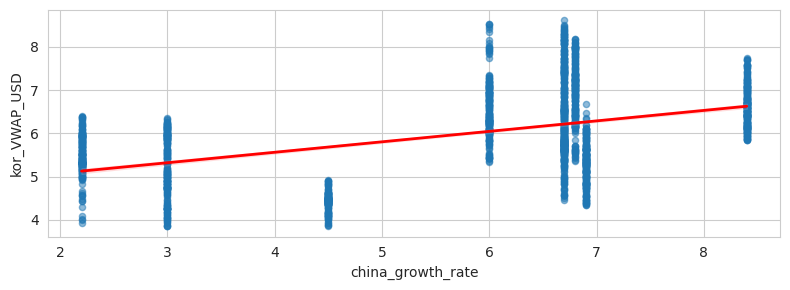

china_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.47
p-value: 1.39691031867371e-111



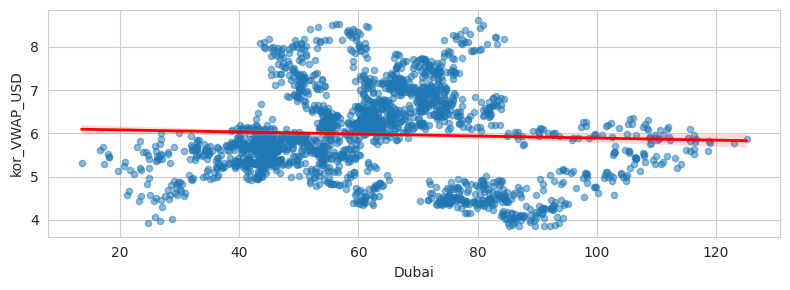

Dubai와 kor_VWAP_USD 사이의 상관계수 : -0.04
p-value: 0.10717177562183625



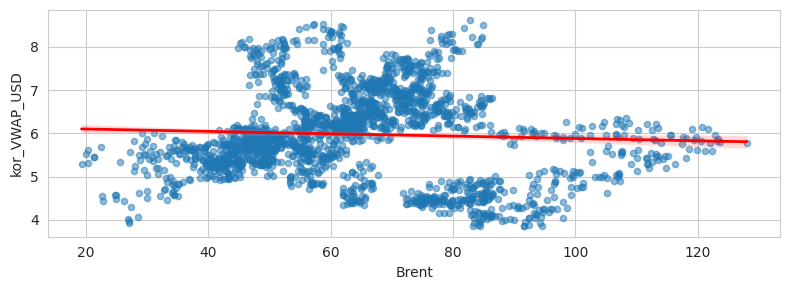

Brent와 kor_VWAP_USD 사이의 상관계수 : -0.04
p-value: 0.06009443067115616



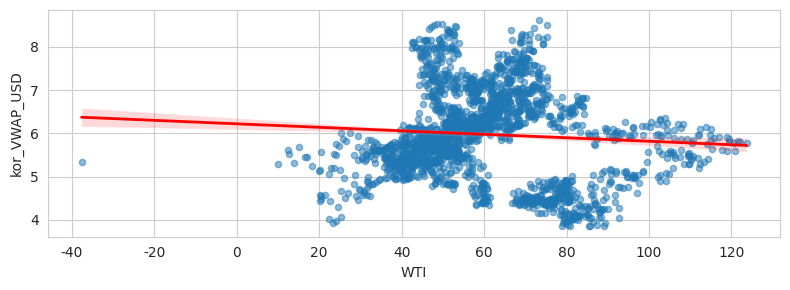

WTI와 kor_VWAP_USD 사이의 상관계수 : -0.06
p-value: 0.003948893763851985



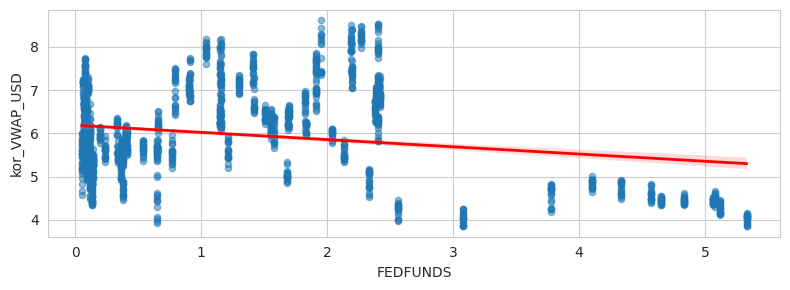

FEDFUNDS와 kor_VWAP_USD 사이의 상관계수 : -0.23
p-value: 7.778571192176854e-27



In [323]:
draw_two(ak, check_two)

In [324]:
# Pearson 상관계수 계산
correlation_matrix = ak[check_one].corr()

correlation_matrix

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
EPS_28,1.000000,0.012745,-0.133214,-0.144594,0.138474,-0.138589,-0.155591,-0.141360,-0.159775,-0.114828,-0.057766,-0.054729,-0.068114,0.154998
VWAP,0.012745,1.000000,0.733121,0.026395,0.103796,-0.142464,0.145632,-0.288863,-0.172947,-0.131234,0.301460,0.267593,0.270753,0.106490
ATR,-0.133214,0.733121,1.000000,-0.202582,0.285292,-0.000847,-0.039701,-0.128474,-0.351718,-0.439248,0.289311,0.268011,0.263701,0.109116
growth_rate,-0.144594,0.026395,-0.202582,1.000000,-0.215490,0.000826,0.362058,0.112158,0.958356,0.819112,0.346904,0.362968,0.367736,-0.062343
USD/KRW,0.138474,0.103796,0.285292,-0.215490,1.000000,0.164488,-0.640962,-0.394057,-0.254964,-0.566648,0.435203,0.429088,0.437618,0.545560
kor_EPS_USD,-0.138589,-0.142464,-0.000847,0.000826,0.164488,1.000000,-0.030950,0.331651,0.004628,-0.161816,0.254215,0.281538,0.307777,-0.041270
kor_VWAP_USD,-0.155591,0.145632,-0.039701,0.362058,-0.640962,-0.030950,1.000000,0.483850,0.370867,0.469200,-0.044452,-0.050718,-0.073078,-0.233183
kor_ATR_USD,-0.141360,-0.288863,-0.128474,0.112158,-0.394057,0.331651,0.483850,1.000000,0.187842,0.277355,-0.307467,-0.285953,-0.293265,-0.316000
kor_growth_rate,-0.159775,-0.172947,-0.351718,0.958356,-0.254964,0.004628,0.370867,0.187842,1.000000,0.828889,0.246692,0.272245,0.287573,-0.146148
china_growth_rate,-0.114828,-0.131234,-0.439248,0.819112,-0.566648,-0.161816,0.469200,0.277355,0.828889,1.000000,-0.166836,-0.155473,-0.150392,-0.248039


In [325]:
correlation_matrix[['kor_VWAP_USD']].T

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
kor_VWAP_USD,-0.155591,0.145632,-0.039701,0.362058,-0.640962,-0.03095,1.0,0.48385,0.370867,0.4692,-0.044452,-0.050718,-0.073078,-0.233183


## XLY %
  + XLY : Consumer Discretionary
    + 사치재, 소득의 여유가 있다면 소비하고 싶어하고 소비하는 것들에 대한 회사들의 모음

### NH에서 준 정보를 활용한 상관관계 분석


In [326]:
# # xly
stock_name=  ['대한항공', '진에어', '현대백화점', 'jpyent', '하이브']
stock_code = ['003490', '272450', '069960', '035900', '352820']

etf = ['XLY']
#
year = '2023'
date = '0101'

find_best_R(etf, stock_name, stock_code, year, date, 0)

['거래일자', '시가', '고가', '저가', '종가', '거래량']
주식 받아오기 끝
가능한 조합: 31
상관계수 : 0.013985183759202387, p-value : 0.4545298938601882 ['대한항공']
상관계수 : 0.022884528260740302, p-value : 0.22099212520270653 ['jpyent']
상관계수 : 0.023122500780253404, p-value : 0.21622644209978867 ['대한항공' 'jpyent']
상관계수 : 0.02427722419041239, p-value : 0.1941503453535559 ['현대백화점' 'jpyent']
상관계수 : 0.024447137525095, p-value : 0.19104675579192038 ['대한항공' '현대백화점' 'jpyent']
end


In [327]:
nasdaq_data.loc[nasdaq_data['sector_name'] == 'XLY', 'fc_sec_krl_nm'].unique()

array(['이베이                                                         ',
       '시저스 엔터테인먼트                                                  ',
       'Tractor Supply                                              ',
       'Airbnb                                                      ',
       '오레일리 오토모티브                                                  ',
       '로스 스토어스                                                     ',
       '아마존 닷컴                                                      ',
       '익스피디아 그룹                                                    ',
       '풀 코퍼레이션                                                     ',
       '얼타 뷰티                                                       ',
       '메리어트 인터내셔널/매릴랜드                                             ',
       '엣시                                                          ',
       'LKQ                                                         ',
       '윈 리조츠                                                       ',
      

### 주식 중 XLY에 해당하는 주식 찾기

In [454]:
list(sector_info.loc[sector_info['sector_name']=='XLY', 'comanpy_name'].unique())

['Hasbro Inc',
 'Amazon.com Inc',
 'eBay Inc.',
 'General Motors Company',
 'Airbnb, Inc. Class A',
 'Carmax Inc',
 'Etsy, Inc.',
 'Borgwarner Inc',
 'Ford Motor Co',
 'Aptiv plc',
 'Booking Holdings Inc',
 "Lowe's Cos Inc",
 'Pool Corp',
 'LKQ Corp',
 'Ralph Lauren Corp A',
 'MGM Resorts International',
 'Tesla, Inc',
 'Best Buy Co Inc',
 'Whirlpool Corp',
 'Tractor Supply Co',
 "Domino's Pizza Inc",
 'Genuine Parts Co',
 'AutoZone Inc',
 'Caesars Entertainment, Inc.',
 'Home Depot Inc',
 'Hilton Worldwide Holdings  Inc',
 'Garmin Ltd',
 'NVR Inc',
 'Pulte Group Inc',
 'Yum! Brands Inc',
 'Mohawk Industries Inc',
 'Ulta Beauty, Inc',
 'Bath & Body Works Inc',
 'Expedia Group, Inc.',
 "O'Reilly Automotive",
 'NIKE Inc B',
 'Royal Caribbean Group',
 'Lennar Corp A',
 'Marriott Intl A',
 'Chipotle Mexican Grill Inc.',
 "McDonald's Corp",
 'Las Vegas Sands',
 'Wynn Resorts Ltd',
 'Starbucks Corp',
 'TJX Cos Inc',
 'Horton D.R. Inc',
 'Carnival Corp',
 'Tapestry, Inc',
 'VF Corp',
 'Darden

In [489]:
#조사할 데이터
america_list = list(sector_info.loc[sector_info['sector_name']=='XLY', 'tck_iem_cd'].unique())
#['AMZN', 'NKE', 'SBUX', 'BKNG']
korea_list = ['003490', '272450', '069960', '035900', '352820']

In [490]:
ak = return_ak(america_list, korea_list)

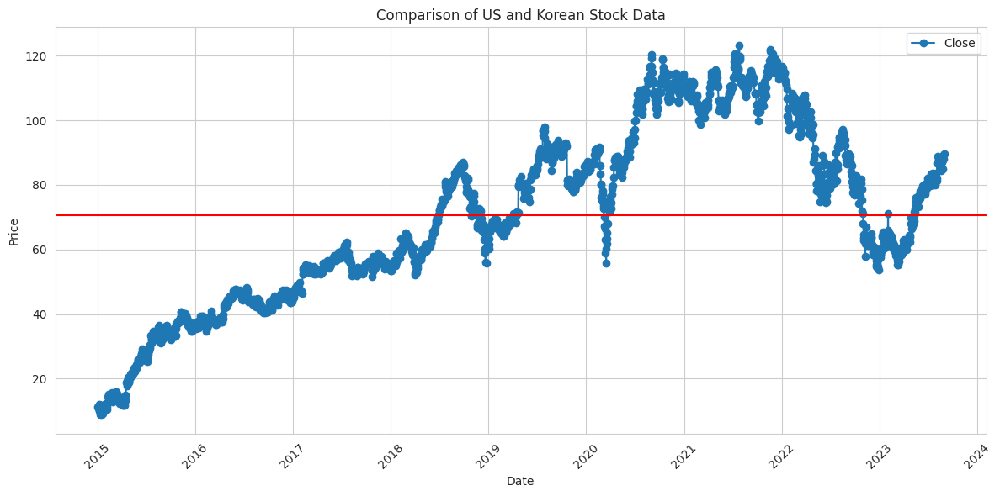

In [491]:
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Close'] - ak['kor_Close_USD'], label='Close', marker='o')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.axhline(y=(ak['Close'] - ak['kor_Close_USD']).mean(), color='red')
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

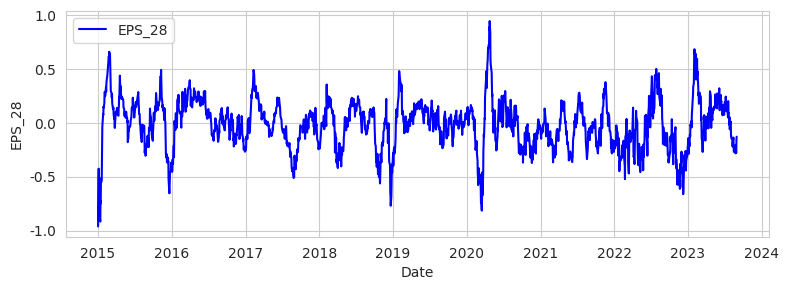

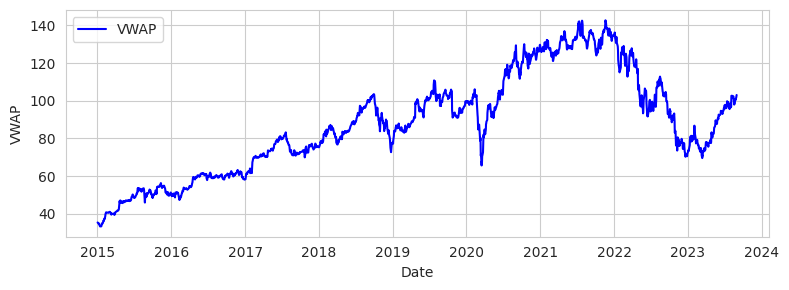

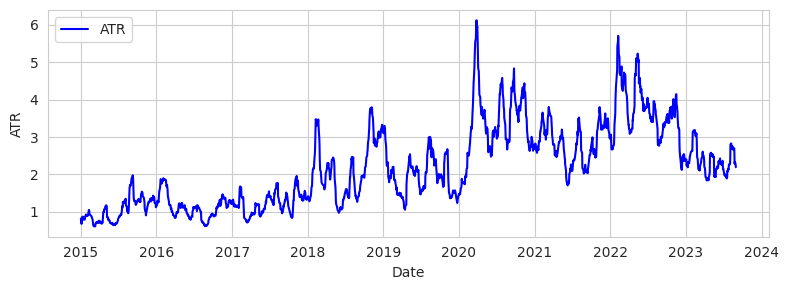

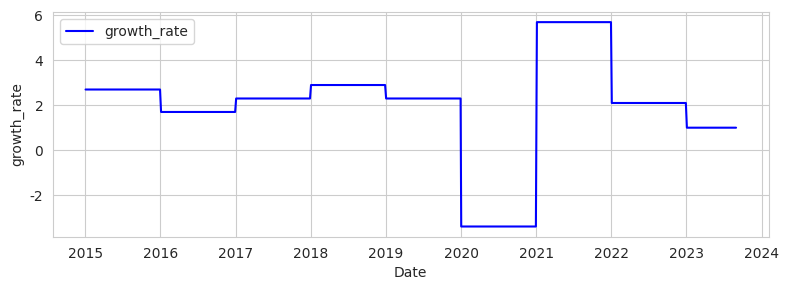

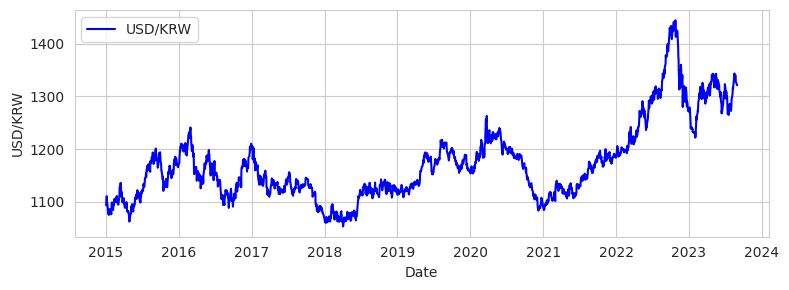

...

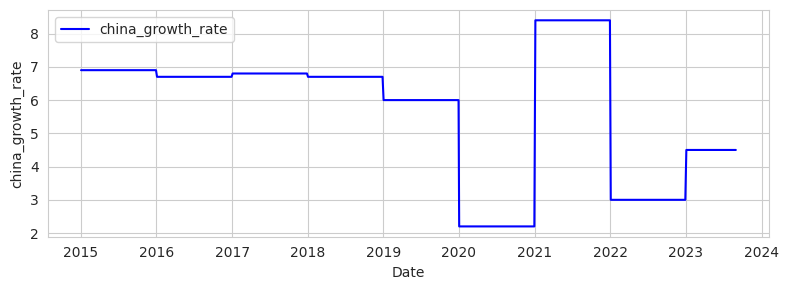

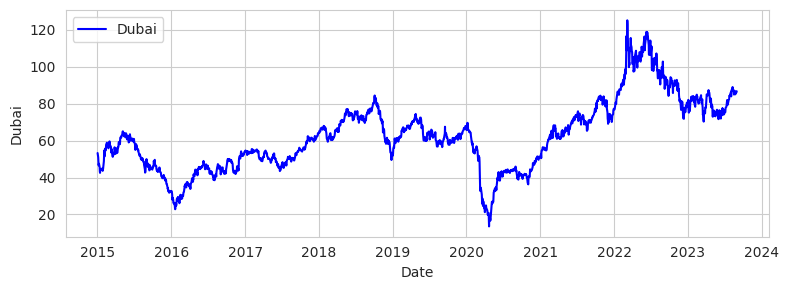

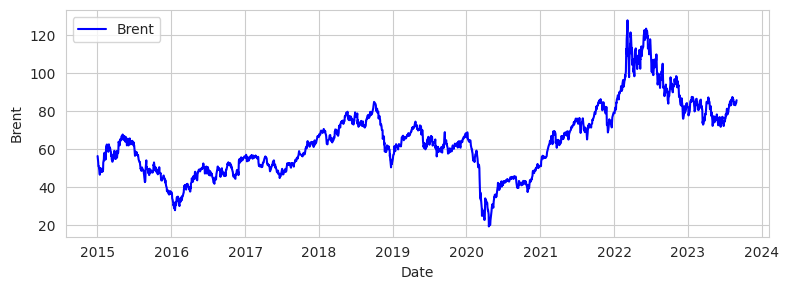

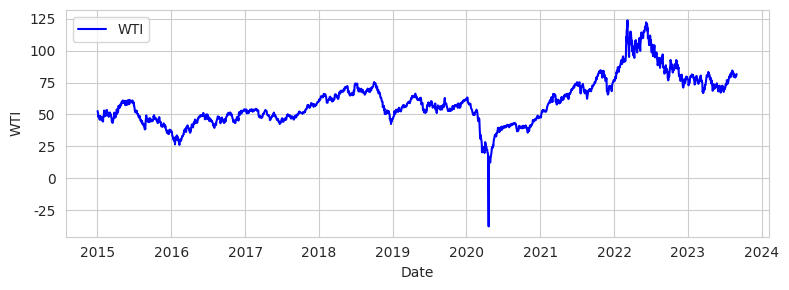

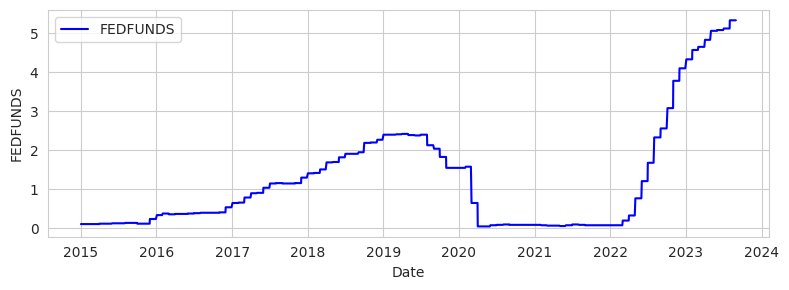

In [492]:
draw_one(ak, check_one)

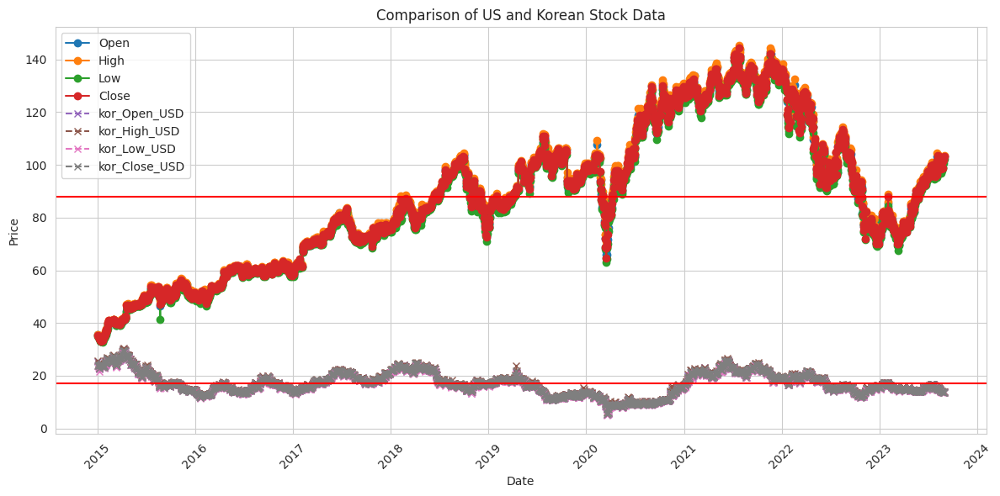

In [493]:
# 미국의 데이터를 라인 플롯으로 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Open'], label='Open', marker='o')
plt.plot(ak.index, ak['High'], label='High', marker='o')
plt.plot(ak.index, ak['Low'], label='Low', marker='o')
plt.plot(ak.index, ak['Close'], label='Close', marker='o')

# 한국의 데이터를 라인 플롯으로 그리기
plt.plot(ak.index, ak['kor_Open_USD'], label='kor_Open_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_High_USD'], label='kor_High_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Low_USD'], label='kor_Low_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Close_USD'], label='kor_Close_USD', linestyle='--', marker='x')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.axhline(y=((ak['Open']+ak['High']+ak['Low']+ak['Close'])/4).mean(), color='red')
plt.axhline(y=((ak['kor_Open_USD']+ak['kor_High_USD']+ak['kor_Low_USD']+ak['kor_Close_USD'])/4).mean(), color='red')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

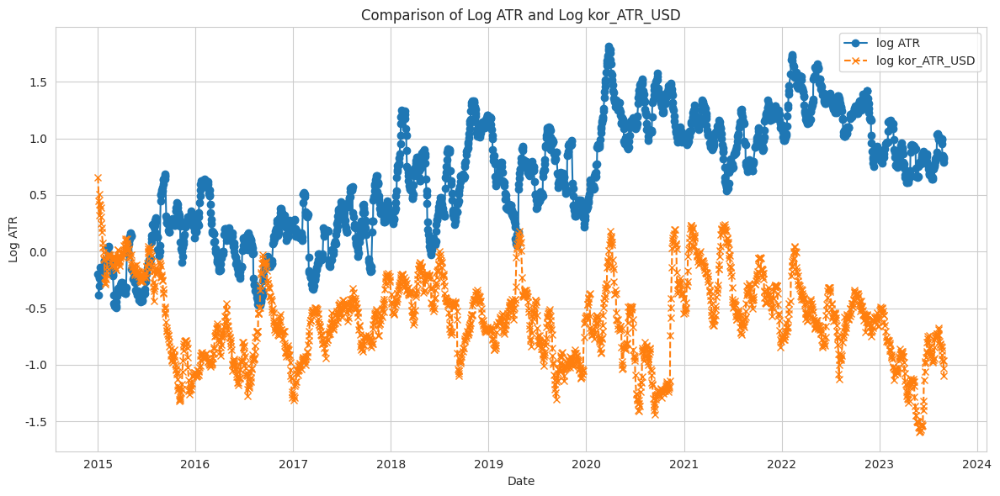

In [494]:
import matplotlib.pyplot as plt
import numpy as np

# 미국의 ATR 데이터
us_atr = ak['ATR']

# 한국의 kor_ATR_USD 데이터
kor_atr_usd = ak['kor_ATR_USD']

# 로그 스케일 적용
log_us_atr = np.log(us_atr)
log_kor_atr_usd = np.log(kor_atr_usd)

# 그래프 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, log_us_atr, label='log ATR', marker='o')
plt.plot(ak.index, log_kor_atr_usd, label='log kor_ATR_USD', linestyle='--', marker='x')

plt.title('Comparison of Log ATR and Log kor_ATR_USD')
plt.xlabel('Date')
plt.ylabel('Log ATR')
plt.legend()
plt.tight_layout()
plt.show()

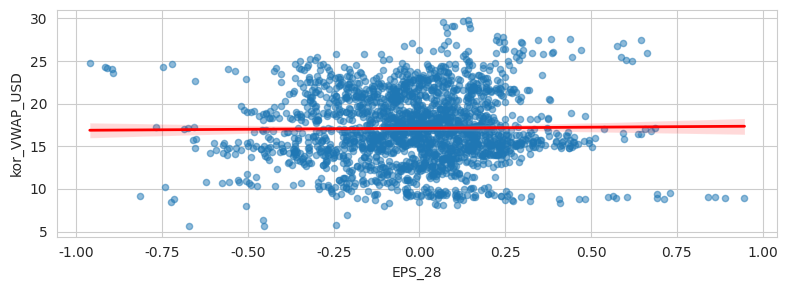

EPS_28와 kor_VWAP_USD 사이의 상관계수 : 0.01
p-value: 0.5637608087219755



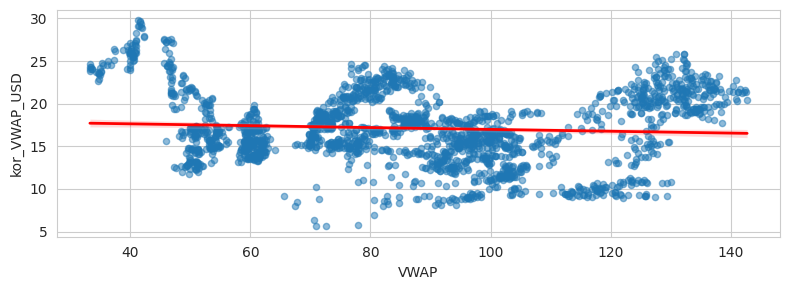

VWAP와 kor_VWAP_USD 사이의 상관계수 : -0.07
p-value: 0.0018723326465425992



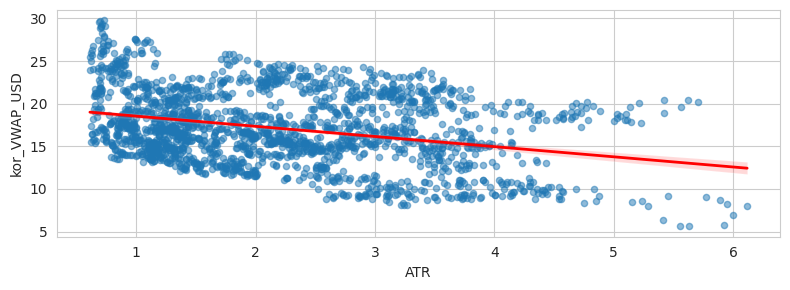

ATR와 kor_VWAP_USD 사이의 상관계수 : -0.31
p-value: 1.0896447535703626e-47



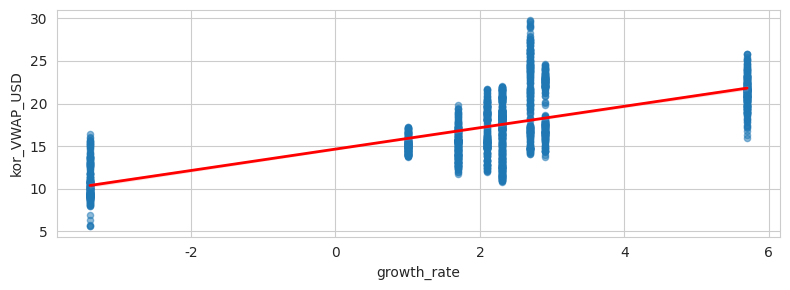

growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.69
p-value: 6.50892861812904e-291



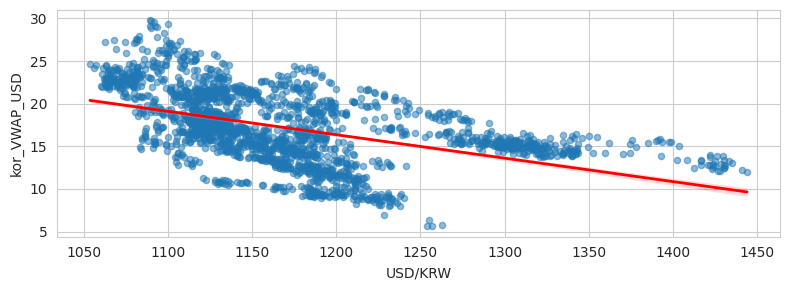

USD/KRW와 kor_VWAP_USD 사이의 상관계수 : -0.49
p-value: 2.929521246046892e-125



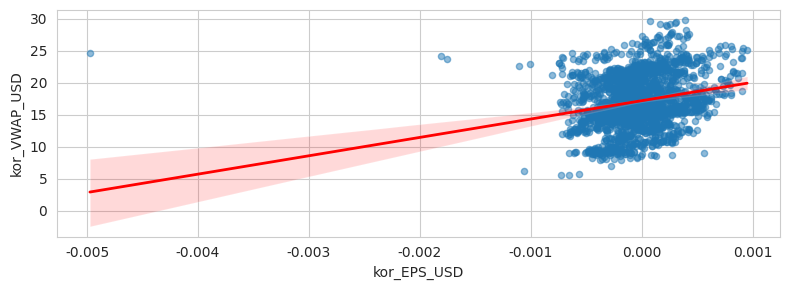

kor_EPS_USD와 kor_VWAP_USD 사이의 상관계수 : 0.23
p-value: 3.0451124239676045e-27



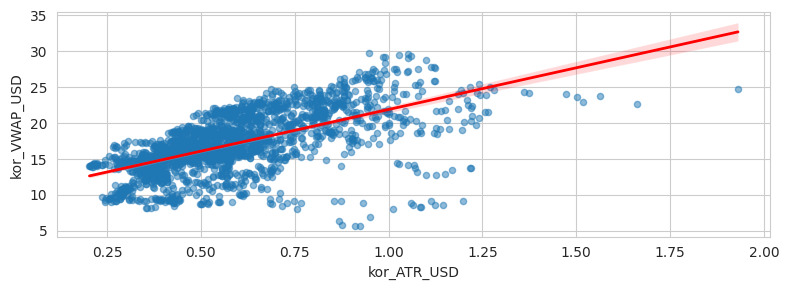

kor_ATR_USD와 kor_VWAP_USD 사이의 상관계수 : 0.61
p-value: 1.3391585399214002e-213



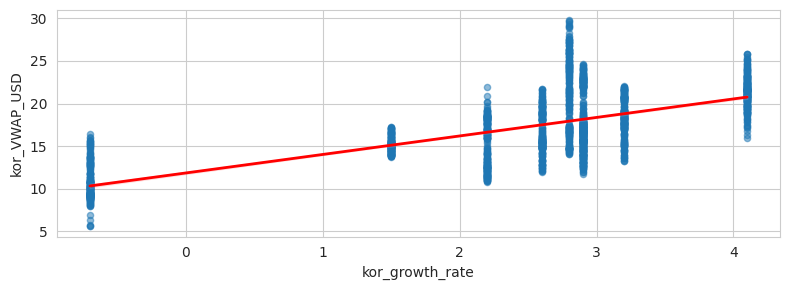

kor_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.67
p-value: 7.111922036767396e-274



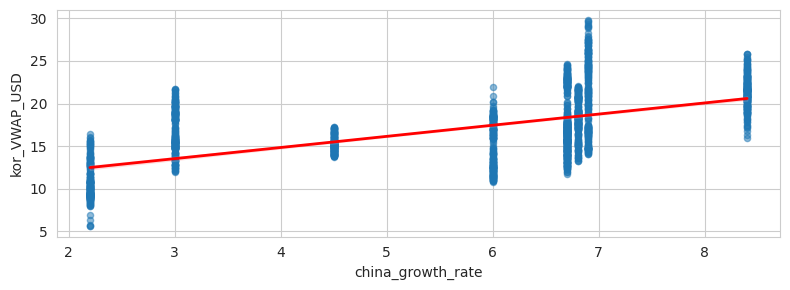

china_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.61
p-value: 7.180751428914567e-209



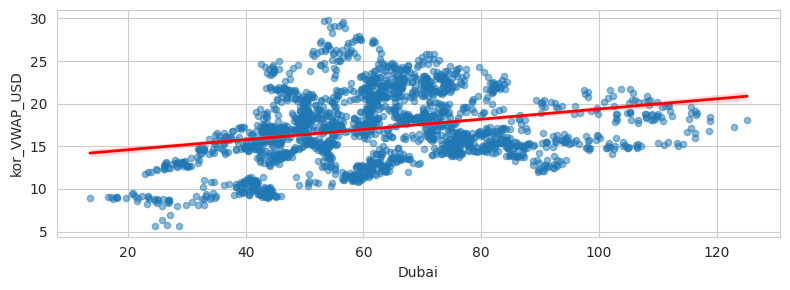

Dubai와 kor_VWAP_USD 사이의 상관계수 : 0.27
p-value: 2.1430409954752354e-35



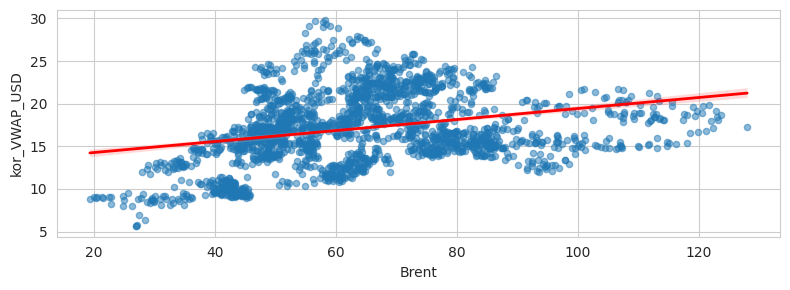

Brent와 kor_VWAP_USD 사이의 상관계수 : 0.29
p-value: 2.0799685269374575e-40



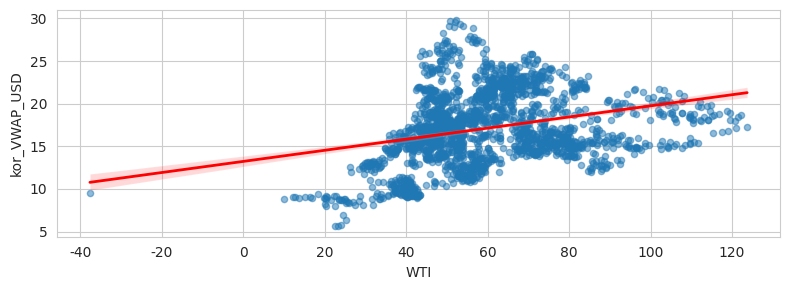

WTI와 kor_VWAP_USD 사이의 상관계수 : 0.28
p-value: 2.680339868284756e-39



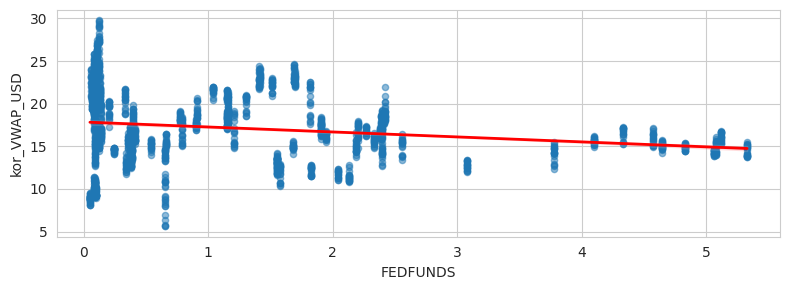

FEDFUNDS와 kor_VWAP_USD 사이의 상관계수 : -0.20
p-value: 3.6224076664730017e-19



In [495]:
draw_two(ak, check_two)

In [496]:
# Pearson 상관계수 계산
correlation_matrix = ak[check_one].corr()

correlation_matrix

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
EPS_28,1.000000,-0.092785,-0.227175,-0.031469,-0.041173,0.070292,0.013316,-0.121253,-0.032551,0.078034,-0.085174,-0.081766,-0.103298,0.011062
VWAP,-0.092785,1.000000,0.657461,0.067599,0.134989,0.155625,-0.069729,0.044727,-0.090816,-0.184944,0.417089,0.386384,0.402395,-0.020687
ATR,-0.227175,0.657461,1.000000,-0.236220,0.439230,-0.026764,-0.311970,0.007715,-0.346823,-0.558224,0.375318,0.362807,0.370903,0.060194
growth_rate,-0.031469,0.067599,-0.236220,1.000000,-0.215490,0.136770,0.688288,0.301579,0.958356,0.819112,0.346904,0.362968,0.367736,-0.062343
USD/KRW,-0.041173,0.134989,0.439230,-0.215490,1.000000,-0.228229,-0.489551,-0.363095,-0.254964,-0.566648,0.435203,0.429088,0.437618,0.545560
kor_EPS_USD,0.070292,0.155625,-0.026764,0.136770,-0.228229,1.000000,0.225663,0.131234,0.142623,0.134181,0.009196,0.004165,0.004338,-0.068325
kor_VWAP_USD,0.013316,-0.069729,-0.311970,0.688288,-0.489551,0.225663,1.000000,0.614886,0.673194,0.607160,0.268751,0.287264,0.283127,-0.194767
kor_ATR_USD,-0.121253,0.044727,0.007715,0.301579,-0.363095,0.131234,0.614886,1.000000,0.254651,0.254007,0.081851,0.089527,0.074674,-0.301571
kor_growth_rate,-0.032551,-0.090816,-0.346823,0.958356,-0.254964,0.142623,0.673194,0.254651,1.000000,0.828889,0.246692,0.272245,0.287573,-0.146148
china_growth_rate,0.078034,-0.184944,-0.558224,0.819112,-0.566648,0.134181,0.607160,0.254007,0.828889,1.000000,-0.166836,-0.155473,-0.150392,-0.248039


In [497]:
correlation_matrix[['kor_VWAP_USD']].T

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
kor_VWAP_USD,0.013316,-0.069729,-0.31197,0.688288,-0.489551,0.225663,1.0,0.614886,0.673194,0.60716,0.268751,0.287264,0.283127,-0.194767


## XLP %
  + XLP : Consumer Staples
    + 필수 소비재, 필수적으로 소비해야 하는 것들의 판매하는 회사

### NH에서 준 정보를 활용한 상관관계 분석


In [426]:

stock_name=  ['하이트진로', '동서', '삼양식품']
stock_code = ['000080', '026960', '003230']

etf = ['XLP']
#
year = '2023'
date = '0101'

find_best_R(etf, stock_name, stock_code, year, date, 0)

['거래일자', '시가', '고가', '저가', '종가', '거래량']
주식 받아오기 끝
가능한 조합: 7
상관계수 : 0.001553405791723139, p-value : 0.9558612609335064 ['삼양식품']
end


In [427]:
nasdaq_data.loc[nasdaq_data['sector_name'] == 'XLP', 'fc_sec_krl_nm'].unique()

array(['월그린스 부츠 얼라이언스                                               ',
       '몬스터 베버리지                                                    ',
       '코스트코 홀세일                                                    ',
       '크래프트 하인즈                                                    ',
       '펩시코                                                         ',
       'Keurig Dr Pepper                                            ',
       '몬덜리즈 인터내셔널                                                  ',
       '달러 트리                                                       '],
      dtype=object)

### 주식 중 XLP에 해당하는 주식 찾기

In [453]:
list(sector_info.loc[sector_info['sector_name']=='XLP', 'comanpy_name'].unique())

['Kenvue Inc.',
 'Walgreens Boots Alliance Inc',
 'The Kraft Heinz Company',
 'Walmart Inc.',
 'Archer-Daniels-Midland Co',
 'Bunge Ltd',
 'Monster Beverage Corp New',
 'Sysco Corp',
 'Constellation Brands Inc A',
 'Kroger Co',
 'Lamb Weston Holdings Inc',
 'Hormel Foods Corp',
 'Costco Wholesale Corp',
 'General Mills Inc',
 'J.M. Smucker Co',
 'Dollar Tree Inc',
 'Dollar General Corp',
 'Target Corp',
 'Colgate-Palmolive Co',
 'Kimberly-Clark',
 'Clorox Co',
 'PepsiCo Inc',
 'Altria Group Inc',
 'Procter & Gamble',
 'Molson Coors Beverage Co B',
 'Church & Dwight Co',
 'Hershey Foods Corp',
 'Tyson Foods Inc A',
 'Mondelez International Inc',
 'Coca-Cola Co',
 'Brown-Forman Corp B',
 'Kellogg Co',
 'Philip Morris International',
 'McCormick & Co',
 'Estee Lauder Cos. A',
 'Campbell Soup Co',
 'Keurig Dr Pepper Inc',
 'Conagra Brands, Inc']

In [428]:
#조사할 데이터
america_list = list(sector_info.loc[sector_info['sector_name']=='XLP', 'tck_iem_cd'].unique())
#['MO', 'CL', 'TGT']
korea_list = ['000080', '026960', '003230']

In [429]:
ak = return_ak(america_list, korea_list)

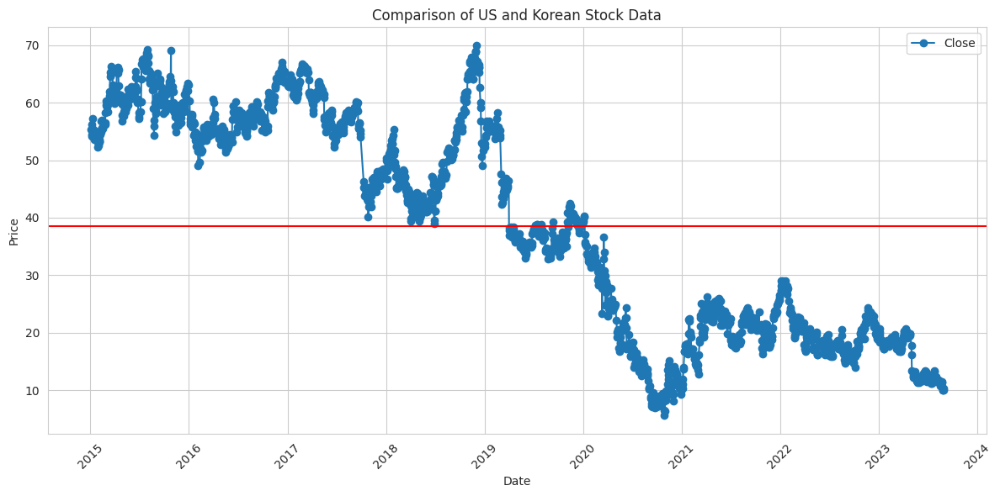

In [430]:
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Close'] - ak['kor_Close_USD'], label='Close', marker='o')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.axhline(y=(ak['Close'] - ak['kor_Close_USD']).mean(), color='red')
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

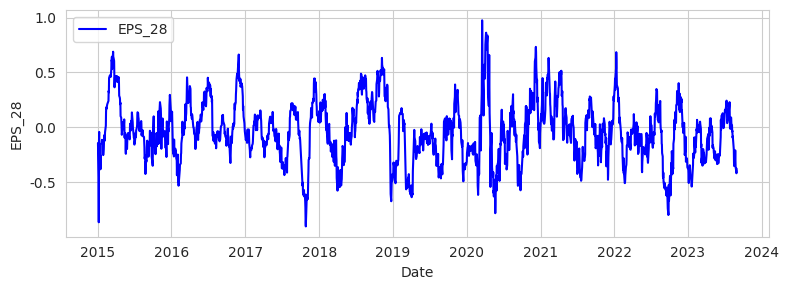

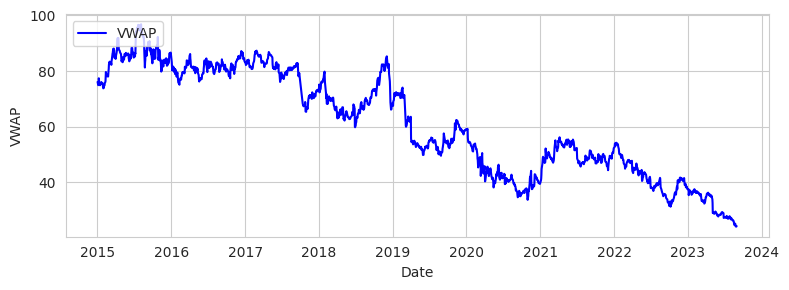

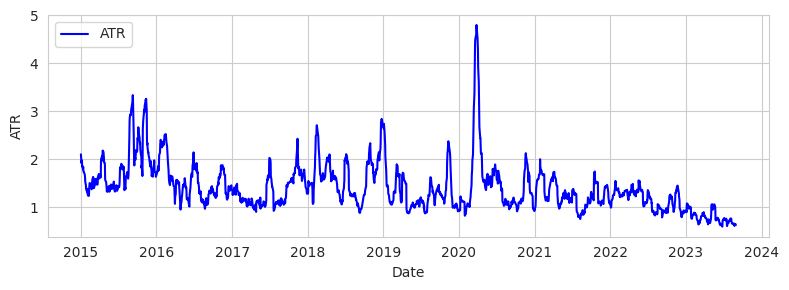

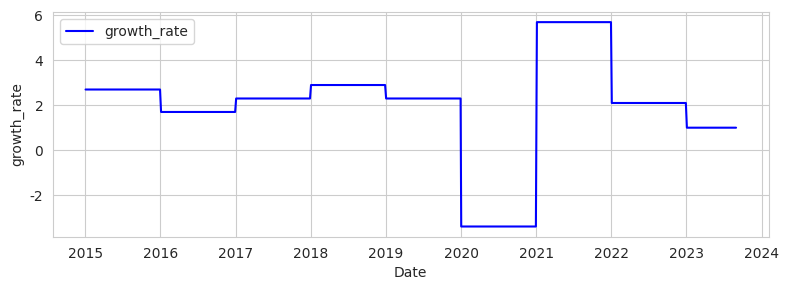

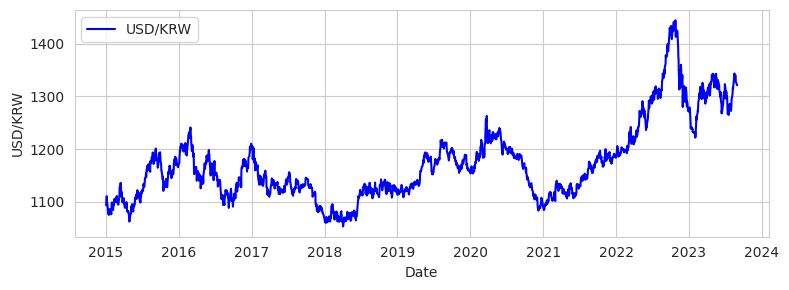

...

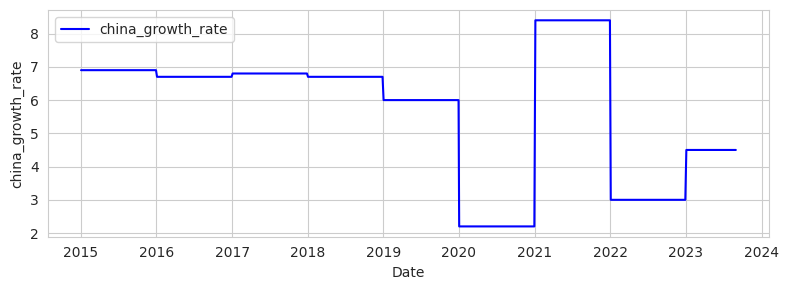

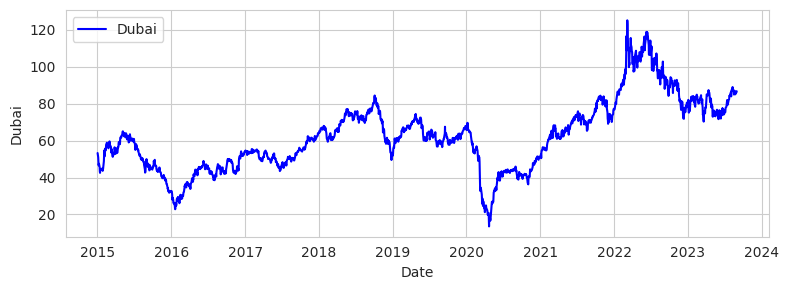

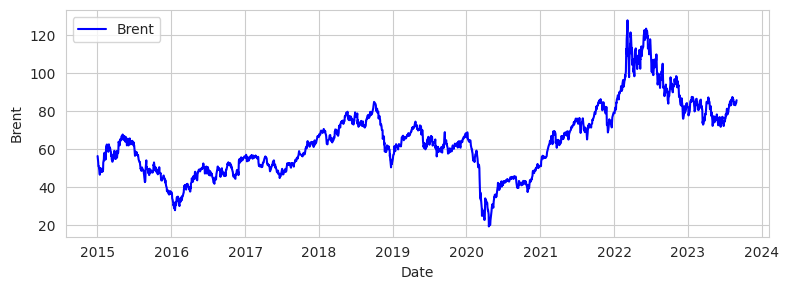

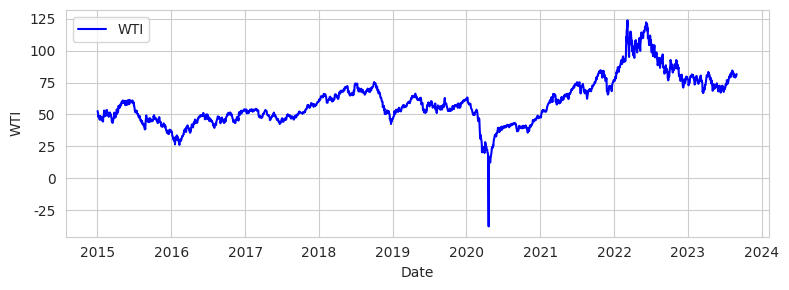

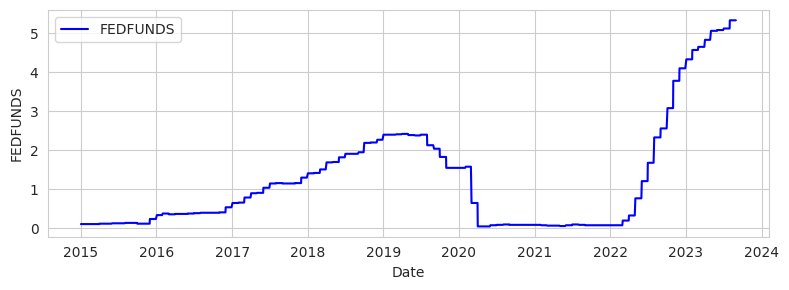

In [431]:
draw_one(ak, check_one)

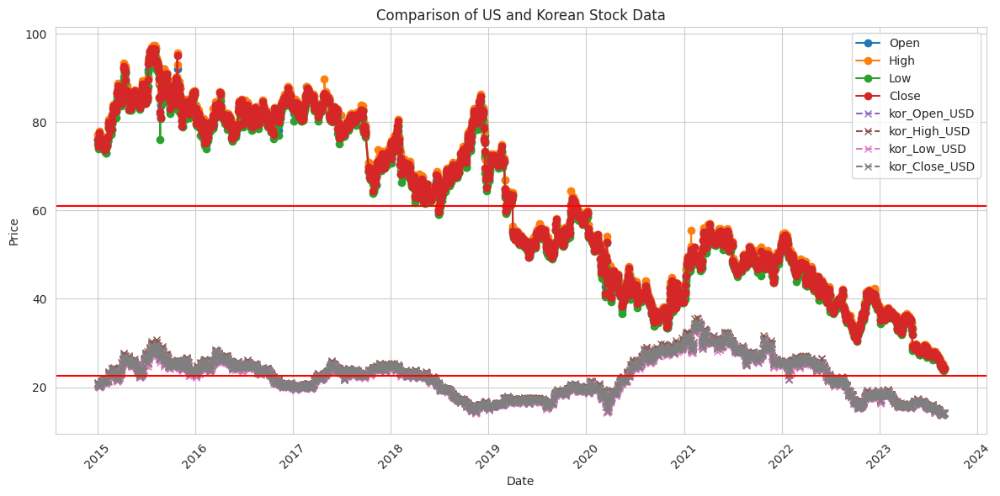

In [432]:
# 미국의 데이터를 라인 플롯으로 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Open'], label='Open', marker='o')
plt.plot(ak.index, ak['High'], label='High', marker='o')
plt.plot(ak.index, ak['Low'], label='Low', marker='o')
plt.plot(ak.index, ak['Close'], label='Close', marker='o')

# 한국의 데이터를 라인 플롯으로 그리기
plt.plot(ak.index, ak['kor_Open_USD'], label='kor_Open_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_High_USD'], label='kor_High_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Low_USD'], label='kor_Low_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Close_USD'], label='kor_Close_USD', linestyle='--', marker='x')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.axhline(y=((ak['Open']+ak['High']+ak['Low']+ak['Close'])/4).mean(), color='red')
plt.axhline(y=((ak['kor_Open_USD']+ak['kor_High_USD']+ak['kor_Low_USD']+ak['kor_Close_USD'])/4).mean(), color='red')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

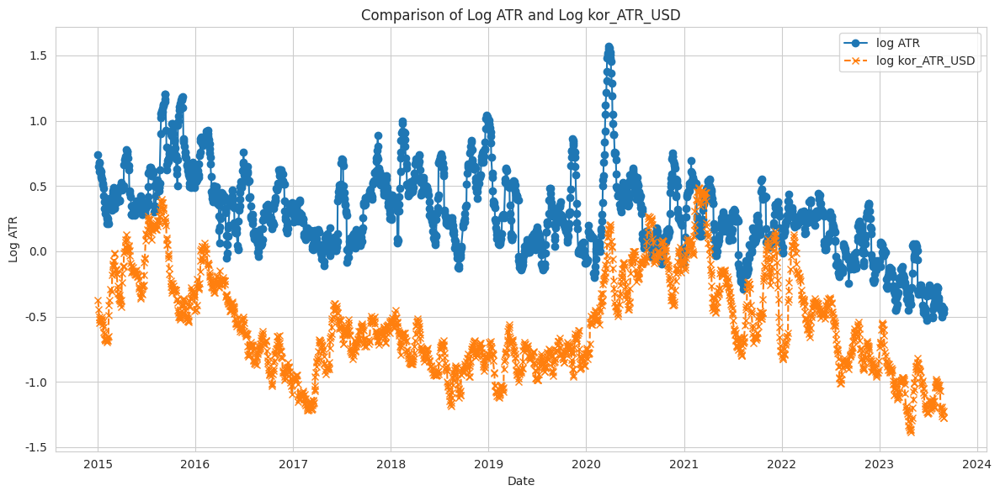

In [433]:
import matplotlib.pyplot as plt
import numpy as np

# 미국의 ATR 데이터
us_atr = ak['ATR']

# 한국의 kor_ATR_USD 데이터
kor_atr_usd = ak['kor_ATR_USD']

# 로그 스케일 적용
log_us_atr = np.log(us_atr)
log_kor_atr_usd = np.log(kor_atr_usd)

# 그래프 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, log_us_atr, label='log ATR', marker='o')
plt.plot(ak.index, log_kor_atr_usd, label='log kor_ATR_USD', linestyle='--', marker='x')

plt.title('Comparison of Log ATR and Log kor_ATR_USD')
plt.xlabel('Date')
plt.ylabel('Log ATR')
plt.legend()
plt.tight_layout()
plt.show()

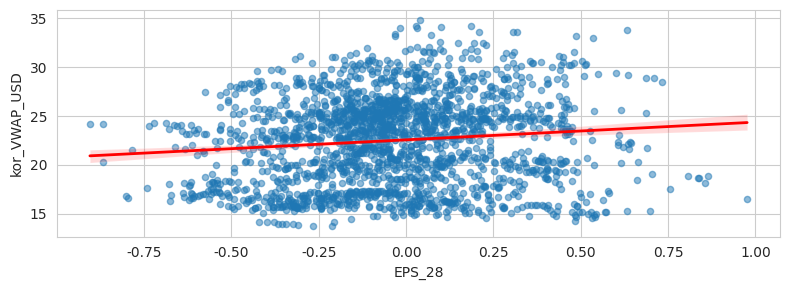

EPS_28와 kor_VWAP_USD 사이의 상관계수 : 0.11
p-value: 4.93572325190346e-07



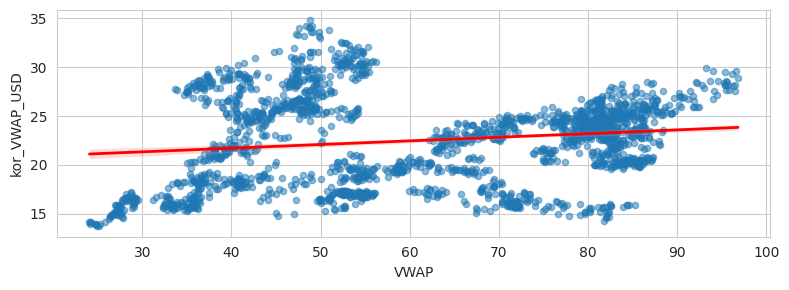

VWAP와 kor_VWAP_USD 사이의 상관계수 : 0.16
p-value: 3.725641293743864e-13



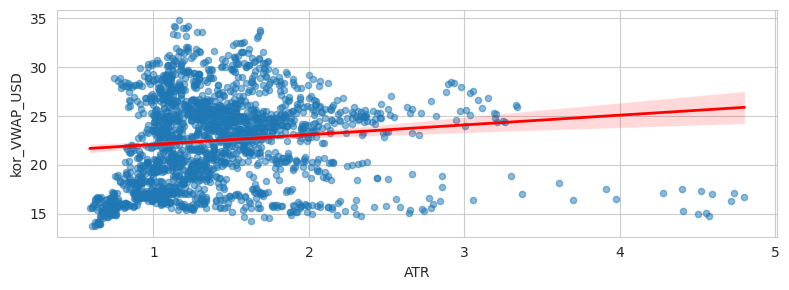

ATR와 kor_VWAP_USD 사이의 상관계수 : 0.12
p-value: 8.882808628867771e-08



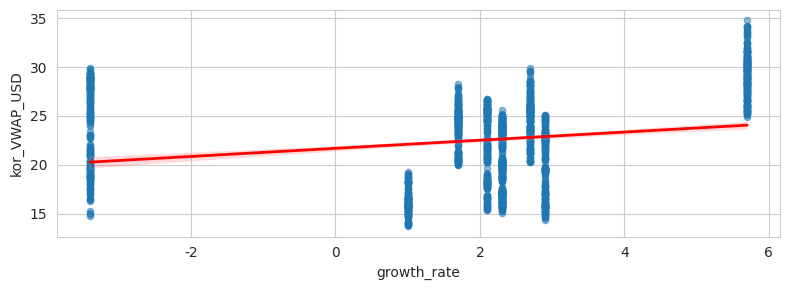

growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.21
p-value: 1.4931313946661803e-22



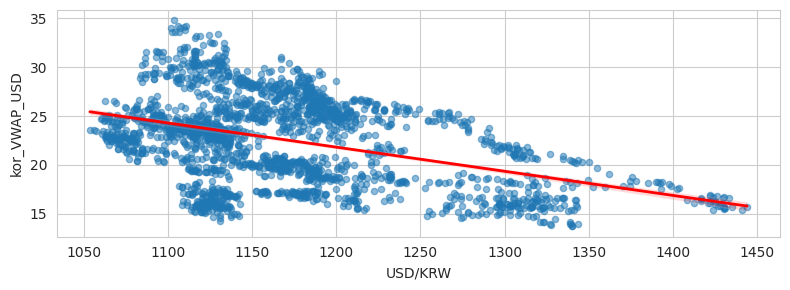

USD/KRW와 kor_VWAP_USD 사이의 상관계수 : -0.41
p-value: 2.4888272759661785e-85



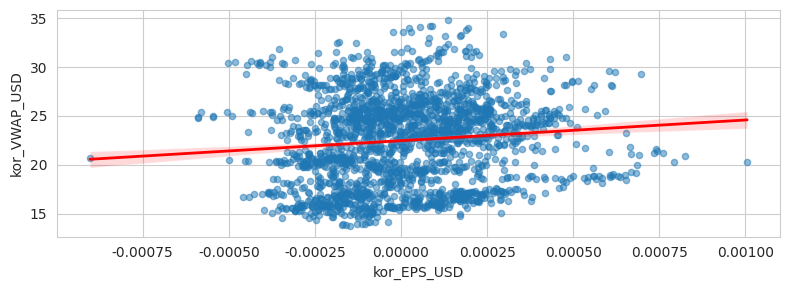

kor_EPS_USD와 kor_VWAP_USD 사이의 상관계수 : 0.11
p-value: 5.08265987147126e-07



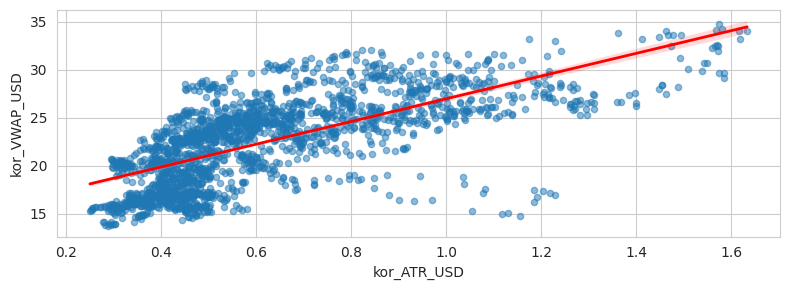

kor_ATR_USD와 kor_VWAP_USD 사이의 상관계수 : 0.68
p-value: 3.6620546546584855e-286



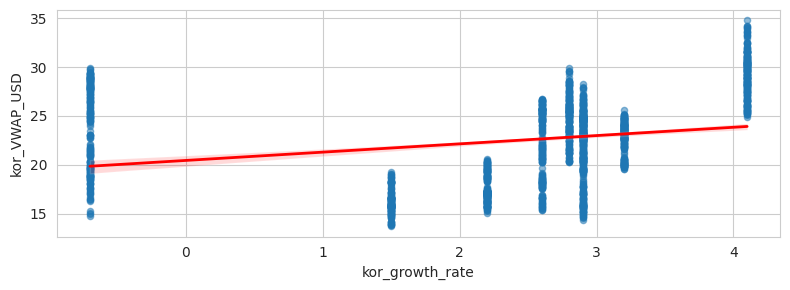

kor_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.25
p-value: 9.133027995211174e-30



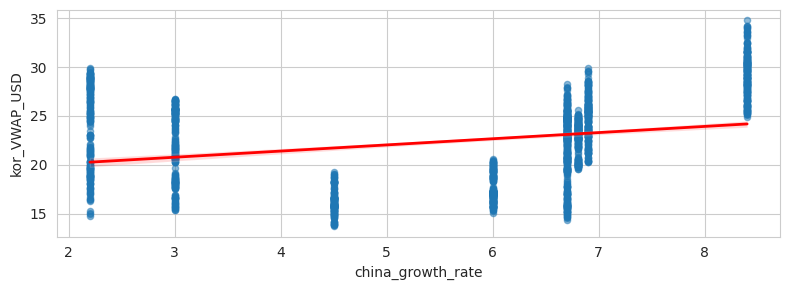

china_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.27
p-value: 6.135523974323594e-37



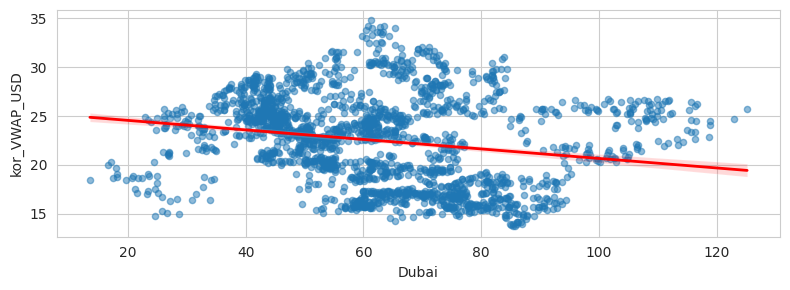

Dubai와 kor_VWAP_USD 사이의 상관계수 : -0.21
p-value: 2.6870285546616234e-21



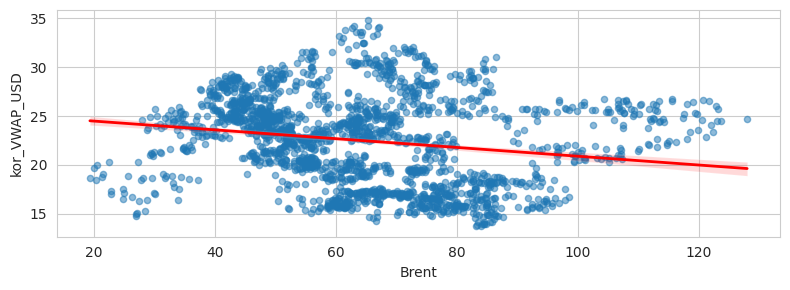

Brent와 kor_VWAP_USD 사이의 상관계수 : -0.19
p-value: 5.345395814443338e-18



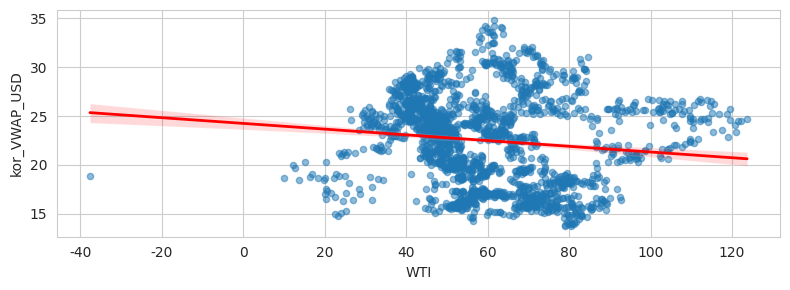

WTI와 kor_VWAP_USD 사이의 상관계수 : -0.12
p-value: 4.0541083140308925e-08



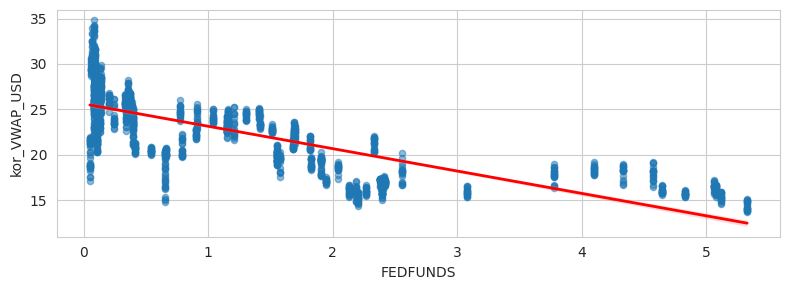

FEDFUNDS와 kor_VWAP_USD 사이의 상관계수 : -0.77
p-value: 0.0



In [434]:
draw_two(ak, check_two)

In [435]:
# Pearson 상관계수 계산
correlation_matrix = ak[check_one].corr()

correlation_matrix

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
EPS_28,1.000000,0.216173,0.166414,0.067786,-0.197326,-0.127590,0.110723,0.090381,0.091447,0.128256,-0.104801,-0.094647,-0.104778,-0.165116
VWAP,0.216173,1.000000,0.371235,0.268217,-0.631626,0.039418,0.157690,0.034424,0.433559,0.593292,-0.492504,-0.467145,-0.472029,-0.444044
ATR,0.166414,0.371235,1.000000,-0.068157,-0.281852,0.199319,0.115642,0.357130,-0.031455,0.107299,-0.436273,-0.416168,-0.423740,-0.376067
growth_rate,0.067786,0.268217,-0.068157,1.000000,-0.215490,-0.162171,0.213201,-0.062121,0.958356,0.819112,0.346904,0.362968,0.367736,-0.062343
USD/KRW,-0.197326,-0.631626,-0.281852,-0.215490,1.000000,-0.070618,-0.411359,-0.172614,-0.254964,-0.566648,0.435203,0.429088,0.437618,0.545560
kor_EPS_USD,-0.127590,0.039418,0.199319,-0.162171,-0.070618,1.000000,0.103483,0.258028,-0.163242,-0.093956,-0.166937,-0.164522,-0.186627,-0.161643
kor_VWAP_USD,0.110723,0.157690,0.115642,0.213201,-0.411359,0.103483,1.000000,0.684709,0.245879,0.274104,-0.204759,-0.187145,-0.118867,-0.770348
kor_ATR_USD,0.090381,0.034424,0.357130,-0.062121,-0.172614,0.258028,0.684709,1.000000,-0.091823,0.007669,-0.288492,-0.286165,-0.257940,-0.590693
kor_growth_rate,0.091447,0.433559,-0.031455,0.958356,-0.254964,-0.163242,0.245879,-0.091823,1.000000,0.828889,0.246692,0.272245,0.287573,-0.146148
china_growth_rate,0.128256,0.593292,0.107299,0.819112,-0.566648,-0.093956,0.274104,0.007669,0.828889,1.000000,-0.166836,-0.155473,-0.150392,-0.248039


In [436]:
correlation_matrix[['kor_VWAP_USD']].T

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
kor_VWAP_USD,0.110723,0.15769,0.115642,0.213201,-0.411359,0.103483,1.0,0.684709,0.245879,0.274104,-0.204759,-0.187145,-0.118867,-0.770348


## XLE %
  + XLE : Energy
    + 에너지 관련 회사들이 속해 있는 섹터

### NH에서 준 정보를 활용한 상관관계 분석


In [437]:
#XLE
stock_name= ['한화솔루션','HD현대에너지솔루션','GS','oil','한국쉘석유','SK이노베이션']
stock_code = ['009830','322000','078930','010950','002960','096770']

etf = ['XLE']
#
year = '2023'
date = '0101'

find_best_R(etf, stock_name, stock_code, year, date, 0)

['거래일자', '시가', '고가', '저가', '종가', '거래량']
주식 받아오기 끝
가능한 조합: 63
상관계수 : 0.02801145768666513, p-value : 0.541667003305152 ['GS']
상관계수 : 0.03783980628222877, p-value : 0.4096209515383271 ['oil']
end


In [438]:
nasdaq_data.loc[nasdaq_data['sector_name'] == 'XLE', 'fc_sec_krl_nm'].unique()

array(['Baker Hughes                                                ',
       '다이아몬드백 에너지                                                  ',
       'APA US                                                      '],
      dtype=object)

### 주식 중 XLE에 해당하는 주식 찾기

In [452]:
list(sector_info.loc[sector_info['sector_name']=='XLE', 'comanpy_name'].unique())

['EOG Resources',
 'Coterra Energy Inc',
 'APA Corporation',
 'Devon Energy Corp',
 'Marathon Oil Corp',
 'ConocoPhillips',
 'Chevron Corp',
 'Phillips 66',
 'Baker Hughes Company',
 'Diamondback Energy Inc',
 'Schlumberger Ltd',
 'EQT Corporation',
 'Hess Corp',
 'Exxon Mobil Corp',
 'Pioneer Natural Resources',
 'Targa Resources Corp',
 'The Williams Companies Inc',
 'Kinder Morgan Inc',
 'Valero Energy Corp',
 'Halliburton Co',
 'ONEOK Inc',
 'Marathon Petroleum Corp.',
 'Occidental Petroleum']

In [439]:
#조사할 데이터
america_list = list(sector_info.loc[sector_info['sector_name']=='XLE', 'tck_iem_cd'].unique())
korea_list = ['009830','322000','078930','010950','002960','096770']

In [440]:
ak = return_ak(america_list, korea_list)

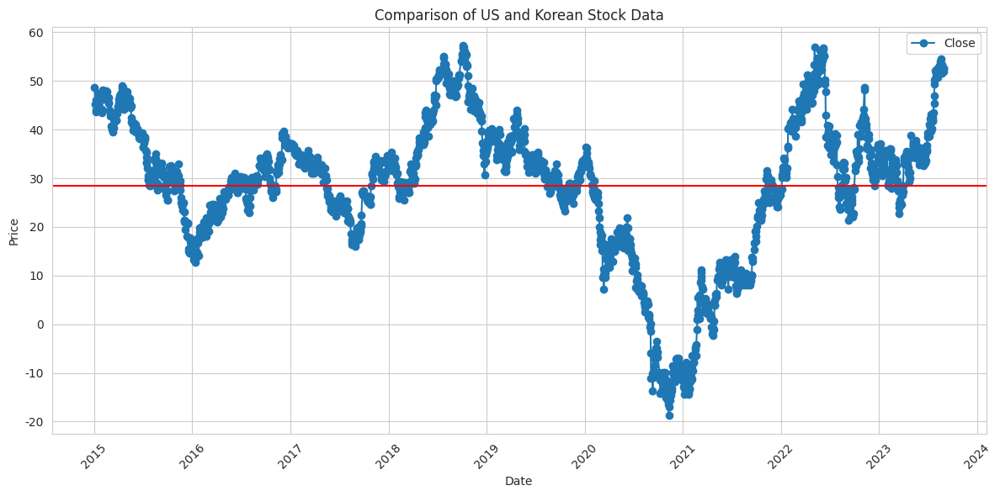

In [441]:
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Close'] - ak['kor_Close_USD'], label='Close', marker='o')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.axhline(y=(ak['Close'] - ak['kor_Close_USD']).mean(), color='red')
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

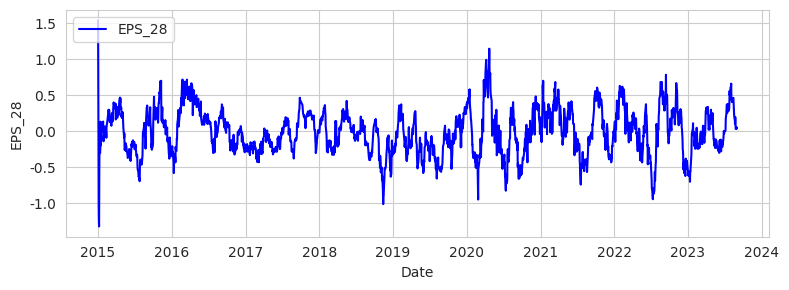

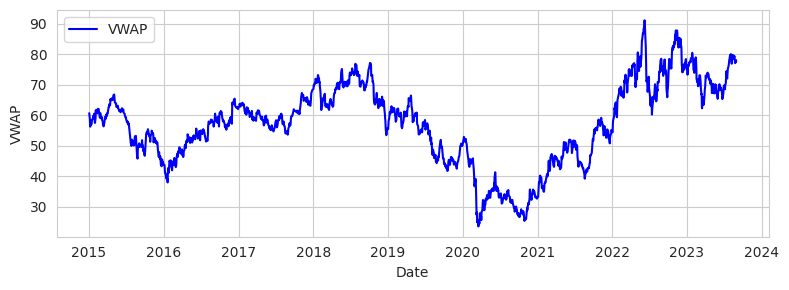

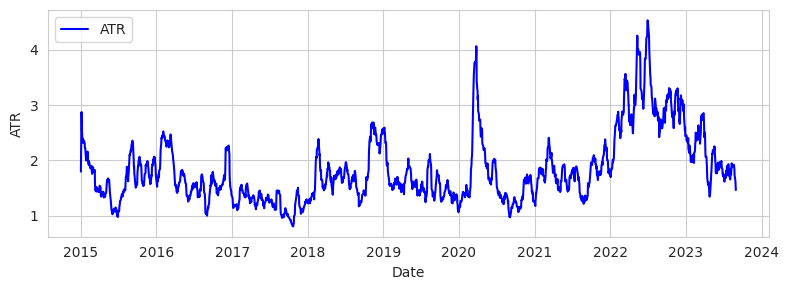

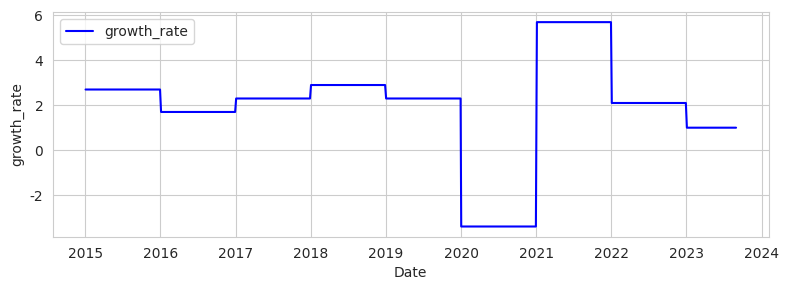

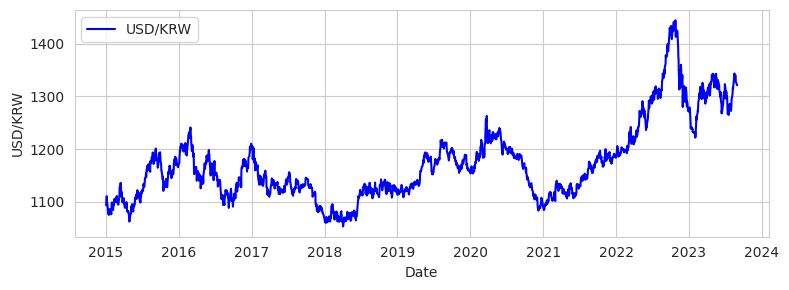

...

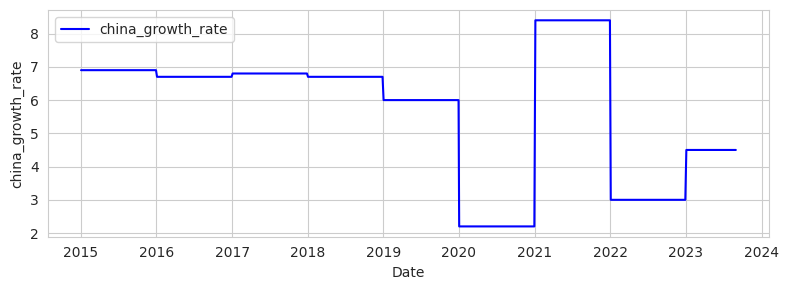

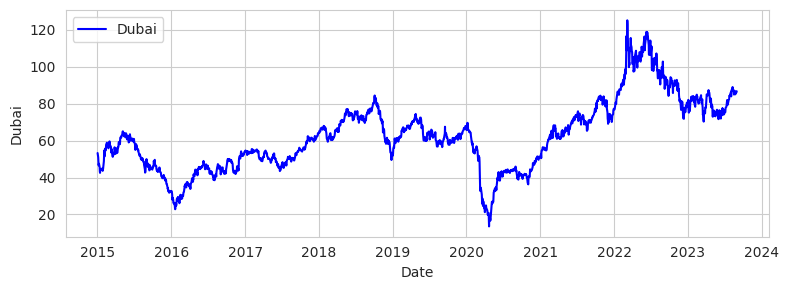

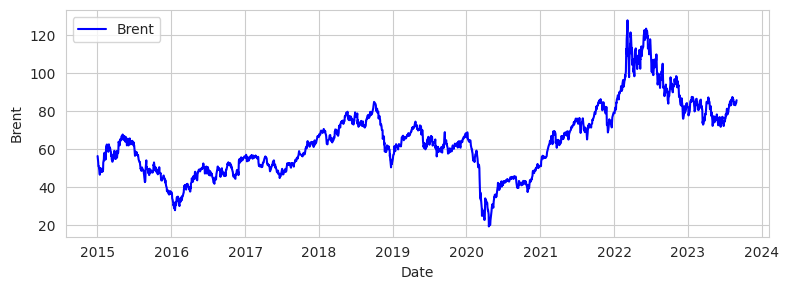

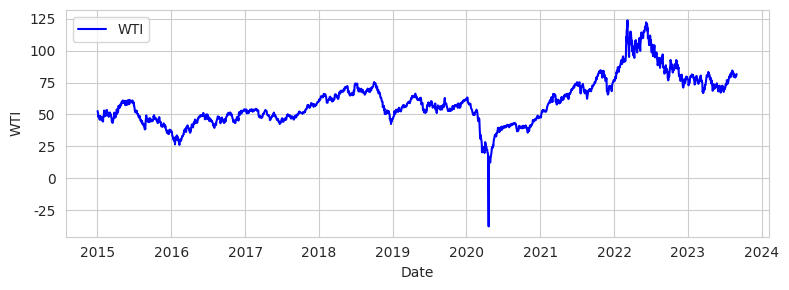

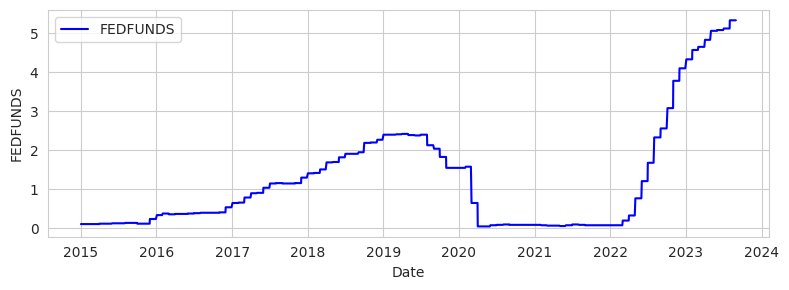

In [442]:
draw_one(ak, check_one)

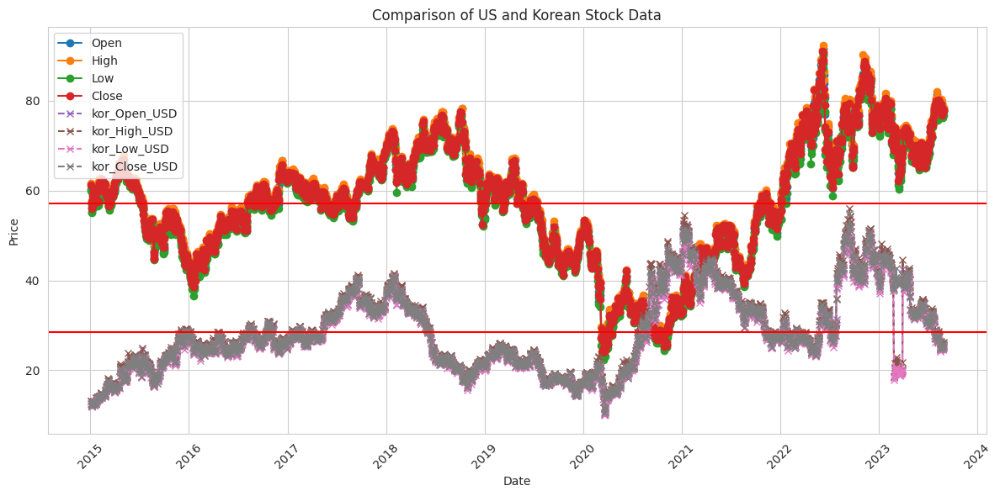

In [443]:
# 미국의 데이터를 라인 플롯으로 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Open'], label='Open', marker='o')
plt.plot(ak.index, ak['High'], label='High', marker='o')
plt.plot(ak.index, ak['Low'], label='Low', marker='o')
plt.plot(ak.index, ak['Close'], label='Close', marker='o')

# 한국의 데이터를 라인 플롯으로 그리기
plt.plot(ak.index, ak['kor_Open_USD'], label='kor_Open_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_High_USD'], label='kor_High_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Low_USD'], label='kor_Low_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Close_USD'], label='kor_Close_USD', linestyle='--', marker='x')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.axhline(y=((ak['Open']+ak['High']+ak['Low']+ak['Close'])/4).mean(), color='red')
plt.axhline(y=((ak['kor_Open_USD']+ak['kor_High_USD']+ak['kor_Low_USD']+ak['kor_Close_USD'])/4).mean(), color='red')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

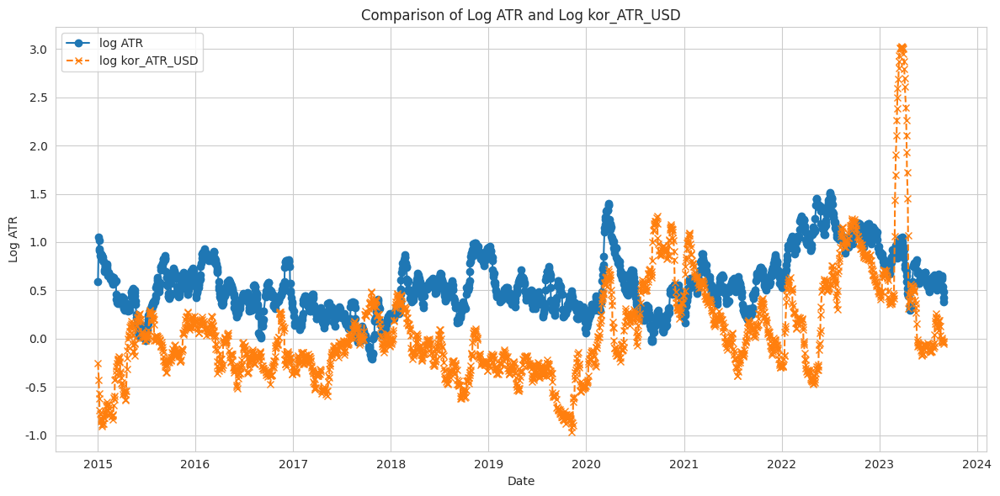

In [444]:
import matplotlib.pyplot as plt
import numpy as np

# 미국의 ATR 데이터
us_atr = ak['ATR']

# 한국의 kor_ATR_USD 데이터
kor_atr_usd = ak['kor_ATR_USD']

# 로그 스케일 적용
log_us_atr = np.log(us_atr)
log_kor_atr_usd = np.log(kor_atr_usd)

# 그래프 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, log_us_atr, label='log ATR', marker='o')
plt.plot(ak.index, log_kor_atr_usd, label='log kor_ATR_USD', linestyle='--', marker='x')

plt.title('Comparison of Log ATR and Log kor_ATR_USD')
plt.xlabel('Date')
plt.ylabel('Log ATR')
plt.legend()
plt.tight_layout()
plt.show()

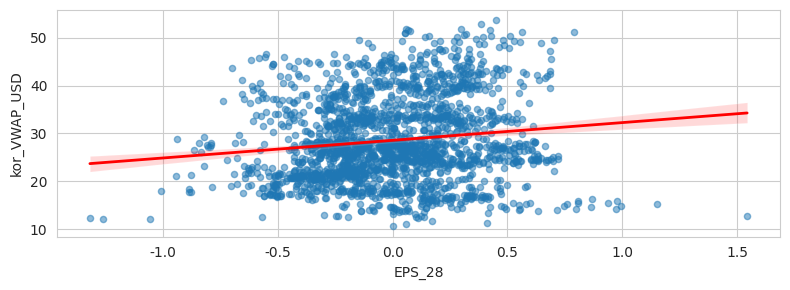

EPS_28와 kor_VWAP_USD 사이의 상관계수 : 0.13
p-value: 3.737902519176952e-09



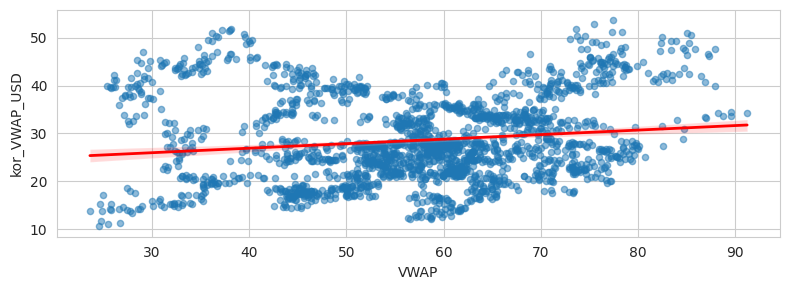

VWAP와 kor_VWAP_USD 사이의 상관계수 : 0.16
p-value: 5.187382168182209e-13



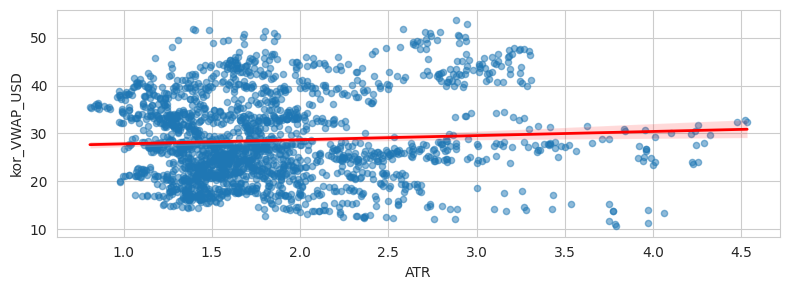

ATR와 kor_VWAP_USD 사이의 상관계수 : 0.09
p-value: 0.0001038957178681533



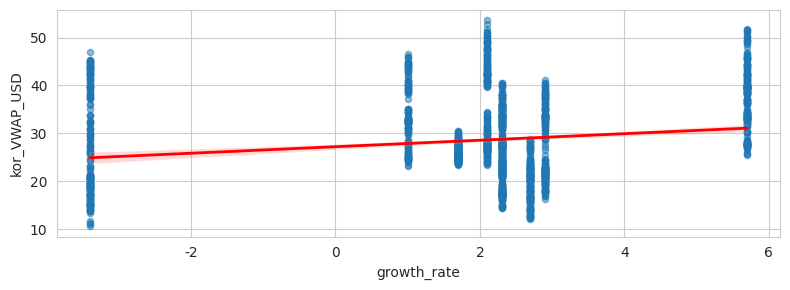

growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.17
p-value: 1.4104430576069845e-14



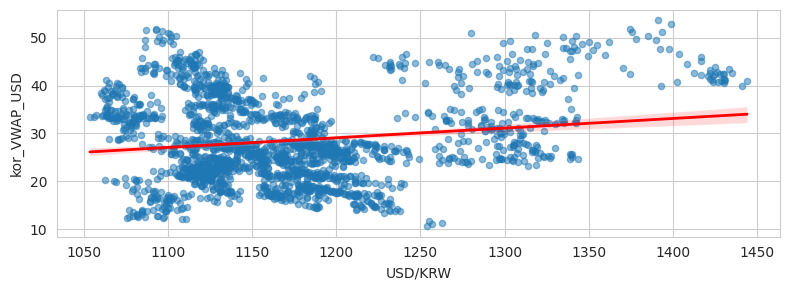

USD/KRW와 kor_VWAP_USD 사이의 상관계수 : 0.20
p-value: 7.568777648915994e-21



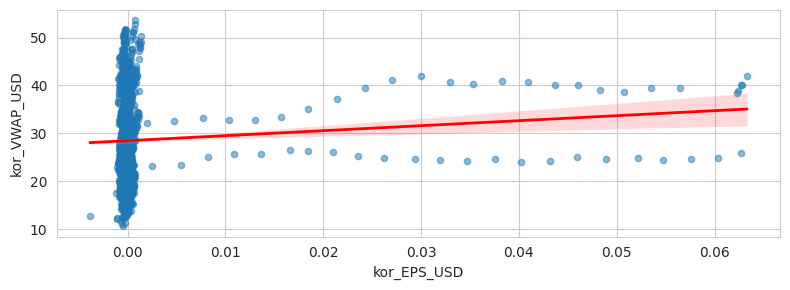

kor_EPS_USD와 kor_VWAP_USD 사이의 상관계수 : 0.17
p-value: 6.6724711158940704e-15



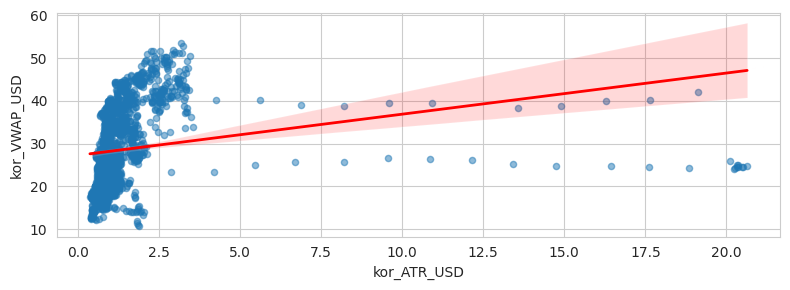

kor_ATR_USD와 kor_VWAP_USD 사이의 상관계수 : 0.34
p-value: 1.6366440626275877e-57



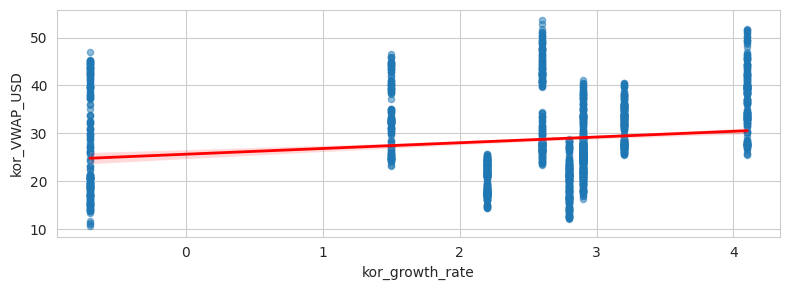

kor_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.16
p-value: 1.204005767822378e-13



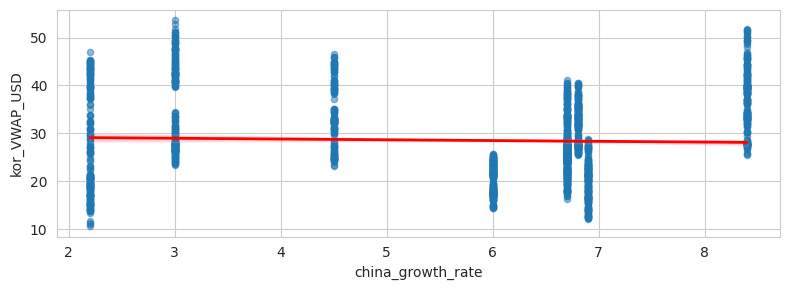

china_growth_rate와 kor_VWAP_USD 사이의 상관계수 : -0.05
p-value: 0.02801715395348136



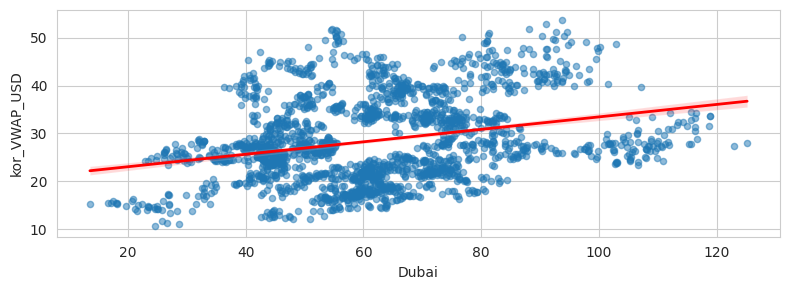

Dubai와 kor_VWAP_USD 사이의 상관계수 : 0.29
p-value: 1.1288775062599762e-42



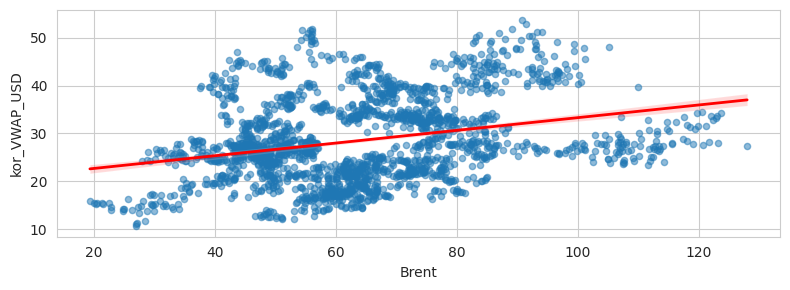

Brent와 kor_VWAP_USD 사이의 상관계수 : 0.30
p-value: 4.8676238018655784e-43



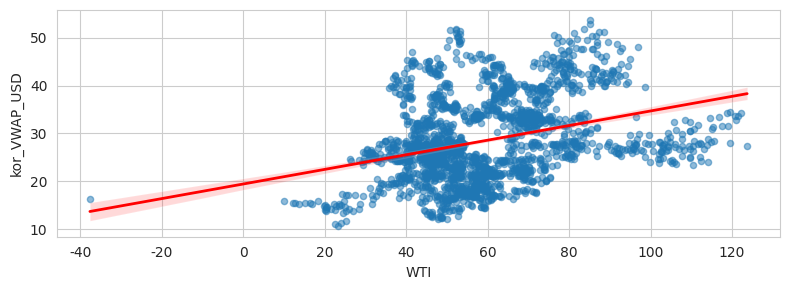

WTI와 kor_VWAP_USD 사이의 상관계수 : 0.33
p-value: 2.2163520945463993e-53



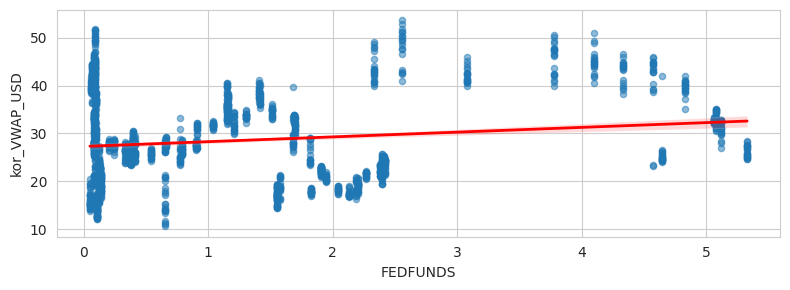

FEDFUNDS와 kor_VWAP_USD 사이의 상관계수 : 0.20
p-value: 1.7924856891869482e-20



In [445]:
draw_two(ak, check_two)

In [446]:
# Pearson 상관계수 계산
correlation_matrix = ak[check_one].corr()

correlation_matrix

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
EPS_28,1.000000,0.051141,0.025507,0.020880,0.022337,0.047912,0.133114,0.056298,0.044786,0.002482,-0.033926,-0.012202,-0.009867,-0.090094
VWAP,0.051141,1.000000,0.312632,0.345779,0.280902,0.125442,0.143647,0.068184,0.375623,0.029864,0.707457,0.726897,0.700317,0.580692
ATR,0.025507,0.312632,1.000000,-0.000284,0.586876,0.097719,0.061226,0.225219,-0.029795,-0.407956,0.480048,0.500804,0.501427,0.199019
growth_rate,0.020880,0.345779,-0.000284,1.000000,-0.215490,-0.070107,0.178115,-0.119505,0.958356,0.819112,0.346904,0.362968,0.367736,-0.062343
USD/KRW,0.022337,0.280902,0.586876,-0.215490,1.000000,0.257462,0.171518,0.328420,-0.254964,-0.566648,0.435203,0.429088,0.437618,0.545560
kor_EPS_USD,0.047912,0.125442,0.097719,-0.070107,0.257462,1.000000,0.071947,0.829654,-0.108732,-0.104378,0.134220,0.124006,0.124154,0.333467
kor_VWAP_USD,0.133114,0.143647,0.061226,0.178115,0.171518,0.071947,1.000000,0.207192,0.177324,-0.035584,0.279707,0.281972,0.316588,0.158799
kor_ATR_USD,0.056298,0.068184,0.225219,-0.119505,0.328420,0.829654,0.207192,1.000000,-0.158483,-0.210712,0.148517,0.139684,0.141590,0.296526
kor_growth_rate,0.044786,0.375623,-0.029795,0.958356,-0.254964,-0.108732,0.177324,-0.158483,1.000000,0.828889,0.246692,0.272245,0.287573,-0.146148
china_growth_rate,0.002482,0.029864,-0.407956,0.819112,-0.566648,-0.104378,-0.035584,-0.210712,0.828889,1.000000,-0.166836,-0.155473,-0.150392,-0.248039


In [447]:
correlation_matrix[['kor_VWAP_USD']].T

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
kor_VWAP_USD,0.133114,0.143647,0.061226,0.178115,0.171518,0.071947,1.0,0.207192,0.177324,-0.035584,0.279707,0.281972,0.316588,0.158799


## XLF % +0.45
  + XLF : Financials
    + 금융, 금융회사들이 속해 있는 섹터

#### NH에서 준 정보를 활용한 상관관계 분석

In [451]:
list(sector_info.loc[sector_info['sector_name']=='XLF', 'comanpy_name'].unique())

['Truist Financial Corp',
 'Assurant Inc',
 'PayPal Holdings Inc.',
 'PNC Finl Services Group',
 'Zions Bancorporation N.A.',
 'Regions Financial Corp',
 'M&T Bank Corp',
 'Allstate Corp',
 'Metlife Inc',
 'Huntington Bancshares (OH)',
 'American Intl Group Inc',
 'Fifth Third Bancorp (OH)',
 'Globe Life Inc.',
 'Wells Fargo & Co',
 'MSCI Inc',
 'Prudential Financial Inc',
 'Ameriprise Financial Inc',
 'Raymond James Financial Inc',
 'US Bancorp',
 'AFLAC Inc',
 'Comerica Inc (MI)',
 'Principal Financial Group',
 'JP Morgan Chase & Co',
 'T Rowe Price Group Inc',
 'FleetCor Technologies Inc',
 'Willis Towers Watson PLC',
 'The Bank of New York Mellon Corp',
 'Discover Financial Services',
 'Berkshire Hathaway B',
 'Charles Schwab Corp',
 'Global Payments Inc',
 'Loews Corp',
 'Goldman Sachs Group Inc',
 'FactSet Research System Inc',
 'Citizens Financial Group Inc',
 'Citigroup Inc',
 'Arch Capital Group Ltd',
 'KeyCorp',
 'Synchrony Financial',
 'American Express Co',
 'Arthur J. Gall

In [361]:
#XLF
stock_name= ['국민은행', '하나은행', '신한은행', '우리은행']
stock_code = ['105560', '086790', '055550', '316140']

etf = ['XLF']
#
year = '2023'
date = '0101'

find_best_R(etf, stock_name, stock_code, year, date, 0)

['거래일자', '시가', '고가', '저가', '종가', '거래량']
주식 받아오기 끝
가능한 조합: 15
상관계수 : 0.04436611009513699, p-value : 0.036342877654175806 ['국민은행']
상관계수 : 0.06313962341552015, p-value : 0.002880039258702164 ['하나은행']
상관계수 : 0.06323610694814287, p-value : 0.002837423215538609 ['하나은행' '신한은행']
end


In [362]:
nasdaq_data.loc[nasdaq_data['sector_name'] == 'XLF', 'fc_sec_krl_nm'].unique()

array(['신시내티 파이낸셜                                                   ',
       '프린시플 파이낸셜 그룹                                                ',
       '아치 캐피털 그룹                                                   ',
       '마켓엑세스 홀딩스                                                   ',
       '나스닥                                                         ',
       'CME 그룹                                                      ',
       '피프스 서드 뱅코프                                                  ',
       '헌팅턴 뱅크셰어스                                                   ',
       '노던 트러스트                                                     ',
       '페이팔 홀딩스                                                     ',
       '자이온스 뱅코퍼레이션                                                 ',
       'T. 로우 프라이스                                                  ',
       '잭 헨리 & 어소시에이츠                                               ',
       'Willis Towers                                               '],
     

### 주식 중 XLF에 해당하는 주식 찾기

In [363]:
#조사할 데이터
america_list = list(sector_info.loc[sector_info['sector_name']=='XLF', 'tck_iem_cd'].unique())
korea_list = ['105560', '086790', '055550', '316140']

In [364]:
ak = return_ak(america_list, korea_list)

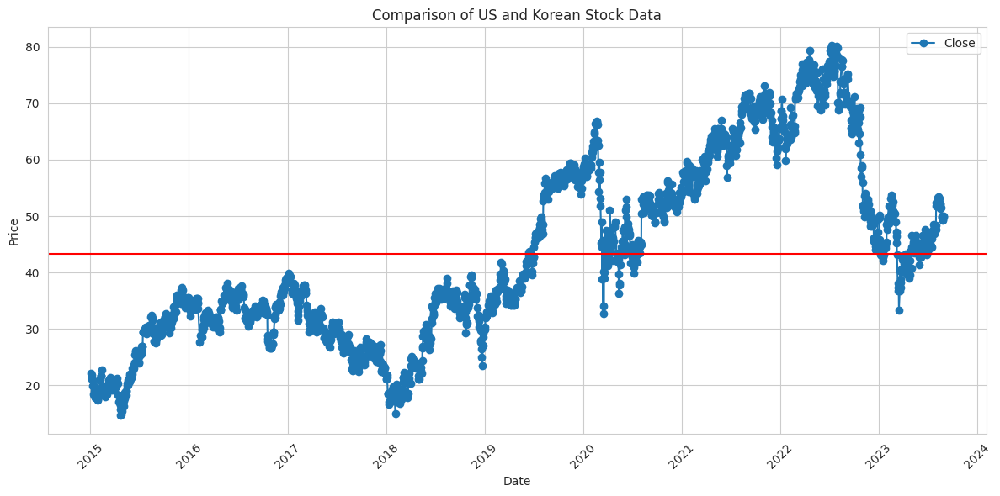

In [365]:
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Close'] - ak['kor_Close_USD'], label='Close', marker='o')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.axhline(y=(ak['Close'] - ak['kor_Close_USD']).mean(), color='red')
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

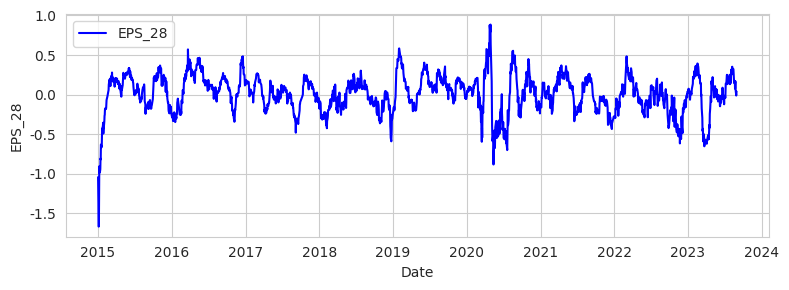

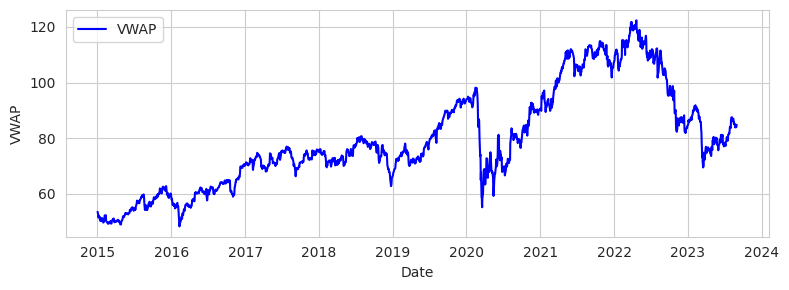

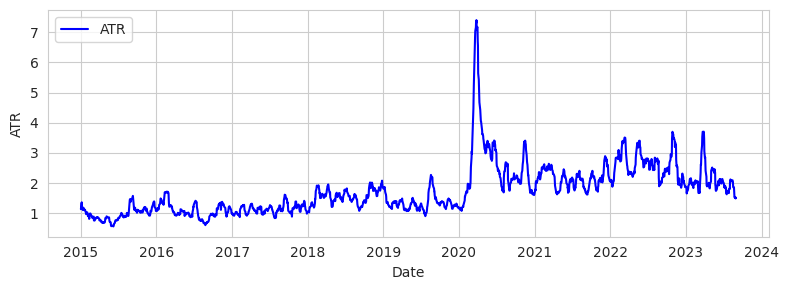

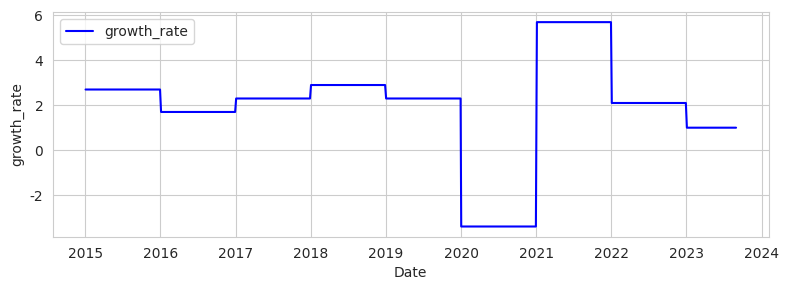

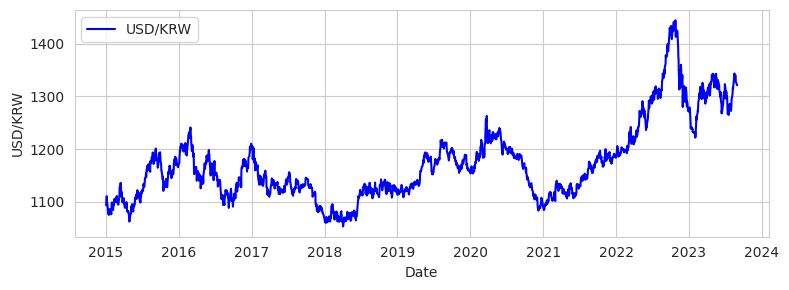

...

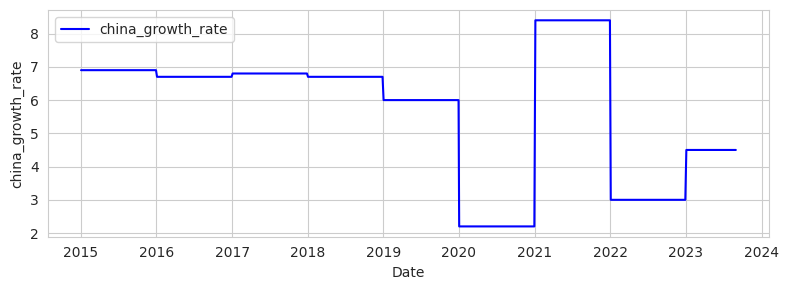

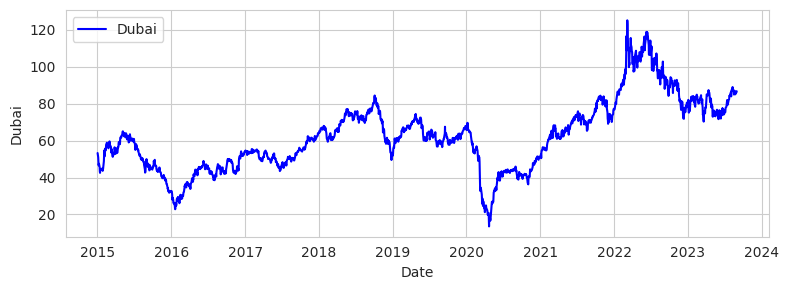

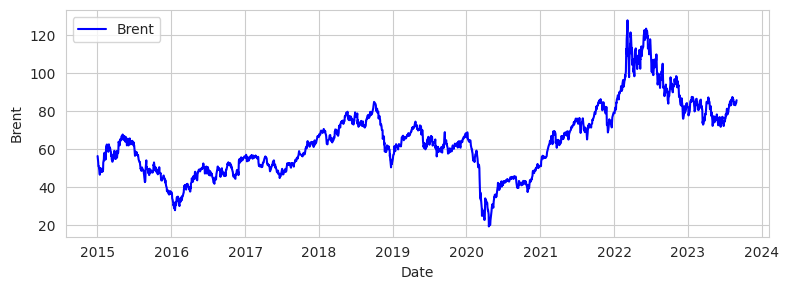

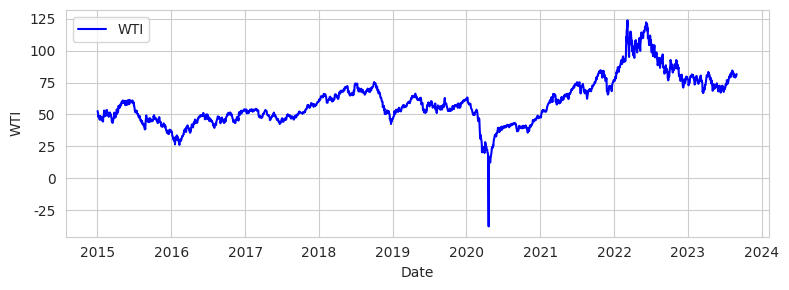

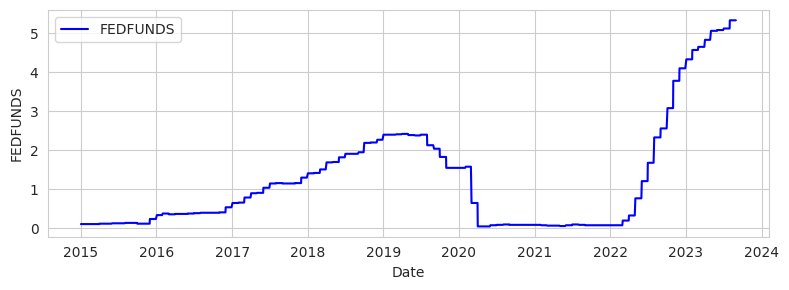

In [366]:
draw_one(ak, check_one)

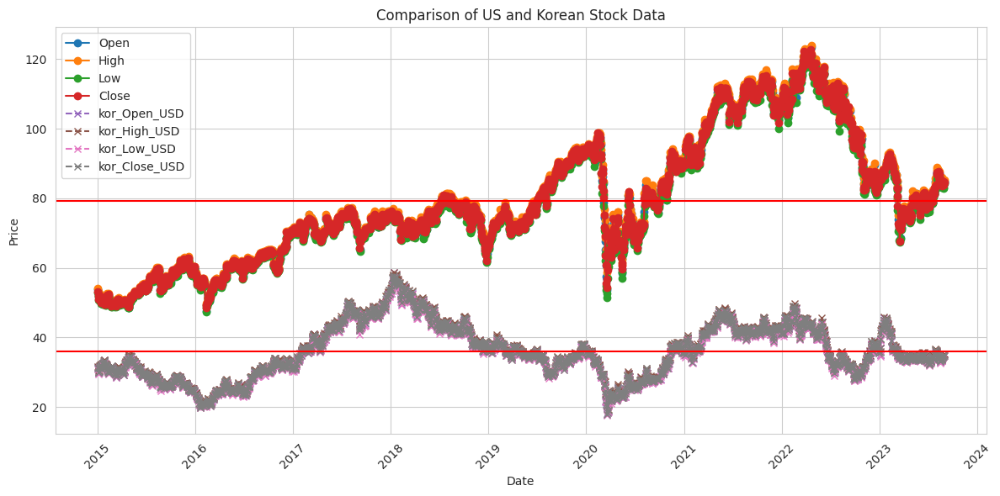

In [367]:
# 미국의 데이터를 라인 플롯으로 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Open'], label='Open', marker='o')
plt.plot(ak.index, ak['High'], label='High', marker='o')
plt.plot(ak.index, ak['Low'], label='Low', marker='o')
plt.plot(ak.index, ak['Close'], label='Close', marker='o')

# 한국의 데이터를 라인 플롯으로 그리기
plt.plot(ak.index, ak['kor_Open_USD'], label='kor_Open_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_High_USD'], label='kor_High_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Low_USD'], label='kor_Low_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Close_USD'], label='kor_Close_USD', linestyle='--', marker='x')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.axhline(y=((ak['Open']+ak['High']+ak['Low']+ak['Close'])/4).mean(), color='red')
plt.axhline(y=((ak['kor_Open_USD']+ak['kor_High_USD']+ak['kor_Low_USD']+ak['kor_Close_USD'])/4).mean(), color='red')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

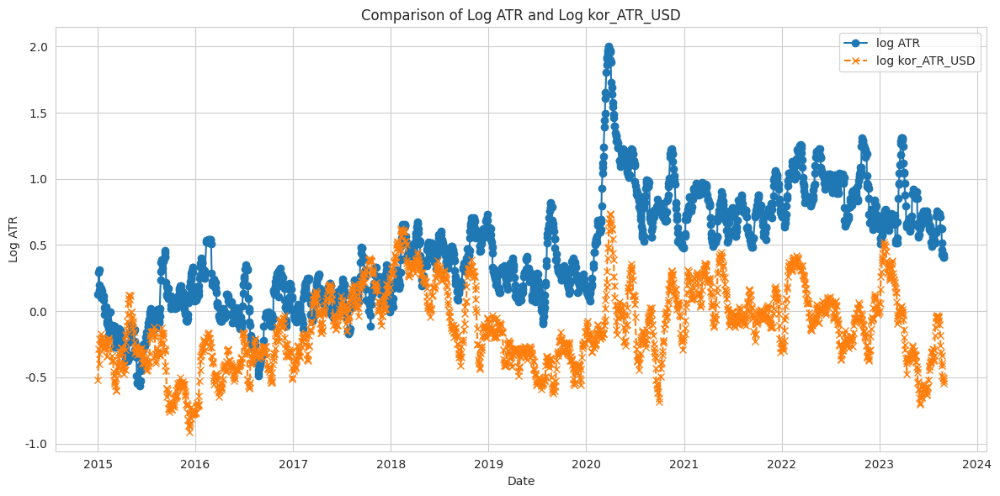

In [368]:
import matplotlib.pyplot as plt
import numpy as np

# 미국의 ATR 데이터
us_atr = ak['ATR']

# 한국의 kor_ATR_USD 데이터
kor_atr_usd = ak['kor_ATR_USD']

# 로그 스케일 적용
log_us_atr = np.log(us_atr)
log_kor_atr_usd = np.log(kor_atr_usd)

# 그래프 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, log_us_atr, label='log ATR', marker='o')
plt.plot(ak.index, log_kor_atr_usd, label='log kor_ATR_USD', linestyle='--', marker='x')

plt.title('Comparison of Log ATR and Log kor_ATR_USD')
plt.xlabel('Date')
plt.ylabel('Log ATR')
plt.legend()
plt.tight_layout()
plt.show()

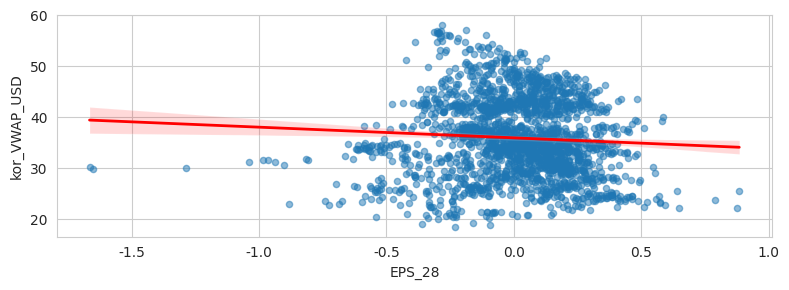

EPS_28와 kor_VWAP_USD 사이의 상관계수 : -0.06
p-value: 0.003490554817956298



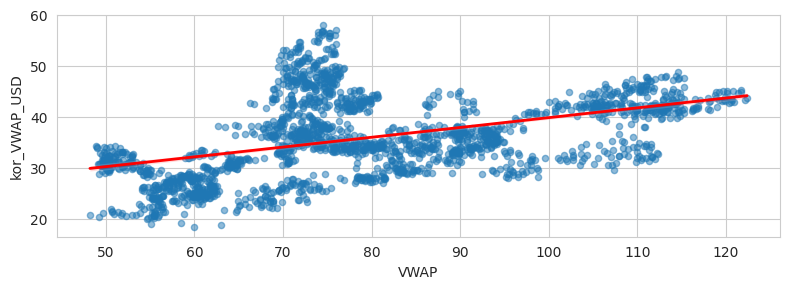

VWAP와 kor_VWAP_USD 사이의 상관계수 : 0.45
p-value: 2.086368399271852e-105



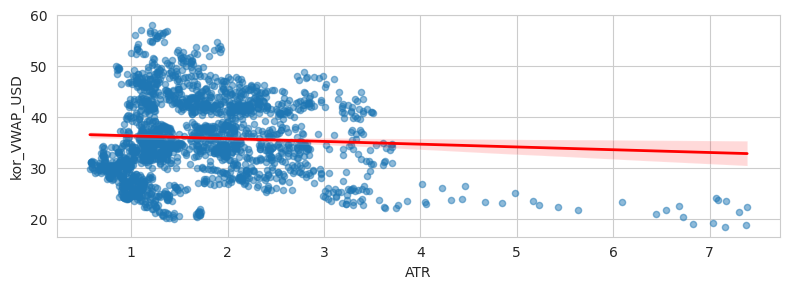

ATR와 kor_VWAP_USD 사이의 상관계수 : -0.06
p-value: 0.0066429380229588615



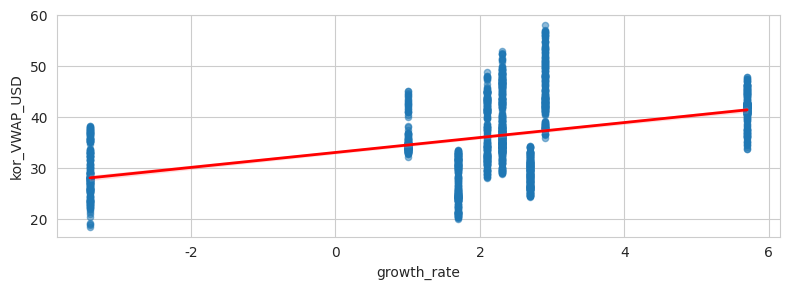

growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.44
p-value: 1.2356858741132955e-97



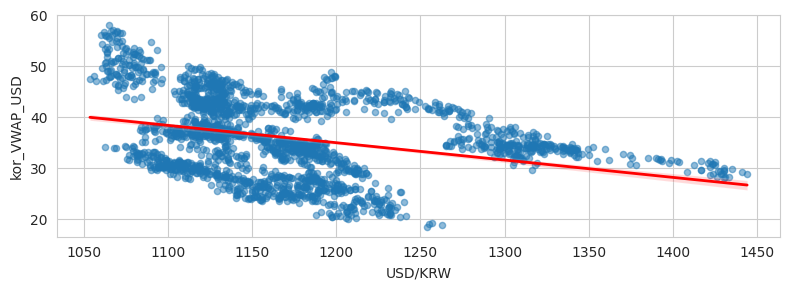

USD/KRW와 kor_VWAP_USD 사이의 상관계수 : -0.33
p-value: 2.5332658672696166e-53



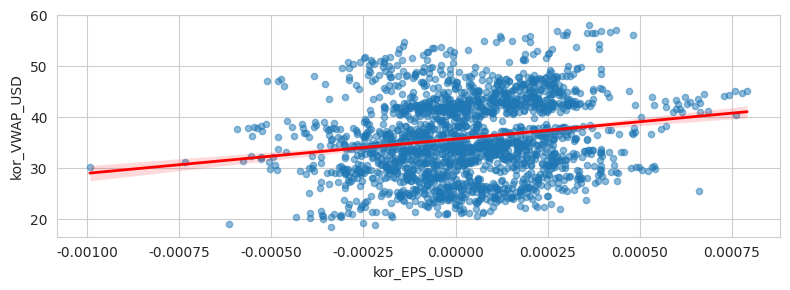

kor_EPS_USD와 kor_VWAP_USD 사이의 상관계수 : 0.19
p-value: 1.2094023416013706e-18



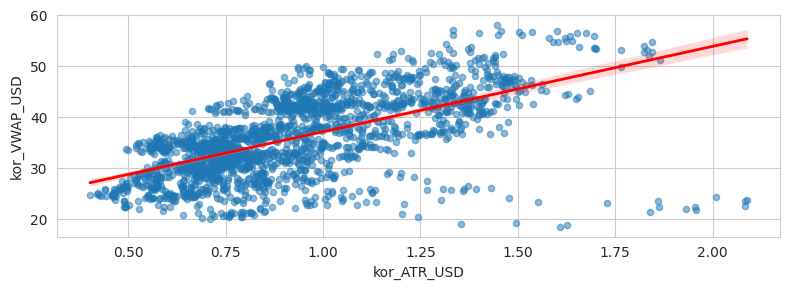

kor_ATR_USD와 kor_VWAP_USD 사이의 상관계수 : 0.61
p-value: 1.8553915948535137e-209



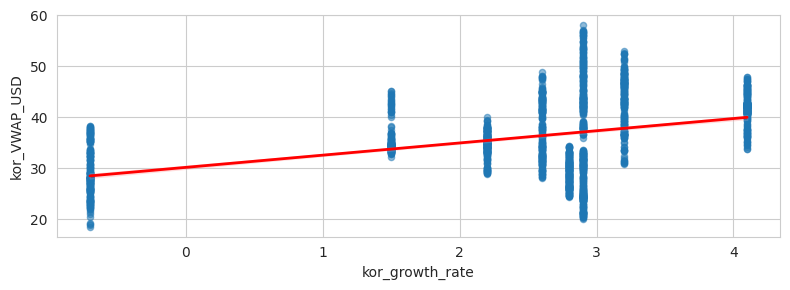

kor_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.40
p-value: 3.3356066395790576e-82



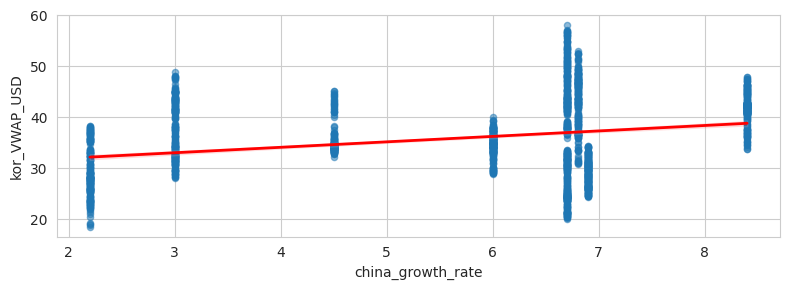

china_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.27
p-value: 5.9162566849686996e-36



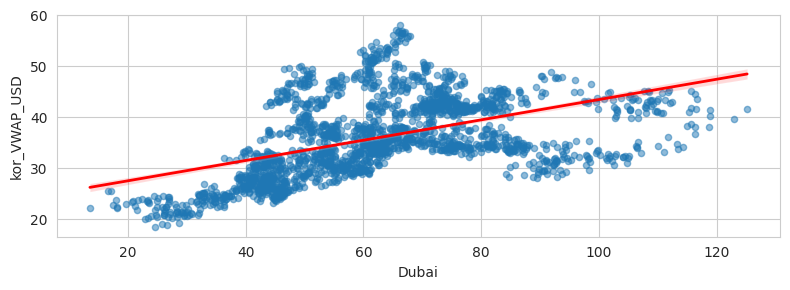

Dubai와 kor_VWAP_USD 사이의 상관계수 : 0.49
p-value: 8.539917825322946e-124



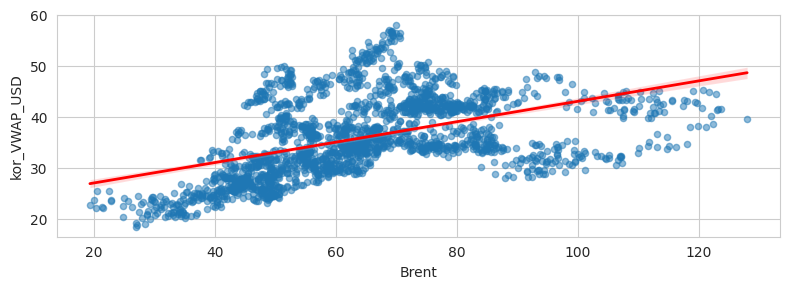

Brent와 kor_VWAP_USD 사이의 상관계수 : 0.48
p-value: 2.721060073297907e-122



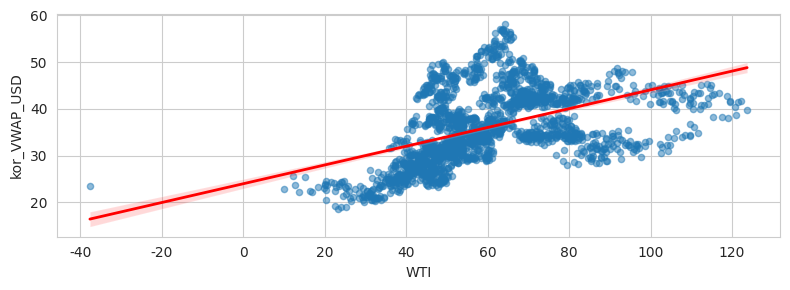

WTI와 kor_VWAP_USD 사이의 상관계수 : 0.47
p-value: 1.5063314577359785e-116



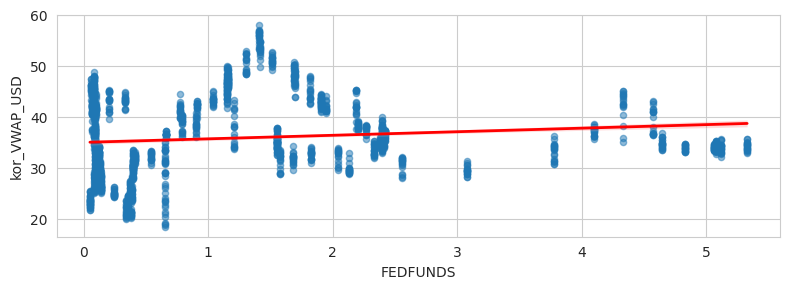

FEDFUNDS와 kor_VWAP_USD 사이의 상관계수 : 0.13
p-value: 9.208544669745544e-09



In [369]:
draw_two(ak, check_two)

In [370]:
# Pearson 상관계수 계산
correlation_matrix = ak[check_one].corr()

correlation_matrix

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
EPS_28,1.000000,0.024441,-0.193871,0.013806,-0.131073,0.114036,-0.064940,-0.067069,0.020808,0.093521,-0.069186,-0.067217,-0.079928,-0.067950
VWAP,0.024441,1.000000,0.452166,0.219190,0.337650,0.119829,0.452760,0.312613,0.098300,-0.206468,0.693850,0.679935,0.704770,0.074591
ATR,-0.193871,0.452166,1.000000,-0.299288,0.474574,-0.086427,-0.059443,0.432596,-0.387399,-0.541951,0.217814,0.211541,0.220801,0.071567
growth_rate,0.013806,0.219190,-0.299288,1.000000,-0.215490,-0.071957,0.438046,0.068776,0.958356,0.819112,0.346904,0.362968,0.367736,-0.062343
USD/KRW,-0.131073,0.337650,0.474574,-0.215490,1.000000,-0.032176,-0.329792,-0.166730,-0.254964,-0.566648,0.435203,0.429088,0.437618,0.545560
kor_EPS_USD,0.114036,0.119829,-0.086427,-0.071957,-0.032176,1.000000,0.185274,0.089382,-0.030918,-0.065753,-0.034496,-0.024371,0.001371,-0.056817
kor_VWAP_USD,-0.064940,0.452760,-0.059443,0.438046,-0.329792,0.185274,1.000000,0.609433,0.404163,0.270656,0.487945,0.485274,0.474781,0.126897
kor_ATR_USD,-0.067069,0.312613,0.432596,0.068776,-0.166730,0.089382,0.609433,1.000000,0.053012,-0.039486,0.221577,0.227586,0.223670,-0.036630
kor_growth_rate,0.020808,0.098300,-0.387399,0.958356,-0.254964,-0.030918,0.404163,0.053012,1.000000,0.828889,0.246692,0.272245,0.287573,-0.146148
china_growth_rate,0.093521,-0.206468,-0.541951,0.819112,-0.566648,-0.065753,0.270656,-0.039486,0.828889,1.000000,-0.166836,-0.155473,-0.150392,-0.248039


In [371]:
correlation_matrix[['kor_VWAP_USD']].T

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
kor_VWAP_USD,-0.06494,0.45276,-0.059443,0.438046,-0.329792,0.185274,1.0,0.609433,0.404163,0.270656,0.487945,0.485274,0.474781,0.126897


## XLV % + 0.5
  + XLV : Health Care
    + 헬스케어 관련한 회사

### NH에서 준 정보를 활용한 상관관계 분석


In [372]:
#XLI
stock_name= ['셀트리온','지씨셀','신테카바이오','루닛','뷰노']
stock_code = ['068270','144510','226330','328130','338220']

# etf = ['T', 'VZ', 'CHTR', 'CMCSA', 'TMUS']
etf = ['XLV']

year = '2023'
date = '0101'

find_best_R(etf, stock_name, stock_code, year, date, 0)

['거래일자', '시가', '고가', '저가', '종가', '거래량']
주식 받아오기 끝
가능한 조합: 31
상관계수 : 0.0005022121869102125, p-value : 0.9785750316437009 ['셀트리온']
상관계수 : 0.007812065138979309, p-value : 0.6761291533393196 ['루닛']
상관계수 : 0.010500646587467839, p-value : 0.5744361926215507 ['뷰노']
상관계수 : 0.010919361859219524, p-value : 0.5592724105604451 ['셀트리온' '뷰노']
end


In [373]:
nasdaq_data.loc[nasdaq_data['sector_name'] == 'XLV', 'fc_sec_krl_nm'].unique()

array(['홀로직                                                         ',
       '암젠                                                          ',
       '바이오-테크네                                                     ',
       '길리어드 사이언스                                                   ',
       '헨리 셰인                                                       ',
       'Mylan NL                                                    ',
       '아이덱스 래버러터리스                                                 ',
       '인사이트                                                        ',
       '리제네론 파마수티컬스                                                 ',
       '얼라인 테크놀로지                                                   ',
       'Dexcom                                                      ',
       '모더나                                                         ',
       '버텍스 파마수티컬스                                                  ',
       'GE Healthcare                                               ',
      

### 주식 중 XLV에 해당하는 주식 찾기

In [450]:
list(sector_info.loc[sector_info['sector_name']=='XLV', 'comanpy_name'].unique())

['GE Healthcare Technologies Inc.',
 'Centene Corp',
 'Mettler-Toledo Intl',
 'Molina Healthcare',
 'CVS Health Corporation',
 'IQVIA Holdings Inc',
 'McKesson Corp',
 'Intuitive Surgical Inc',
 'The Cigna Group',
 'Laboratory Corporation of America Holdings',
 'Elevance Health, Inc.',
 'Danaher Corp',
 'Humana Inc',
 'Revvity, Inc.',
 'AbbVie Inc.',
 'ResMed Inc',
 'Regeneron Pharmaceuticals Inc',
 'Incyte Corp',
 'Catalent Inc',
 'HCA Healthcare Inc',
 'Pfizer Inc',
 'Henry Schein Inc',
 'Dentsply Sirona Inc.',
 'Viatris Inc',
 'West Pharmaceutical Services Inc',
 'Universal Health Services B',
 'Unitedhealth Group Inc',
 'STERIS plc',
 'Cooper Companies Inc',
 'Stryker Corp',
 'Waters Corp',
 'Cencora, Inc.',
 'Quest Diagnostics',
 'Becton Dickinson & Co',
 'Zoetis Inc',
 'Thermo Fisher Scientific',
 'Agilent Technologies Inc',
 'Bristol-Myers Squibb',
 'Zimmer Biomet Holdings Inc',
 'Boston Scientific Corp',
 'IDEXX Laboratories Inc',
 'Vertex Pharmaceuticals Inc',
 'Eli Lilly & Co

In [386]:
#조사할 데이터
america_list = list(sector_info.loc[sector_info['sector_name']=='XLV', 'tck_iem_cd'].unique())
korea_list = ['068270','144510','226330','328130','338220']

In [387]:
ak = return_ak(america_list, korea_list)

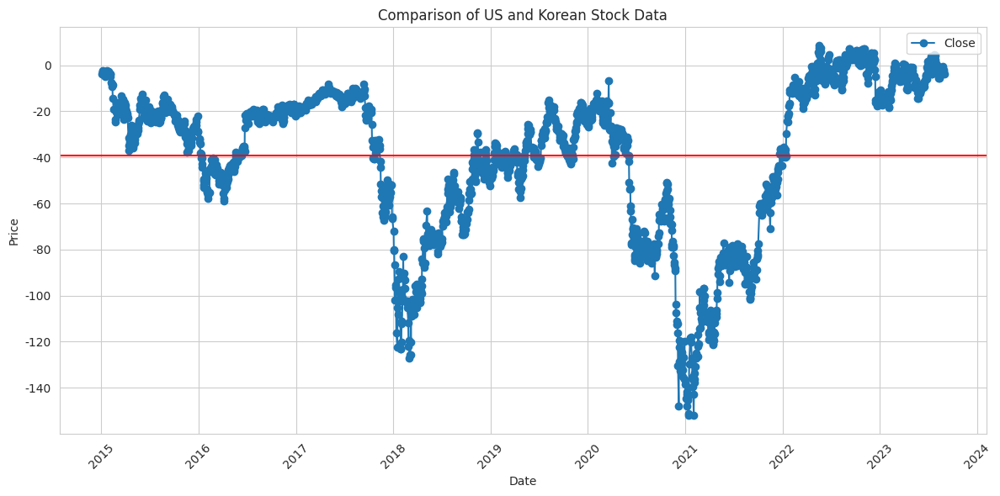

In [388]:
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Close'] - ak['kor_Close_USD'], label='Close', marker='o')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.axhline(y=(ak['Close'] - ak['kor_Close_USD']).mean(), color='red')
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

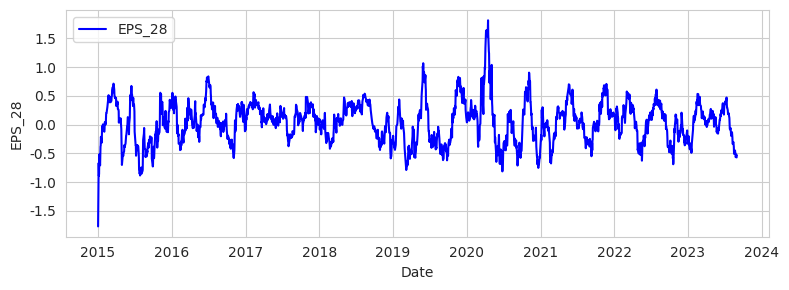

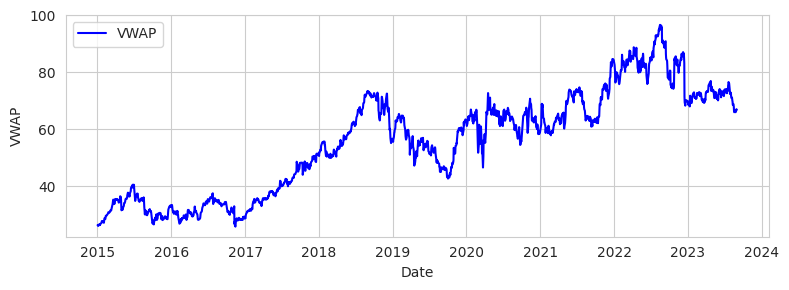

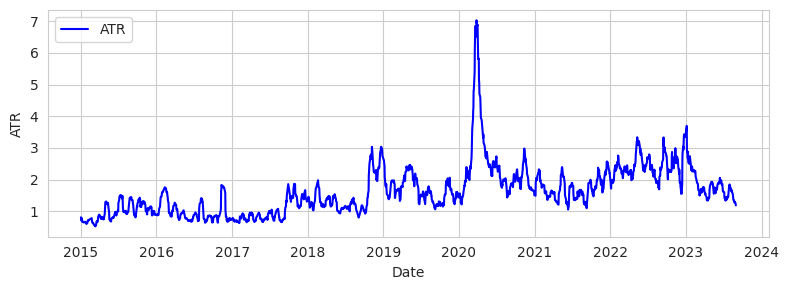

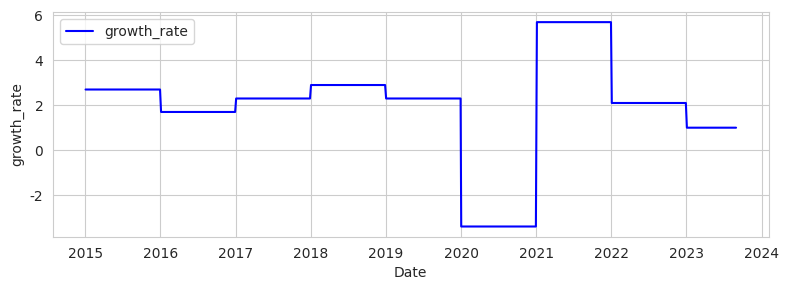

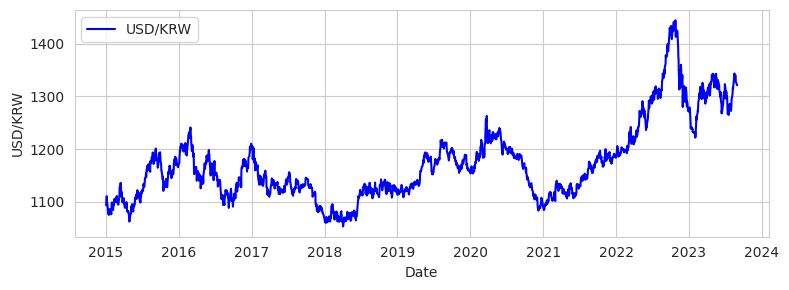

...

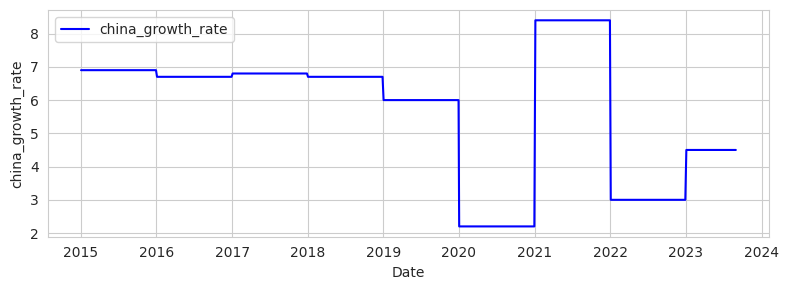

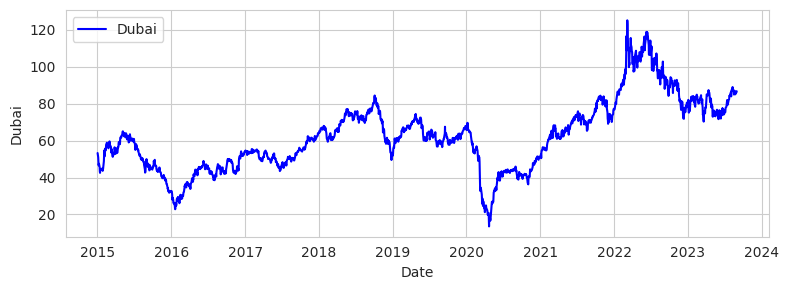

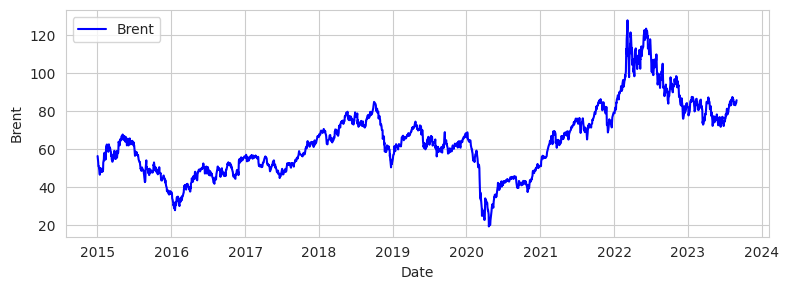

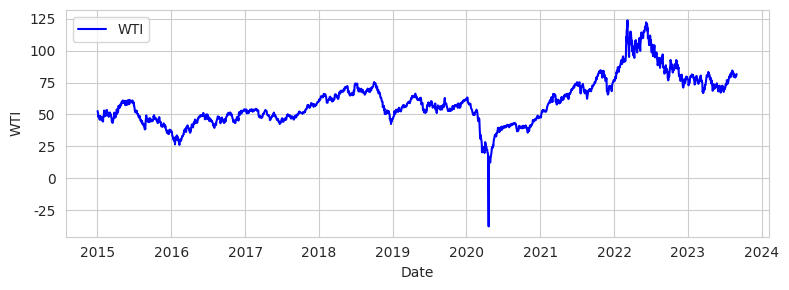

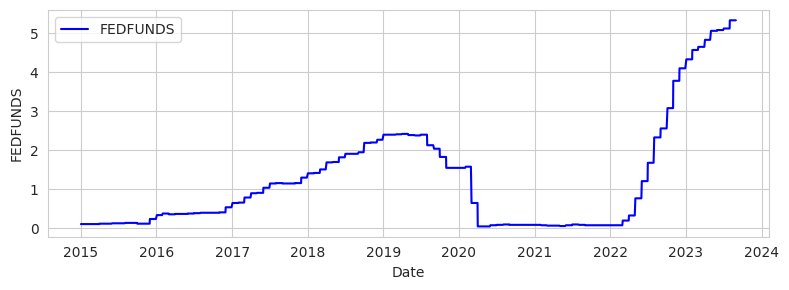

In [389]:
draw_one(ak, check_one)

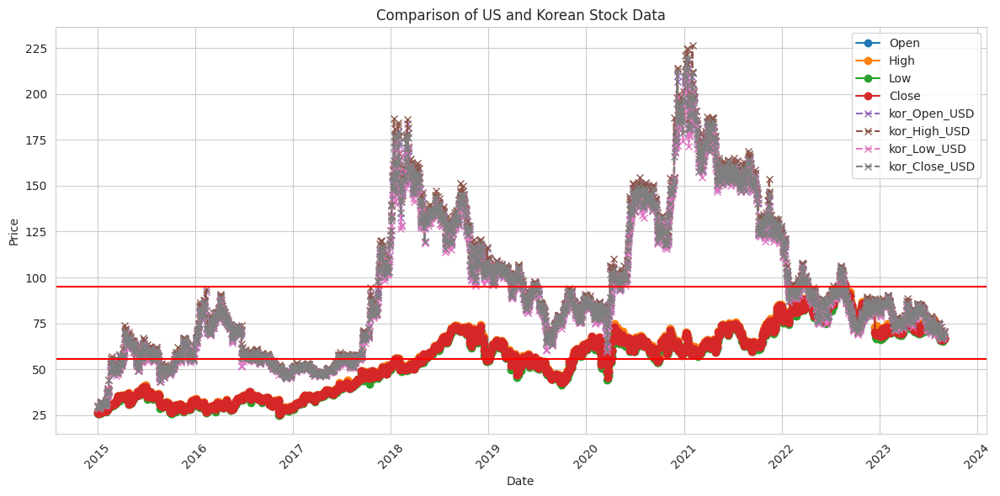

In [390]:
# 미국의 데이터를 라인 플롯으로 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Open'], label='Open', marker='o')
plt.plot(ak.index, ak['High'], label='High', marker='o')
plt.plot(ak.index, ak['Low'], label='Low', marker='o')
plt.plot(ak.index, ak['Close'], label='Close', marker='o')

# 한국의 데이터를 라인 플롯으로 그리기
plt.plot(ak.index, ak['kor_Open_USD'], label='kor_Open_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_High_USD'], label='kor_High_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Low_USD'], label='kor_Low_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Close_USD'], label='kor_Close_USD', linestyle='--', marker='x')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.axhline(y=((ak['Open']+ak['High']+ak['Low']+ak['Close'])/4).mean(), color='red')
plt.axhline(y=((ak['kor_Open_USD']+ak['kor_High_USD']+ak['kor_Low_USD']+ak['kor_Close_USD'])/4).mean(), color='red')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

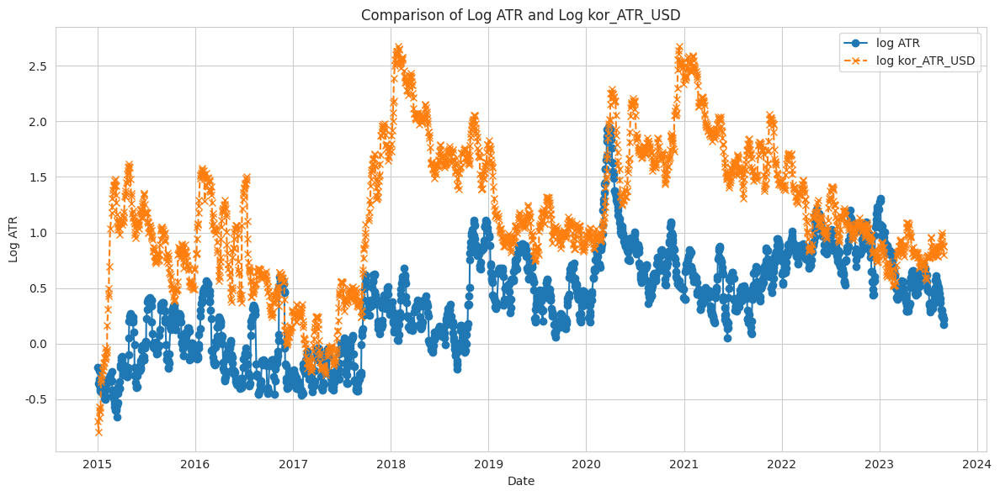

In [391]:
import matplotlib.pyplot as plt
import numpy as np

# 미국의 ATR 데이터
us_atr = ak['ATR']

# 한국의 kor_ATR_USD 데이터
kor_atr_usd = ak['kor_ATR_USD']

# 로그 스케일 적용
log_us_atr = np.log(us_atr)
log_kor_atr_usd = np.log(kor_atr_usd)

# 그래프 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, log_us_atr, label='log ATR', marker='o')
plt.plot(ak.index, log_kor_atr_usd, label='log kor_ATR_USD', linestyle='--', marker='x')

plt.title('Comparison of Log ATR and Log kor_ATR_USD')
plt.xlabel('Date')
plt.ylabel('Log ATR')
plt.legend()
plt.tight_layout()
plt.show()

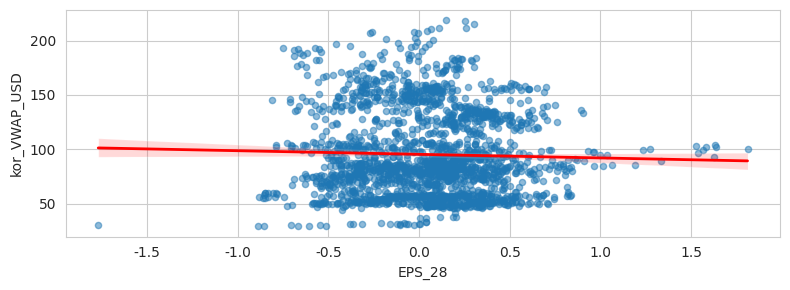

EPS_28와 kor_VWAP_USD 사이의 상관계수 : -0.03
p-value: 0.1786688495913248



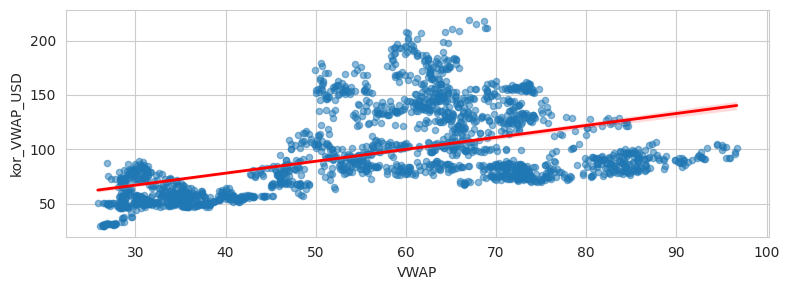

VWAP와 kor_VWAP_USD 사이의 상관계수 : 0.51
p-value: 7.284704633704439e-137



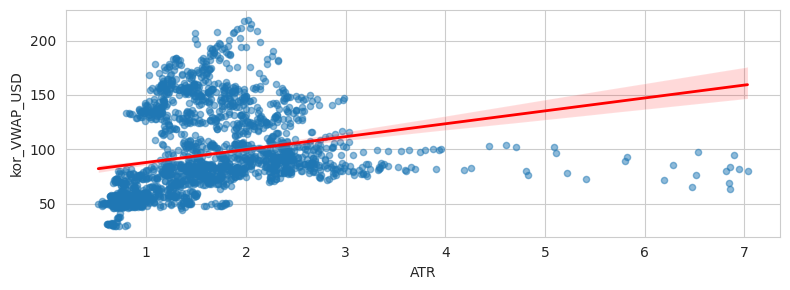

ATR와 kor_VWAP_USD 사이의 상관계수 : 0.24
p-value: 1.586192768319827e-29



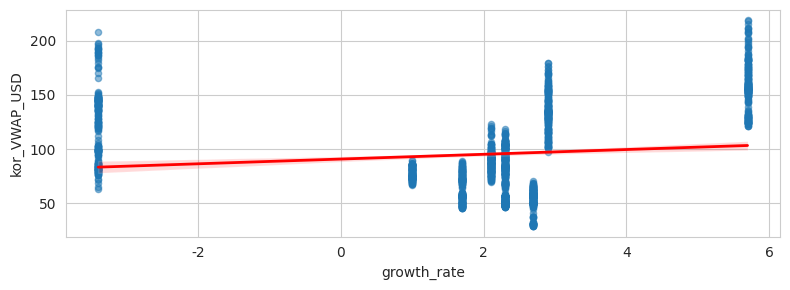

growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.13
p-value: 4.12362171846297e-09



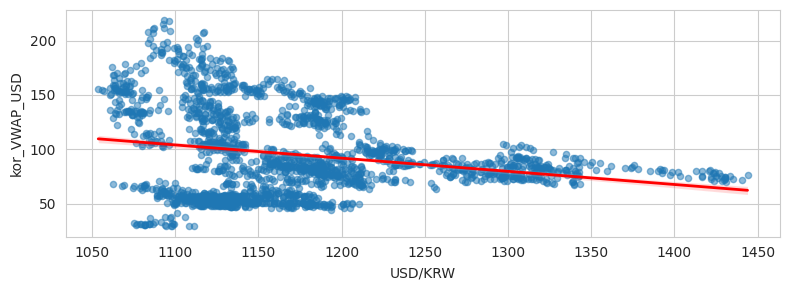

USD/KRW와 kor_VWAP_USD 사이의 상관계수 : -0.23
p-value: 9.914506600656056e-27



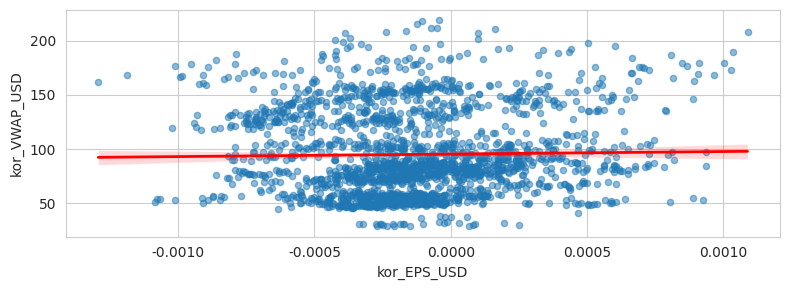

kor_EPS_USD와 kor_VWAP_USD 사이의 상관계수 : 0.03
p-value: 0.23149891645427215



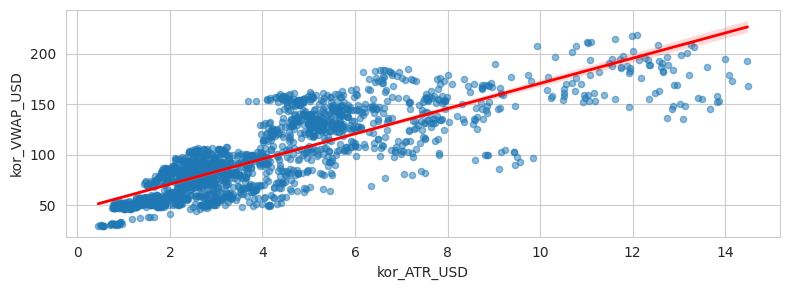

kor_ATR_USD와 kor_VWAP_USD 사이의 상관계수 : 0.83
p-value: 0.0



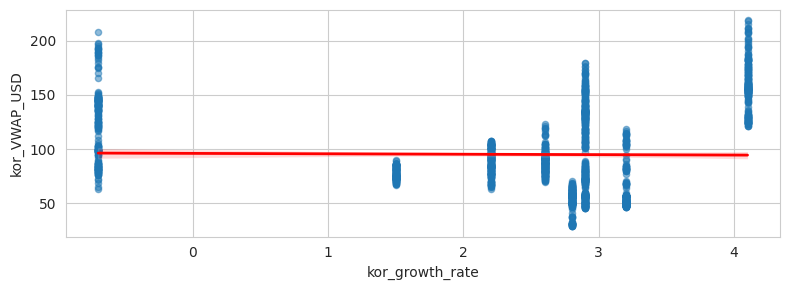

kor_growth_rate와 kor_VWAP_USD 사이의 상관계수 : -0.01
p-value: 0.5437026433196616



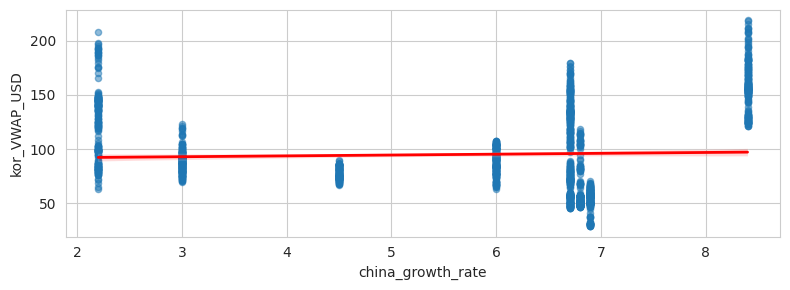

china_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.04
p-value: 0.0790623975861384



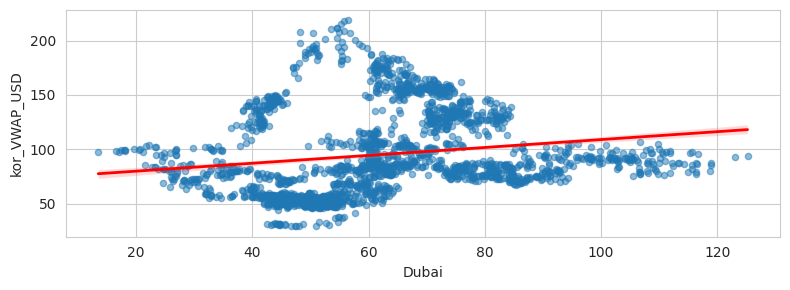

Dubai와 kor_VWAP_USD 사이의 상관계수 : 0.18
p-value: 5.824917115523203e-16



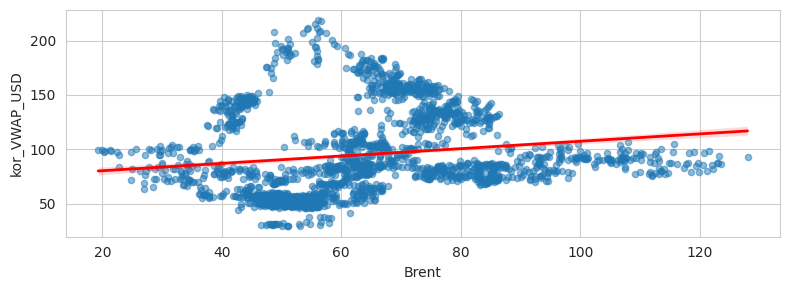

Brent와 kor_VWAP_USD 사이의 상관계수 : 0.16
p-value: 8.519882700763054e-14



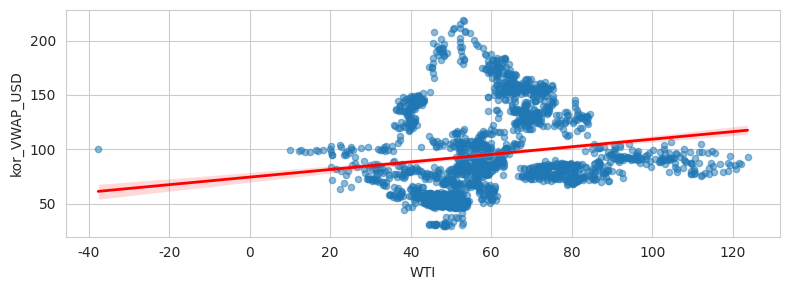

WTI와 kor_VWAP_USD 사이의 상관계수 : 0.16
p-value: 7.253832690524665e-14



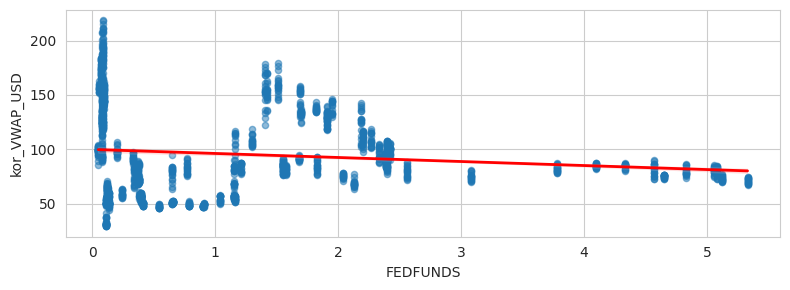

FEDFUNDS와 kor_VWAP_USD 사이의 상관계수 : -0.13
p-value: 1.3262231959445419e-09



In [392]:
draw_two(ak, check_two)

In [393]:
# Pearson 상관계수 계산
correlation_matrix = ak[check_one].corr()

correlation_matrix

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
EPS_28,1.000000,0.092119,0.086107,-0.005080,-0.031871,0.061523,-0.030718,-0.012023,0.021845,0.022797,-0.032654,-0.020648,-0.029364,-0.056759
VWAP,0.092119,1.000000,0.571768,-0.030039,0.511064,0.027229,0.508764,0.281067,-0.178952,-0.476197,0.733944,0.715107,0.699607,0.397168
ATR,0.086107,0.571768,1.000000,-0.339344,0.434949,0.135642,0.244023,0.269990,-0.434236,-0.563940,0.195461,0.187629,0.168743,0.145408
growth_rate,-0.005080,-0.030039,-0.339344,1.000000,-0.215490,-0.179085,0.129399,0.047078,0.958356,0.819112,0.346904,0.362968,0.367736,-0.062343
USD/KRW,-0.031871,0.511064,0.434949,-0.215490,1.000000,0.055596,-0.232859,-0.319242,-0.254964,-0.566648,0.435203,0.429088,0.437618,0.545560
kor_EPS_USD,0.061523,0.027229,0.135642,-0.179085,0.055596,1.000000,0.020774,0.136545,-0.148212,-0.177630,-0.012397,-0.002906,-0.024259,0.063257
kor_VWAP_USD,-0.030718,0.508764,0.244023,0.129399,-0.232859,0.020774,1.000000,0.832814,-0.012871,0.039364,0.176361,0.162861,0.163343,-0.133600
kor_ATR_USD,-0.012023,0.281067,0.269990,0.047078,-0.319242,0.136545,0.832814,1.000000,-0.044916,0.038409,0.006452,0.004705,-0.003793,-0.215633
kor_growth_rate,0.021845,-0.178952,-0.434236,0.958356,-0.254964,-0.148212,-0.012871,-0.044916,1.000000,0.828889,0.246692,0.272245,0.287573,-0.146148
china_growth_rate,0.022797,-0.476197,-0.563940,0.819112,-0.566648,-0.177630,0.039364,0.038409,0.828889,1.000000,-0.166836,-0.155473,-0.150392,-0.248039


In [394]:
correlation_matrix[['kor_VWAP_USD']].T

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
kor_VWAP_USD,-0.030718,0.508764,0.244023,0.129399,-0.232859,0.020774,1.0,0.832814,-0.012871,0.039364,0.176361,0.162861,0.163343,-0.1336


## XLI % + 0.7
+ XLI : Industrials
+ 제조업, 제조업군에 속하는 회사

### NH에서 준 정보를 활용한 상관관계 분석


In [395]:
#XLI
stock_name= ['현대차','기아차','삼성중공업','HD현대중공업','LG전자']
stock_code = ['005380','000270','010140','124500','066570']

etf = ['XLI']

year = '2023'
date = '0101'

find_best_R(etf, stock_name, stock_code, year, date, 0)

['거래일자', '시가', '고가', '저가', '종가', '거래량']
주식 받아오기 끝
가능한 조합: 31
상관계수 : 0.023697340675201486, p-value : 0.21808474854466334 ['현대차']
상관계수 : 0.05637689370449331, p-value : 0.003367514186307935 ['삼성중공업']
end


In [396]:
nasdaq_data.loc[nasdaq_data['sector_name'] == 'XLI', 'fc_sec_krl_nm'].unique()

array(['Axon Enterprise                                             ',
       '노드슨                                                         ',
       '익스피다이터스                                                     ',
       '유나이티드 에어라인스 홀딩스                                             ',
       '페이첵스                                                        ',
       '파카                                                          ',
       'J.B. 헌트 트랜스포트 서비시스                                          ',
       '오토매틱 데이터 프로세싱                                               ',
       '베리스크 애널리틱스                                                  ',
       '아메리칸 에어라인스 그룹                                               ',
       '신타스                                                         ',
       '올드 도미니언 프레이트 라인                                             ',
       '패스널                                                         ',
       '코파트                                                         ',
      

### 주식 중 XLI에 해당하는 주식 찾기

In [449]:
list(sector_info.loc[sector_info['sector_name']=='XLI', 'comanpy_name'].unique())

['United Rentals Inc',
 'FedEx Corp',
 'Old Dominion Freight Line Inc',
 'Expeditors Intl of WA Inc',
 'Eaton Corp plc',
 'Textron Inc',
 'Carrier Global Corp.',
 'Robert Half Inc',
 'Paychex Inc',
 'W.W. Grainger Inc',
 'Wabtec',
 'Honeywell Intl Inc',
 'Howmet Aerospace Inc.',
 'Rockwell Automation Inc',
 'Parker-Hannifin Corp',
 'Fastenal Co',
 'Emerson Electric Co',
 'Pentair PLC',
 'Deere & Co',
 'Dover Corp',
 'Fortive Corp',
 'RTX Corporation',
 'PACCAR Inc',
 'Generac Holdings Inc',
 'AMETEK Inc',
 'Boeing Co',
 'J.B. Hunt Transport Services',
 'Copart Inc',
 'Broadridge Financial Solutions Inc.',
 'TransDigm Group',
 'General Dynamics',
 'Paycom Software Inc',
 'Caterpillar Inc',
 'Waste Management Inc',
 'General Electric Co',
 'Illinois Tool Works Inc',
 'Trane Technologies plc',
 'Masco Corp',
 'United Parcel Service Inc B',
 'L3Harris Technologies Inc',
 'Cummins Inc',
 'Verisk Analytics Inc',
 'IDEX Corp',
 'Automatic Data Processing',
 'Leidos Holdings Inc',
 'Norfolk So

In [397]:
#조사할 데이터
america_list = list(sector_info.loc[sector_info['sector_name']=='XLI', 'tck_iem_cd'].unique())
korea_list = ['005380','000270','010140','124500','066570']

In [398]:
ak = return_ak(america_list, korea_list)

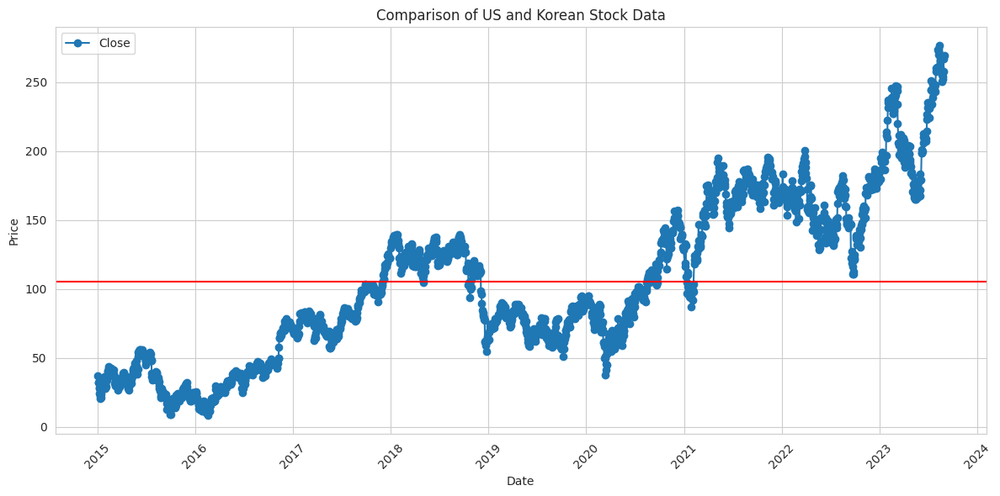

In [399]:
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Close'] - ak['kor_Close_USD'], label='Close', marker='o')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.axhline(y=(ak['Close'] - ak['kor_Close_USD']).mean(), color='red')
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

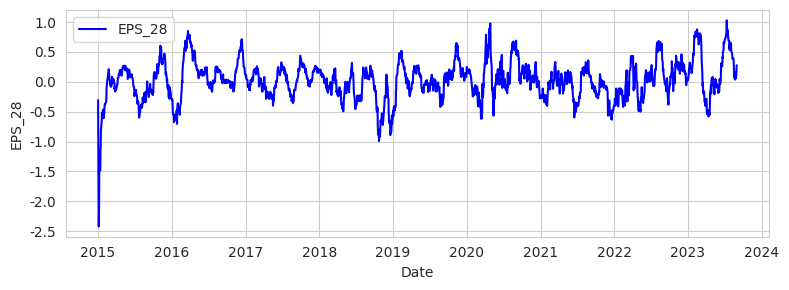

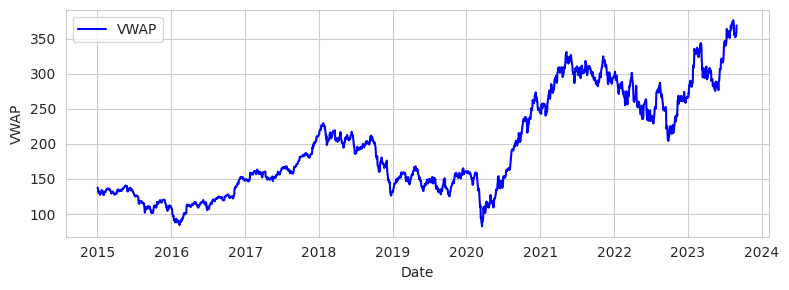

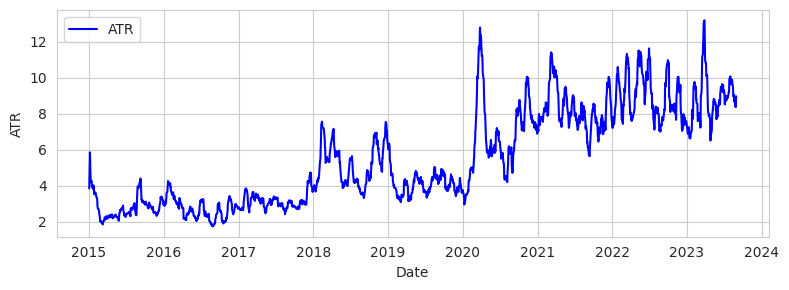

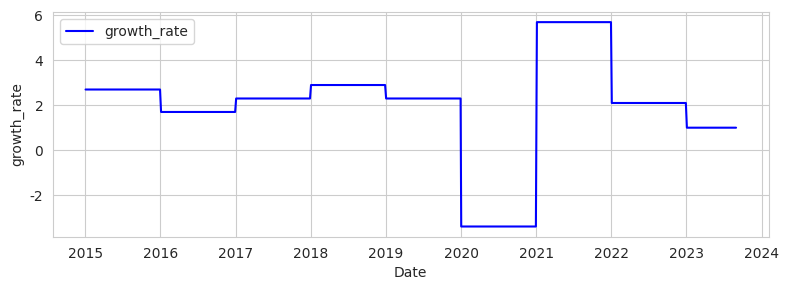

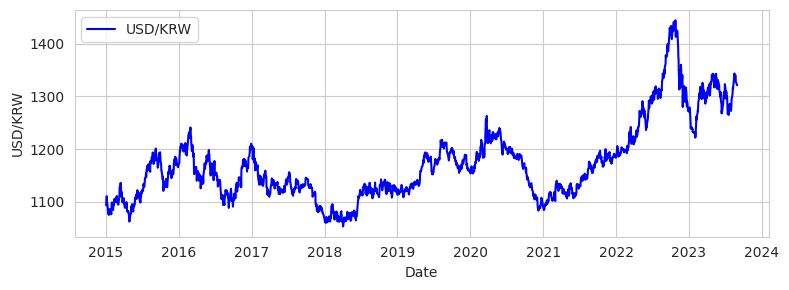

...

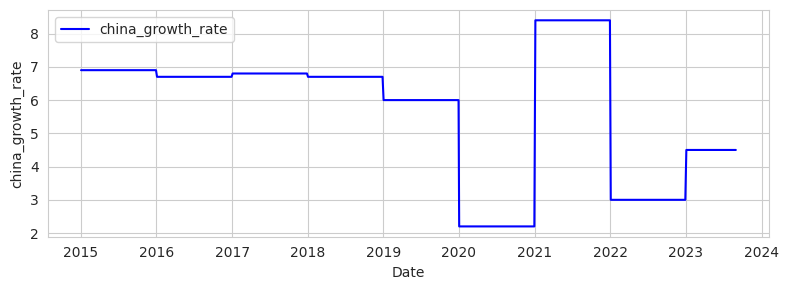

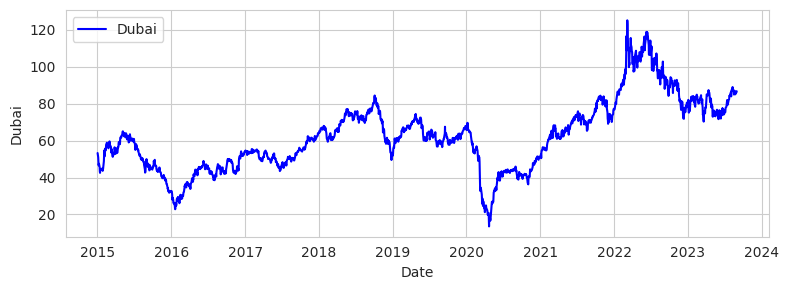

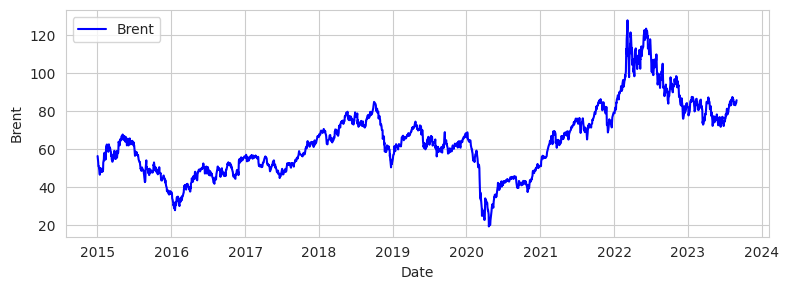

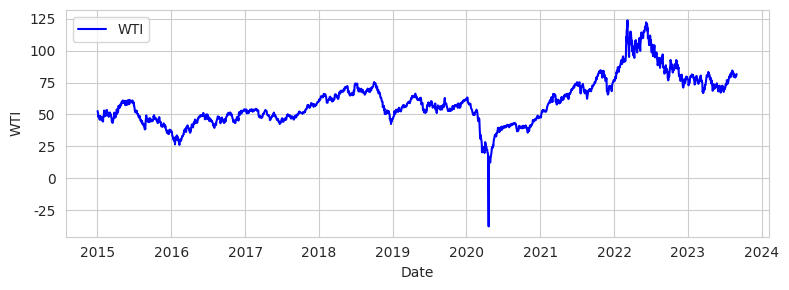

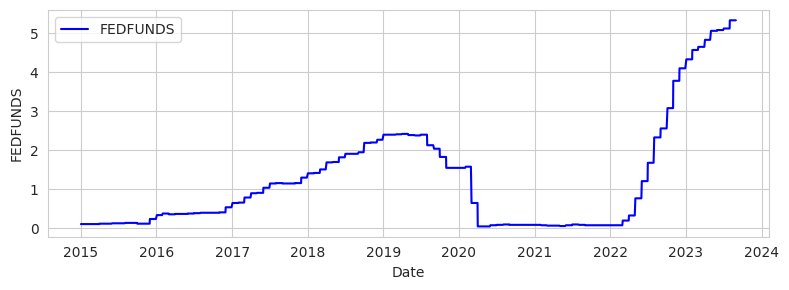

In [400]:
draw_one(ak, check_one)

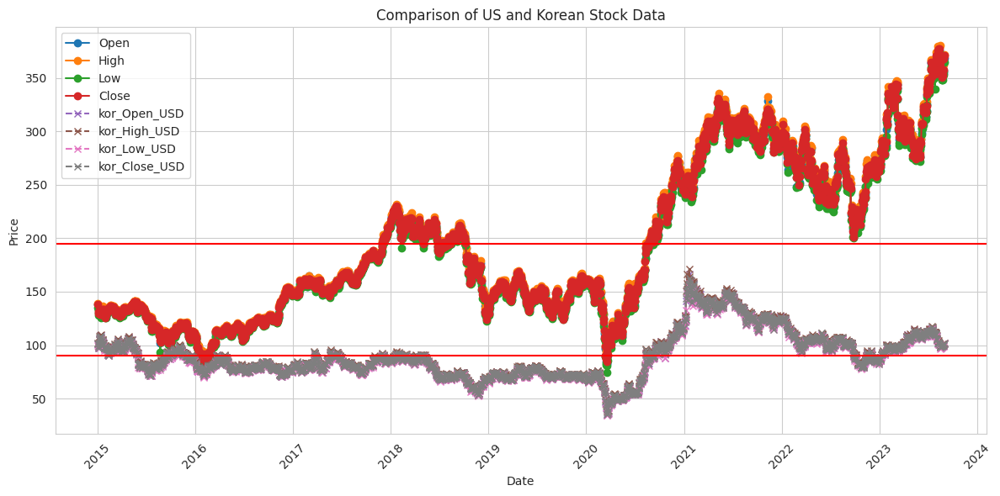

In [401]:
# 미국의 데이터를 라인 플롯으로 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, ak['Open'], label='Open', marker='o')
plt.plot(ak.index, ak['High'], label='High', marker='o')
plt.plot(ak.index, ak['Low'], label='Low', marker='o')
plt.plot(ak.index, ak['Close'], label='Close', marker='o')

# 한국의 데이터를 라인 플롯으로 그리기
plt.plot(ak.index, ak['kor_Open_USD'], label='kor_Open_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_High_USD'], label='kor_High_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Low_USD'], label='kor_Low_USD', linestyle='--', marker='x')
plt.plot(ak.index, ak['kor_Close_USD'], label='kor_Close_USD', linestyle='--', marker='x')

# 그래프 스타일 설정
plt.title('Comparison of US and Korean Stock Data')
plt.xlabel('Date')
plt.axhline(y=((ak['Open']+ak['High']+ak['Low']+ak['Close'])/4).mean(), color='red')
plt.axhline(y=((ak['kor_Open_USD']+ak['kor_High_USD']+ak['kor_Low_USD']+ak['kor_Close_USD'])/4).mean(), color='red')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.grid(True)
plt.legend()
plt.tight_layout()

# 그래프 표시
plt.show()

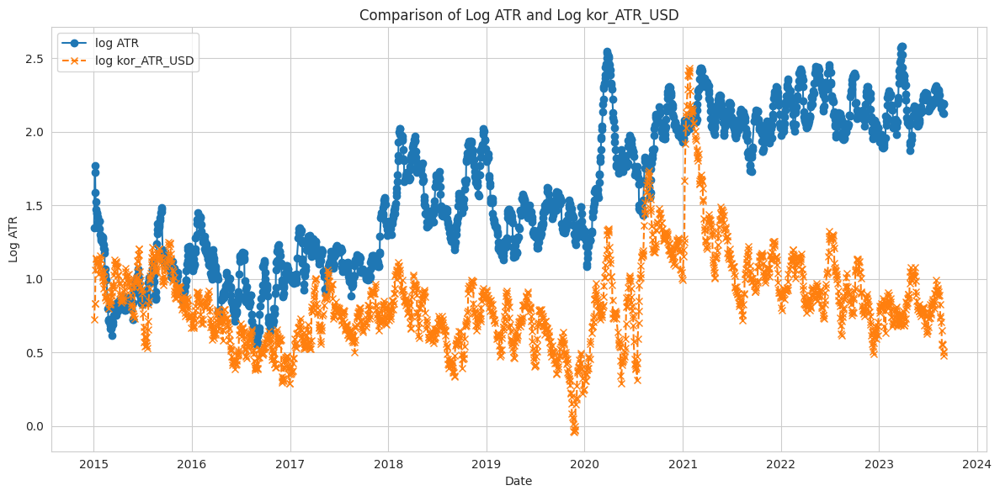

In [402]:
import matplotlib.pyplot as plt
import numpy as np

# 미국의 ATR 데이터
us_atr = ak['ATR']

# 한국의 kor_ATR_USD 데이터
kor_atr_usd = ak['kor_ATR_USD']

# 로그 스케일 적용
log_us_atr = np.log(us_atr)
log_kor_atr_usd = np.log(kor_atr_usd)

# 그래프 그리기
plt.figure(figsize=(12, 6))
plt.plot(ak.index, log_us_atr, label='log ATR', marker='o')
plt.plot(ak.index, log_kor_atr_usd, label='log kor_ATR_USD', linestyle='--', marker='x')

plt.title('Comparison of Log ATR and Log kor_ATR_USD')
plt.xlabel('Date')
plt.ylabel('Log ATR')
plt.legend()
plt.tight_layout()
plt.show()

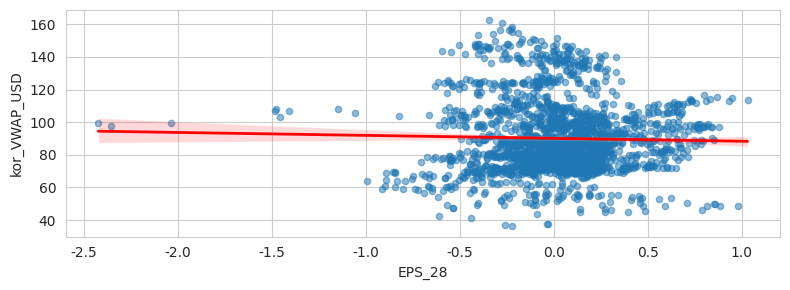

EPS_28와 kor_VWAP_USD 사이의 상관계수 : -0.03
p-value: 0.2240276624804884



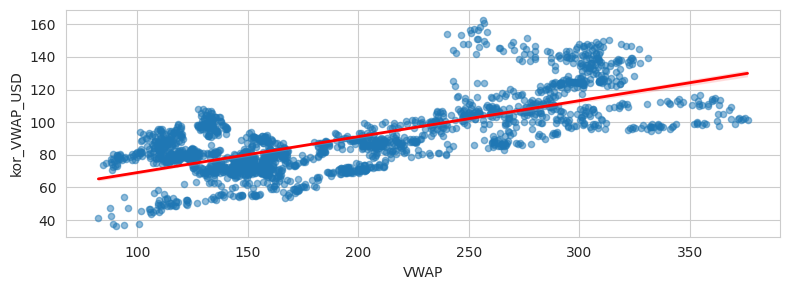

VWAP와 kor_VWAP_USD 사이의 상관계수 : 0.73
p-value: 0.0



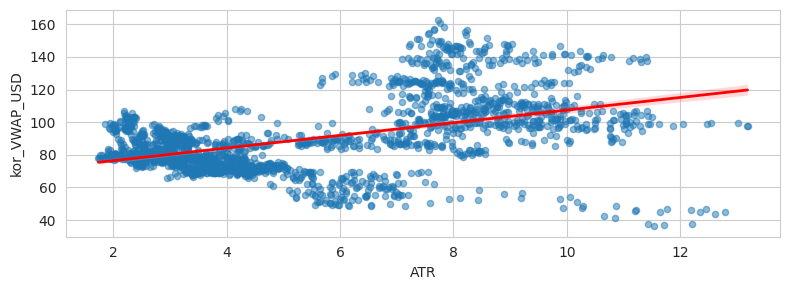

ATR와 kor_VWAP_USD 사이의 상관계수 : 0.48
p-value: 9.020788687835895e-118



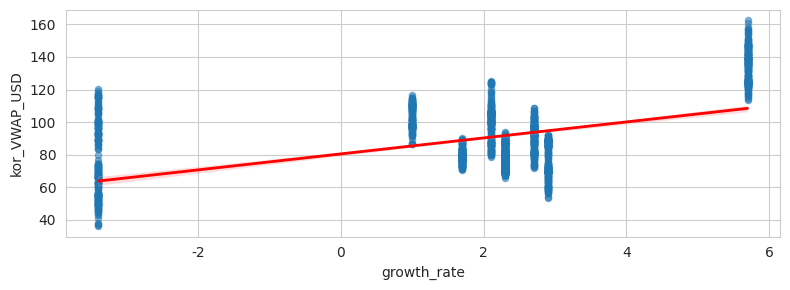

growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.52
p-value: 1.341861171961362e-140



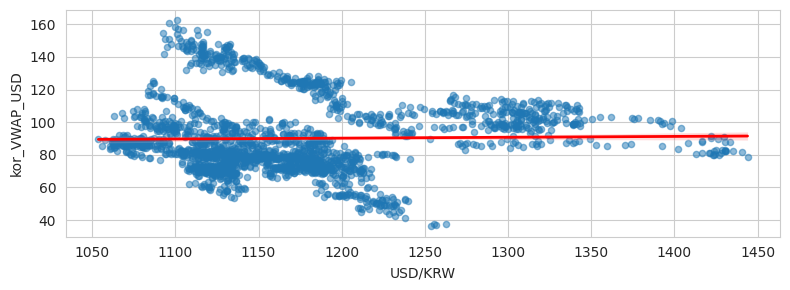

USD/KRW와 kor_VWAP_USD 사이의 상관계수 : 0.02
p-value: 0.409280871472077



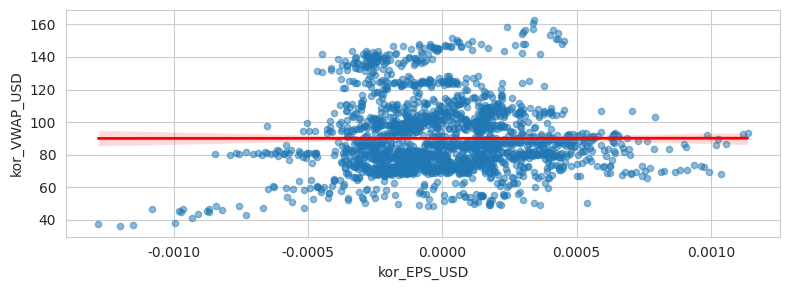

kor_EPS_USD와 kor_VWAP_USD 사이의 상관계수 : 0.01
p-value: 0.7556995544859492



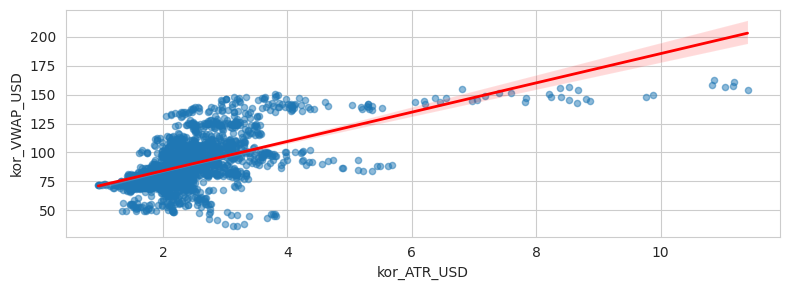

kor_ATR_USD와 kor_VWAP_USD 사이의 상관계수 : 0.59
p-value: 7.072807306517924e-198



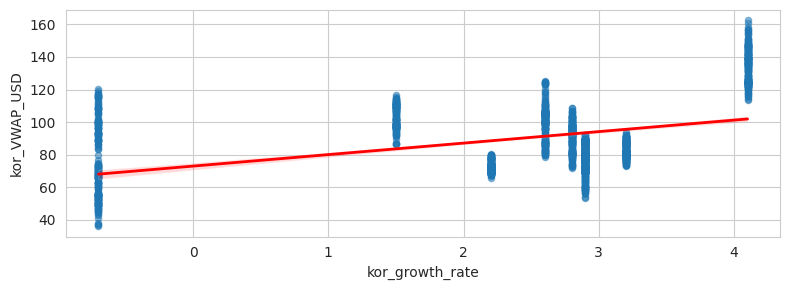

kor_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.42
p-value: 8.32496491749141e-89



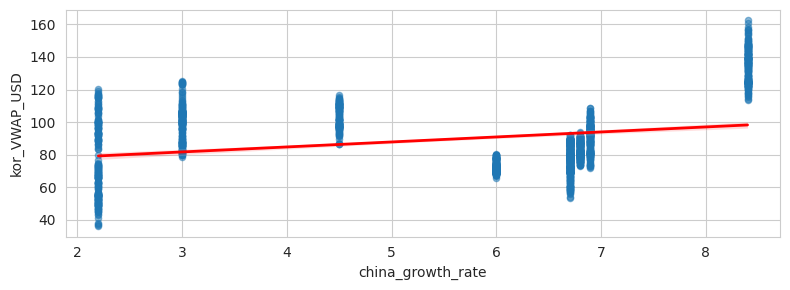

china_growth_rate와 kor_VWAP_USD 사이의 상관계수 : 0.27
p-value: 1.1404569250916758e-36



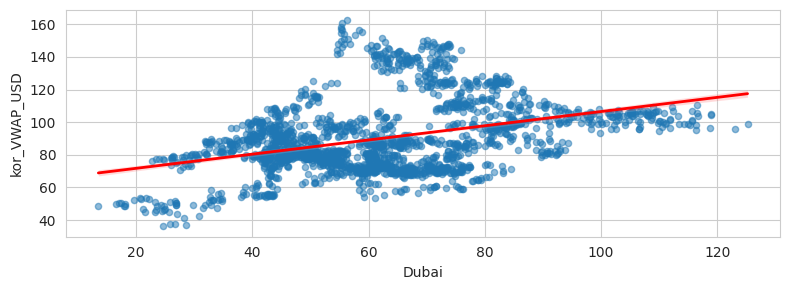

Dubai와 kor_VWAP_USD 사이의 상관계수 : 0.38
p-value: 1.47940788302953e-70



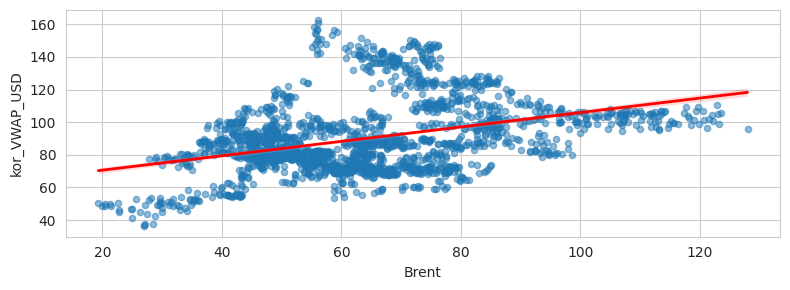

Brent와 kor_VWAP_USD 사이의 상관계수 : 0.38
p-value: 4.13075878625626e-71



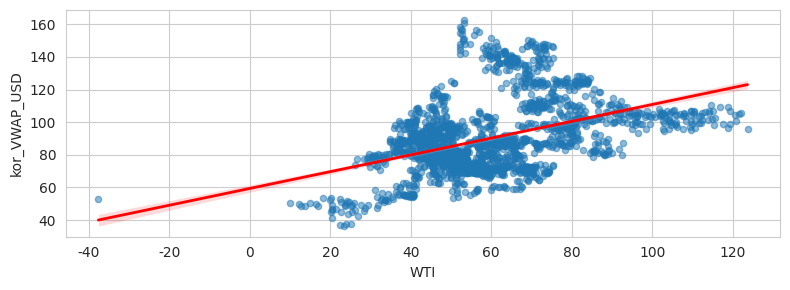

WTI와 kor_VWAP_USD 사이의 상관계수 : 0.43
p-value: 1.3236550226138481e-93



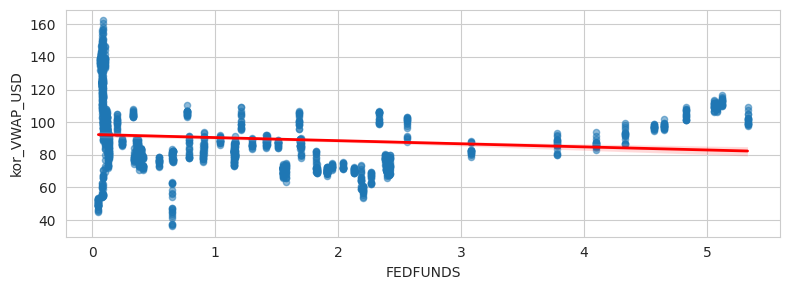

FEDFUNDS와 kor_VWAP_USD 사이의 상관계수 : -0.12
p-value: 3.048435539619474e-08



In [403]:
draw_two(ak, check_two)

In [404]:
# Pearson 상관계수 계산
correlation_matrix = ak[check_one].corr()

correlation_matrix

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
EPS_28,1.000000,0.126298,-0.033980,-0.207349,0.196514,0.025837,-0.026689,-0.104447,-0.190110,-0.204117,0.006765,0.011155,0.006343,0.168392
VWAP,0.126298,1.000000,0.759994,0.260539,0.349540,-0.032575,0.724614,0.307726,0.123822,-0.102957,0.690113,0.674921,0.697898,0.371733
ATR,-0.033980,0.759994,1.000000,-0.030341,0.526297,-0.103837,0.477040,0.387176,-0.170851,-0.414402,0.541248,0.530553,0.547786,0.278843
growth_rate,-0.207349,0.260539,-0.030341,1.000000,-0.215490,-0.121597,0.515931,0.161410,0.958356,0.819112,0.346904,0.362968,0.367736,-0.062343
USD/KRW,0.196514,0.349540,0.526297,-0.215490,1.000000,-0.077564,0.017933,-0.089878,-0.254964,-0.566648,0.435203,0.429088,0.437618,0.545560
kor_EPS_USD,0.025837,-0.032575,-0.103837,-0.121597,-0.077564,1.000000,0.000719,0.095501,-0.116157,-0.054518,-0.058861,-0.070871,-0.072510,0.060526
kor_VWAP_USD,-0.026689,0.724614,0.477040,0.515931,0.017933,0.000719,1.000000,0.595451,0.419762,0.273519,0.376121,0.377569,0.429437,-0.122219
kor_ATR_USD,-0.104447,0.307726,0.387176,0.161410,-0.089878,0.095501,0.595451,1.000000,0.078644,0.073836,0.013764,0.005412,0.029210,-0.265515
kor_growth_rate,-0.190110,0.123822,-0.170851,0.958356,-0.254964,-0.116157,0.419762,0.078644,1.000000,0.828889,0.246692,0.272245,0.287573,-0.146148
china_growth_rate,-0.204117,-0.102957,-0.414402,0.819112,-0.566648,-0.054518,0.273519,0.073836,0.828889,1.000000,-0.166836,-0.155473,-0.150392,-0.248039


In [405]:
correlation_matrix[['kor_VWAP_USD']].T

,EPS_28,VWAP,ATR,growth_rate,USD/KRW,kor_EPS_USD,kor_VWAP_USD,kor_ATR_USD,kor_growth_rate,china_growth_rate,Dubai,Brent,WTI,FEDFUNDS
kor_VWAP_USD,-0.026689,0.724614,0.47704,0.515931,0.017933,0.000719,1.0,0.595451,0.419762,0.273519,0.376121,0.377569,0.429437,-0.122219
